# Path Verification

In [ ]:
'/kaggle/input/ecg-data-thesis/ecg_individual/ecg_individual'

In [ ]:
import os

DATASET_BASE_PATH = '/kaggle/input/symile-mimic-1-0-0/symile-mimic-1.0.0/CSV'
BASE_IMAGE_PATH = '/kaggle/input/symile-mimic-1-0-0/symile-mimic-1.0.0/Images'

print("Checking paths...")
print(f"Base CSV path exists: {os.path.exists(DATASET_BASE_PATH)}")
if os.path.exists(DATASET_BASE_PATH):
    print("\nContents of CSV directory:")
    for item in os.listdir(DATASET_BASE_PATH):
        print(f"- {item}")
        if os.path.isdir(os.path.join(DATASET_BASE_PATH, item)):
            subdir = os.path.join(DATASET_BASE_PATH, item)
            print(f"  Contents of {item}:")
            for subitem in os.listdir(subdir):
                print(f"  - {subitem}")

print("\nChecking specific Atelectasis paths:")
atelectasis_dir = os.path.join(DATASET_BASE_PATH, 'Atelectasis')
print(f"Atelectasis directory exists: {os.path.exists(atelectasis_dir)}")
if os.path.exists(atelectasis_dir):
    print("\nContents of Atelectasis directory:")
    for file in os.listdir(atelectasis_dir):
        print(f"- {file}")

print("\nChecking image paths...")
print(f"Base Image path exists: {os.path.exists(BASE_IMAGE_PATH)}")
if os.path.exists(BASE_IMAGE_PATH):
    print("\nContents of Images directory:")
    for item in os.listdir(BASE_IMAGE_PATH):
        print(f"- {item}")

Checking paths...
Base CSV path exists: True

Contents of CSV directory:
- Lung Opacity
  Contents of Lung Opacity:
  - Lung Opacity_test.csv
  - Lung Opacity_train.csv
  - Lung Opacity_val.csv
- Cardiomegaly
  Contents of Cardiomegaly:
  - Cardiomegaly_val.csv
  - Cardiomegaly_train.csv
  - Cardiomegaly_test.csv
- Edema
  Contents of Edema:
  - Edema_test.csv
  - Edema_val.csv
  - Edema_train.csv
- Atelectasis
  Contents of Atelectasis:
  - Atelectasis_test.csv
  - Atelectasis_val.csv
  - Atelectasis_train.csv
- Pleural Effusion
  Contents of Pleural Effusion:
  - Pleural Effusion_train.csv
  - Pleural Effusion_val.csv
  - Pleural Effusion_test.csv

Checking specific Atelectasis paths:
Atelectasis directory exists: True

Contents of Atelectasis directory:
- Atelectasis_test.csv
- Atelectasis_val.csv
- Atelectasis_train.csv

Checking image paths...
Base Image path exists: True

Contents of Images directory:
- val_images
- val_retrieval_images
- train_images
- test_images


# Data Visualizer

In [ ]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import warnings
import matplotlib.pyplot as plt
from typing import Tuple, Optional


DATASET_BASE_PATH = '/kaggle/input/symile-mimic-1-0-0/symile-mimic-1.0.0/CSV'

# List of all condition columns to analyze, excluding 'No Finding'
ANALYSIS_CONDITIONS = [
    'Atelectasis',
    'Cardiomegaly',
    'Edema',
    'Lung Opacity',
    'Pleural Effusion'
]
# ---------------------

def analyze_class_csv_stats(class_name: str, dataset_base_path: str = DATASET_BASE_PATH) -> Optional[pd.DataFrame]:
    """
    Loads and provides statistical analysis for the train, validation, and test
    CSV files belonging to a specific class. Returns the train_df for plotting.
    """
    print("=" * 70)
    print(f"STATISTICAL ANALYSIS FOR CLASS: {class_name.upper()}")
    print("=" * 70)

    condition_path = os.path.join(dataset_base_path, class_name)
    train_df = None # Initialize to capture the training dataframe

    for split_type in ['train', 'val', 'test']:
        csv_filename = f'{class_name}_{split_type}.csv'
        csv_path = os.path.join(condition_path, csv_filename)

        df = None
        if os.path.exists(csv_path):
            try:
                df = pd.read_csv(csv_path)
                # Capture the train_df for later plotting
                if split_type == 'train':
                    train_df = df
            except Exception as e:
                print(f"Error reading {csv_path}: {e}")

        if df is not None:
            print(f"\n--- {split_type.upper()} SET ({csv_filename}) ---")
            print(f"Total entries (Row Count): {len(df):,}")

            present_conditions = [c for c in ANALYSIS_CONDITIONS if c in df.columns]

            if present_conditions:
                print("\nCondition label distribution (per column):")

                for condition in present_conditions:
                    # Count of positive (1), negative (0),
                    count_positive = int((df[condition] == 1).sum())
                    count_negative = int((df[condition] == 0).sum())


                    total_labeled = count_positive + count_negative

                    percentage_positive = (count_positive / len(df)) * 100 if len(df) > 0 else 0.0

                    print(f"  • {condition:15}:")
                    print(f"    - Positive (1) : {count_positive:7,} ({percentage_positive:5.1f}%)")
                    print(f"    - Negative (0) : {count_negative:7,}")

                    print(f"    - Total Labeled: {total_labeled:7,}")
            else:
                print("No standard condition columns found for distribution analysis.")
        else:
            print(f"\n--- {split_type.upper()} SET ({csv_filename}) ---")
            print(f"Warning: CSV file not found at {csv_path}")

    return train_df

# -----------------------------------------------------------------------------

def visualize_training_label_distribution(class_name: str, train_df: pd.DataFrame):
    """Calculates and plots the total distribution of -1, 0, and 1 labels ONLY for the Training set."""
    if train_df is None:
        print("\nCannot generate training label distribution: Training dataframe is missing.")
        return

    print("\n" + "~" * 70)
    print(f"PLOTTING TRAINING SET LABEL DISTRIBUTION FOR: {class_name.upper()}")
    print("~" * 70)

    df_to_analyze = train_df
    condition_cols = [c for c in ANALYSIS_CONDITIONS if c in df_to_analyze.columns]

    if not condition_cols:
        print("No columns found for plotting.")
        return


    label_counts = df_to_analyze[condition_cols].apply(pd.Series.value_counts).sum(axis=1)


    labels_to_plot = pd.Series(0, index=[ 0.0, 1.0])
    for label in label_counts.index:
        if label in labels_to_plot.index and not np.isnan(label):
            labels_to_plot[label] = label_counts[label]

    labels_to_plot = labels_to_plot.astype(int).sort_index()

    print(f"\nTraining Set total label counts: \n{labels_to_plot.to_string()}")

    # --- Plotting ---
    save_path = f'{class_name.lower()}_label_distribution.png'
    plt.figure(figsize=(8, 6))
    colors = { 0.0: '#FF6B6B', 1.0: '#4ECDC4'}
    x_labels = {

        0.0: r'$0$ (Negative)',
        1.0: r'$1$ (Positive)'
    }

    plt.bar([x_labels[l] for l in labels_to_plot.index], labels_to_plot.values,
            color=[colors[l] for l in labels_to_plot.index])

    plt.title(f'Training Set Label Distribution for {class_name}', fontsize=14, fontweight='bold')
    plt.xlabel('Label Value', fontsize=12)
    plt.ylabel('Total Count Across All Condition Columns', fontsize=12)
    plt.xticks(rotation=15, ha='right')

    for i, v in enumerate(labels_to_plot.values):
        plt.text(i, v, f'{v:,}', ha='center', va='bottom', fontsize=10)

    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    plt.show() # Display the plot
    print(f"Plot saved as '{save_path}'")

print("Visulaizing function Defined")

Visulaizing function Defined


# Dataset Loader

In [ ]:
import os
import pandas as pd
from typing import Dict, List, Any

BASE_CSV_PATH = '/kaggle/input/symile-mimic-1-0-0/symile-mimic-1.0.0/CSV'
BASE_IMAGE_PATH = '/kaggle/input/symile-mimic-1-0-0/symile-mimic-1.0.0/Images'

# Mapping between the CSV split and its corresponding image folder
SPLIT_IMAGE_FOLDERS = {
    'train': 'train_images',
    'val': 'val_images',
    'test': 'test_images'
}

# DATASET LOADER FUNCTION ---

def load_dataset(class_name: str) -> Dict[str, Dict[str, Any]]:

    if not os.path.exists(BASE_CSV_PATH):
        print(f"Error: Base CSV path not found: {BASE_CSV_PATH}")
        return {}

    result_data = {}
    condition_csv_path = os.path.join(BASE_CSV_PATH, class_name)

    print(f"\n--- Starting Data Load for Class: {class_name} ---")

    for split_type, img_folder in SPLIT_IMAGE_FOLDERS.items():
        csv_filename = f'{class_name}_{split_type}.csv'
        csv_path = os.path.join(condition_csv_path, csv_filename)

        df = None
        verified_paths = []

        if os.path.exists(csv_path):
            try:
                df = pd.read_csv(csv_path)

                base_img_folder = os.path.join(BASE_IMAGE_PATH, img_folder)

                if os.path.exists(base_img_folder):
                    for index, row in df.iterrows():
                        raw_path = str(row['cxr_path']).replace('\\', '/')
                        filename = os.path.basename(raw_path)
                        full_img_path = os.path.join(base_img_folder, filename)

                        if os.path.exists(full_img_path):
                            verified_paths.append(full_img_path)

                print(f"  Loaded {split_type} CSV: {len(df):,} entries. Verified images: {len(verified_paths):,}.")

            except Exception as e:
                print(f"  Error processing {csv_path}: {e}")

        else:
            print(f"  Warning: CSV not found for {split_type} at {csv_path}")

        # Store the results, even if data loading failed
        result_data[split_type] = {
            'df': df,
            'image_paths': verified_paths
        }
    print("Sucesfully Loaded Dataset")

    return result_data

print("DataSet Laoder function Defined")



DataSet Laoder function Defined


 # Atelectasis Models

STATISTICAL ANALYSIS FOR CLASS: ATELECTASIS

--- TRAIN SET (Atelectasis_train.csv) ---
Total entries (Row Count): 4,331

Condition label distribution (per column):
  • Atelectasis    :
    - Positive (1) :   2,867 ( 66.2%)
    - Negative (0) :   1,464
    - Total Labeled:   4,331

--- VAL SET (Atelectasis_val.csv) ---
Total entries (Row Count): 342

Condition label distribution (per column):
  • Atelectasis    :
    - Positive (1) :     225 ( 65.8%)
    - Negative (0) :     117
    - Total Labeled:     342

--- TEST SET (Atelectasis_test.csv) ---
Total entries (Row Count): 2,143

Condition label distribution (per column):
  • Atelectasis    :
    - Positive (1) :   1,409 ( 65.7%)
    - Negative (0) :     734
    - Total Labeled:   2,143

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
PLOTTING TRAINING SET LABEL DISTRIBUTION FOR: ATELECTASIS
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

Training Set total label counts: 
0.0    1464
1.0  

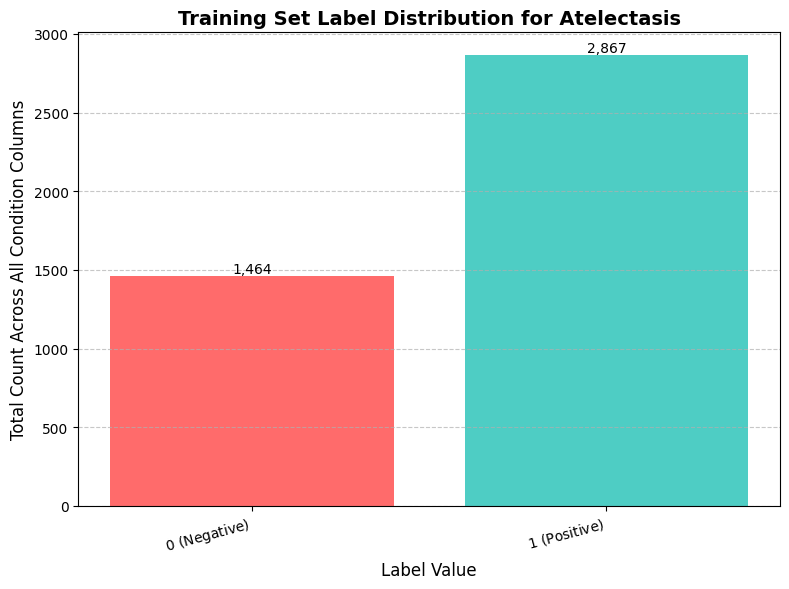

Plot saved as 'atelectasis_label_distribution.png'

--- Starting Data Load for Class: Atelectasis ---
  Loaded train CSV: 4,331 entries. Verified images: 4,331.
  Loaded val CSV: 342 entries. Verified images: 342.
  Loaded test CSV: 2,143 entries. Verified images: 2,143.
Sucesfully Loaded Dataset


In [ ]:
target_class="Atelectasis"
# 1. Analyze the CSVs and retrieve the training dataframe
train_df_result = analyze_class_csv_stats(class_name=target_class)
# 2. Plot the label distribution for the retrieved training dataframe
visualize_training_label_distribution(class_name=target_class, train_df=train_df_result)
loaded_data = load_dataset(class_name="Atelectasis")

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
from torch.utils.data import DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score
from torchvision import transforms
from torch.utils.data import Dataset
import torch.nn.functional as F
from PIL import Image

# Custom Dataset class
class ChestXRayDataset(Dataset):
    def __init__(self, dataframe, image_paths, transform=None):
        self.dataframe = dataframe
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        # Get the label from the dataframe
        df_idx = self.dataframe.index[self.dataframe['cxr_path'].str.contains(os.path.basename(img_path))][0]
        label = torch.tensor(self.dataframe.iloc[df_idx]['Atelectasis'], dtype=torch.float32)

        return image, label

# Data transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

print("Atelectasis CXR dataset loaded")

Atelectasis CXR dataset loaded


## ResNet 18 - Atelectasis


--- Starting ResNet Model Initialization (ResNet18 on Atelectasis dataset) ---


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 169MB/s] 



--- Starting ResNet Model Training on Atelectasis dataset ---


Epochs:   0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/15 | Time: 45.26s
------------------------------------------------------------
Training:    Loss: 0.5048, Accuracy: 0.7516, F1: 0.7570, AUC-ROC: 0.8338
Validation: Loss: 0.5843, Accuracy: 0.7281, F1: 0.7715, AUC-ROC: 0.8213
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8213


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/15 | Time: 43.58s
------------------------------------------------------------
Training:    Loss: 0.3007, Accuracy: 0.8811, F1: 0.8815, AUC-ROC: 0.9449
Validation: Loss: 0.5405, Accuracy: 0.7749, F1: 0.8372, AUC-ROC: 0.8364
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8364


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/15 | Time: 43.29s
------------------------------------------------------------
Training:    Loss: 0.1766, Accuracy: 0.9409, F1: 0.9395, AUC-ROC: 0.9804
Validation: Loss: 0.5811, Accuracy: 0.8070, F1: 0.8486, AUC-ROC: 0.8524
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8524


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/15 | Time: 42.37s
------------------------------------------------------------
Training:    Loss: 0.1062, Accuracy: 0.9633, F1: 0.9633, AUC-ROC: 0.9923
Validation: Loss: 0.6584, Accuracy: 0.7895, F1: 0.8442, AUC-ROC: 0.8394


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/15 | Time: 41.30s
------------------------------------------------------------
Training:    Loss: 0.0713, Accuracy: 0.9762, F1: 0.9752, AUC-ROC: 0.9965
Validation: Loss: 0.6691, Accuracy: 0.7865, F1: 0.8430, AUC-ROC: 0.8394


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/15 | Time: 41.35s
------------------------------------------------------------
Training:    Loss: 0.0526, Accuracy: 0.9801, F1: 0.9807, AUC-ROC: 0.9985
Validation: Loss: 0.7480, Accuracy: 0.7865, F1: 0.8396, AUC-ROC: 0.8281

Early stopping triggered after epoch 6. Validation AUC-ROC did not improve for 3 epochs.

--- Starting Plotting and History Storage ---


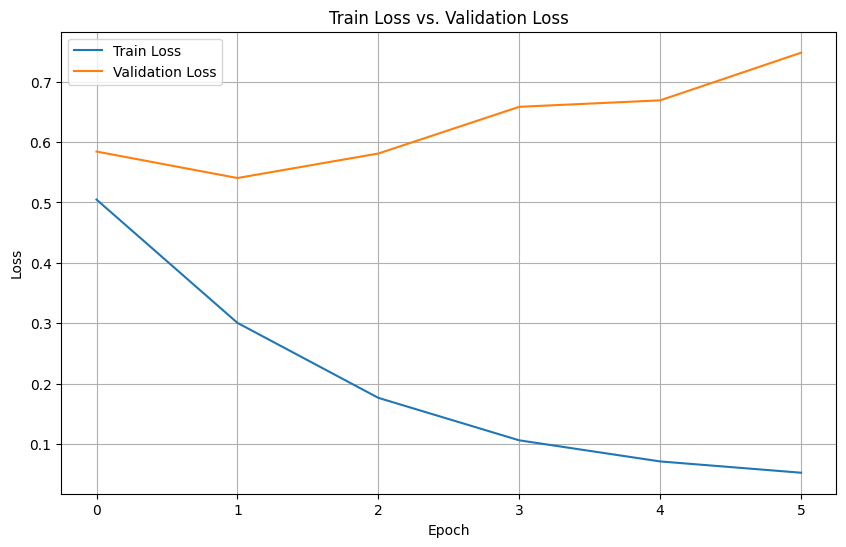


Model training history saved to Atelectasis_resnet18_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:        1.1824
Test Accuracy:    0.6608
Test F1 Score:    0.7367
Test AUC-ROC:     0.6842

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

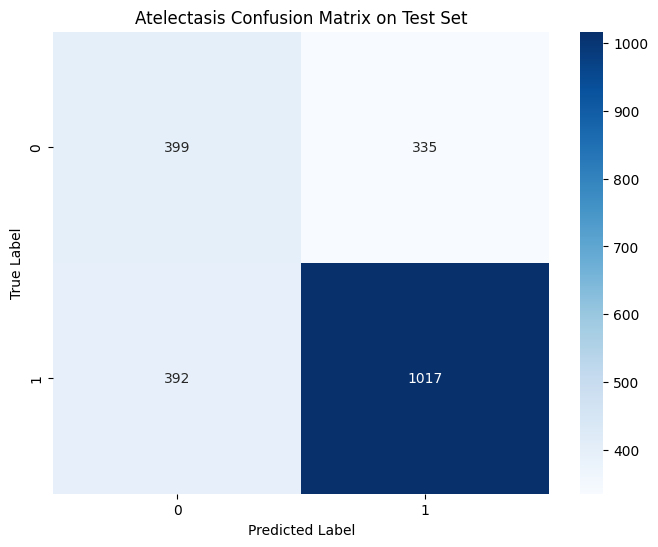

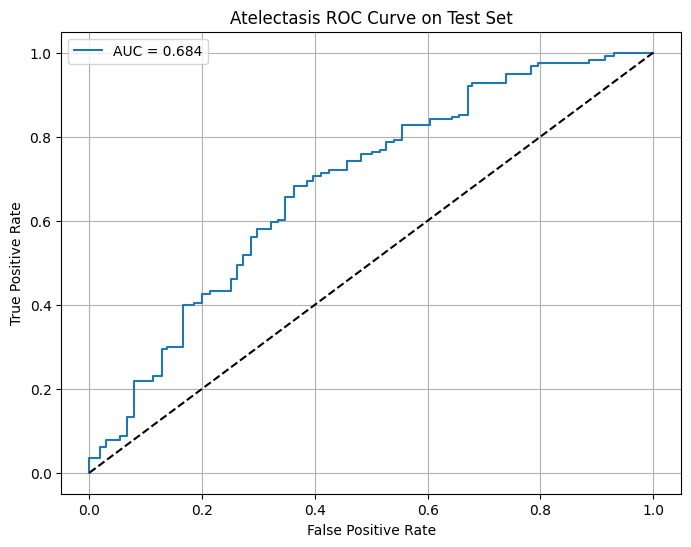


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.50      0.54      0.52       734
    Positive       0.75      0.72      0.74      1409

    accuracy                           0.66      2143
   macro avg       0.63      0.63      0.63      2143
weighted avg       0.67      0.66      0.66      2143



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle


# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Atelectasis'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

print("\n--- Starting ResNet Model Initialization (ResNet18 on Atelectasis dataset) ---")

# Initialize ResNet18 model
model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
num_ftrs = model.fc.in_features


model.fc = nn.Sequential(
    nn.Dropout(0.5),
    nn.Linear(num_ftrs, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()


optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001, weight_decay=0.05)

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        # Wrap the loader with tqdm for a progress bar
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Training on Atelectasis dataset ---")

# Training loop
num_epochs = 15
best_val_auc = 0.0
# Early Stopping variables
patience = 3
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0 # Reset patience counter
        print("Saving new best model checkpoint...")
        # UPDATED CHECKPOINT FILENAME
        torch.save(model.state_dict(), 'best_Atelectasis_resnet18_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True # Set flag to stop next iteration


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('Atelectasis_train_val_loss_plot.png')
plt.show()

## Storing Model History
# UPDATED HISTORY FILENAME
history_filename = 'Atelectasis_resnet18_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# Load best model
try:

    model.load_state_dict(torch.load('best_Atelectasis_resnet18_model.pth'))
except:
    model.load_state_dict(torch.load('best_Atelectasis_resnet18_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:        {test_loss:.4f}")
print(f"Test Accuracy:    {test_acc:.4f}")
print(f"Test F1 Score:    {test_f1:.4f}")
print(f"Test AUC-ROC:     {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)
y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Atelectasis Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Atelectasis ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Atelectasis roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))




--- Randomly Predicting on 5 Test Images ---


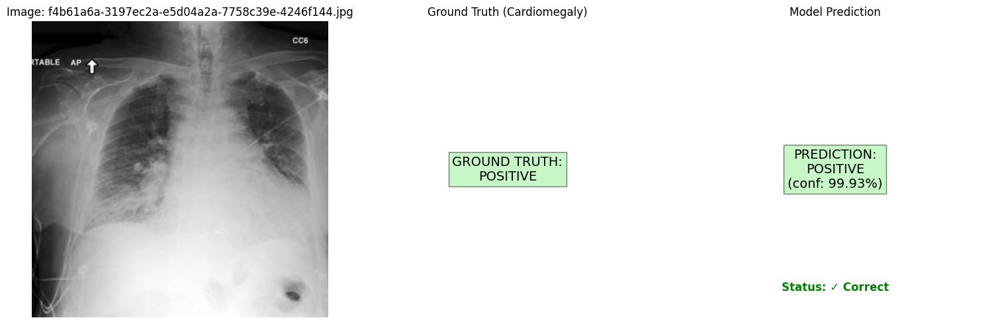


Image: f4b61a6a-3197ec2a-e5d04a2a-7758c39e-4246f144.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9993)
Prediction Status: ✓ Correct
--------------------------------------------------


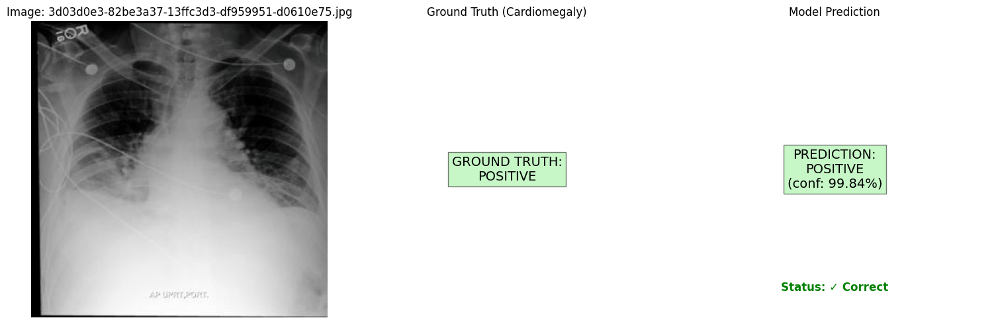


Image: 3d03d0e3-82be3a37-13ffc3d3-df959951-d0610e75.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9984)
Prediction Status: ✓ Correct
--------------------------------------------------


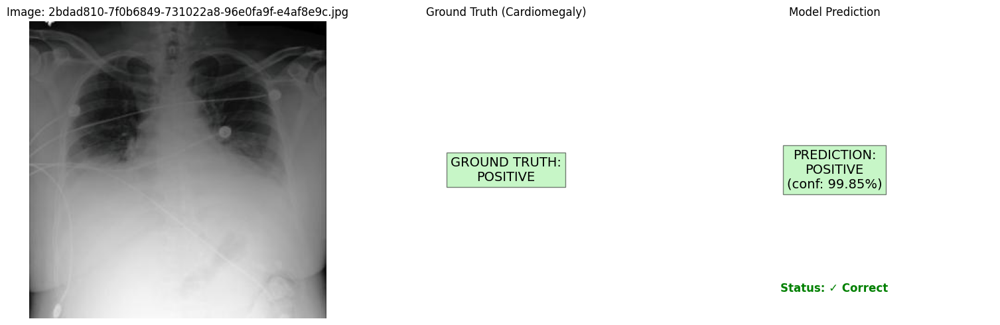


Image: 2bdad810-7f0b6849-731022a8-96e0fa9f-e4af8e9c.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9985)
Prediction Status: ✓ Correct
--------------------------------------------------


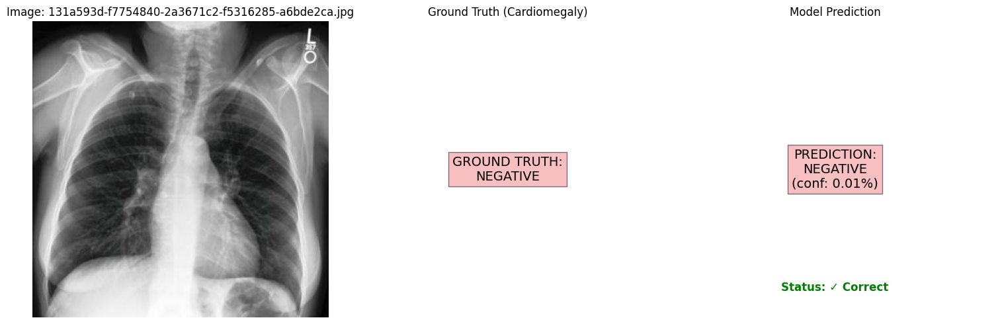


Image: 131a593d-f7754840-2a3671c2-f5316285-a6bde2ca.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0001)
Prediction Status: ✓ Correct
--------------------------------------------------


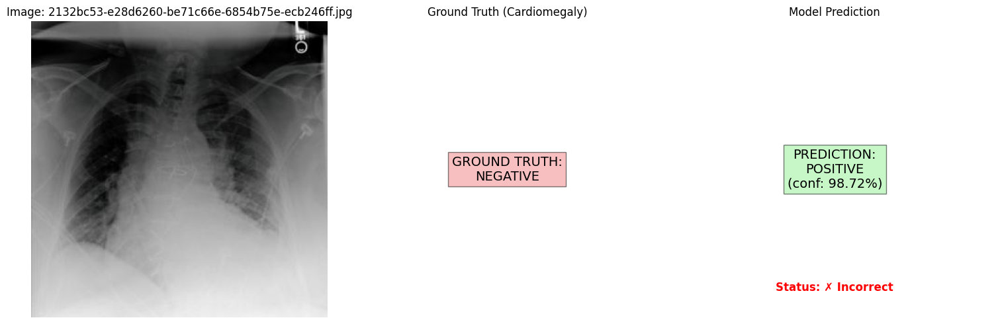


Image: 2132bc53-e28d6260-be71c66e-6854b75e-ecb246ff.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.9872)
Prediction Status: ✗ Incorrect
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    image = image.unsqueeze(0)

    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Atelectasis'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}')
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Atelectasis)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Atelectasis_resnet18_model.pth'))
except:
    model.load_state_dict(torch.load('best_Atelectasis_resnet18_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## ResNet50 - Atelectasis


--- Starting ResNet Model Initialization (ResNet50 on Atelectasis dataset) ---


Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 183MB/s] 



--- Starting ResNet50 Model Training on Atelectasis dataset  ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/20 | Time: 80.52s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.5660, Accuracy: 0.7241, F1: 0.7368, AUC-ROC: 0.7808
Validation: Loss: 0.7286, Accuracy: 0.5322, F1: 0.4805, AUC-ROC: 0.8286
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8286


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/20 | Time: 79.64s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.5511, Accuracy: 0.7252, F1: 0.7319, AUC-ROC: 0.7935
Validation: Loss: 0.5208, Accuracy: 0.7836, F1: 0.8333, AUC-ROC: 0.8272


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/20 | Time: 79.52s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.5177, Accuracy: 0.7571, F1: 0.7642, AUC-ROC: 0.8234
Validation: Loss: 3.5625, Accuracy: 0.3626, F1: 0.0603, AUC-ROC: 0.7566


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/20 | Time: 79.24s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.4941, Accuracy: 0.7617, F1: 0.7737, AUC-ROC: 0.8415
Validation: Loss: 0.5871, Accuracy: 0.7515, F1: 0.8262, AUC-ROC: 0.7647

Early stopping triggered after epoch 4. Validation AUC-ROC did not improve for 3 epochs.

--- Starting Plotting and History Storage ---


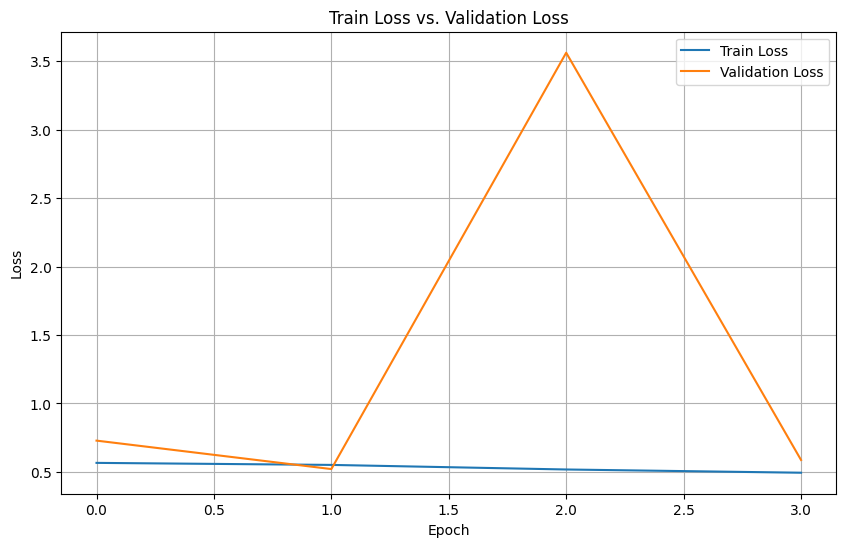


Model training history saved to Atelectasis_resnet50_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.8050
Test Accuracy:   0.4984
Test F1 Score:   0.4273
Test AUC-ROC:    0.7101

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

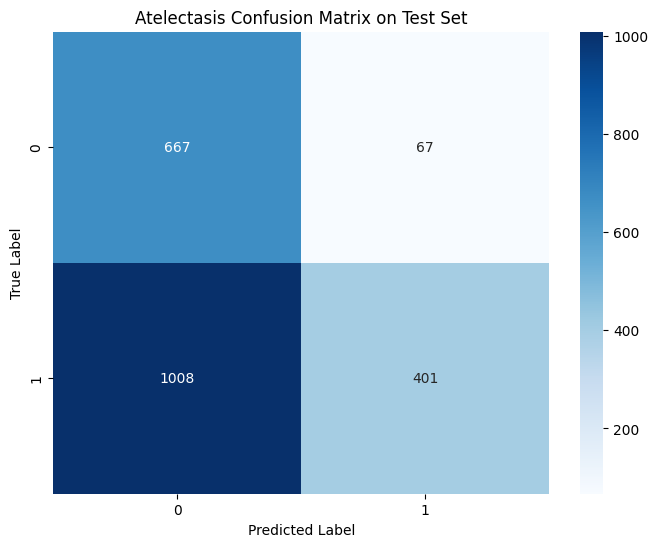

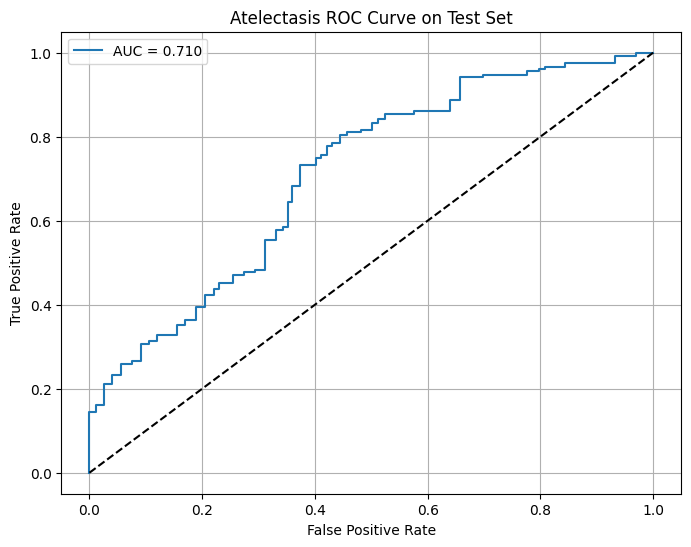


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.40      0.91      0.55       734
    Positive       0.86      0.28      0.43      1409

    accuracy                           0.50      2143
   macro avg       0.63      0.60      0.49      2143
weighted avg       0.70      0.50      0.47      2143



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle
from torch.optim.lr_scheduler import ReduceLROnPlateau


# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Atelectasis'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Initialization (ResNet50 on Atelectasis dataset) ---")


model = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V2)
num_ftrs = model.fc.in_features

model.fc = nn.Sequential(
    nn.Dropout(p=0.6),
    nn.Linear(num_ftrs, 1)
)


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()


optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.5)

scheduler = ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.1,
    patience=4,
    verbose=True
)



def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []


    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting ResNet50 Model Training on Atelectasis dataset  ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
# Early Stopping variables
patience = 3
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

# Wrap the epoch loop with tqdm for overall progress
for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )


    scheduler.step(val_auc)

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s | LR: {optimizer.param_groups[0]["lr"]}') # Print epoch time and current LR
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Atelectasis_resnet50_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot_regularized.png')
plt.show()

## Storing Model History
history_filename = 'Atelectasis_resnet50_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)




print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
try:
    model.load_state_dict(torch.load('best_Atelectasis_resnet50_model.pth'))
except:
    model.load_state_dict(torch.load('best_Atelectasis_resnet50_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)
        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)  # Store the probabilities for class 1

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Atelectasis Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('Atelectasis confusion_matrix_regularized.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Atelectasis ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Atelectasis roc_curve_regularized.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


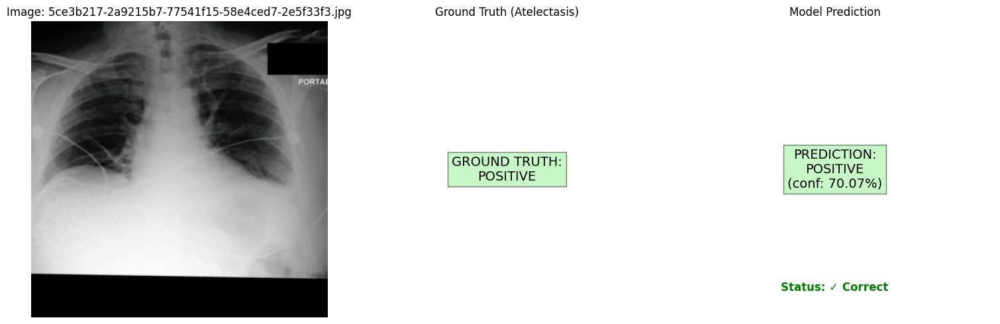


Image: 5ce3b217-2a9215b7-77541f15-58e4ced7-2e5f33f3.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7007)
Prediction Status: ✓ Correct
--------------------------------------------------


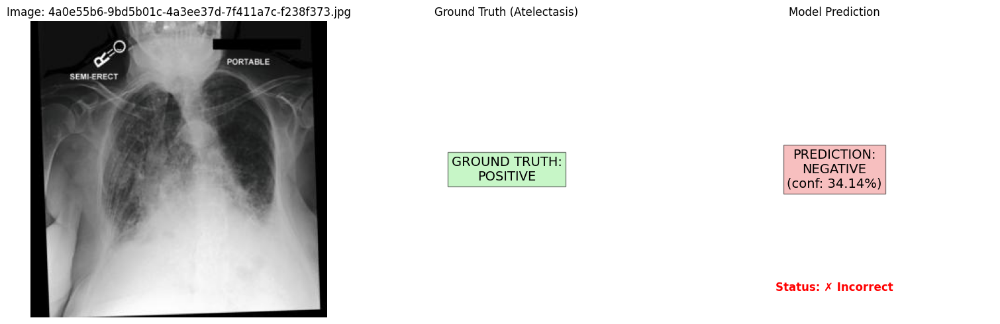


Image: 4a0e55b6-9bd5b01c-4a3ee37d-7f411a7c-f238f373.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.3414)
Prediction Status: ✗ Incorrect
--------------------------------------------------


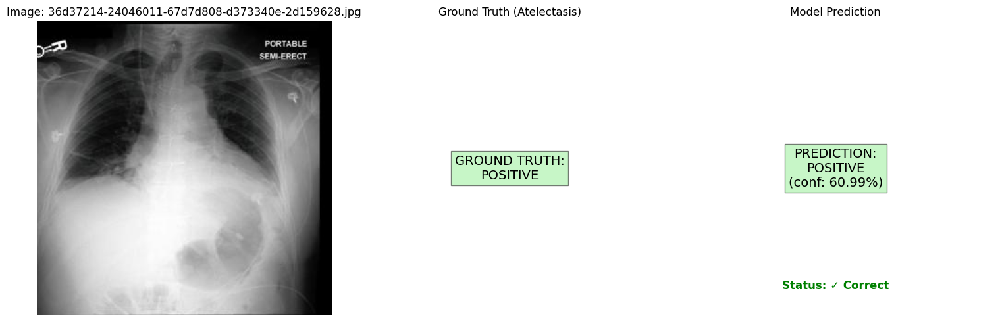


Image: 36d37214-24046011-67d7d808-d373340e-2d159628.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.6099)
Prediction Status: ✓ Correct
--------------------------------------------------


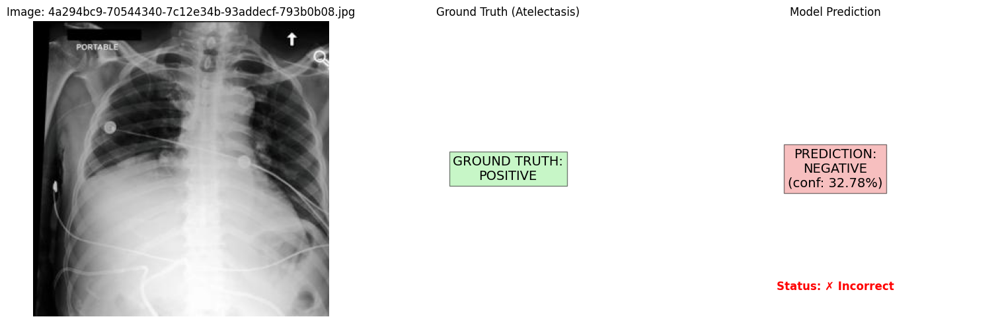


Image: 4a294bc9-70544340-7c12e34b-93addecf-793b0b08.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.3278)
Prediction Status: ✗ Incorrect
--------------------------------------------------


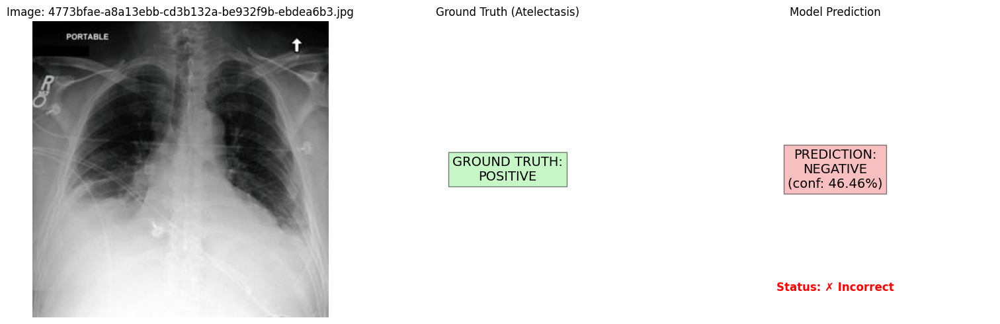


Image: 4773bfae-a8a13ebb-cd3b132a-be932f9b-ebdea6b3.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.4646)
Prediction Status: ✗ Incorrect
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 2
Accuracy: 40.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    image = image.unsqueeze(0)

    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Atelectasis'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}')
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Atelectasis)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")




try:
    model.load_state_dict(torch.load('best_Atelectasis_resnet50_model.pth'))
except:

    model.load_state_dict(torch.load('best_Atelectasis_resnet50_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## VGG16 - Atelectasis


--- Starting VGG Model Initialization (VGG16 on Atelectasis dataset) ---


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 205MB/s]  



--- Starting VGG16 Model Training on Atelectasis dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/20 | Time: 119.05s
------------------------------------------------------------
Training:    Loss: 0.6866, Accuracy: 0.5842, F1: 0.6015, AUC-ROC: 0.6113
Validation: Loss: 0.6557, Accuracy: 0.6199, F1: 0.6176, AUC-ROC: 0.7978
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7978


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/20 | Time: 117.43s
------------------------------------------------------------
Training:    Loss: 0.6223, Accuracy: 0.6624, F1: 0.6806, AUC-ROC: 0.7123
Validation: Loss: 0.5502, Accuracy: 0.7602, F1: 0.8360, AUC-ROC: 0.7918


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/20 | Time: 117.36s
------------------------------------------------------------
Training:    Loss: 0.5888, Accuracy: 0.6998, F1: 0.7126, AUC-ROC: 0.7540
Validation: Loss: 0.4670, Accuracy: 0.8187, F1: 0.8719, AUC-ROC: 0.8375
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8375


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/20 | Time: 116.72s
------------------------------------------------------------
Training:    Loss: 0.5954, Accuracy: 0.6864, F1: 0.7073, AUC-ROC: 0.7415
Validation: Loss: 0.6813, Accuracy: 0.6345, F1: 0.6973, AUC-ROC: 0.6978


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/20 | Time: 117.09s
------------------------------------------------------------
Training:    Loss: 0.5925, Accuracy: 0.6911, F1: 0.7128, AUC-ROC: 0.7548
Validation: Loss: 0.5206, Accuracy: 0.7427, F1: 0.7833, AUC-ROC: 0.8396
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8396


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/20 | Time: 117.35s
------------------------------------------------------------
Training:    Loss: 0.5611, Accuracy: 0.7229, F1: 0.7260, AUC-ROC: 0.7825
Validation: Loss: 0.5570, Accuracy: 0.7339, F1: 0.7661, AUC-ROC: 0.8557
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8557


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 7/20 | Time: 116.92s
------------------------------------------------------------
Training:    Loss: 0.5619, Accuracy: 0.7169, F1: 0.7339, AUC-ROC: 0.7772
Validation: Loss: 0.4782, Accuracy: 0.8129, F1: 0.8644, AUC-ROC: 0.8524


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 8/20 | Time: 116.85s
------------------------------------------------------------
Training:    Loss: 0.5621, Accuracy: 0.7190, F1: 0.7355, AUC-ROC: 0.7797
Validation: Loss: 0.5091, Accuracy: 0.7544, F1: 0.7961, AUC-ROC: 0.8512


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 9/20 | Time: 116.73s
------------------------------------------------------------
Training:    Loss: 0.5492, Accuracy: 0.7232, F1: 0.7434, AUC-ROC: 0.7922
Validation: Loss: 0.4550, Accuracy: 0.8275, F1: 0.8698, AUC-ROC: 0.8668
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8668


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 10/20 | Time: 117.34s
------------------------------------------------------------
Training:    Loss: 0.5433, Accuracy: 0.7308, F1: 0.7452, AUC-ROC: 0.7949
Validation: Loss: 0.4621, Accuracy: 0.8012, F1: 0.8475, AUC-ROC: 0.8560


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 11/20 | Time: 116.77s
------------------------------------------------------------
Training:    Loss: 0.5372, Accuracy: 0.7405, F1: 0.7586, AUC-ROC: 0.8021
Validation: Loss: 0.5425, Accuracy: 0.7544, F1: 0.7910, AUC-ROC: 0.8613


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 12/20 | Time: 117.48s
------------------------------------------------------------
Training:    Loss: 0.5229, Accuracy: 0.7619, F1: 0.7738, AUC-ROC: 0.8167
Validation: Loss: 0.4784, Accuracy: 0.7895, F1: 0.8333, AUC-ROC: 0.8617


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 13/20 | Time: 117.32s
------------------------------------------------------------
Training:    Loss: 0.5257, Accuracy: 0.7430, F1: 0.7562, AUC-ROC: 0.8118
Validation: Loss: 0.4296, Accuracy: 0.8246, F1: 0.8712, AUC-ROC: 0.8678
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8678


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 14/20 | Time: 117.52s
------------------------------------------------------------
Training:    Loss: 0.5054, Accuracy: 0.7550, F1: 0.7686, AUC-ROC: 0.8286
Validation: Loss: 0.4460, Accuracy: 0.8041, F1: 0.8508, AUC-ROC: 0.8626


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 15/20 | Time: 118.15s
------------------------------------------------------------
Training:    Loss: 0.5044, Accuracy: 0.7555, F1: 0.7647, AUC-ROC: 0.8301
Validation: Loss: 0.5179, Accuracy: 0.7807, F1: 0.8175, AUC-ROC: 0.8594


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 16/20 | Time: 117.69s
------------------------------------------------------------
Training:    Loss: 0.4894, Accuracy: 0.7710, F1: 0.7857, AUC-ROC: 0.8406
Validation: Loss: 0.5329, Accuracy: 0.7719, F1: 0.8060, AUC-ROC: 0.8668


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 17/20 | Time: 117.60s
------------------------------------------------------------
Training:    Loss: 0.4879, Accuracy: 0.7689, F1: 0.7787, AUC-ROC: 0.8409
Validation: Loss: 0.4541, Accuracy: 0.8187, F1: 0.8565, AUC-ROC: 0.8747
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8747


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 18/20 | Time: 117.50s
------------------------------------------------------------
Training:    Loss: 0.4756, Accuracy: 0.7728, F1: 0.7843, AUC-ROC: 0.8507
Validation: Loss: 0.4563, Accuracy: 0.8099, F1: 0.8478, AUC-ROC: 0.8711


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 19/20 | Time: 116.98s
------------------------------------------------------------
Training:    Loss: 0.4863, Accuracy: 0.7714, F1: 0.7814, AUC-ROC: 0.8425
Validation: Loss: 0.4977, Accuracy: 0.8099, F1: 0.8463, AUC-ROC: 0.8722


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 20/20 | Time: 117.31s
------------------------------------------------------------
Training:    Loss: 0.4515, Accuracy: 0.7917, F1: 0.8031, AUC-ROC: 0.8661
Validation: Loss: 0.4251, Accuracy: 0.8246, F1: 0.8655, AUC-ROC: 0.8727

--- Starting Plotting and History Storage ---


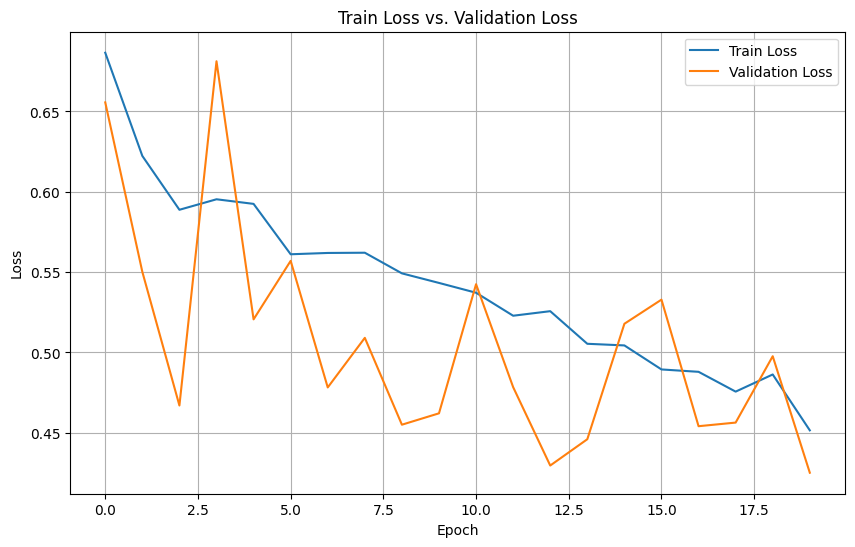


Model training history saved to Atelectasis_vgg16_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.6178
Test Accuracy:   0.7079
Test F1 Score:   0.7715
Test AUC-ROC:    0.7586

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

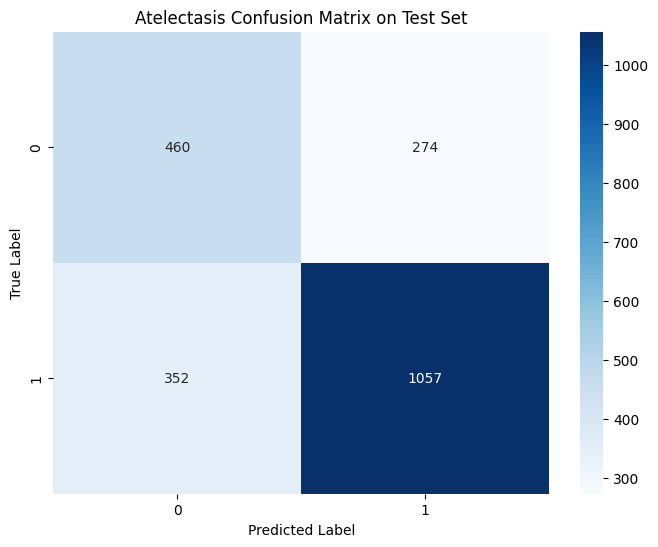

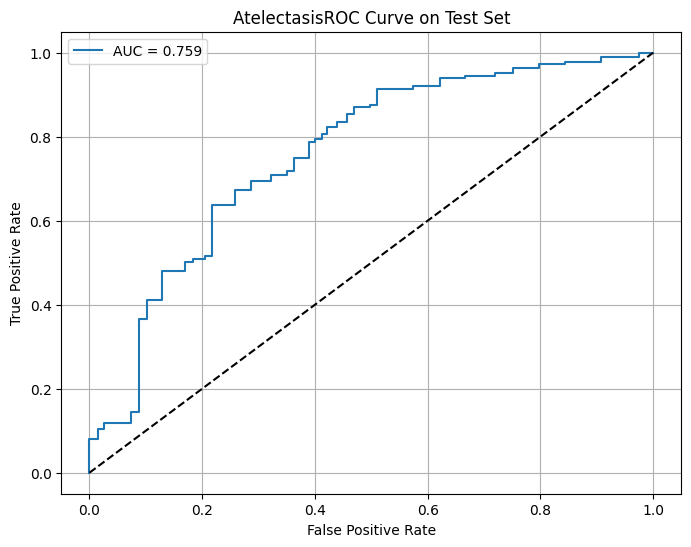


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.57      0.63      0.60       734
    Positive       0.79      0.75      0.77      1409

    accuracy                           0.71      2143
   macro avg       0.68      0.69      0.68      2143
weighted avg       0.72      0.71      0.71      2143



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle

#
def create_vgg16_model(num_classes=1, pretrained=True):
    model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1 if pretrained else None)

    model.classifier = nn.Sequential(
        nn.Linear(512 * 7 * 7, 4096),
        nn.ReLU(True),
        nn.Dropout(p=0.5),
        nn.Linear(4096, 1024),
        nn.ReLU(True),
        nn.Dropout(p=0.5),
        nn.Linear(1024, num_classes)
    )

    for m in model.classifier.modules():
        if isinstance(m, nn.Linear):
            nn.init.xavier_normal_(m.weight)
            nn.init.constant_(m.bias, 0)

    return model

vgg16_train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomRotation(15),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

vgg16_test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=vgg16_train_transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=vgg16_test_transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Atelectasis'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# VGG16 MODEL, OPTIMIZER, AND SCHEDULER INITIALIZATION

print("\n--- Starting VGG Model Initialization (VGG16 on Atelectasis dataset) ---")

# Initialize VGG16 model
model = create_vgg16_model(num_classes=1)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()

# Define optimizer with VGG16 parameters
optimizer = torch.optim.AdamW(
    model.parameters(),
    lr=1e-4,
    weight_decay=0.01,
    amsgrad=True
)

# Learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True
)


# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting VGG16 Model Training on Atelectasis dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    scheduler.step(val_auc)

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s') # Print epoch time
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        # UPDATED CHECKPOINT FILENAME
        torch.save(model.state_dict(), 'best_Atelectasis_vgg16_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot.png')
plt.show()

## Storing Model History
# UPDATED HISTORY FILENAME
history_filename = 'Atelectasis_vgg16_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=vgg16_test_transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
try:

    model.load_state_dict(torch.load('best_Atelectasis_vgg16_model.pth'))
except:
    model.load_state_dict(torch.load('best_Atelectasis_vgg16_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)  # Store the probabilities for class 1

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Atelectasis Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('Atelectasis confusion_matrix.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('AtelectasisROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Atelectasisroc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


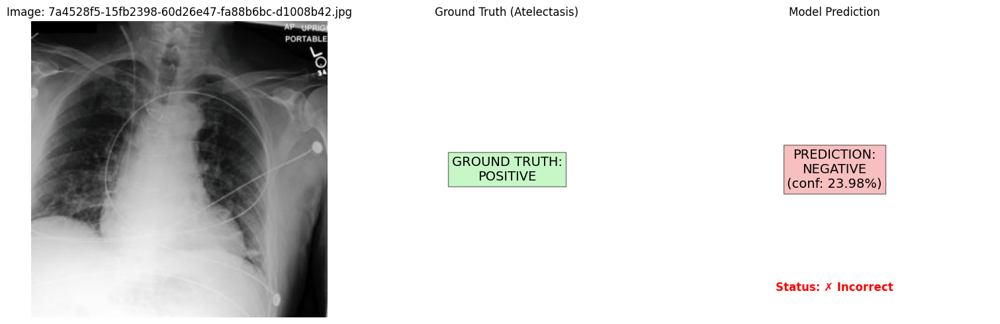


Image: 7a4528f5-15fb2398-60d26e47-fa88b6bc-d1008b42.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.2398)
Prediction Status: ✗ Incorrect
--------------------------------------------------


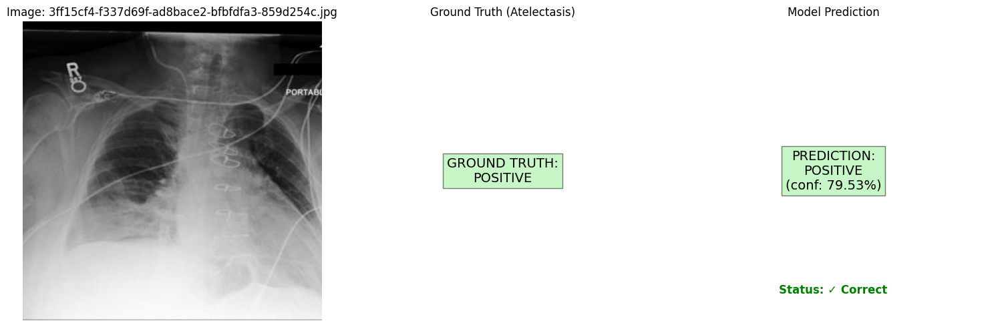


Image: 3ff15cf4-f337d69f-ad8bace2-bfbfdfa3-859d254c.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7953)
Prediction Status: ✓ Correct
--------------------------------------------------


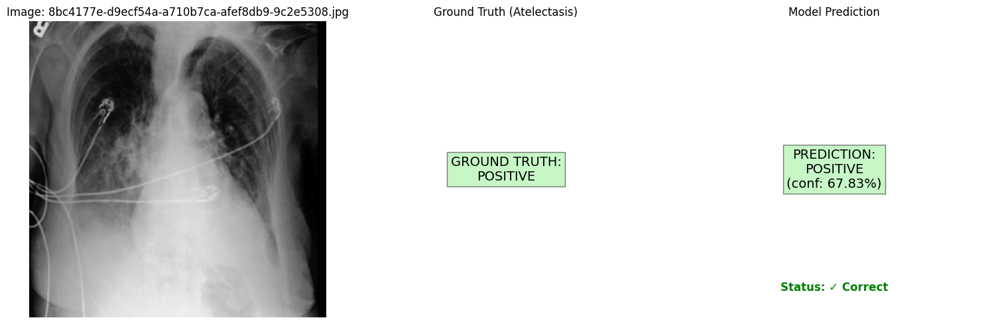


Image: 8bc4177e-d9ecf54a-a710b7ca-afef8db9-9c2e5308.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.6783)
Prediction Status: ✓ Correct
--------------------------------------------------


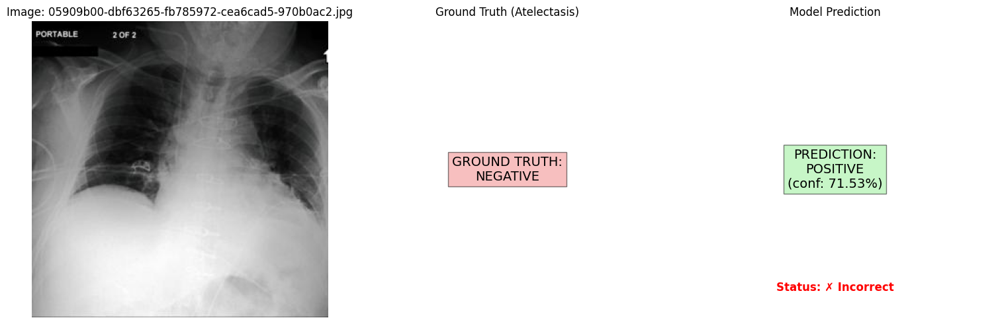


Image: 05909b00-dbf63265-fb785972-cea6cad5-970b0ac2.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.7153)
Prediction Status: ✗ Incorrect
--------------------------------------------------


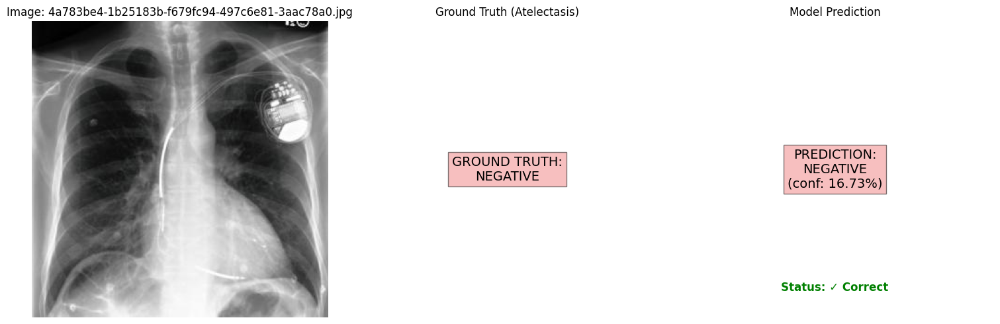


Image: 4a783be4-1b25183b-f679fc94-497c6e81-3aac78a0.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1673)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 3
Accuracy: 60.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Atelectasis'].values[0]

    # Move to device and make prediction
    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        # Fix: Squeeze and convert to scalar float for robustness
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Atelectasis)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---

try:
    model.load_state_dict(torch.load('best_Atelectasis_vgg16_model.pth'))
except:
    model.load_state_dict(torch.load('best_Atelectasis_vgg16_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## DenseNet121 - Atelectasis


--- Starting DenseNet121 Model Initialization for Atelectasis Classification ---

--- Starting DenseNet121 Model Training on Atelectasis dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/20 | Time: 77.21s
------------------------------------------------------------
Training:   Loss: 0.6441, Accuracy: 0.6710, F1: 0.6889, AUC-ROC: 0.7268
Validation: Loss: 0.5336, Accuracy: 0.7807, F1: 0.8299, AUC-ROC: 0.8170
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8170


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/20 | Time: 76.83s
------------------------------------------------------------
Training:   Loss: 0.5390, Accuracy: 0.7303, F1: 0.7491, AUC-ROC: 0.8024
Validation: Loss: 0.6746, Accuracy: 0.7105, F1: 0.8150, AUC-ROC: 0.7092


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/20 | Time: 76.87s
------------------------------------------------------------
Training:   Loss: 0.5283, Accuracy: 0.7423, F1: 0.7549, AUC-ROC: 0.8128
Validation: Loss: 0.4707, Accuracy: 0.8129, F1: 0.8638, AUC-ROC: 0.8353
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8353


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/20 | Time: 76.40s
------------------------------------------------------------
Training:   Loss: 0.5002, Accuracy: 0.7550, F1: 0.7640, AUC-ROC: 0.8347
Validation: Loss: 0.5804, Accuracy: 0.7018, F1: 0.7330, AUC-ROC: 0.8610
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8610


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/20 | Time: 76.38s
------------------------------------------------------------
Training:   Loss: 0.5105, Accuracy: 0.7555, F1: 0.7693, AUC-ROC: 0.8274
Validation: Loss: 0.5879, Accuracy: 0.7076, F1: 0.7423, AUC-ROC: 0.8239


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/20 | Time: 76.34s
------------------------------------------------------------
Training:   Loss: 0.5015, Accuracy: 0.7631, F1: 0.7772, AUC-ROC: 0.8337
Validation: Loss: 0.5261, Accuracy: 0.7602, F1: 0.8093, AUC-ROC: 0.8218


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 7/20 | Time: 76.39s
------------------------------------------------------------
Training:   Loss: 0.4892, Accuracy: 0.7675, F1: 0.7756, AUC-ROC: 0.8444
Validation: Loss: 0.8607, Accuracy: 0.4708, F1: 0.3513, AUC-ROC: 0.8010


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 8/20 | Time: 76.32s
------------------------------------------------------------
Training:   Loss: 0.4595, Accuracy: 0.7848, F1: 0.7863, AUC-ROC: 0.8667
Validation: Loss: 0.5715, Accuracy: 0.7339, F1: 0.7764, AUC-ROC: 0.8156


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 9/20 | Time: 76.58s
------------------------------------------------------------
Training:   Loss: 0.4492, Accuracy: 0.7883, F1: 0.7920, AUC-ROC: 0.8710
Validation: Loss: 0.6345, Accuracy: 0.6959, F1: 0.7306, AUC-ROC: 0.8114

Early stopping triggered after epoch 9. Validation AUC-ROC did not improve for 5 epochs.


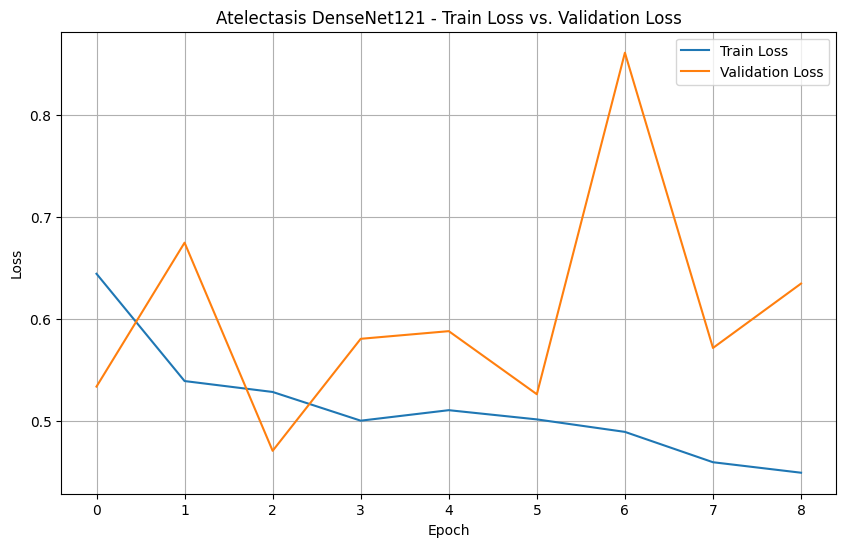


Model training history saved to Atelectasis_densenet121_history.pkl

--- Starting DenseNet121 Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.8266
Test Accuracy:   0.6034
Test F1 Score:   0.6502
Test AUC-ROC:    0.7100


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

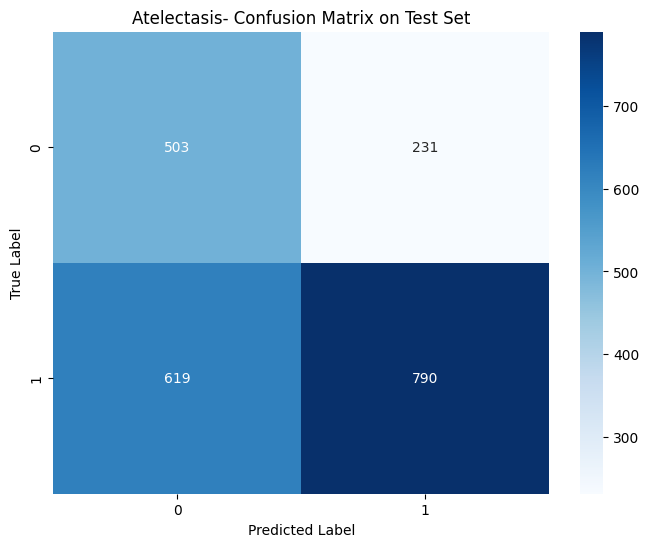

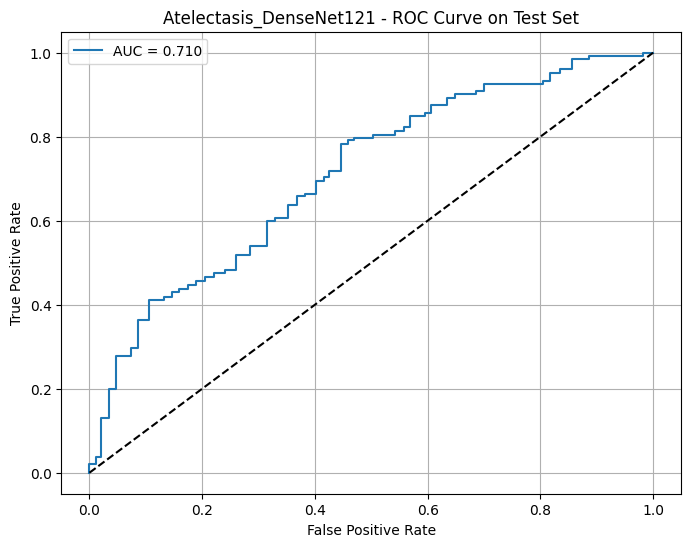


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.45      0.69      0.54       734
    Positive       0.77      0.56      0.65      1409

    accuracy                           0.60      2143
   macro avg       0.61      0.62      0.60      2143
weighted avg       0.66      0.60      0.61      2143



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle
from torch.optim.lr_scheduler import ReduceLROnPlateau
# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Atelectasis'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)


# Initialize DenseNet121 model
print("\n--- Starting DenseNet121 Model Initialization for Atelectasis Classification ---")

model = models.densenet121(weights=models.DenseNet121_Weights.IMAGENET1K_V1)

num_ftrs = model.classifier.in_features
model.classifier = nn.Sequential(
    nn.BatchNorm1d(num_ftrs),
    nn.Dropout(0.4),
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.BatchNorm1d(512),
    nn.Dropout(0.4),
    nn.Linear(512, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# ----------------------------------------------------------------------
print("\n--- Starting DenseNet121 Model Training on Atelectasis dataset ---")

num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:   Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Atelectasis_densenet121_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# Plot Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Atelectasis DenseNet121 - Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('Atelectasis densenet121_train_val_loss_plot.png')
plt.show()

# Store Model History
history_filename = 'Atelectasis_densenet121_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
# Evaluation on Test Dataset
print("\n--- Starting DenseNet121 Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)

# Load best model
model.load_state_dict(torch.load('best_Atelectasis_densenet121_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# Calculate final metrics and generate plots
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Atelectasis- Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('Atelectasis_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Atelectasis_DenseNet121 - ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Atelectasis_densenet121_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))




--- Randomly Predicting on 5 Test Images ---


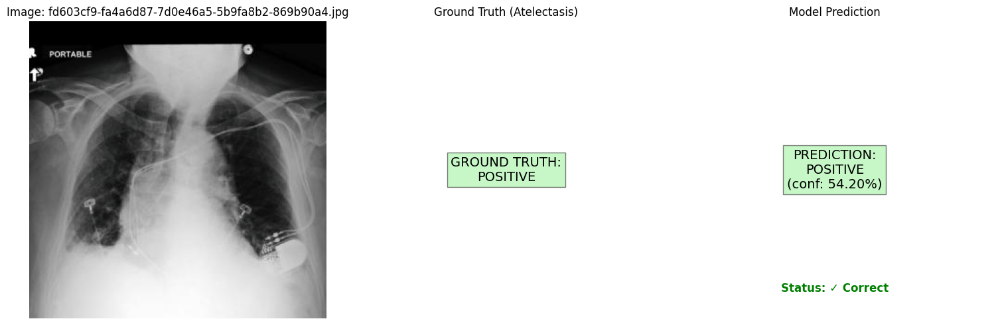


Image: fd603cf9-fa4a6d87-7d0e46a5-5b9fa8b2-869b90a4.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.5420)
Prediction Status: ✓ Correct
--------------------------------------------------


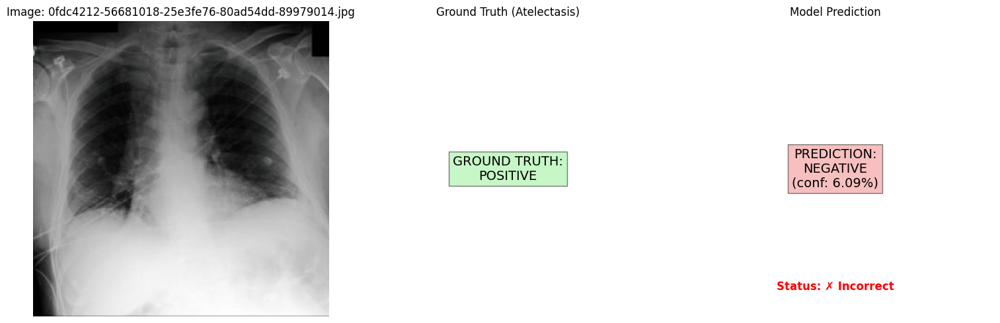


Image: 0fdc4212-56681018-25e3fe76-80ad54dd-89979014.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.0609)
Prediction Status: ✗ Incorrect
--------------------------------------------------


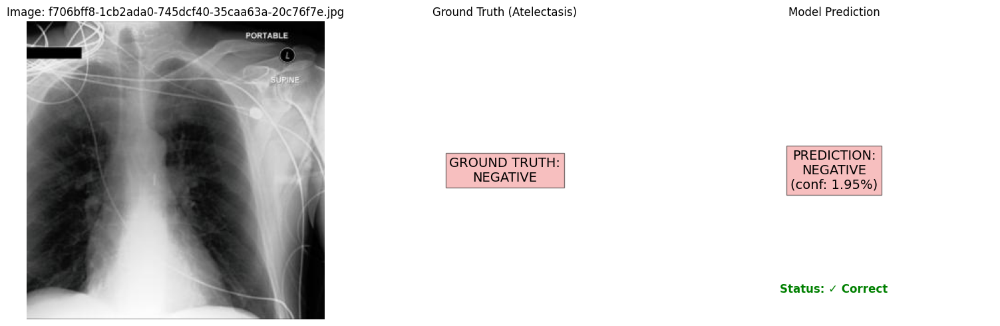


Image: f706bff8-1cb2ada0-745dcf40-35caa63a-20c76f7e.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0195)
Prediction Status: ✓ Correct
--------------------------------------------------


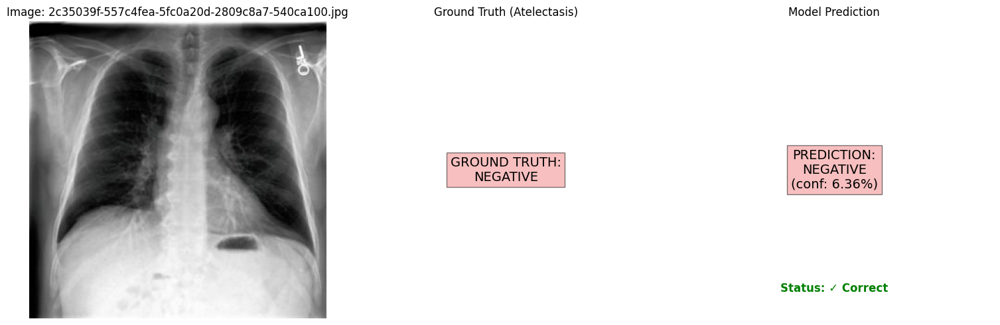


Image: 2c35039f-557c4fea-5fc0a20d-2809c8a7-540ca100.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0636)
Prediction Status: ✓ Correct
--------------------------------------------------


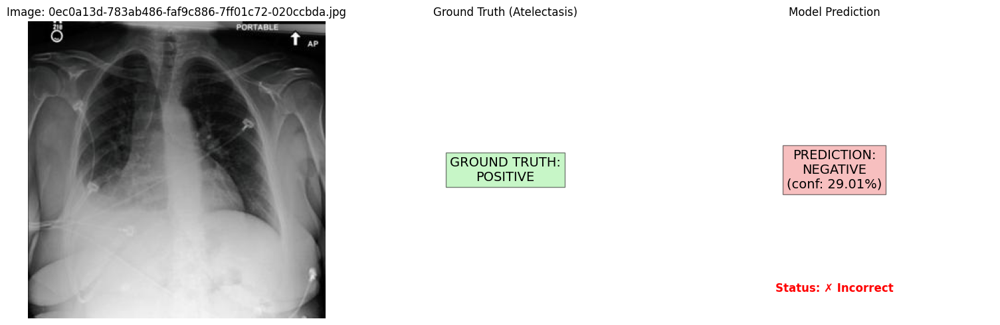


Image: 0ec0a13d-783ab486-faf9c886-7ff01c72-020ccbda.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.2901)
Prediction Status: ✗ Incorrect
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 3
Accuracy: 60.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Atelectasis'].values[0]

    # Move to device and make prediction
    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Atelectasis)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")



try:
    model.load_state_dict(torch.load('best_Atelectasis_densenet121_model.pth'))
except:
    model.load_state_dict(torch.load('best_Atelectasis_densenet121_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## InceptionNet V3 - Atelectasis


--- Starting InceptionV3 Model Initialization for Atelectasis Classification ---
Model initialized on: cuda:0
Total parameters: 25,393,634
Trainable parameters: 25,393,634

--- Starting InceptionV3 Model Training on Atelectasis dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/20 | Time: 101.24s
------------------------------------------------------------
Training:   Loss: 0.8428, Accuracy: 0.6881, F1: 0.7044, AUC-ROC: 0.7516
Validation: Loss: 0.4940, Accuracy: 0.8099, F1: 0.8602, AUC-ROC: 0.8324
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8324


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/20 | Time: 100.50s
------------------------------------------------------------
Training:   Loss: 0.7552, Accuracy: 0.7354, F1: 0.7448, AUC-ROC: 0.8048
Validation: Loss: 0.6514, Accuracy: 0.6637, F1: 0.6950, AUC-ROC: 0.8275


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/20 | Time: 100.97s
------------------------------------------------------------
Training:   Loss: 0.7397, Accuracy: 0.7467, F1: 0.7552, AUC-ROC: 0.8133
Validation: Loss: 0.4974, Accuracy: 0.7778, F1: 0.8462, AUC-ROC: 0.8375
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8375


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/20 | Time: 99.98s
------------------------------------------------------------
Training:   Loss: 0.7383, Accuracy: 0.7467, F1: 0.7590, AUC-ROC: 0.8152
Validation: Loss: 0.5699, Accuracy: 0.7778, F1: 0.8281, AUC-ROC: 0.8193


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/20 | Time: 113.36s
------------------------------------------------------------
Training:   Loss: 0.6661, Accuracy: 0.7737, F1: 0.7741, AUC-ROC: 0.8530
Validation: Loss: 0.5753, Accuracy: 0.7953, F1: 0.8491, AUC-ROC: 0.8406
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8406


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/20 | Time: 103.37s
------------------------------------------------------------
Training:   Loss: 0.6518, Accuracy: 0.7908, F1: 0.7989, AUC-ROC: 0.8625
Validation: Loss: 0.5144, Accuracy: 0.7749, F1: 0.8171, AUC-ROC: 0.8375


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 7/20 | Time: 102.57s
------------------------------------------------------------
Training:   Loss: 0.6152, Accuracy: 0.8063, F1: 0.8046, AUC-ROC: 0.8792
Validation: Loss: 0.6499, Accuracy: 0.5877, F1: 0.6901, AUC-ROC: 0.5971


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 8/20 | Time: 101.07s
------------------------------------------------------------
Training:   Loss: 0.5799, Accuracy: 0.8151, F1: 0.8157, AUC-ROC: 0.8925
Validation: Loss: 0.5994, Accuracy: 0.6579, F1: 0.7008, AUC-ROC: 0.7979


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 9/20 | Time: 100.87s
------------------------------------------------------------
Training:   Loss: 0.4890, Accuracy: 0.8573, F1: 0.8577, AUC-ROC: 0.9259
Validation: Loss: 0.7427, Accuracy: 0.6228, F1: 0.6282, AUC-ROC: 0.8353


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 10/20 | Time: 100.41s
------------------------------------------------------------
Training:   Loss: 0.4119, Accuracy: 0.8799, F1: 0.8791, AUC-ROC: 0.9463
Validation: Loss: 0.8024, Accuracy: 0.7018, F1: 0.7560, AUC-ROC: 0.7744

Early stopping triggered after epoch 10. Validation AUC-ROC did not improve for 5 epochs.


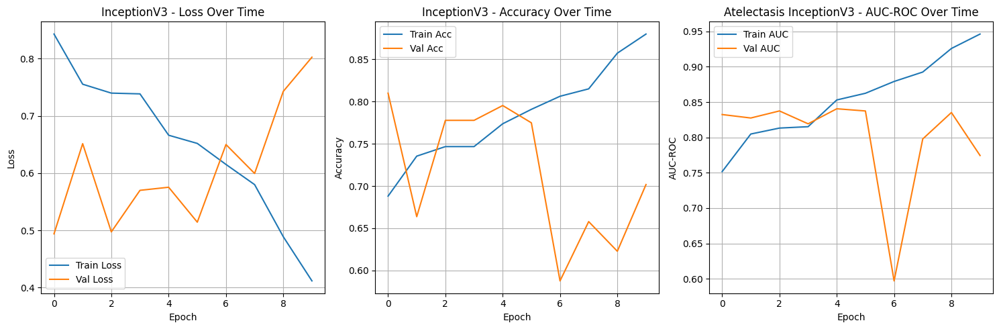


Model training history saved to Atelectasis_inceptionv3_history.pkl

--- Starting InceptionV3 Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.7912
Test Accuracy:   0.6748
Test F1 Score:   0.7612
Test AUC-ROC:    0.7350


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

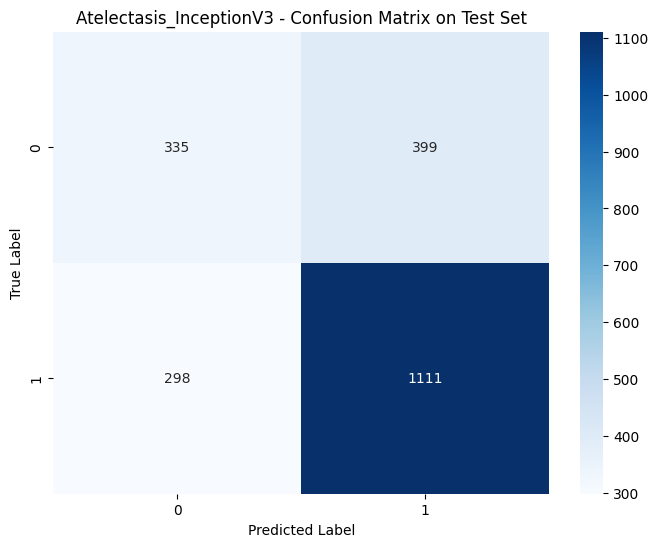

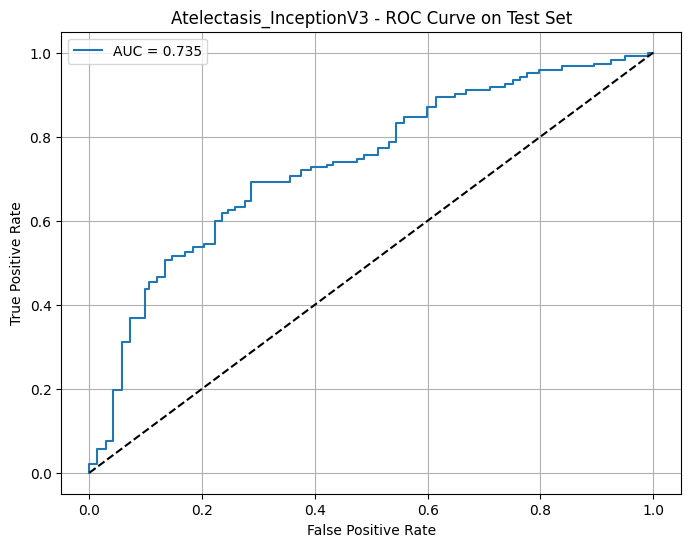


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.53      0.46      0.49       734
    Positive       0.74      0.79      0.76      1409

    accuracy                           0.67      2143
   macro avg       0.63      0.62      0.63      2143
weighted avg       0.67      0.67      0.67      2143



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle

transform = transforms.Compose([
    transforms.Resize((299, 299)),  # Inception V3  299x299 input
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Atelectasis'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0,
    pin_memory=True
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0,
    pin_memory=True
)

# InceptionNet V3 MODEL

print("\n--- Starting InceptionV3 Model Initialization for Atelectasis Classification ---")

# Initialize InceptionV3 with pretrained weights
model = models.inception_v3(weights=models.Inception_V3_Weights.IMAGENET1K_V1)


num_ftrs = model.fc.in_features
model.fc = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.Dropout(0.4),
    nn.Linear(512, 1)
)

# Modify auxiliary classifier
num_ftrs_aux = model.AuxLogits.fc.in_features
model.AuxLogits.fc = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(num_ftrs_aux, 1)
)

# Move model to GPU if available
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

print(f"Model initialized on: {device}")
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs, aux_outputs = model(inputs)

        # Calculate primary and auxiliary losses
        loss1 = criterion(outputs.squeeze(), labels)
        loss2 = criterion(aux_outputs.squeeze(), labels)
        loss = loss1 + 0.4 * loss2

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            if isinstance(outputs, tuple):
                outputs = outputs[0]

            loss = criterion(outputs.squeeze(), labels)
            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Training loop
print("\n--- Starting InceptionV3 Model Training on Atelectasis dataset ---")

num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:   Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Atelectasis_inceptionv3_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# Plot training history
plt.figure(figsize=(15, 5))

# Plot Loss
plt.subplot(1, 3, 1)
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Val Loss')
plt.title('InceptionV3 - Loss Over Time')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

# Plot Accuracy
plt.subplot(1, 3, 2)
plt.plot(history['train_acc'], label='Train Acc')
plt.plot(history['val_acc'], label='Val Acc')
plt.title('InceptionV3 - Accuracy Over Time')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)

# Plot AUC-ROC
plt.subplot(1, 3, 3)
plt.plot(history['train_auc'], label='Train AUC')
plt.plot(history['val_auc'], label='Val AUC')
plt.title('Atelectasis InceptionV3 - AUC-ROC Over Time')
plt.xlabel('Epoch')
plt.ylabel('AUC-ROC')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('Atelectasis_inceptionv3_training_history.png')
plt.show()

# Save training history
history_filename = 'Atelectasis_inceptionv3_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")
# ----------------------------------------------------------------------
# Evaluation on Test Dataset
print("\n--- Starting InceptionV3 Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0,
    pin_memory=True
)

# Load best model
model.load_state_dict(torch.load('best_Atelectasis_inceptionv3_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# Calculate final metrics and generate plots
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        if isinstance(outputs, tuple):
            outputs = outputs[0]

        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Atelectasis_InceptionV3 - Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('Atelectasis_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Atelectasis_InceptionV3 - ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Atelectasis_inceptionv3_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


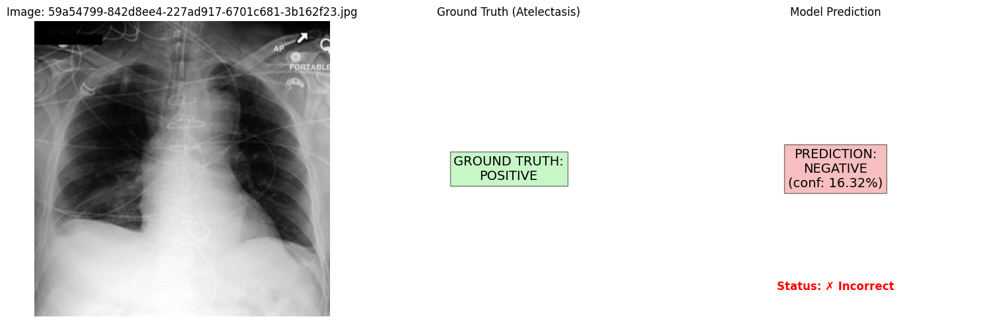


Image: 59a54799-842d8ee4-227ad917-6701c681-3b162f23.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.1632)
Prediction Status: ✗ Incorrect
--------------------------------------------------


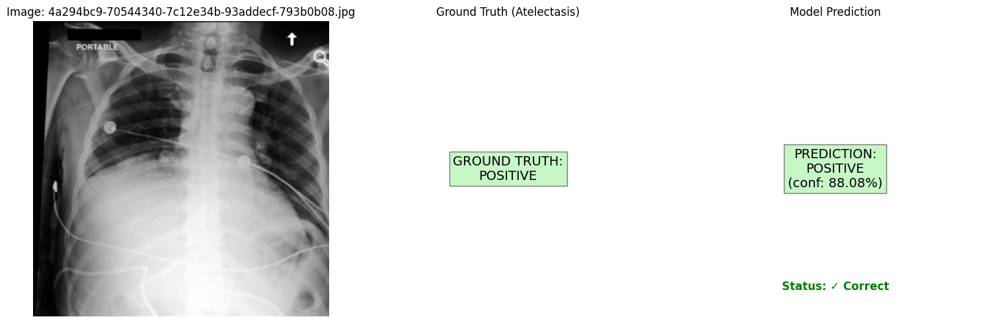


Image: 4a294bc9-70544340-7c12e34b-93addecf-793b0b08.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8808)
Prediction Status: ✓ Correct
--------------------------------------------------


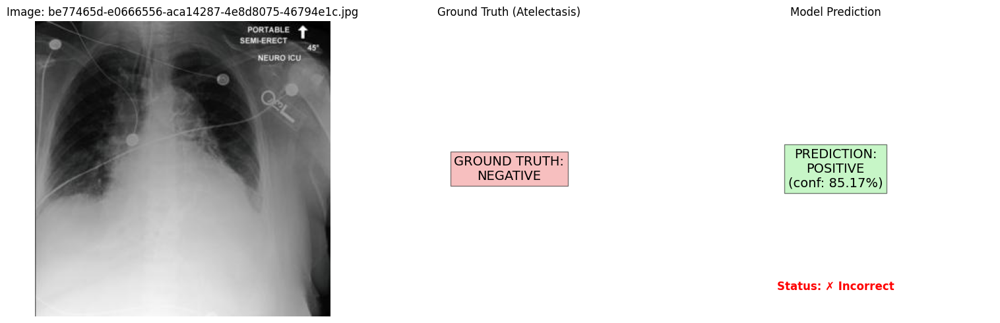


Image: be77465d-e0666556-aca14287-4e8d8075-46794e1c.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.8517)
Prediction Status: ✗ Incorrect
--------------------------------------------------


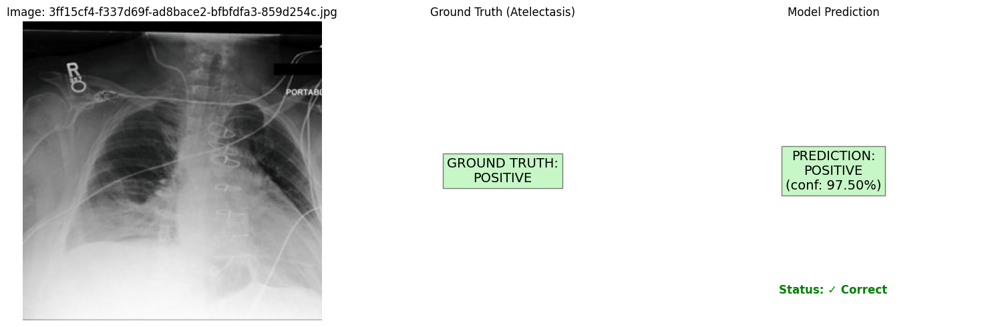


Image: 3ff15cf4-f337d69f-ad8bace2-bfbfdfa3-859d254c.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9750)
Prediction Status: ✓ Correct
--------------------------------------------------


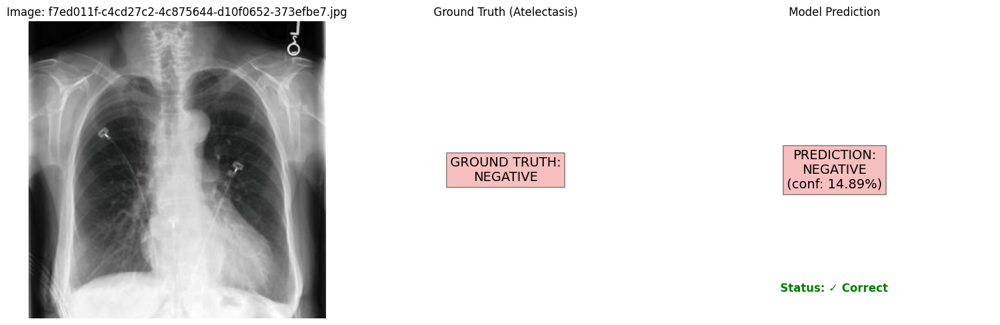


Image: f7ed011f-c4cd27c2-4c875644-d10f0652-373efbe7.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1489)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 3
Accuracy: 60.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Atelectasis'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Atelectasis)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Atelectasis_inceptionv3_model.pth'))
except:
    model.load_state_dict(torch.load('best_Atelectasis_inceptionv3_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## MobileNet V3 - Atelectasis


--- Starting MobileNetV3-Large Model Initialization (MobileNetV3 on Atelectasis dataset) ---
Model initialized on: cuda:0
Total parameters: 4,858,417
Trainable parameters: 4,858,417

--- Starting MobileNetV3-Large Model Training on Atelectasis dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/20 | Time: 57.79s
------------------------------------------------------------
Training:    Loss: 0.5605, Accuracy: 0.7181, F1: 0.7359, AUC-ROC: 0.7857
Validation: Loss: 0.4928, Accuracy: 0.7982, F1: 0.8565, AUC-ROC: 0.8247
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8247


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/20 | Time: 56.71s
------------------------------------------------------------
Training:    Loss: 0.4656, Accuracy: 0.7897, F1: 0.7989, AUC-ROC: 0.8626
Validation: Loss: 0.5475, Accuracy: 0.7222, F1: 0.7836, AUC-ROC: 0.7737


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/20 | Time: 57.02s
------------------------------------------------------------
Training:    Loss: 0.3904, Accuracy: 0.8375, F1: 0.8385, AUC-ROC: 0.9050
Validation: Loss: 0.5971, Accuracy: 0.7778, F1: 0.8319, AUC-ROC: 0.8076


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/20 | Time: 56.90s
------------------------------------------------------------
Training:    Loss: 0.3051, Accuracy: 0.8804, F1: 0.8801, AUC-ROC: 0.9427
Validation: Loss: 0.7838, Accuracy: 0.6404, F1: 0.6574, AUC-ROC: 0.8040


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/20 | Time: 57.13s
------------------------------------------------------------
Training:    Loss: 0.2562, Accuracy: 0.9046, F1: 0.9059, AUC-ROC: 0.9601
Validation: Loss: 0.8301, Accuracy: 0.7544, F1: 0.8009, AUC-ROC: 0.8165


Training:   0%|          | 0/136 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/20 | Time: 57.08s
------------------------------------------------------------
Training:    Loss: 0.2058, Accuracy: 0.9222, F1: 0.9224, AUC-ROC: 0.9735
Validation: Loss: 0.9280, Accuracy: 0.7281, F1: 0.7759, AUC-ROC: 0.8007

Early stopping triggered after epoch 6. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---


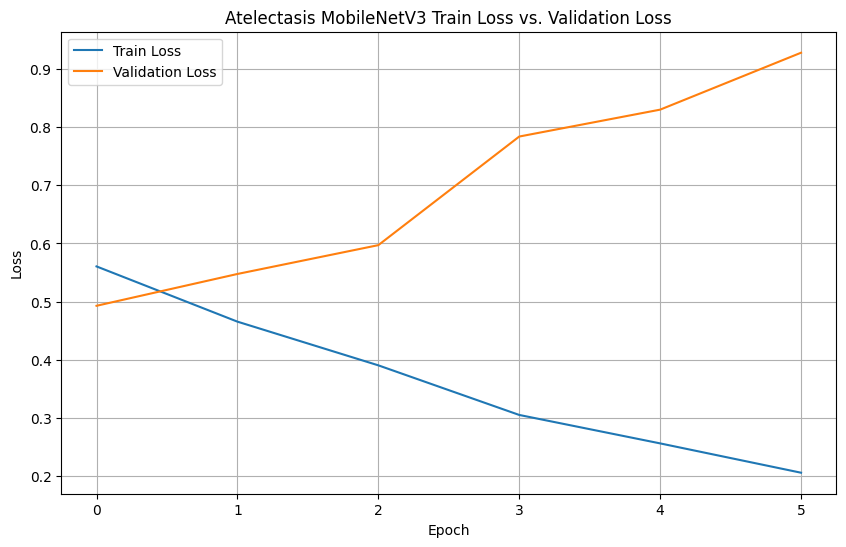


Model training history saved to Atelectasis_mobilenetv3_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.5765
Test Accuracy:   0.7219
Test F1 Score:   0.8051
Test AUC-ROC:    0.7270

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

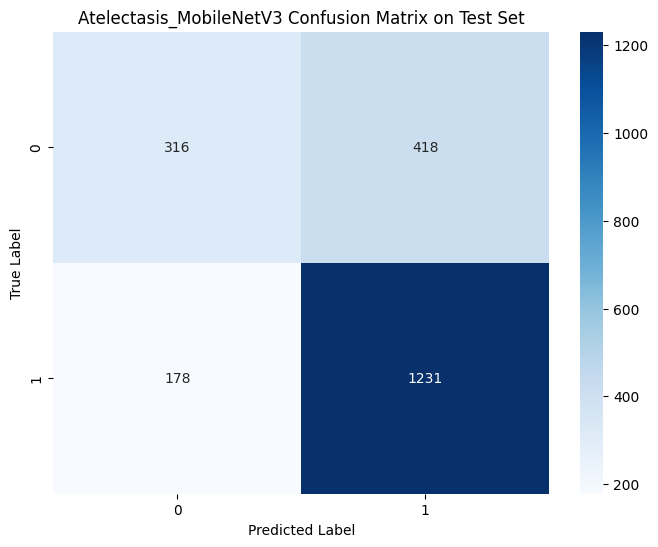

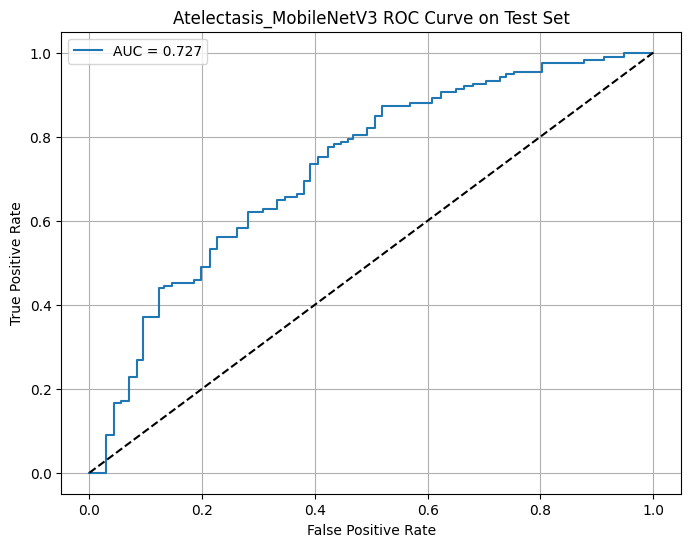


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.64      0.43      0.51       734
    Positive       0.75      0.87      0.81      1409

    accuracy                           0.72      2143
   macro avg       0.69      0.65      0.66      2143
weighted avg       0.71      0.72      0.71      2143



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Atelectasis'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
#  MobileNetV3-Large Model
print("\n--- Starting MobileNetV3-Large Model Initialization (MobileNetV3 on Atelectasis dataset) ---")


model = models.mobilenet_v3_large(weights=models.MobileNet_V3_Large_Weights.IMAGENET1K_V1)

num_ftrs = model.classifier[-1].in_features
model.classifier[-1] = nn.Sequential(
    nn.Dropout(p=0.3),
    nn.Linear(num_ftrs, 512),
    nn.Hardswish(),
    nn.Dropout(p=0.3),
    nn.Linear(512, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

print(f"Model initialized on: {device}")
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# ----------------------------------------------------------------------
print("\n--- Starting MobileNetV3-Large Model Training on Atelectasis dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
# Early Stopping variables
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Atelectasis_mobilenetv3_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

# Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Atelectasis MobileNetV3 Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('Atelectasis_mobilenetv3_train_val_loss_plot.png')
plt.show()

# Storing Model History
history_filename = 'Atelectasis_mobilenetv3_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")

# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset and loader
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# Load best model
model.load_state_dict(torch.load('best_Atelectasis_mobilenetv3_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Atelectasis_MobileNetV3 Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('Atelectasis mobilenetv3_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Atelectasis_MobileNetV3 ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Cardiomegaly_mobilenetv3_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


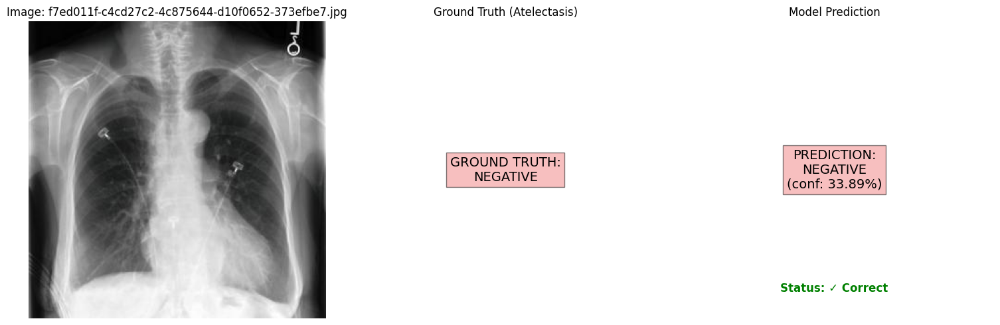


Image: f7ed011f-c4cd27c2-4c875644-d10f0652-373efbe7.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.3389)
Prediction Status: ✓ Correct
--------------------------------------------------


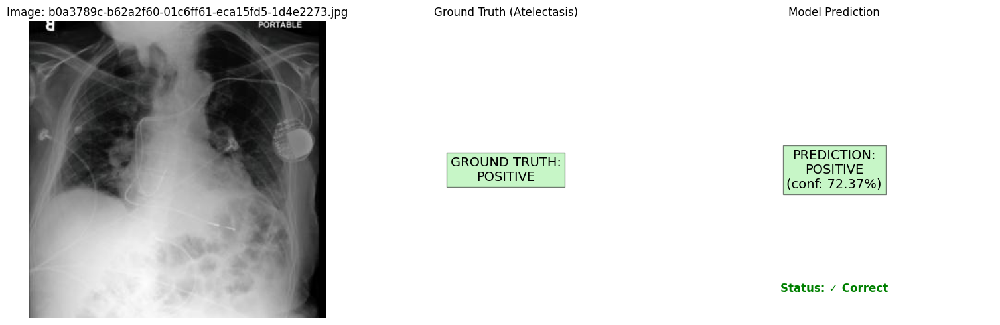


Image: b0a3789c-b62a2f60-01c6ff61-eca15fd5-1d4e2273.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7237)
Prediction Status: ✓ Correct
--------------------------------------------------


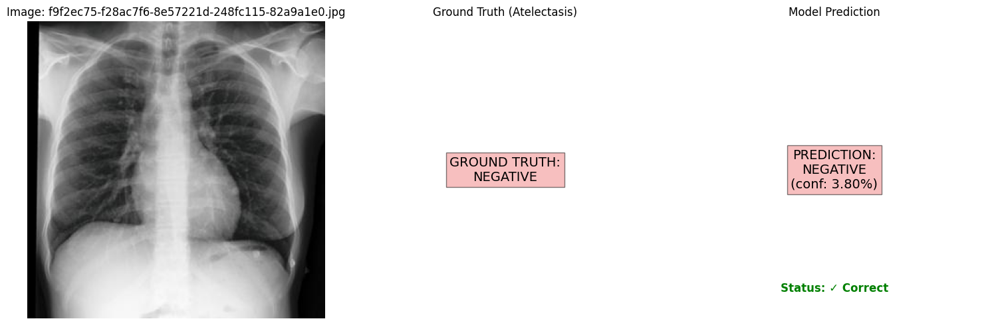


Image: f9f2ec75-f28ac7f6-8e57221d-248fc115-82a9a1e0.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0380)
Prediction Status: ✓ Correct
--------------------------------------------------


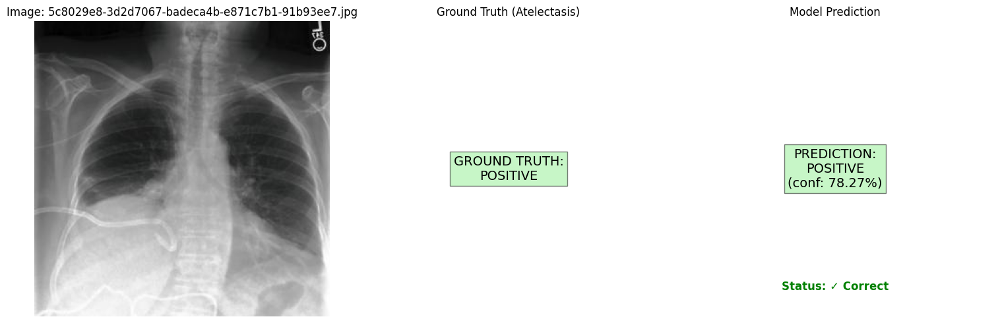


Image: 5c8029e8-3d2d7067-badeca4b-e871c7b1-91b93ee7.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7827)
Prediction Status: ✓ Correct
--------------------------------------------------


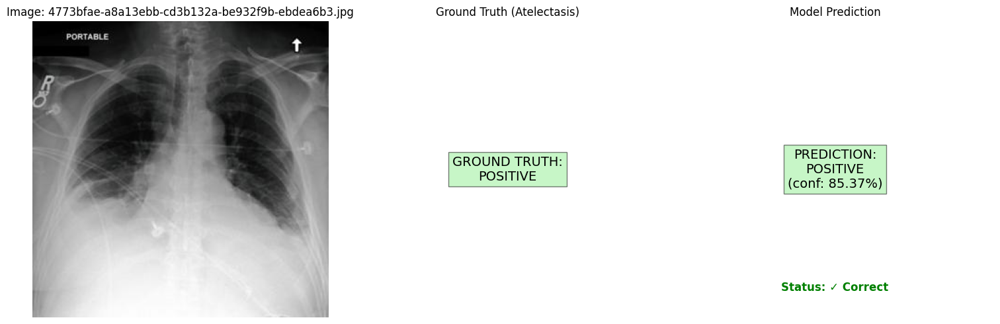


Image: 4773bfae-a8a13ebb-cd3b132a-be932f9b-ebdea6b3.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8537)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 5
Accuracy: 100.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Atelectasis'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Atelectasis)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Atelectasis_mobilenetv3_model.pth'))
except:
    model.load_state_dict(torch.load('best_Atelectasis_mobilenetv3_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

# Cardiomegaly Models

STATISTICAL ANALYSIS FOR CLASS: CARDIOMEGALY

--- TRAIN SET (Cardiomegaly_train.csv) ---
Total entries (Row Count): 5,391

Condition label distribution (per column):
  • Cardiomegaly   :
    - Positive (1) :   3,346 ( 62.1%)
    - Negative (0) :   2,045
    - Total Labeled:   5,391

--- VAL SET (Cardiomegaly_val.csv) ---
Total entries (Row Count): 444

Condition label distribution (per column):
  • Cardiomegaly   :
    - Positive (1) :     268 ( 60.4%)
    - Negative (0) :     176
    - Total Labeled:     444

--- TEST SET (Cardiomegaly_test.csv) ---
Total entries (Row Count): 2,530

Condition label distribution (per column):
  • Cardiomegaly   :
    - Positive (1) :   1,444 ( 57.1%)
    - Negative (0) :   1,086
    - Total Labeled:   2,530

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
PLOTTING TRAINING SET LABEL DISTRIBUTION FOR: CARDIOMEGALY
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

Training Set total label counts: 
0.0    2045


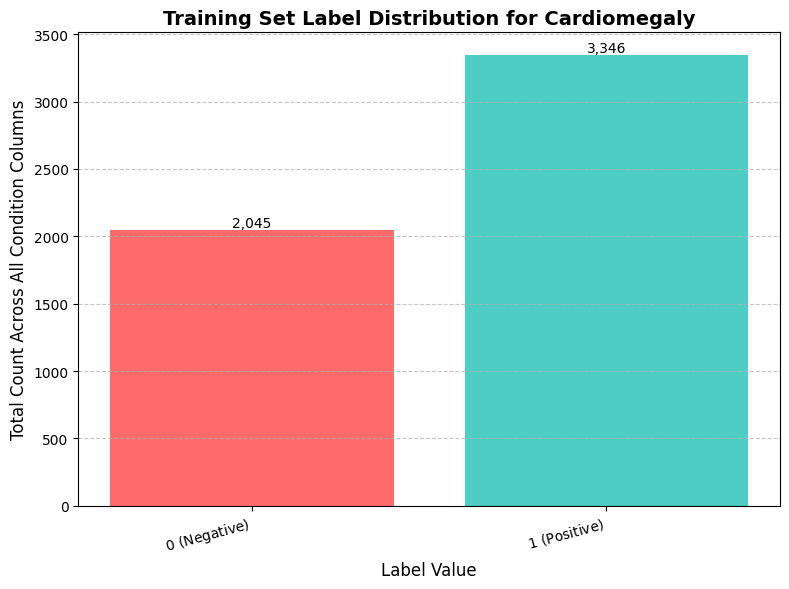

Plot saved as 'cardiomegaly_label_distribution.png'

--- Starting Data Load for Class: Cardiomegaly ---
  Loaded train CSV: 5,391 entries. Verified images: 5,391.
  Loaded val CSV: 444 entries. Verified images: 444.
  Loaded test CSV: 2,530 entries. Verified images: 2,530.
Sucesfully Loaded Dataset


In [ ]:
target_class="Cardiomegaly"
# 1. Analyze the CSVs and retrieve the training dataframe
train_df_result = analyze_class_csv_stats(class_name=target_class)
# 2. Plot the label distribution for the retrieved training dataframe
visualize_training_label_distribution(class_name=target_class, train_df=train_df_result)
loaded_data = load_dataset(class_name="Cardiomegaly")

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
from torch.utils.data import DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score
from torchvision import transforms
from torch.utils.data import Dataset
import torch.nn.functional as F
from PIL import Image

# Custom Dataset class
class ChestXRayDataset(Dataset):
    def __init__(self, dataframe, image_paths, transform=None):
        self.dataframe = dataframe
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        # Get the label from the dataframe
        df_idx = self.dataframe.index[self.dataframe['cxr_path'].str.contains(os.path.basename(img_path))][0]
        label = torch.tensor(self.dataframe.iloc[df_idx]['Cardiomegaly'], dtype=torch.float32)

        return image, label

# Data transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

print ("Cardiomegaly CXR dataset loaded" )

Cardiomegaly CXR dataset loaded


## ResNet 18 - Cardiomegaly


--- Starting ResNet Model Initialization (ResNet18 on Cardiomegaly dataset) ---


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 164MB/s] 



--- Starting ResNet Model Training on Cardiomegaly dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 1/20 | Time: 53.76s
------------------------------------------------------------
Training:    Loss: 0.5933, Accuracy: 0.6963, F1: 0.6960, AUC-ROC: 0.7585
Validation: Loss: 0.9346, Accuracy: 0.5968, F1: 0.5445, AUC-ROC: 0.7752
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7752


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 2/20 | Time: 51.27s
------------------------------------------------------------
Training:    Loss: 0.5423, Accuracy: 0.7327, F1: 0.7464, AUC-ROC: 0.8017
Validation: Loss: 0.6631, Accuracy: 0.6419, F1: 0.7665, AUC-ROC: 0.7036


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 3/20 | Time: 50.86s
------------------------------------------------------------
Training:    Loss: 0.5015, Accuracy: 0.7559, F1: 0.7557, AUC-ROC: 0.8353
Validation: Loss: 0.5988, Accuracy: 0.6667, F1: 0.7121, AUC-ROC: 0.7449


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 4/20 | Time: 52.30s
------------------------------------------------------------
Training:    Loss: 0.4790, Accuracy: 0.7737, F1: 0.7702, AUC-ROC: 0.8524
Validation: Loss: 0.8553, Accuracy: 0.6306, F1: 0.6150, AUC-ROC: 0.7626


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 5/20 | Time: 50.35s
------------------------------------------------------------
Training:    Loss: 0.4328, Accuracy: 0.8034, F1: 0.8022, AUC-ROC: 0.8819
Validation: Loss: 0.6139, Accuracy: 0.7072, F1: 0.7400, AUC-ROC: 0.7797
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7797


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 6/20 | Time: 50.18s
------------------------------------------------------------
Training:    Loss: 0.3516, Accuracy: 0.8535, F1: 0.8535, AUC-ROC: 0.9235
Validation: Loss: 0.6485, Accuracy: 0.6734, F1: 0.7280, AUC-ROC: 0.7325


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 7/20 | Time: 50.22s
------------------------------------------------------------
Training:    Loss: 0.3001, Accuracy: 0.8774, F1: 0.8816, AUC-ROC: 0.9447
Validation: Loss: 0.6807, Accuracy: 0.6757, F1: 0.7252, AUC-ROC: 0.7637


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 8/20 | Time: 50.17s
------------------------------------------------------------
Training:    Loss: 0.2372, Accuracy: 0.9069, F1: 0.9063, AUC-ROC: 0.9654
Validation: Loss: 0.9915, Accuracy: 0.7050, F1: 0.7842, AUC-ROC: 0.7132


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 9/20 | Time: 49.92s
------------------------------------------------------------
Training:    Loss: 0.2035, Accuracy: 0.9210, F1: 0.9215, AUC-ROC: 0.9746
Validation: Loss: 1.1440, Accuracy: 0.6734, F1: 0.7611, AUC-ROC: 0.7214


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 10/20 | Time: 50.22s
------------------------------------------------------------
Training:    Loss: 0.1672, Accuracy: 0.9375, F1: 0.9357, AUC-ROC: 0.9824
Validation: Loss: 1.3764, Accuracy: 0.6869, F1: 0.7825, AUC-ROC: 0.7400

Early stopping triggered after epoch 10. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---


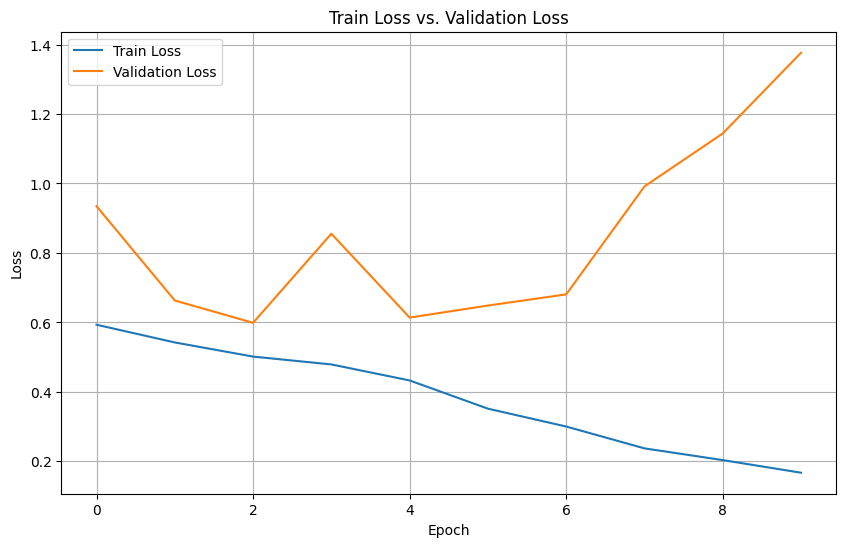


Model training history saved to Cardiomegaly_resnet18_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/80 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.7139
Test Accuracy:   0.7123
Test F1 Score:   0.7415
Test AUC-ROC:    0.7395

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/80 [00:00<?, ?it/s]

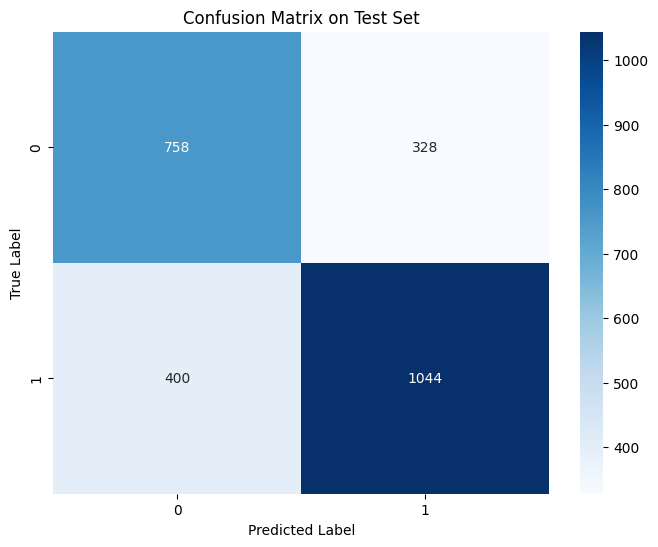

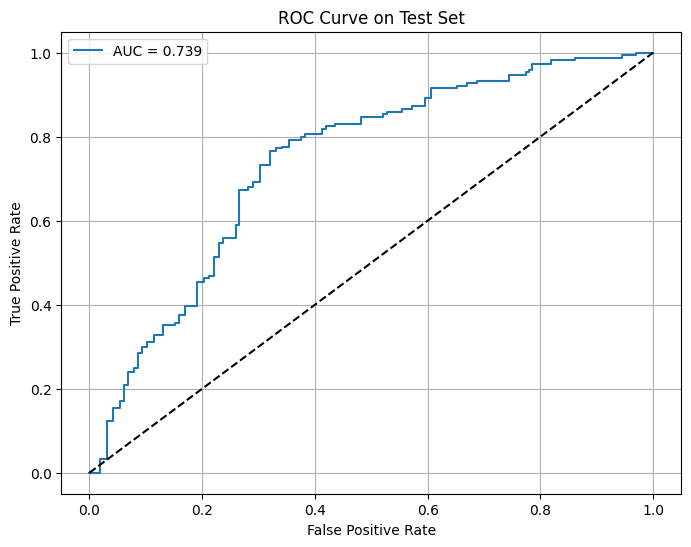


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.65      0.70      0.68      1086
    Positive       0.76      0.72      0.74      1444

    accuracy                           0.71      2530
   macro avg       0.71      0.71      0.71      2530
weighted avg       0.72      0.71      0.71      2530



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle


# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Cardiomegaly'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------

print("\n--- Starting ResNet Model Initialization (ResNet18 on Cardiomegaly dataset) ---")

# Initialize ResNet18 model
model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 1)  # Binary classification

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()


optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Training on Cardiomegaly dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
# Early Stopping variables
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

# Wrap the epoch loop with tqdm for overall progress
for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()
    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        # UPDATED CHECKPOINT FILENAME
        torch.save(model.state_dict(), 'best_Cardiomegaly_resnet18_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot.png')
plt.show()

## Storing Model History
# UPDATED HISTORY FILENAME
history_filename = 'Cardiomegaly_resnet18_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
try:

    model.load_state_dict(torch.load('best_Cardiomegaly_resnet18_model.pth'))
except:
    model.load_state_dict(torch.load('best_Cardiomegaly_resnet18_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)
        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)  # Use y_prob directly for binary classification
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))

### Prediction on sample image


--- Randomly Predicting on 5 Test Images ---


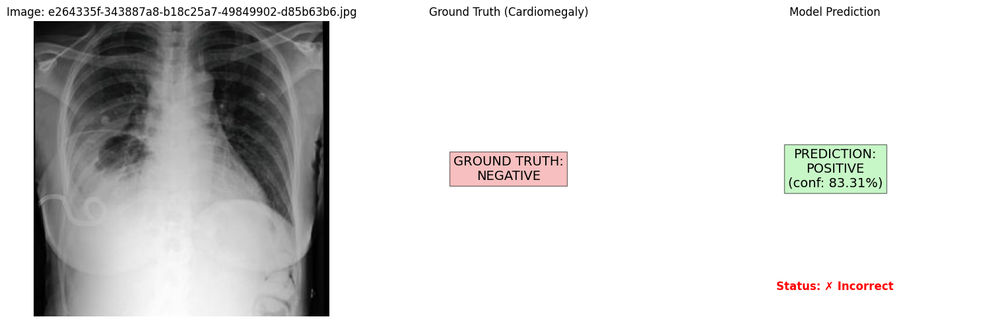


Image: e264335f-343887a8-b18c25a7-49849902-d85b63b6.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.8331)
Prediction Status: ✗ Incorrect
--------------------------------------------------


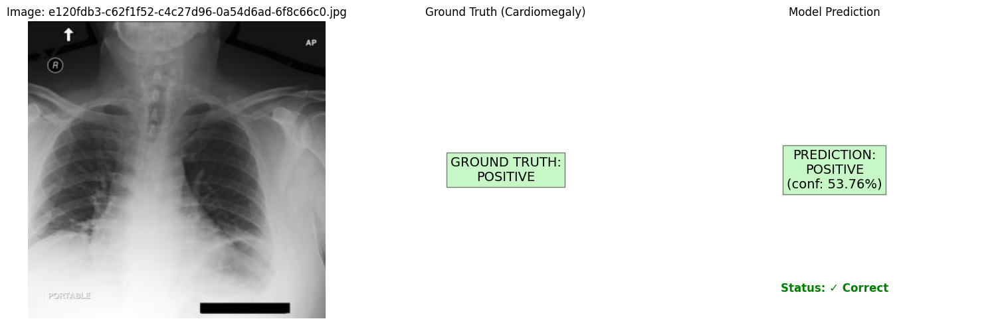


Image: e120fdb3-c62f1f52-c4c27d96-0a54d6ad-6f8c66c0.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.5376)
Prediction Status: ✓ Correct
--------------------------------------------------


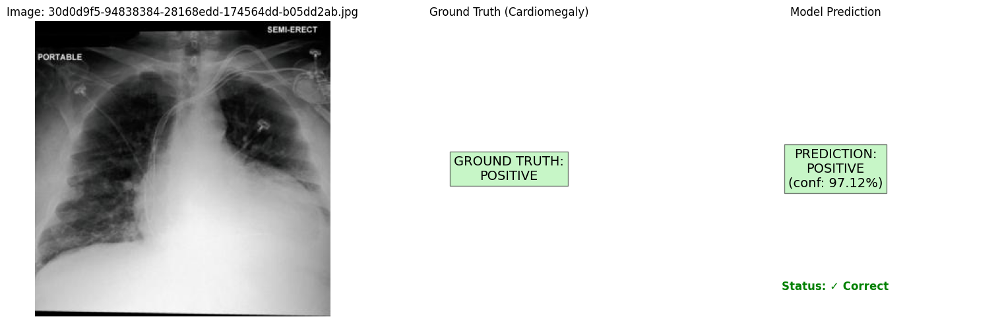


Image: 30d0d9f5-94838384-28168edd-174564dd-b05dd2ab.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9712)
Prediction Status: ✓ Correct
--------------------------------------------------


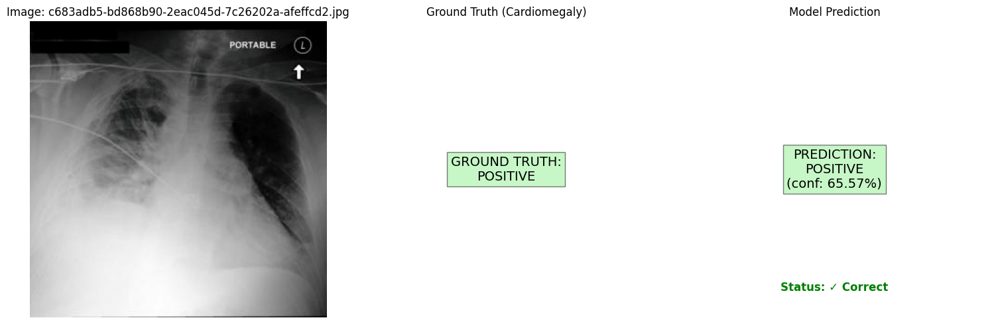


Image: c683adb5-bd868b90-2eac045d-7c26202a-afeffcd2.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.6557)
Prediction Status: ✓ Correct
--------------------------------------------------


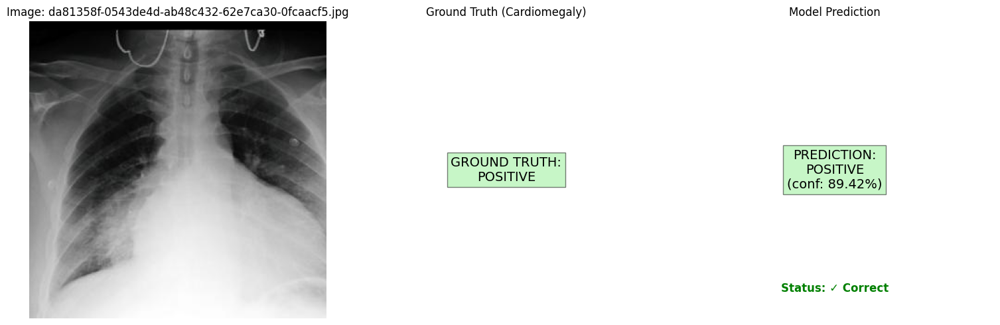


Image: da81358f-0543de4d-ab48c432-62e7ca30-0fcaacf5.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8942)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Cardiomegaly'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Cardiomegaly_resnet18_model.pth'))
except:
    model.load_state_dict(torch.load('best_Cardiomegaly_resnet18_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## ResNet 50 - Cardiomegaly


--- Starting ResNet Model Initialization (ResNet50 on Cardiomegaly dataset) ---

--- Starting ResNet Model Training on Cardiomegaly dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 1/20 | Time: 88.44s
------------------------------------------------------------
Training:    Loss: 0.5926, Accuracy: 0.6939, F1: 0.7023, AUC-ROC: 0.7526
Validation: Loss: 0.9285, Accuracy: 0.5293, F1: 0.4211, AUC-ROC: 0.7312
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7312


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 2/20 | Time: 88.34s
------------------------------------------------------------
Training:    Loss: 0.5311, Accuracy: 0.7351, F1: 0.7421, AUC-ROC: 0.8117
Validation: Loss: 0.5671, Accuracy: 0.7162, F1: 0.7921, AUC-ROC: 0.7616
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7616


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 3/20 | Time: 87.79s
------------------------------------------------------------
Training:    Loss: 0.5102, Accuracy: 0.7533, F1: 0.7633, AUC-ROC: 0.8269
Validation: Loss: 0.5594, Accuracy: 0.7252, F1: 0.7806, AUC-ROC: 0.7639
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7639


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 4/20 | Time: 87.93s
------------------------------------------------------------
Training:    Loss: 0.4717, Accuracy: 0.7776, F1: 0.7912, AUC-ROC: 0.8565
Validation: Loss: 0.7104, Accuracy: 0.7207, F1: 0.7987, AUC-ROC: 0.7355


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 5/20 | Time: 87.44s
------------------------------------------------------------
Training:    Loss: 0.4372, Accuracy: 0.8006, F1: 0.7989, AUC-ROC: 0.8794
Validation: Loss: 0.9052, Accuracy: 0.6059, F1: 0.5783, AUC-ROC: 0.7627


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 6/20 | Time: 87.49s
------------------------------------------------------------
Training:    Loss: 0.3763, Accuracy: 0.8327, F1: 0.8292, AUC-ROC: 0.9130
Validation: Loss: 1.0600, Accuracy: 0.5743, F1: 0.5263, AUC-ROC: 0.7552


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 7/20 | Time: 87.40s
------------------------------------------------------------
Training:    Loss: 0.3374, Accuracy: 0.8629, F1: 0.8643, AUC-ROC: 0.9299
Validation: Loss: 0.7931, Accuracy: 0.7050, F1: 0.7476, AUC-ROC: 0.7500


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 8/20 | Time: 87.60s
------------------------------------------------------------
Training:    Loss: 0.2836, Accuracy: 0.8826, F1: 0.8840, AUC-ROC: 0.9510
Validation: Loss: 0.8496, Accuracy: 0.6824, F1: 0.7294, AUC-ROC: 0.7376

Early stopping triggered after epoch 8. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---


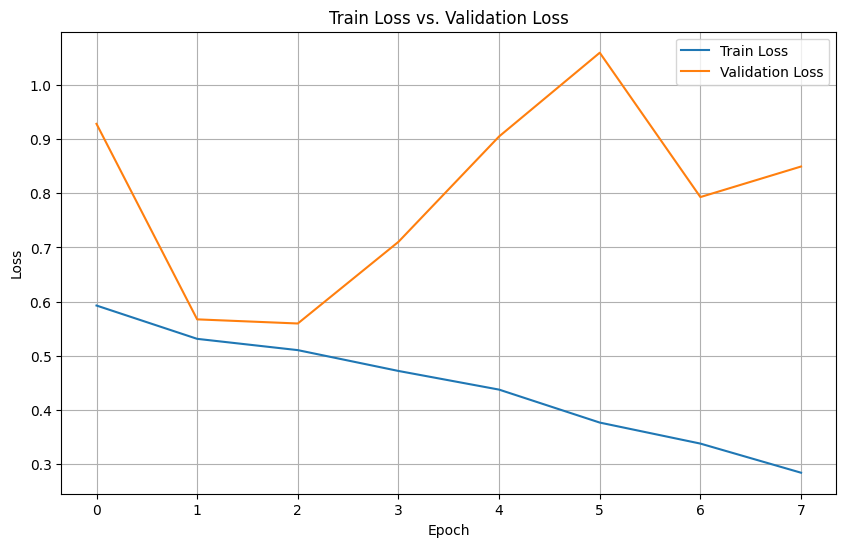


Model training history saved to Cardiomegaly_resnet50_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/80 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.6362
Test Accuracy:   0.6676
Test F1 Score:   0.7227
Test AUC-ROC:    0.7063

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/80 [00:00<?, ?it/s]

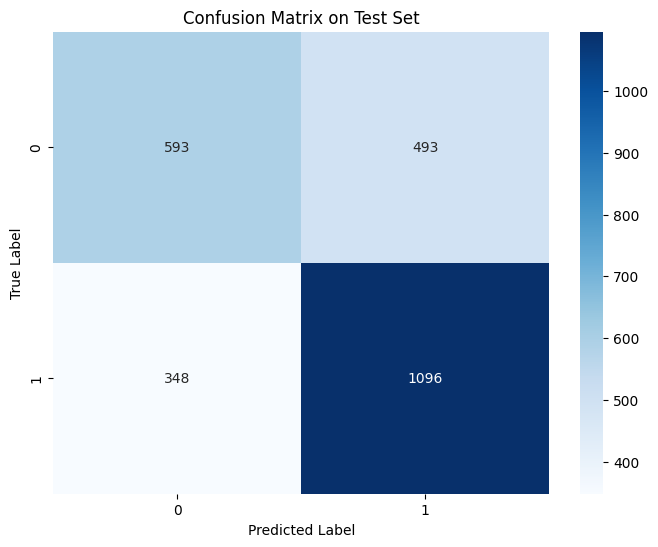

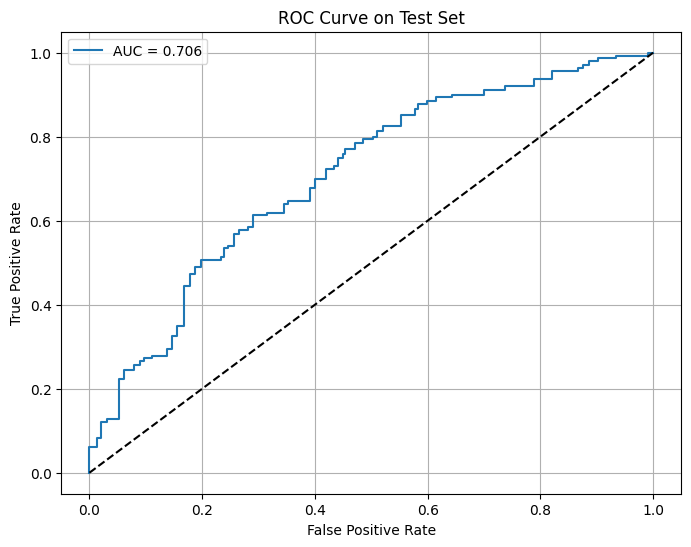


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.63      0.55      0.59      1086
    Positive       0.69      0.76      0.72      1444

    accuracy                           0.67      2530
   macro avg       0.66      0.65      0.65      2530
weighted avg       0.66      0.67      0.66      2530



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle


# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Cardiomegaly'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Initialization (ResNet50 on Cardiomegaly dataset) ---")

# Initialize ResNet50 model
model = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V2)
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 1)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()

optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    # Wrap the loader with tqdm for a progress bar
    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Store predictions and true labels for metrics
        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Training on Cardiomegaly dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
# Early Stopping variables
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()
    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Cardiomegaly_resnet50_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True # Set flag to stop next iteration


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot.png')
plt.show()

## Storing Model History
history_filename = 'Cardiomegaly_resnet50_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
try:
    model.load_state_dict(torch.load('best_Cardiomegaly_resnet50_model.pth'))
except:
    model.load_state_dict(torch.load('best_Cardiomegaly_resnet50_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)
        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)
y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))

### Prediction on test image- ResNet50


--- Randomly Predicting on 5 Test Images ---


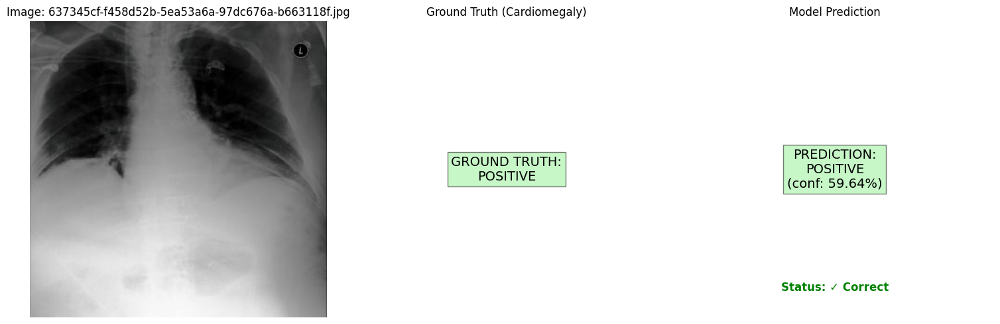


Image: 637345cf-f458d52b-5ea53a6a-97dc676a-b663118f.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.5964)
Prediction Status: ✓ Correct
--------------------------------------------------


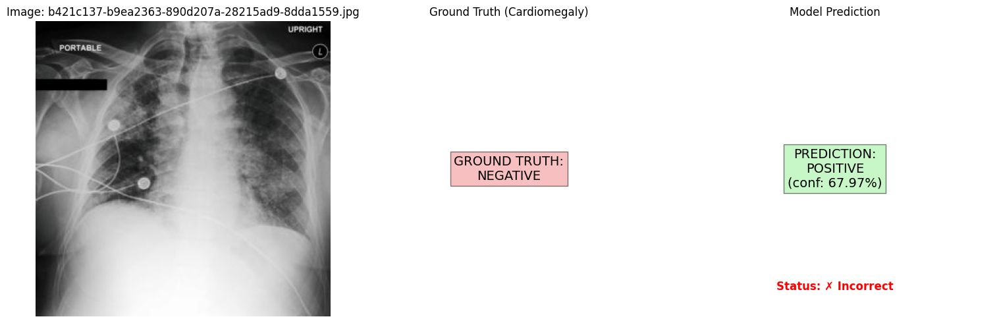


Image: b421c137-b9ea2363-890d207a-28215ad9-8dda1559.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.6797)
Prediction Status: ✗ Incorrect
--------------------------------------------------


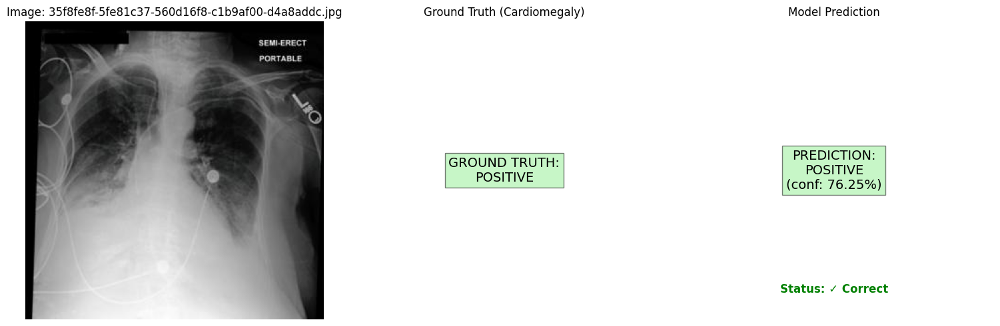


Image: 35f8fe8f-5fe81c37-560d16f8-c1b9af00-d4a8addc.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7625)
Prediction Status: ✓ Correct
--------------------------------------------------


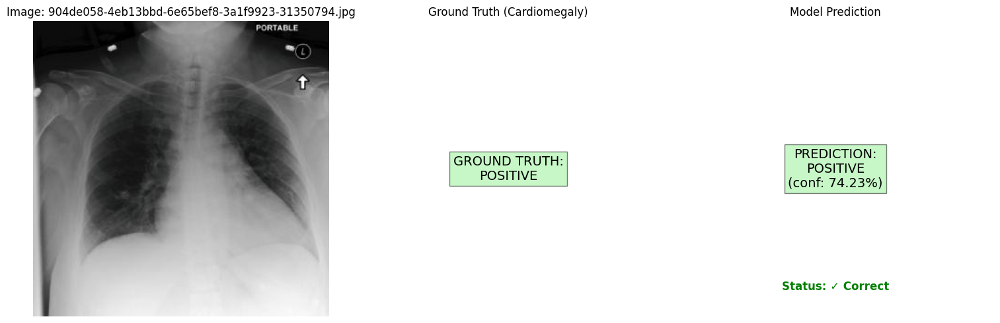


Image: 904de058-4eb13bbd-6e65bef8-3a1f9923-31350794.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7423)
Prediction Status: ✓ Correct
--------------------------------------------------


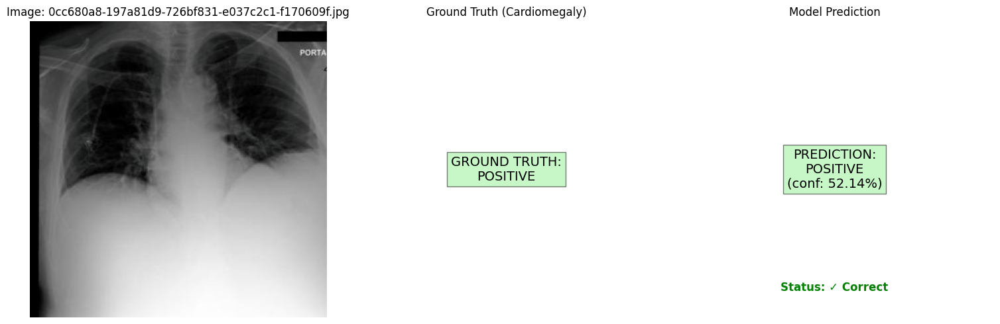


Image: 0cc680a8-197a81d9-726bf831-e037c2c1-f170609f.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.5214)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Cardiomegaly'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Cardiomegaly_resnet50_model.pth'))
except:

    model.load_state_dict(torch.load('best_Cardiomegaly_resnet50_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## VGG16 - Cardiomegaly


--- Starting VGG Model Initialization (VGG16 on Cardiomegaly dataset) ---

--- Starting VGG16 Model Training on Cardiomegaly dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 1/20 | Time: 143.60s
------------------------------------------------------------
Training:    Loss: 0.6941, Accuracy: 0.5552, F1: 0.5355, AUC-ROC: 0.5809
Validation: Loss: 0.6897, Accuracy: 0.4865, F1: 0.3174, AUC-ROC: 0.7164
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7164


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 2/20 | Time: 135.83s
------------------------------------------------------------
Training:    Loss: 0.6410, Accuracy: 0.6309, F1: 0.6451, AUC-ROC: 0.6784
Validation: Loss: 0.5765, Accuracy: 0.7230, F1: 0.7846, AUC-ROC: 0.7751
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7751


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 3/20 | Time: 134.72s
------------------------------------------------------------
Training:    Loss: 0.6261, Accuracy: 0.6487, F1: 0.6728, AUC-ROC: 0.7026
Validation: Loss: 0.6108, Accuracy: 0.6689, F1: 0.6769, AUC-ROC: 0.7831
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7831


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 4/20 | Time: 135.04s
------------------------------------------------------------
Training:    Loss: 0.5944, Accuracy: 0.6854, F1: 0.7069, AUC-ROC: 0.7434
Validation: Loss: 0.5586, Accuracy: 0.7072, F1: 0.7943, AUC-ROC: 0.7726


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 5/20 | Time: 134.25s
------------------------------------------------------------
Training:    Loss: 0.6005, Accuracy: 0.6752, F1: 0.6920, AUC-ROC: 0.7339
Validation: Loss: 0.5463, Accuracy: 0.7072, F1: 0.7610, AUC-ROC: 0.7843
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7843


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 6/20 | Time: 134.10s
------------------------------------------------------------
Training:    Loss: 0.5733, Accuracy: 0.7025, F1: 0.7092, AUC-ROC: 0.7686
Validation: Loss: 0.6919, Accuracy: 0.5856, F1: 0.5330, AUC-ROC: 0.7722


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 7/20 | Time: 133.81s
------------------------------------------------------------
Training:    Loss: 0.5725, Accuracy: 0.6956, F1: 0.7007, AUC-ROC: 0.7658
Validation: Loss: 0.6391, Accuracy: 0.6577, F1: 0.6545, AUC-ROC: 0.7930
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7930


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 8/20 | Time: 133.31s
------------------------------------------------------------
Training:    Loss: 0.5760, Accuracy: 0.6986, F1: 0.7134, AUC-ROC: 0.7671
Validation: Loss: 0.5769, Accuracy: 0.6982, F1: 0.7276, AUC-ROC: 0.7877


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 9/20 | Time: 133.59s
------------------------------------------------------------
Training:    Loss: 0.5636, Accuracy: 0.7106, F1: 0.7201, AUC-ROC: 0.7795
Validation: Loss: 0.5483, Accuracy: 0.7140, F1: 0.7644, AUC-ROC: 0.7837


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 10/20 | Time: 133.77s
------------------------------------------------------------
Training:    Loss: 0.5641, Accuracy: 0.7114, F1: 0.7225, AUC-ROC: 0.7779
Validation: Loss: 0.5352, Accuracy: 0.7387, F1: 0.8041, AUC-ROC: 0.7881


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 11/20 | Time: 134.06s
------------------------------------------------------------
Training:    Loss: 0.5424, Accuracy: 0.7303, F1: 0.7410, AUC-ROC: 0.8005
Validation: Loss: 0.5525, Accuracy: 0.7342, F1: 0.7713, AUC-ROC: 0.7957
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7957


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 12/20 | Time: 134.29s
------------------------------------------------------------
Training:    Loss: 0.5256, Accuracy: 0.7423, F1: 0.7617, AUC-ROC: 0.8120
Validation: Loss: 0.5355, Accuracy: 0.7432, F1: 0.7993, AUC-ROC: 0.7801


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 13/20 | Time: 133.85s
------------------------------------------------------------
Training:    Loss: 0.5249, Accuracy: 0.7423, F1: 0.7540, AUC-ROC: 0.8142
Validation: Loss: 0.6180, Accuracy: 0.6892, F1: 0.7039, AUC-ROC: 0.8060
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8060


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 14/20 | Time: 133.98s
------------------------------------------------------------
Training:    Loss: 0.5111, Accuracy: 0.7455, F1: 0.7578, AUC-ROC: 0.8274
Validation: Loss: 0.6173, Accuracy: 0.6712, F1: 0.6933, AUC-ROC: 0.7844


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 15/20 | Time: 134.55s
------------------------------------------------------------
Training:    Loss: 0.5227, Accuracy: 0.7513, F1: 0.7704, AUC-ROC: 0.8182
Validation: Loss: 0.5351, Accuracy: 0.7432, F1: 0.7935, AUC-ROC: 0.7869


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 16/20 | Time: 134.53s
------------------------------------------------------------
Training:    Loss: 0.5134, Accuracy: 0.7509, F1: 0.7560, AUC-ROC: 0.8246
Validation: Loss: 0.5452, Accuracy: 0.7342, F1: 0.7686, AUC-ROC: 0.7971


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 17/20 | Time: 135.15s
------------------------------------------------------------
Training:    Loss: 0.4916, Accuracy: 0.7685, F1: 0.7840, AUC-ROC: 0.8419
Validation: Loss: 0.5666, Accuracy: 0.7162, F1: 0.7500, AUC-ROC: 0.7956


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 18/20 | Time: 134.60s
------------------------------------------------------------
Training:    Loss: 0.4823, Accuracy: 0.7709, F1: 0.7806, AUC-ROC: 0.8482
Validation: Loss: 0.5834, Accuracy: 0.7027, F1: 0.7306, AUC-ROC: 0.7955

Early stopping triggered after epoch 18. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---


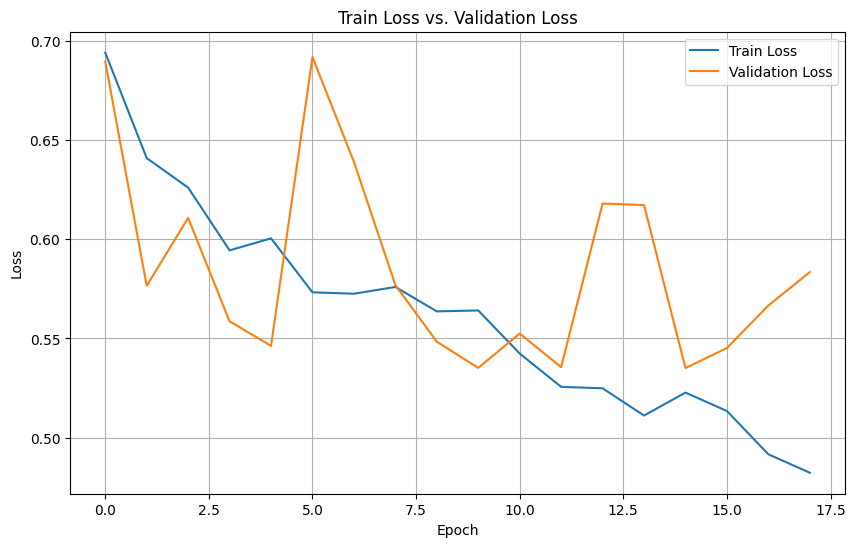


Model training history saved to Cardiomegaly_vgg16_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/80 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.6997
Test Accuracy:   0.6664
Test F1 Score:   0.6844
Test AUC-ROC:    0.7290

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/80 [00:00<?, ?it/s]

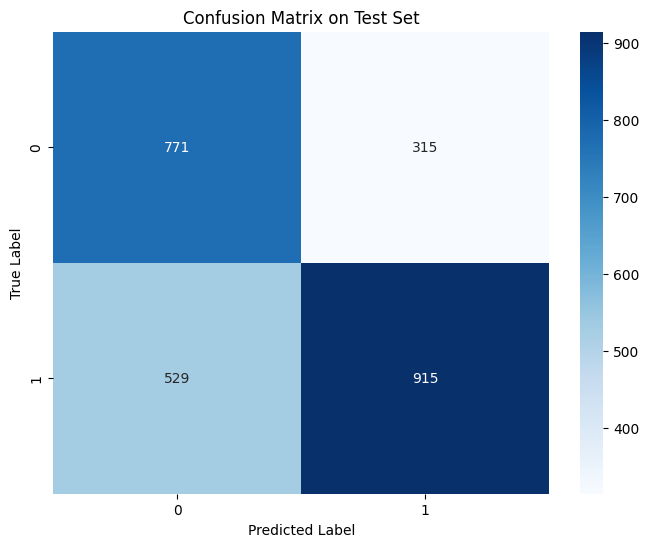

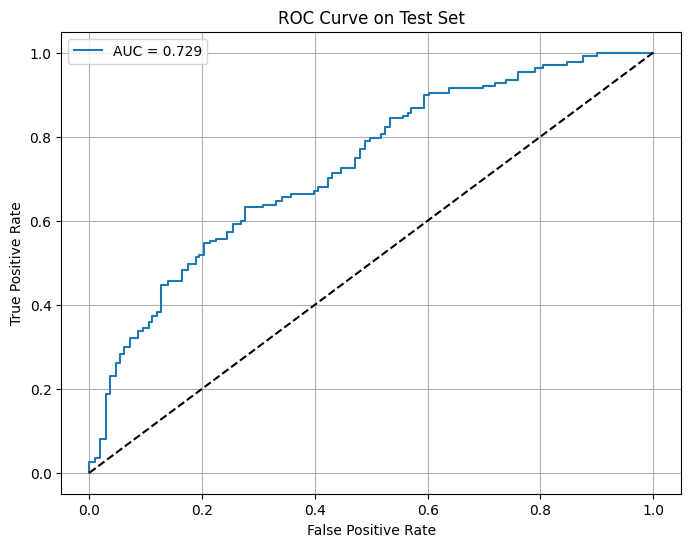


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.59      0.71      0.65      1086
    Positive       0.74      0.63      0.68      1444

    accuracy                           0.67      2530
   macro avg       0.67      0.67      0.67      2530
weighted avg       0.68      0.67      0.67      2530



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle


def create_vgg16_model(num_classes=1, pretrained=True):
    model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1 if pretrained else None)

    model.classifier = nn.Sequential(
        nn.Linear(512 * 7 * 7, 4096),
        nn.ReLU(True),
        nn.Dropout(p=0.5),
        nn.Linear(4096, 1024),
        nn.ReLU(True),
        nn.Dropout(p=0.5),
        nn.Linear(1024, num_classes)
    )

    # Initialize the new layers
    for m in model.classifier.modules():
        if isinstance(m, nn.Linear):
            nn.init.xavier_normal_(m.weight)
            nn.init.constant_(m.bias, 0)

    return model

vgg16_train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomRotation(15),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

vgg16_test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=vgg16_train_transform

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=vgg16_test_transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Cardiomegaly'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)


print("\n--- Starting VGG Model Initialization (VGG16 on Cardiomegaly dataset) ---")

# Initialize VGG16 model
model = create_vgg16_model(num_classes=1)

# Move model to GPU if available
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()

# Define optimizer with VGG16 parameters
optimizer = torch.optim.AdamW(
    model.parameters(),
    lr=1e-4,
    weight_decay=0.01, # Using VGG16's specific weight decay
    amsgrad=True
)

# Learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max', # Monitoring AUC-ROC (higher is better)
    factor=0.5,
    patience=2,
    verbose=True
)


# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    # Wrap the loader with tqdm for a progress bar
    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Store predictions and true labels for metrics
        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting VGG16 Model Training on Cardiomegaly dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
# Early Stopping variables
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    scheduler.step(val_auc)

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        # UPDATED CHECKPOINT FILENAME
        torch.save(model.state_dict(), 'best_Cardiomegaly_vgg16_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
# Ensure plots only include completed epochs if early stopping occurred
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot.png')
plt.show()

## Storing Model History
# UPDATED HISTORY FILENAME
history_filename = 'Cardiomegaly_vgg16_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")


test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=vgg16_test_transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

try:

    model.load_state_dict(torch.load('best_Cardiomegaly_vgg16_model.pth'))
except:
    # Fallback/redundant load check
    model.load_state_dict(torch.load('best_Cardiomegaly_vgg16_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()  # Probabilities for class 1 (positive class)
        preds = (probs > 0.5).astype(int)  # Convert probabilities to class labels

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)  # Store the probabilities for class 1

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)  # Use y_prob directly for binary classification
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


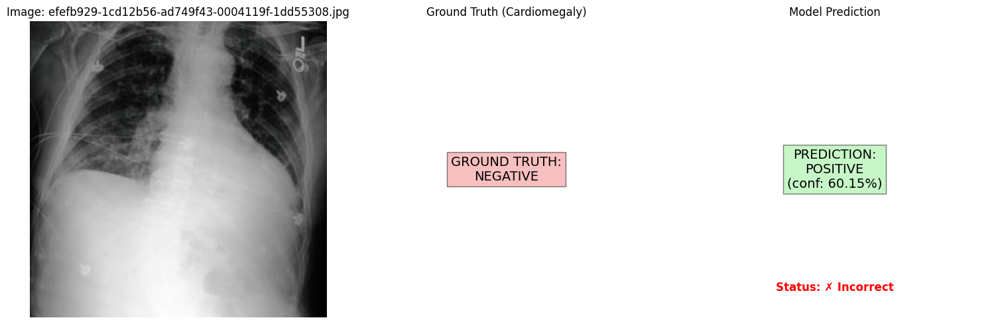


Image: efefb929-1cd12b56-ad749f43-0004119f-1dd55308.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.6015)
Prediction Status: ✗ Incorrect
--------------------------------------------------


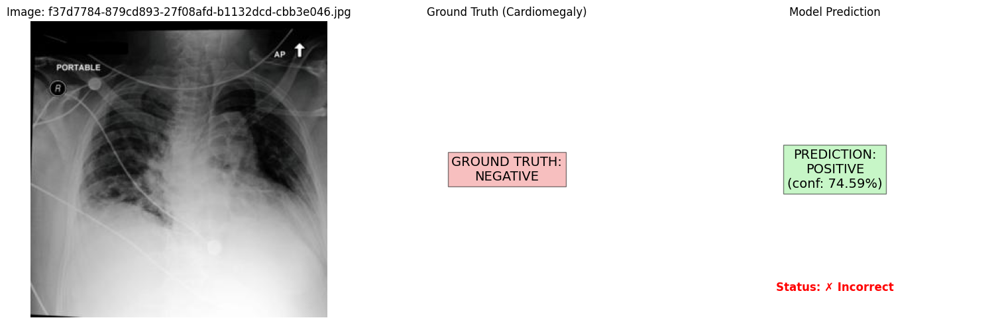


Image: f37d7784-879cd893-27f08afd-b1132dcd-cbb3e046.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.7459)
Prediction Status: ✗ Incorrect
--------------------------------------------------


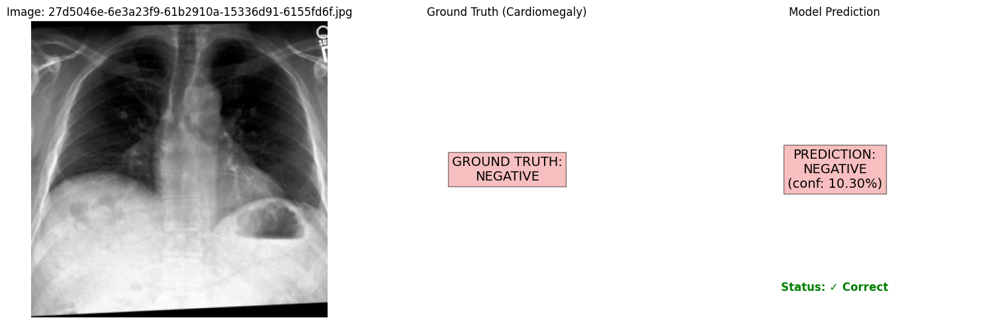


Image: 27d5046e-6e3a23f9-61b2910a-15336d91-6155fd6f.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1030)
Prediction Status: ✓ Correct
--------------------------------------------------


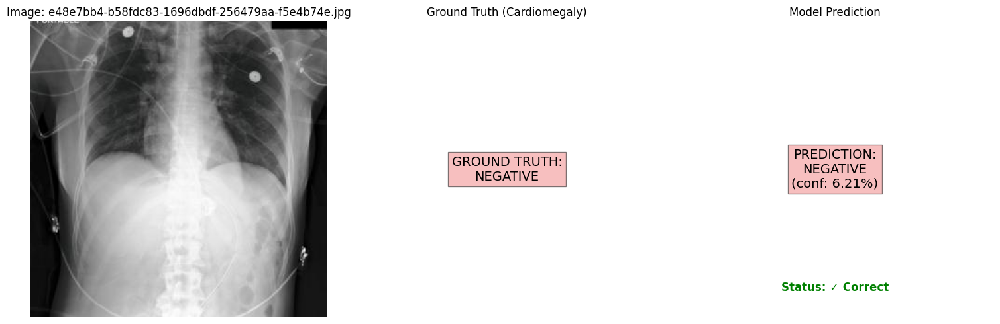


Image: e48e7bb4-b58fdc83-1696dbdf-256479aa-f5e4b74e.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0621)
Prediction Status: ✓ Correct
--------------------------------------------------


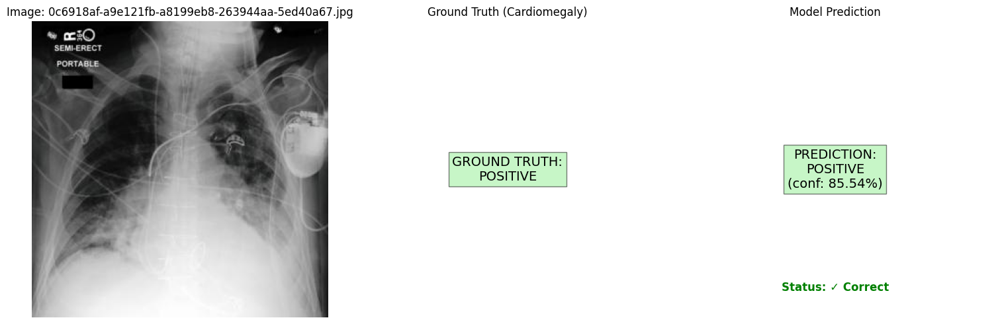


Image: 0c6918af-a9e121fb-a8199eb8-263944aa-5ed40a67.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8554)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 3
Accuracy: 60.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)

    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Cardiomegaly'].values[0]


    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)

        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Cardiomegaly_vgg16_model.pth'))
except:
    model.load_state_dict(torch.load('best_Cardiomegaly_vgg16_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## DenseNet121 - Cardiomegaly


--- Starting DenseNet121 Model Initialization for Cardiomegaly Classification ---

--- Starting DenseNet121 Model Training on Cardiomegaly dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 1/20 | Time: 100.21s
------------------------------------------------------------
Training:   Loss: 0.6290, Accuracy: 0.6707, F1: 0.6680, AUC-ROC: 0.7290
Validation: Loss: 0.5722, Accuracy: 0.7072, F1: 0.7519, AUC-ROC: 0.7674
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7674


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 2/20 | Time: 97.50s
------------------------------------------------------------
Training:   Loss: 0.5570, Accuracy: 0.7225, F1: 0.7275, AUC-ROC: 0.7906
Validation: Loss: 0.8029, Accuracy: 0.6532, F1: 0.7755, AUC-ROC: 0.7361


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 3/20 | Time: 96.70s
------------------------------------------------------------
Training:   Loss: 0.5478, Accuracy: 0.7336, F1: 0.7370, AUC-ROC: 0.7971
Validation: Loss: 0.7676, Accuracy: 0.5766, F1: 0.5253, AUC-ROC: 0.7564


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 4/20 | Time: 95.83s
------------------------------------------------------------
Training:   Loss: 0.5301, Accuracy: 0.7409, F1: 0.7528, AUC-ROC: 0.8103
Validation: Loss: 0.6349, Accuracy: 0.6126, F1: 0.5924, AUC-ROC: 0.7656


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 5/20 | Time: 95.91s
------------------------------------------------------------
Training:   Loss: 0.5321, Accuracy: 0.7427, F1: 0.7456, AUC-ROC: 0.8119
Validation: Loss: 0.7776, Accuracy: 0.6396, F1: 0.6262, AUC-ROC: 0.7676
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7676


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 6/20 | Time: 95.97s
------------------------------------------------------------
Training:   Loss: 0.5003, Accuracy: 0.7642, F1: 0.7667, AUC-ROC: 0.8368
Validation: Loss: 0.6006, Accuracy: 0.6869, F1: 0.7322, AUC-ROC: 0.7506


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 7/20 | Time: 95.89s
------------------------------------------------------------
Training:   Loss: 0.4949, Accuracy: 0.7674, F1: 0.7766, AUC-ROC: 0.8395
Validation: Loss: 0.5815, Accuracy: 0.7117, F1: 0.7981, AUC-ROC: 0.7779
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7779


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 8/20 | Time: 96.39s
------------------------------------------------------------
Training:   Loss: 0.4973, Accuracy: 0.7570, F1: 0.7640, AUC-ROC: 0.8387
Validation: Loss: 0.5755, Accuracy: 0.7140, F1: 0.7712, AUC-ROC: 0.7612


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 9/20 | Time: 96.13s
------------------------------------------------------------
Training:   Loss: 0.4798, Accuracy: 0.7711, F1: 0.7740, AUC-ROC: 0.8513
Validation: Loss: 0.5439, Accuracy: 0.7230, F1: 0.7883, AUC-ROC: 0.7751


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 10/20 | Time: 96.72s
------------------------------------------------------------
Training:   Loss: 0.4752, Accuracy: 0.7752, F1: 0.7777, AUC-ROC: 0.8550
Validation: Loss: 0.5756, Accuracy: 0.7162, F1: 0.7658, AUC-ROC: 0.7552


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 11/20 | Time: 96.29s
------------------------------------------------------------
Training:   Loss: 0.4601, Accuracy: 0.7885, F1: 0.7868, AUC-ROC: 0.8659
Validation: Loss: 0.7198, Accuracy: 0.6486, F1: 0.6533, AUC-ROC: 0.7750


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 12/20 | Time: 95.55s
------------------------------------------------------------
Training:   Loss: 0.4378, Accuracy: 0.7956, F1: 0.8012, AUC-ROC: 0.8781
Validation: Loss: 0.9528, Accuracy: 0.5766, F1: 0.5179, AUC-ROC: 0.7781
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7781


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 13/20 | Time: 95.89s
------------------------------------------------------------
Training:   Loss: 0.4390, Accuracy: 0.8004, F1: 0.8002, AUC-ROC: 0.8789
Validation: Loss: 0.6200, Accuracy: 0.6959, F1: 0.7316, AUC-ROC: 0.7921
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7921


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 14/20 | Time: 95.92s
------------------------------------------------------------
Training:   Loss: 0.3948, Accuracy: 0.8266, F1: 0.8269, AUC-ROC: 0.9030
Validation: Loss: 0.8509, Accuracy: 0.6284, F1: 0.6207, AUC-ROC: 0.7624


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 15/20 | Time: 95.99s
------------------------------------------------------------
Training:   Loss: 0.3854, Accuracy: 0.8321, F1: 0.8302, AUC-ROC: 0.9076
Validation: Loss: 0.7913, Accuracy: 0.6374, F1: 0.6523, AUC-ROC: 0.7686


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 16/20 | Time: 95.33s
------------------------------------------------------------
Training:   Loss: 0.3543, Accuracy: 0.8468, F1: 0.8470, AUC-ROC: 0.9229
Validation: Loss: 0.7578, Accuracy: 0.6734, F1: 0.7106, AUC-ROC: 0.7295


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 17/20 | Time: 96.13s
------------------------------------------------------------
Training:   Loss: 0.3239, Accuracy: 0.8661, F1: 0.8628, AUC-ROC: 0.9373
Validation: Loss: 0.8834, Accuracy: 0.6577, F1: 0.6780, AUC-ROC: 0.7533


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 18/20 | Time: 95.62s
------------------------------------------------------------
Training:   Loss: 0.2771, Accuracy: 0.8924, F1: 0.8937, AUC-ROC: 0.9528
Validation: Loss: 0.7814, Accuracy: 0.7230, F1: 0.7792, AUC-ROC: 0.7451

Early stopping triggered after epoch 18. Validation AUC-ROC did not improve for 5 epochs.


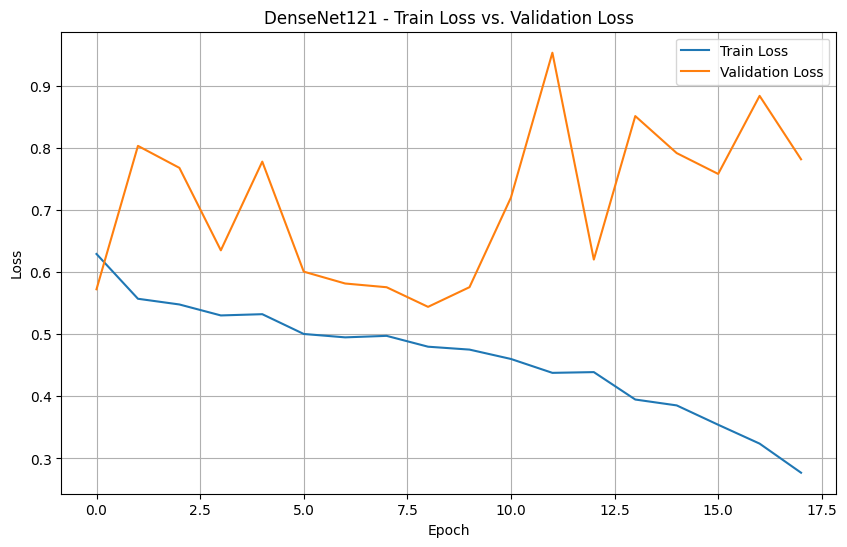


Model training history saved to Cardiomegaly_densenet121_history.pkl

--- Starting DenseNet121 Evaluation on Test Dataset ---


Validation:   0%|          | 0/80 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.7479
Test Accuracy:   0.6862
Test F1 Score:   0.7011
Test AUC-ROC:    0.7397


Testing:   0%|          | 0/80 [00:00<?, ?it/s]

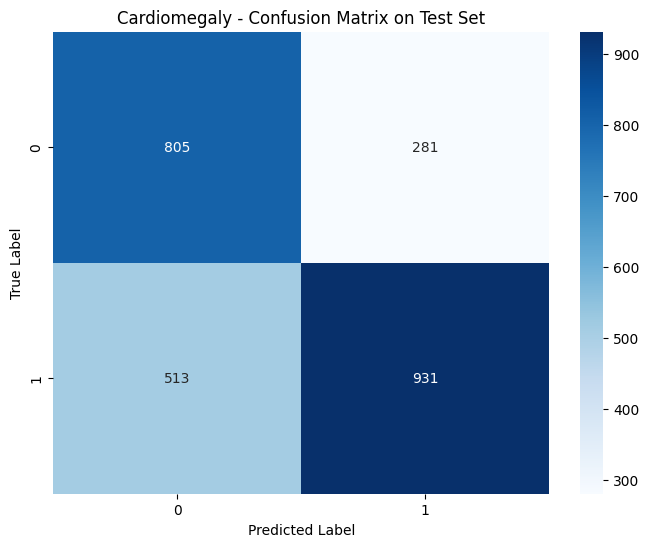

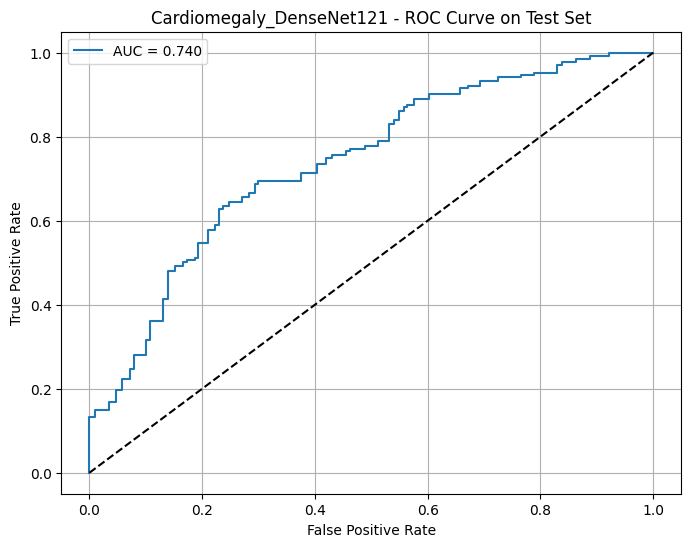


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.61      0.74      0.67      1086
    Positive       0.77      0.64      0.70      1444

    accuracy                           0.69      2530
   macro avg       0.69      0.69      0.69      2530
weighted avg       0.70      0.69      0.69      2530



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle
from torch.optim.lr_scheduler import ReduceLROnPlateau
# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Cardiomegaly'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
# Initialize DenseNet121 model
print("\n--- Starting DenseNet121 Model Initialization for Cardiomegaly Classification ---")


model = models.densenet121(weights=models.DenseNet121_Weights.IMAGENET1K_V1)

# classifier for binary classification
num_ftrs = model.classifier.in_features
model.classifier = nn.Sequential(
    nn.BatchNorm1d(num_ftrs),
    nn.Dropout(0.4),
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.BatchNorm1d(512),
    nn.Dropout(0.4),
    nn.Linear(512, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

print("\n--- Starting DenseNet121 Model Training on Cardiomegaly dataset ---")

num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:   Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Cardiomegaly_densenet121_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# Plot Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('DenseNet121 - Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('densenet121_train_val_loss_plot.png')
plt.show()

# Store Model History
history_filename = 'Cardiomegaly_densenet121_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
# Evaluation on Test Dataset
print("\n--- Starting DenseNet121 Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)

# Load best model
model.load_state_dict(torch.load('best_Cardiomegaly_densenet121_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# Calculate final metrics and generate plots
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Cardiomegaly - Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('Cardiomegaly_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Cardiomegaly_DenseNet121 - ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Cardiomegaly_densenet121_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))




--- Randomly Predicting on 5 Test Images ---


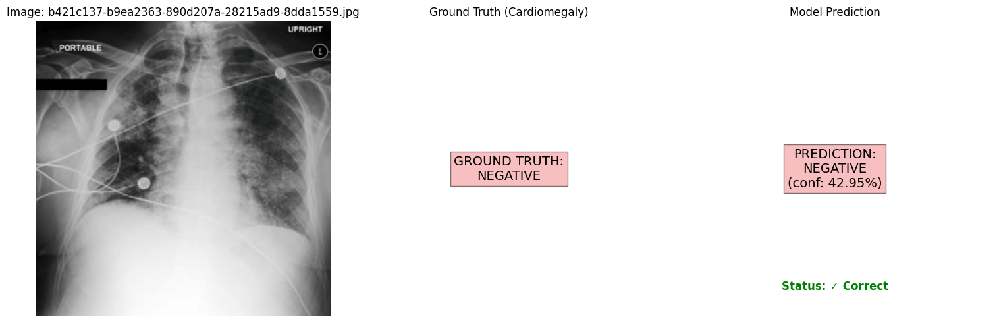


Image: b421c137-b9ea2363-890d207a-28215ad9-8dda1559.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.4295)
Prediction Status: ✓ Correct
--------------------------------------------------


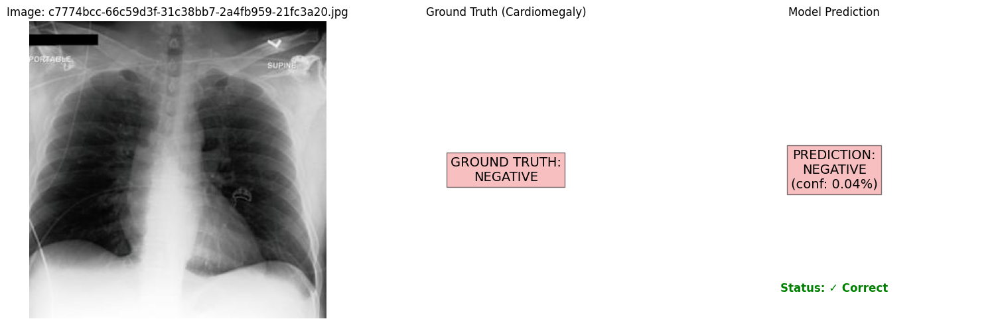


Image: c7774bcc-66c59d3f-31c38bb7-2a4fb959-21fc3a20.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0004)
Prediction Status: ✓ Correct
--------------------------------------------------


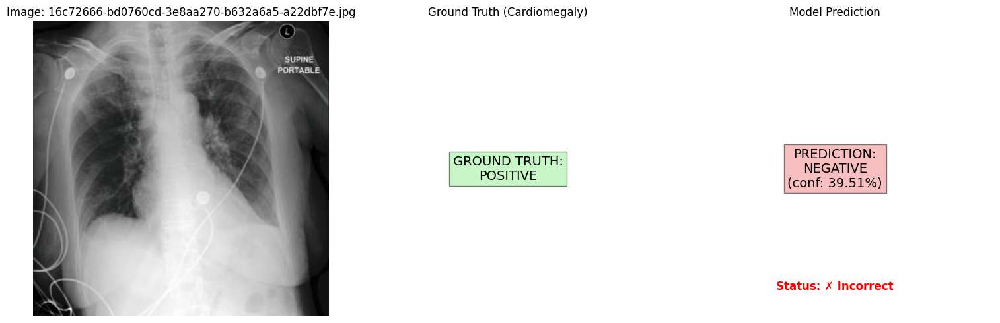


Image: 16c72666-bd0760cd-3e8aa270-b632a6a5-a22dbf7e.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.3951)
Prediction Status: ✗ Incorrect
--------------------------------------------------


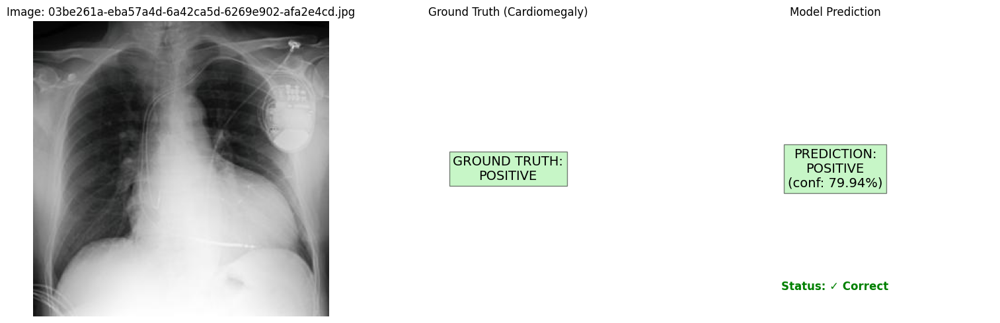


Image: 03be261a-eba57a4d-6a42ca5d-6269e902-afa2e4cd.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7994)
Prediction Status: ✓ Correct
--------------------------------------------------


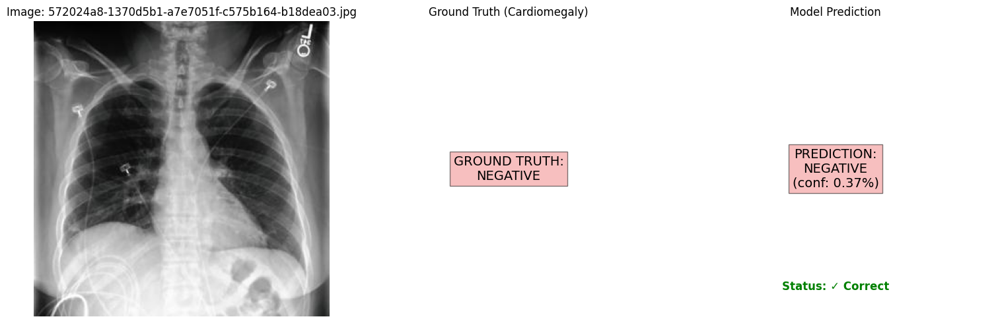


Image: 572024a8-1370d5b1-a7e7051f-c575b164-b18dea03.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0037)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Cardiomegaly'].values[0]

    # Move to device and make prediction
    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

try:
    model.load_state_dict(torch.load('best_Cardiomegaly_densenet121_model.pth'))
except:
    model.load_state_dict(torch.load('best_Cardiomegaly_densenet121_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## InceptionNet V3 - Cardiomegaly


--- Starting InceptionV3 Model Initialization for Cardiomegaly Classification ---
Model initialized on: cuda:0
Total parameters: 25,393,634
Trainable parameters: 25,393,634

--- Starting InceptionV3 Model Training on Cardiomegaly dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 1/20 | Time: 127.61s
------------------------------------------------------------
Training:   Loss: 0.8916, Accuracy: 0.6589, F1: 0.6725, AUC-ROC: 0.7077
Validation: Loss: 1.8666, Accuracy: 0.6036, F1: 0.7528, AUC-ROC: 0.6968
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.6968


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 2/20 | Time: 125.69s
------------------------------------------------------------
Training:   Loss: 0.8358, Accuracy: 0.6939, F1: 0.7135, AUC-ROC: 0.7472
Validation: Loss: 0.6322, Accuracy: 0.6419, F1: 0.6294, AUC-ROC: 0.7825
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7825


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 3/20 | Time: 126.71s
------------------------------------------------------------
Training:   Loss: 0.8002, Accuracy: 0.7114, F1: 0.7246, AUC-ROC: 0.7740
Validation: Loss: 0.7885, Accuracy: 0.7140, F1: 0.7784, AUC-ROC: 0.7444


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 4/20 | Time: 126.82s
------------------------------------------------------------
Training:   Loss: 0.7647, Accuracy: 0.7321, F1: 0.7408, AUC-ROC: 0.7985
Validation: Loss: 0.5459, Accuracy: 0.7410, F1: 0.7850, AUC-ROC: 0.7999
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7999


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 5/20 | Time: 126.12s
------------------------------------------------------------
Training:   Loss: 0.7419, Accuracy: 0.7416, F1: 0.7512, AUC-ROC: 0.8129
Validation: Loss: 0.5781, Accuracy: 0.7455, F1: 0.7848, AUC-ROC: 0.7939


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 6/20 | Time: 126.37s
------------------------------------------------------------
Training:   Loss: 0.7247, Accuracy: 0.7483, F1: 0.7529, AUC-ROC: 0.8234
Validation: Loss: 0.6733, Accuracy: 0.6667, F1: 0.7771, AUC-ROC: 0.7110


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 7/20 | Time: 129.67s
------------------------------------------------------------
Training:   Loss: 0.7022, Accuracy: 0.7644, F1: 0.7774, AUC-ROC: 0.8380
Validation: Loss: 0.5508, Accuracy: 0.7387, F1: 0.7972, AUC-ROC: 0.7701


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 8/20 | Time: 129.99s
------------------------------------------------------------
Training:   Loss: 0.6793, Accuracy: 0.7713, F1: 0.7763, AUC-ROC: 0.8481
Validation: Loss: 0.6015, Accuracy: 0.7140, F1: 0.7445, AUC-ROC: 0.7950


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 9/20 | Time: 130.88s
------------------------------------------------------------
Training:   Loss: 0.6793, Accuracy: 0.7774, F1: 0.7780, AUC-ROC: 0.8510
Validation: Loss: 0.6396, Accuracy: 0.6712, F1: 0.7160, AUC-ROC: 0.7210

Early stopping triggered after epoch 9. Validation AUC-ROC did not improve for 5 epochs.


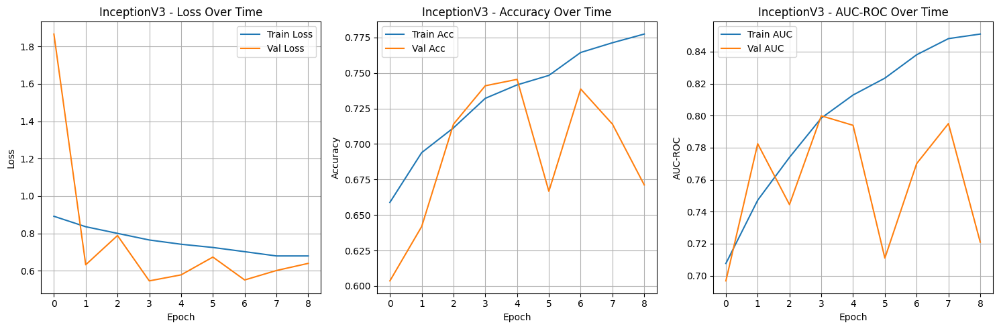


Model training history saved to Cardiomegaly_inceptionv3_history.pkl

--- Starting InceptionV3 Evaluation on Test Dataset ---


Validation:   0%|          | 0/80 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.6357
Test Accuracy:   0.7000
Test F1 Score:   0.7478
Test AUC-ROC:    0.7516


Testing:   0%|          | 0/80 [00:00<?, ?it/s]

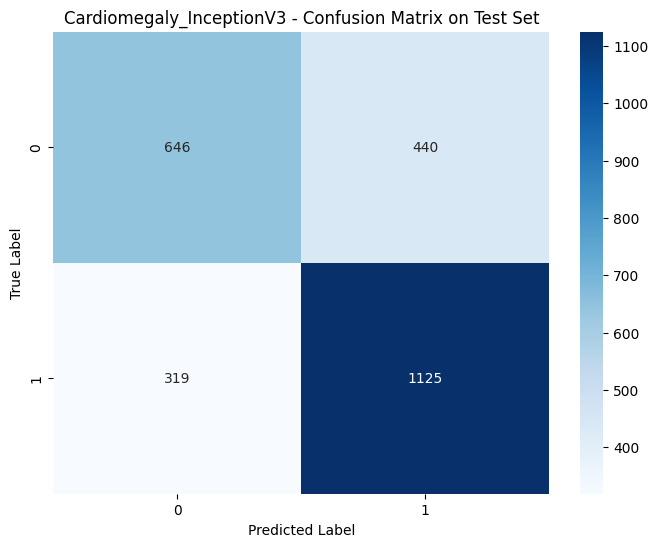

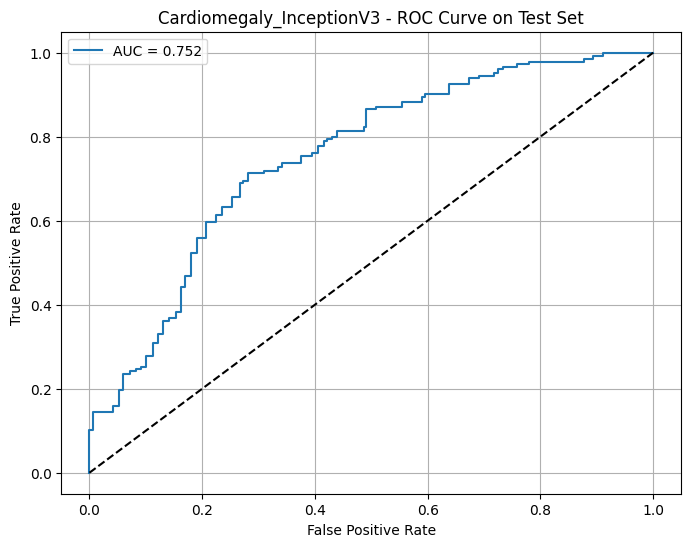


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.67      0.59      0.63      1086
    Positive       0.72      0.78      0.75      1444

    accuracy                           0.70      2530
   macro avg       0.69      0.69      0.69      2530
weighted avg       0.70      0.70      0.70      2530



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle

transform = transforms.Compose([
    transforms.Resize((299, 299)),  # Inception V3  299x299 input
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Cardiomegaly'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0,
    pin_memory=True
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0,
    pin_memory=True
)


print("\n--- Starting InceptionV3 Model Initialization for Cardiomegaly Classification ---")

# Initialize InceptionV3 with pretrained weights
model = models.inception_v3(weights=models.Inception_V3_Weights.IMAGENET1K_V1)

# Modify the classifier for binary classification

num_ftrs = model.fc.in_features
model.fc = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.Dropout(0.4),
    nn.Linear(512, 1)
)

num_ftrs_aux = model.AuxLogits.fc.in_features
model.AuxLogits.fc = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(num_ftrs_aux, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

print(f"Model initialized on: {device}")
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs, aux_outputs = model(inputs)

        # Calculate primary and auxiliary losses
        loss1 = criterion(outputs.squeeze(), labels)
        loss2 = criterion(aux_outputs.squeeze(), labels)
        loss = loss1 + 0.4 * loss2

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            if isinstance(outputs, tuple):
                outputs = outputs[0]
            loss = criterion(outputs.squeeze(), labels)
            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Training loop
print("\n--- Starting InceptionV3 Model Training on Cardiomegaly dataset ---")

num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:   Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Cardiomegaly_inceptionv3_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# Plot training history
plt.figure(figsize=(15, 5))

# Plot Loss
plt.subplot(1, 3, 1)
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Val Loss')
plt.title('InceptionV3 - Loss Over Time')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

# Plot Accuracy
plt.subplot(1, 3, 2)
plt.plot(history['train_acc'], label='Train Acc')
plt.plot(history['val_acc'], label='Val Acc')
plt.title('InceptionV3 - Accuracy Over Time')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)

# Plot AUC-ROC
plt.subplot(1, 3, 3)
plt.plot(history['train_auc'], label='Train AUC')
plt.plot(history['val_auc'], label='Val AUC')
plt.title('InceptionV3 - AUC-ROC Over Time')
plt.xlabel('Epoch')
plt.ylabel('AUC-ROC')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('Cardiomegaly_inceptionv3_training_history.png')
plt.show()

# Save training history
history_filename = 'Cardiomegaly_inceptionv3_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")
# ----------------------------------------------------------------------
# Evaluation on Test Dataset
print("\n--- Starting InceptionV3 Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0,
    pin_memory=True
)

# Load best model
model.load_state_dict(torch.load('best_Cardiomegaly_inceptionv3_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# Calculate final metrics and generate plots
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        if isinstance(outputs, tuple):
            outputs = outputs[0]

        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Cardiomegaly_InceptionV3 - Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('Cardiomegaly_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Cardiomegaly_InceptionV3 - ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Cardiomegaly_inceptionv3_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


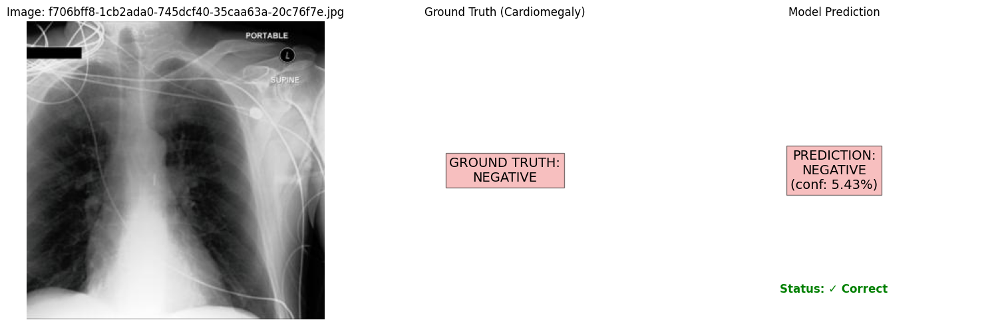


Image: f706bff8-1cb2ada0-745dcf40-35caa63a-20c76f7e.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0543)
Prediction Status: ✓ Correct
--------------------------------------------------


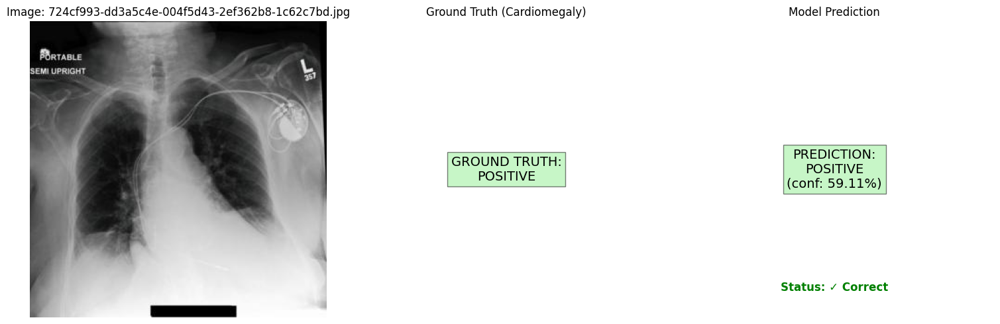


Image: 724cf993-dd3a5c4e-004f5d43-2ef362b8-1c62c7bd.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.5911)
Prediction Status: ✓ Correct
--------------------------------------------------


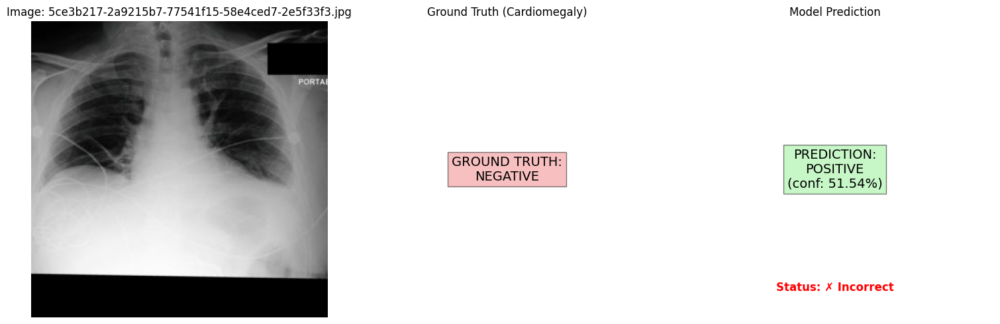


Image: 5ce3b217-2a9215b7-77541f15-58e4ced7-2e5f33f3.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.5154)
Prediction Status: ✗ Incorrect
--------------------------------------------------


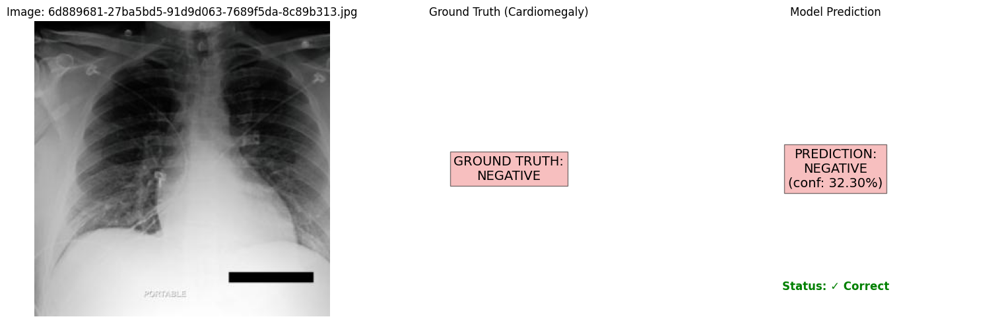


Image: 6d889681-27ba5bd5-91d9d063-7689f5da-8c89b313.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.3230)
Prediction Status: ✓ Correct
--------------------------------------------------


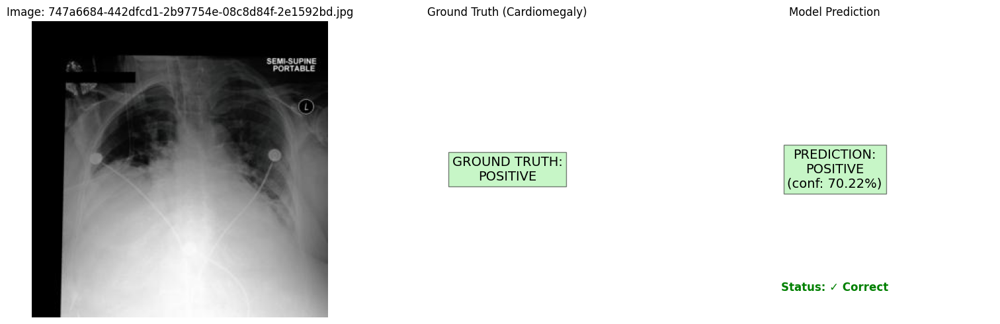


Image: 747a6684-442dfcd1-2b97754e-08c8d84f-2e1592bd.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7022)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Cardiomegaly'].values[0]

    # Move to device and make prediction
    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Cardiomegaly_inceptionv3_model.pth'))
except:
    model.load_state_dict(torch.load('best_Cardiomegaly_inceptionv3_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## MobileNet V3 - Cardiomegaly


--- Starting MobileNetV3-Large Model Initialization (MobileNetV3 on Cardiomegaly dataset) ---
Model initialized on: cuda:0
Total parameters: 4,858,417
Trainable parameters: 4,858,417

--- Starting MobileNetV3-Large Model Training on Cardiomegaly dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 1/20 | Time: 74.18s
------------------------------------------------------------
Training:    Loss: 0.5600, Accuracy: 0.7223, F1: 0.7330, AUC-ROC: 0.7893
Validation: Loss: 0.5494, Accuracy: 0.7252, F1: 0.7672, AUC-ROC: 0.7929
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7929


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 2/20 | Time: 73.57s
------------------------------------------------------------
Training:    Loss: 0.4832, Accuracy: 0.7824, F1: 0.7824, AUC-ROC: 0.8519
Validation: Loss: 0.5932, Accuracy: 0.7275, F1: 0.8064, AUC-ROC: 0.7960
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7960


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 3/20 | Time: 72.41s
------------------------------------------------------------
Training:    Loss: 0.4180, Accuracy: 0.8184, F1: 0.8225, AUC-ROC: 0.8918
Validation: Loss: 1.0623, Accuracy: 0.6712, F1: 0.7808, AUC-ROC: 0.7091


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 4/20 | Time: 72.92s
------------------------------------------------------------
Training:    Loss: 0.3246, Accuracy: 0.8726, F1: 0.8746, AUC-ROC: 0.9355
Validation: Loss: 0.8522, Accuracy: 0.6734, F1: 0.7117, AUC-ROC: 0.7339


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 5/20 | Time: 72.91s
------------------------------------------------------------
Training:    Loss: 0.2717, Accuracy: 0.8983, F1: 0.8992, AUC-ROC: 0.9545
Validation: Loss: 1.4826, Accuracy: 0.6824, F1: 0.7821, AUC-ROC: 0.7506


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 6/20 | Time: 74.35s
------------------------------------------------------------
Training:    Loss: 0.2062, Accuracy: 0.9225, F1: 0.9201, AUC-ROC: 0.9734
Validation: Loss: 2.2778, Accuracy: 0.6194, F1: 0.7568, AUC-ROC: 0.7093


Training:   0%|          | 0/169 [00:00<?, ?it/s]

Validation:   0%|          | 0/14 [00:00<?, ?it/s]


Epoch 7/20 | Time: 76.51s
------------------------------------------------------------
Training:    Loss: 0.1623, Accuracy: 0.9431, F1: 0.9434, AUC-ROC: 0.9833
Validation: Loss: 0.8839, Accuracy: 0.6914, F1: 0.7458, AUC-ROC: 0.7067

Early stopping triggered after epoch 7. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---


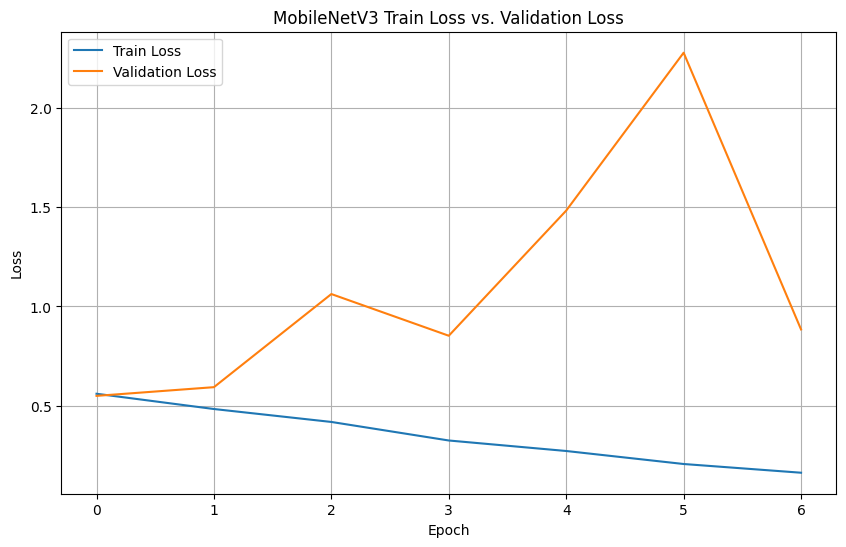


Model training history saved to Cardiomegaly_mobilenetv3_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/80 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.6728
Test Accuracy:   0.6933
Test F1 Score:   0.7749
Test AUC-ROC:    0.7347

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/80 [00:00<?, ?it/s]

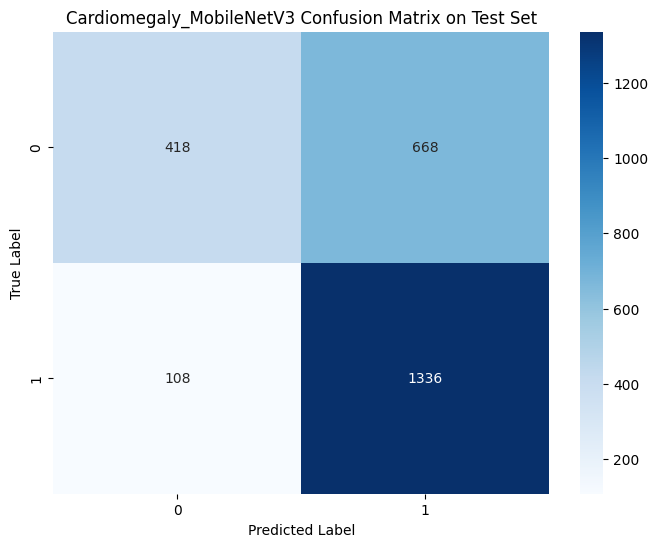

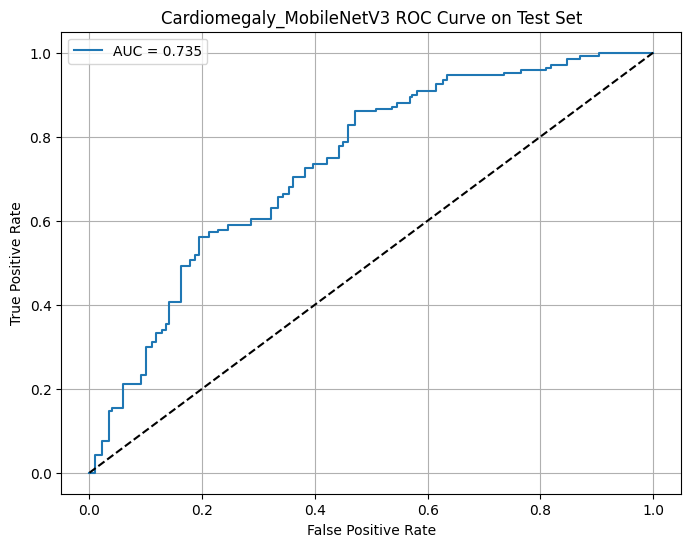


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.79      0.38      0.52      1086
    Positive       0.67      0.93      0.77      1444

    accuracy                           0.69      2530
   macro avg       0.73      0.66      0.65      2530
weighted avg       0.72      0.69      0.66      2530



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Cardiomegaly'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
# Initialize MobileNetV3-Large Model
print("\n--- Starting MobileNetV3-Large Model Initialization (MobileNetV3 on Cardiomegaly dataset) ---")

model = models.mobilenet_v3_large(weights=models.MobileNet_V3_Large_Weights.IMAGENET1K_V1)

# classifier for binary classification
num_ftrs = model.classifier[-1].in_features
model.classifier[-1] = nn.Sequential(
    nn.Dropout(p=0.3),
    nn.Linear(num_ftrs, 512),
    nn.Hardswish(),
    nn.Dropout(p=0.3),
    nn.Linear(512, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

print(f"Model initialized on: {device}")
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# ----------------------------------------------------------------------
print("\n--- Starting MobileNetV3-Large Model Training on Cardiomegaly dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Cardiomegaly_mobilenetv3_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

# Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('MobileNetV3 Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('Cardiomegaly_mobilenetv3_train_val_loss_plot.png')
plt.show()

# Storing Model History
history_filename = 'Cardiomegaly_mobilenetv3_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")

# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset and loader
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# Load best model
model.load_state_dict(torch.load('best_Cardiomegaly_mobilenetv3_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Cardiomegaly_MobileNetV3 Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('mobilenetv3_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Cardiomegaly_MobileNetV3 ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Cardiomegaly_mobilenetv3_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


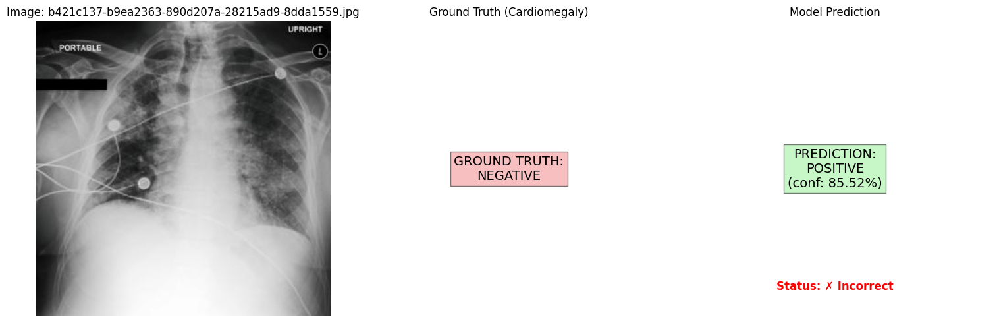


Image: b421c137-b9ea2363-890d207a-28215ad9-8dda1559.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.8552)
Prediction Status: ✗ Incorrect
--------------------------------------------------


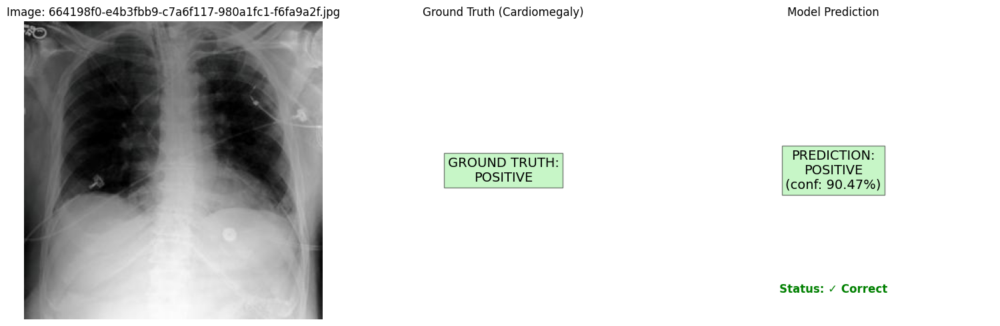


Image: 664198f0-e4b3fbb9-c7a6f117-980a1fc1-f6fa9a2f.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9047)
Prediction Status: ✓ Correct
--------------------------------------------------


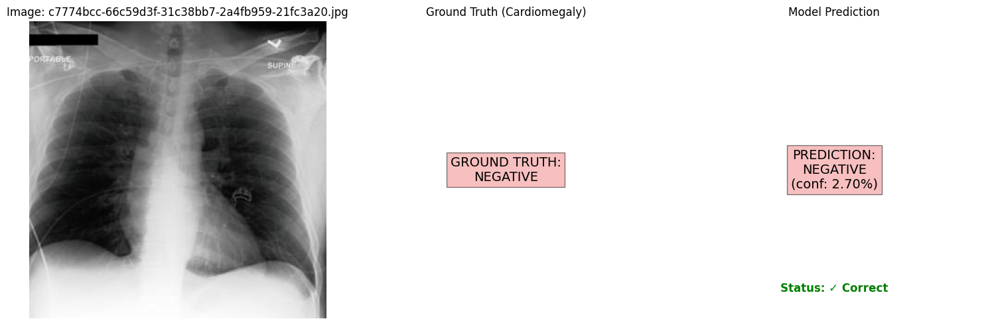


Image: c7774bcc-66c59d3f-31c38bb7-2a4fb959-21fc3a20.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0270)
Prediction Status: ✓ Correct
--------------------------------------------------


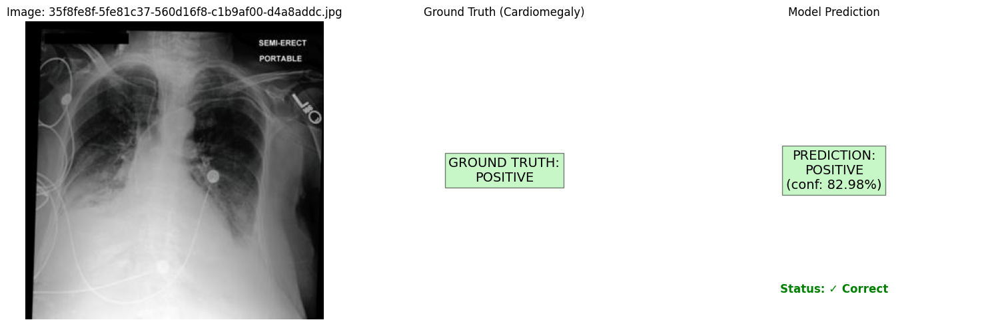


Image: 35f8fe8f-5fe81c37-560d16f8-c1b9af00-d4a8addc.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8298)
Prediction Status: ✓ Correct
--------------------------------------------------


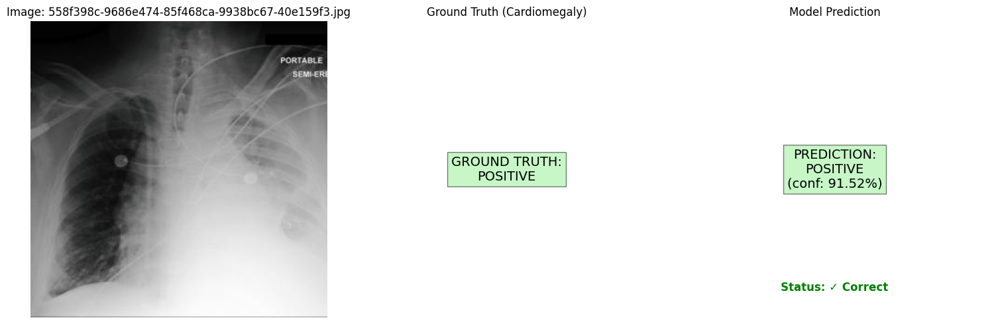


Image: 558f398c-9686e474-85f468ca-9938bc67-40e159f3.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9152)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Cardiomegaly'].values[0]

    # Move to device and make prediction
    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Cardiomegaly_mobilenetv3_model.pth'))
except:
    model.load_state_dict(torch.load('best_Cardiomegaly_mobilenetv3_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

# Edema Models

STATISTICAL ANALYSIS FOR CLASS: EDEMA

--- TRAIN SET (Edema_train.csv) ---
Total entries (Row Count): 4,968

Condition label distribution (per column):
  • Edema          :
    - Positive (1) :   2,067 ( 41.6%)
    - Negative (0) :   2,901
    - Total Labeled:   4,968

--- VAL SET (Edema_val.csv) ---
Total entries (Row Count): 391

Condition label distribution (per column):
  • Edema          :
    - Positive (1) :     148 ( 37.9%)
    - Negative (0) :     243
    - Total Labeled:     391

--- TEST SET (Edema_test.csv) ---
Total entries (Row Count): 2,230

Condition label distribution (per column):
  • Edema          :
    - Positive (1) :     801 ( 35.9%)
    - Negative (0) :   1,429
    - Total Labeled:   2,230

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
PLOTTING TRAINING SET LABEL DISTRIBUTION FOR: EDEMA
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

Training Set total label counts: 
0.0    2901
1.0    2067


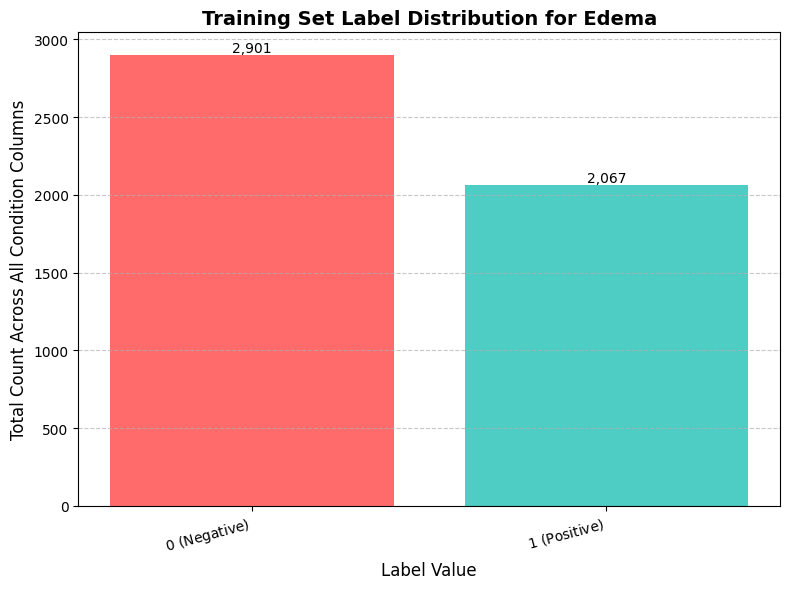

Plot saved as 'edema_label_distribution.png'

--- Starting Data Load for Class: Edema ---
  Loaded train CSV: 4,968 entries. Verified images: 4,968.
  Loaded val CSV: 391 entries. Verified images: 391.
  Loaded test CSV: 2,230 entries. Verified images: 2,230.
Sucesfully Loaded Dataset


In [ ]:
target_class="Edema"
# 1. Analyze the CSVs and retrieve the training dataframe
train_df_result = analyze_class_csv_stats(class_name=target_class)
# 2. Plot the label distribution for the retrieved training dataframe
visualize_training_label_distribution(class_name=target_class, train_df=train_df_result)
loaded_data = load_dataset(class_name="Edema")

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
from torch.utils.data import DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score
from torchvision import transforms
from torch.utils.data import Dataset
import torch.nn.functional as F
from PIL import Image

# Custom Dataset class
class ChestXRayDataset(Dataset):
    def __init__(self, dataframe, image_paths, transform=None):
        self.dataframe = dataframe
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        # Get the label from the dataframe
        df_idx = self.dataframe.index[self.dataframe['cxr_path'].str.contains(os.path.basename(img_path))][0]
        label = torch.tensor(self.dataframe.iloc[df_idx]['Edema'], dtype=torch.float32)

        return image, label

# Data transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

print ("Edema CXR dataset loaded" )

Edema CXR dataset loaded


## ResNet 18 - Edema


--- Starting ResNet Model Initialization (ResNet18 on Edema dataset) ---

--- Starting ResNet Model Training on Edema dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 1/20 | Time: 56.20s
------------------------------------------------------------
Training:    Loss: 0.4334, Accuracy: 0.7983, F1: 0.7943, AUC-ROC: 0.8825
Validation: Loss: 0.4275, Accuracy: 0.8363, F1: 0.7922, AUC-ROC: 0.8880
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8880


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 2/20 | Time: 48.76s
------------------------------------------------------------
Training:    Loss: 0.2843, Accuracy: 0.8931, F1: 0.8949, AUC-ROC: 0.9508
Validation: Loss: 0.5844, Accuracy: 0.7442, F1: 0.7041, AUC-ROC: 0.8166


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 3/20 | Time: 46.03s
------------------------------------------------------------
Training:    Loss: 0.1945, Accuracy: 0.9275, F1: 0.9280, AUC-ROC: 0.9763
Validation: Loss: 0.8016, Accuracy: 0.7212, F1: 0.7109, AUC-ROC: 0.8589


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 4/20 | Time: 45.71s
------------------------------------------------------------
Training:    Loss: 0.1120, Accuracy: 0.9597, F1: 0.9597, AUC-ROC: 0.9915
Validation: Loss: 0.6315, Accuracy: 0.8133, F1: 0.7653, AUC-ROC: 0.8671


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 5/20 | Time: 45.41s
------------------------------------------------------------
Training:    Loss: 0.0654, Accuracy: 0.9791, F1: 0.9793, AUC-ROC: 0.9973
Validation: Loss: 0.6764, Accuracy: 0.8082, F1: 0.7405, AUC-ROC: 0.8724


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 6/20 | Time: 45.20s
------------------------------------------------------------
Training:    Loss: 0.0604, Accuracy: 0.9823, F1: 0.9825, AUC-ROC: 0.9971
Validation: Loss: 0.6378, Accuracy: 0.8159, F1: 0.7534, AUC-ROC: 0.8891
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8891


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 7/20 | Time: 45.31s
------------------------------------------------------------
Training:    Loss: 0.0508, Accuracy: 0.9827, F1: 0.9829, AUC-ROC: 0.9982
Validation: Loss: 0.7056, Accuracy: 0.8056, F1: 0.7580, AUC-ROC: 0.8690


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 8/20 | Time: 45.24s
------------------------------------------------------------
Training:    Loss: 0.0438, Accuracy: 0.9855, F1: 0.9855, AUC-ROC: 0.9986
Validation: Loss: 0.7965, Accuracy: 0.7852, F1: 0.7325, AUC-ROC: 0.8576


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 9/20 | Time: 45.49s
------------------------------------------------------------
Training:    Loss: 0.0289, Accuracy: 0.9909, F1: 0.9907, AUC-ROC: 0.9995
Validation: Loss: 0.8412, Accuracy: 0.7954, F1: 0.7241, AUC-ROC: 0.8647


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 10/20 | Time: 45.26s
------------------------------------------------------------
Training:    Loss: 0.0170, Accuracy: 0.9962, F1: 0.9961, AUC-ROC: 0.9997
Validation: Loss: 0.7998, Accuracy: 0.8056, F1: 0.7121, AUC-ROC: 0.8636


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 11/20 | Time: 44.63s
------------------------------------------------------------
Training:    Loss: 0.0235, Accuracy: 0.9930, F1: 0.9929, AUC-ROC: 0.9997
Validation: Loss: 0.8283, Accuracy: 0.8107, F1: 0.7448, AUC-ROC: 0.8655

Early stopping triggered after epoch 11. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---

Model training history saved to Edema_resnet18_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/70 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:        0.7837
Test Accuracy:    0.8179
Test F1 Score:    0.7268
Test AUC-ROC:     0.8698

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/70 [00:00<?, ?it/s]


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.83      0.90      0.86      1429
    Positive       0.79      0.67      0.73       801

    accuracy                           0.82      2230
   macro avg       0.81      0.79      0.80      2230
weighted avg       0.82      0.82      0.81      2230



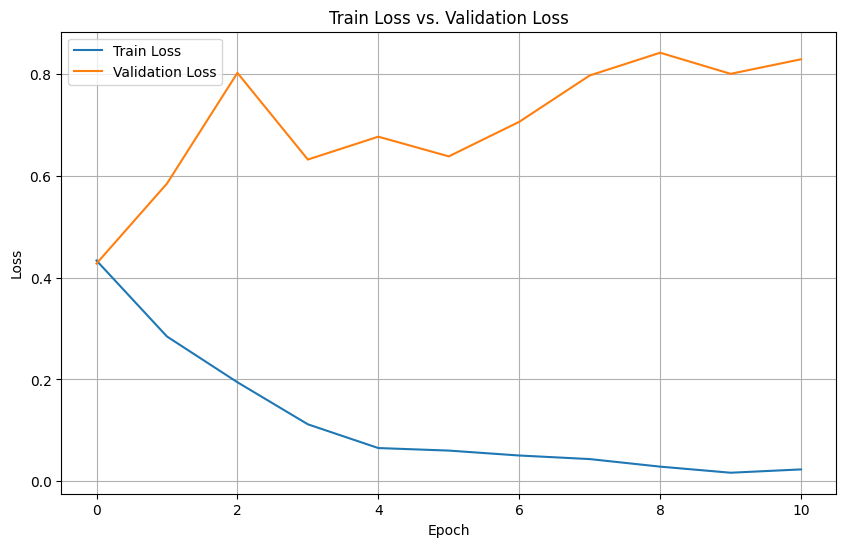

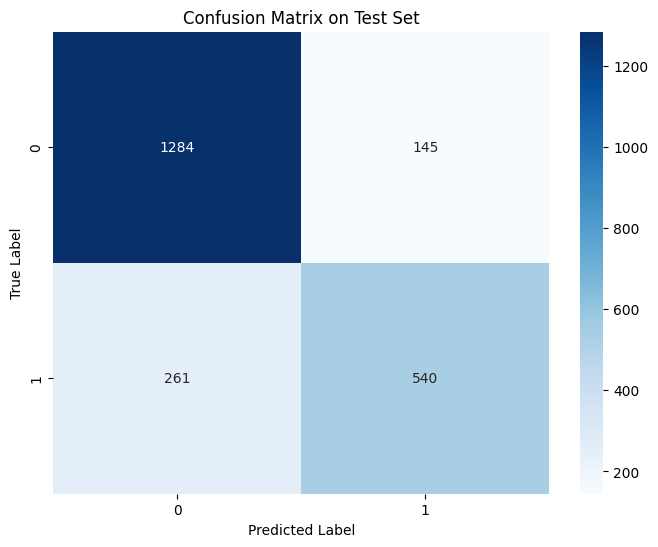

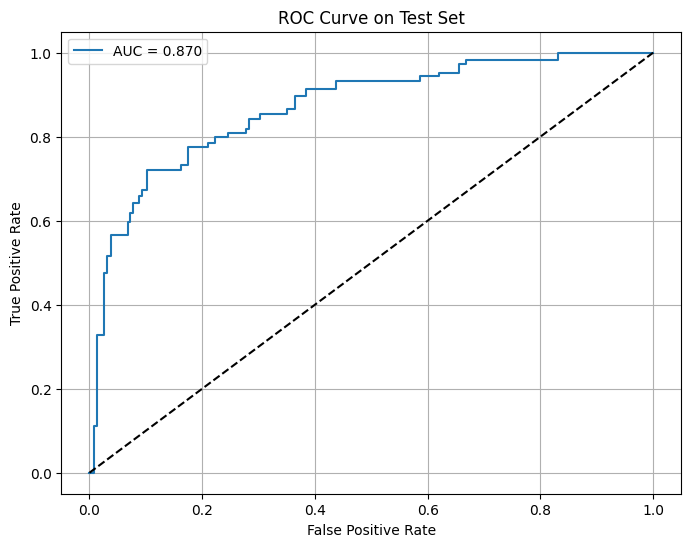

In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle


# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Edema'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------

print("\n--- Starting ResNet Model Initialization (ResNet18 on Edema dataset) ---")

# Initialize ResNet18 model
model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
num_ftrs = model.fc.in_features

model.fc = nn.Sequential(
    nn.Dropout(0.5),
    nn.Linear(num_ftrs, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()


optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001, weight_decay=0.05)


# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    # Wrap the loader with tqdm for a progress bar
    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Store predictions and true labels for metrics
        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Training on Edema dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}


for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s') # Print epoch time
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        # UPDATED CHECKPOINT FILENAME
        torch.save(model.state_dict(), 'best_Edema_resnet18_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
# Ensure plots only include completed epochs if early stopping occurred
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot.png')
plt.show() # Disabled for non-interactive environment

## Storing Model History
# UPDATED HISTORY FILENAME
history_filename = 'Edema_resnet18_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
try:

    model.load_state_dict(torch.load('best_Edema_resnet18_model.pth'))
except:
    model.load_state_dict(torch.load('best_Edema_resnet18_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:        {test_loss:.4f}")
print(f"Test Accuracy:    {test_acc:.4f}")
print(f"Test F1 Score:    {test_f1:.4f}")
print(f"Test AUC-ROC:     {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix.png')
# plt.show() # Disabled for non-interactive environment

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)  # Use y_prob directly for binary classification
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve.png')
# plt.show() # Disabled for non-interactive environment

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


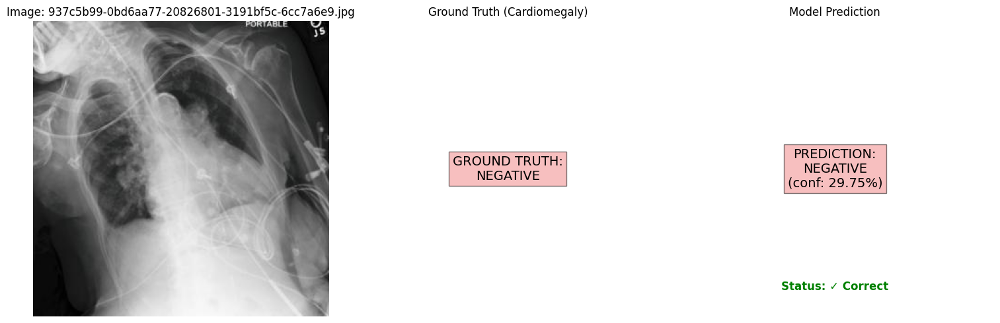


Image: 937c5b99-0bd6aa77-20826801-3191bf5c-6cc7a6e9.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.2975)
Prediction Status: ✓ Correct
--------------------------------------------------


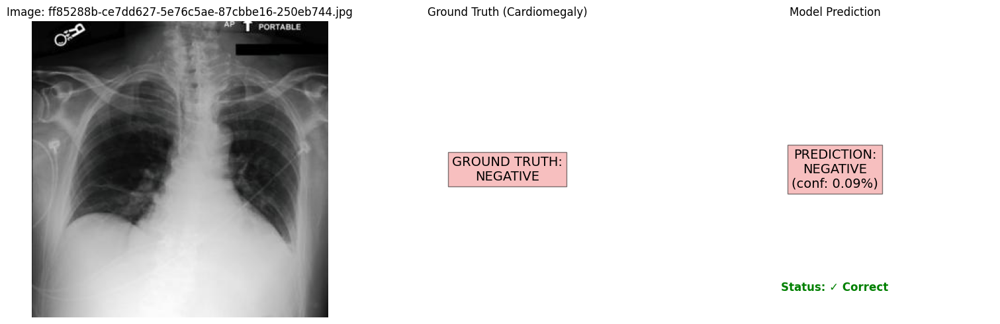


Image: ff85288b-ce7dd627-5e76c5ae-87cbbe16-250eb744.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0009)
Prediction Status: ✓ Correct
--------------------------------------------------


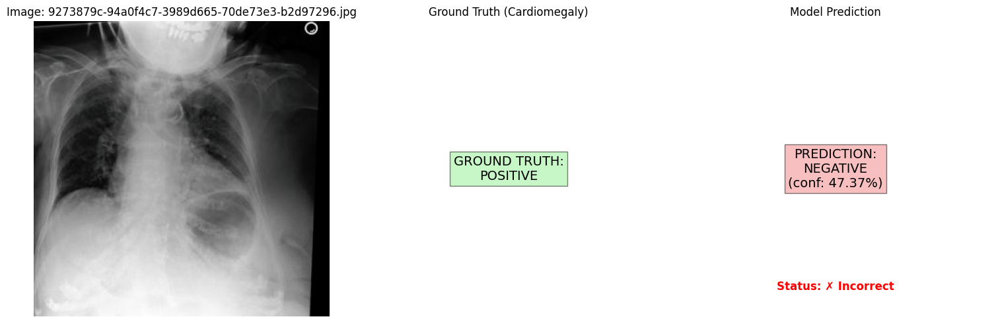


Image: 9273879c-94a0f4c7-3989d665-70de73e3-b2d97296.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.4737)
Prediction Status: ✗ Incorrect
--------------------------------------------------


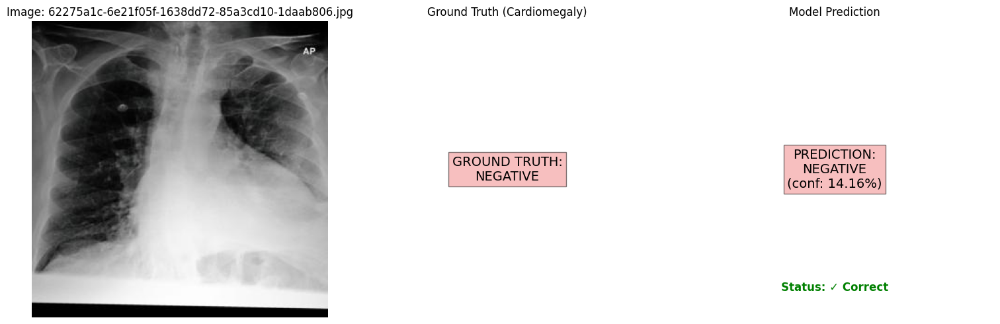


Image: 62275a1c-6e21f05f-1638dd72-85a3cd10-1daab806.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1416)
Prediction Status: ✓ Correct
--------------------------------------------------


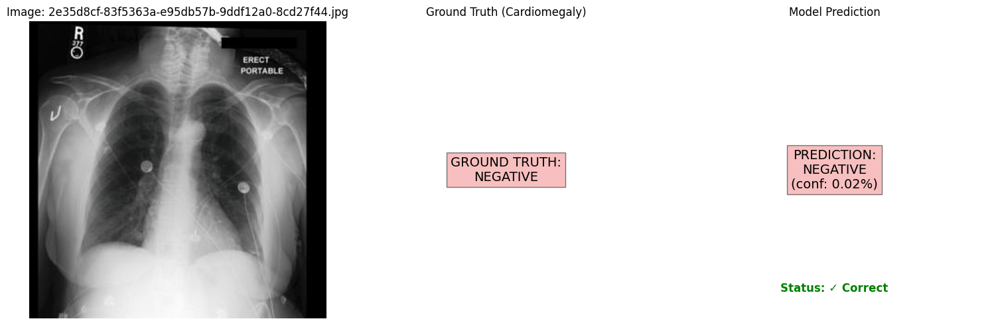


Image: 2e35d8cf-83f5363a-e95db57b-9ddf12a0-8cd27f44.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0002)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Edema'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

try:
    model.load_state_dict(torch.load('best_Edema_resnet18_model.pth'))
except:
    model.load_state_dict(torch.load('best_Edema_resnet18_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## ResNet 50 - Edema


--- Starting ResNet Model Initialization (ResNet50 on Edema dataset) ---

--- Starting ResNet Model Training on Edema dataset with Regularization and Scheduler ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 1/20 | Time: 85.47s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.5012, Accuracy: 0.7611, F1: 0.7693, AUC-ROC: 0.8382
Validation: Loss: 0.5589, Accuracy: 0.7366, F1: 0.5463, AUC-ROC: 0.8332
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8332


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 2/20 | Time: 83.45s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.4465, Accuracy: 0.8013, F1: 0.8089, AUC-ROC: 0.8745
Validation: Loss: 0.4842, Accuracy: 0.7647, F1: 0.6933, AUC-ROC: 0.8470
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8470


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 3/20 | Time: 81.37s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.4414, Accuracy: 0.7937, F1: 0.8015, AUC-ROC: 0.8761
Validation: Loss: 0.5382, Accuracy: 0.7340, F1: 0.7095, AUC-ROC: 0.8407


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 4/20 | Time: 81.42s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.4390, Accuracy: 0.7997, F1: 0.8006, AUC-ROC: 0.8783
Validation: Loss: 0.5463, Accuracy: 0.7263, F1: 0.7068, AUC-ROC: 0.8351


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 5/20 | Time: 81.83s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.4061, Accuracy: 0.8160, F1: 0.8149, AUC-ROC: 0.8972
Validation: Loss: 0.5711, Accuracy: 0.6982, F1: 0.4779, AUC-ROC: 0.8186


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 6/20 | Time: 81.00s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.3916, Accuracy: 0.8273, F1: 0.8291, AUC-ROC: 0.9048
Validation: Loss: 0.6009, Accuracy: 0.7391, F1: 0.5603, AUC-ROC: 0.8325


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 7/20 | Time: 80.94s | LR: 0.0001
------------------------------------------------------------
Training:    Loss: 0.3667, Accuracy: 0.8460, F1: 0.8488, AUC-ROC: 0.9170
Validation: Loss: 0.5227, Accuracy: 0.7749, F1: 0.6535, AUC-ROC: 0.8453

Early stopping triggered after epoch 7. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---


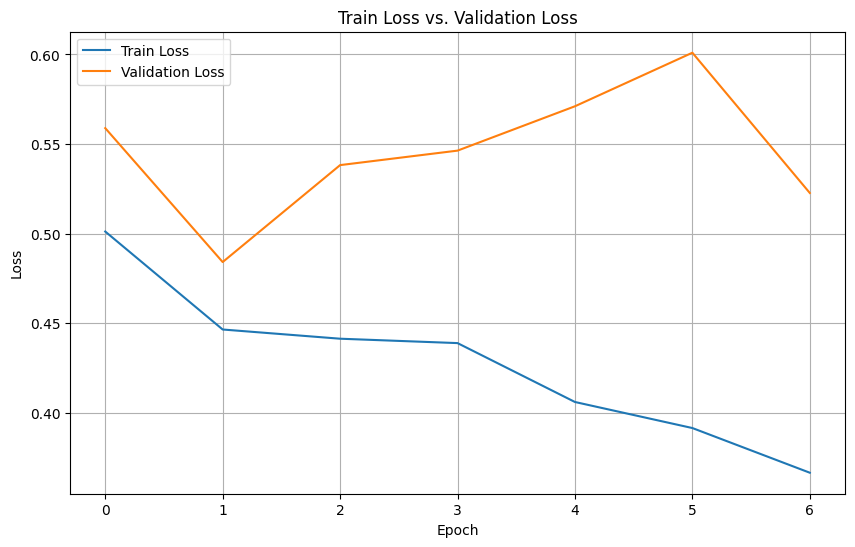


Model training history saved to Edema_resnet50_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/70 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.4630
Test Accuracy:   0.7919
Test F1 Score:   0.6935
Test AUC-ROC:    0.8450

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/70 [00:00<?, ?it/s]

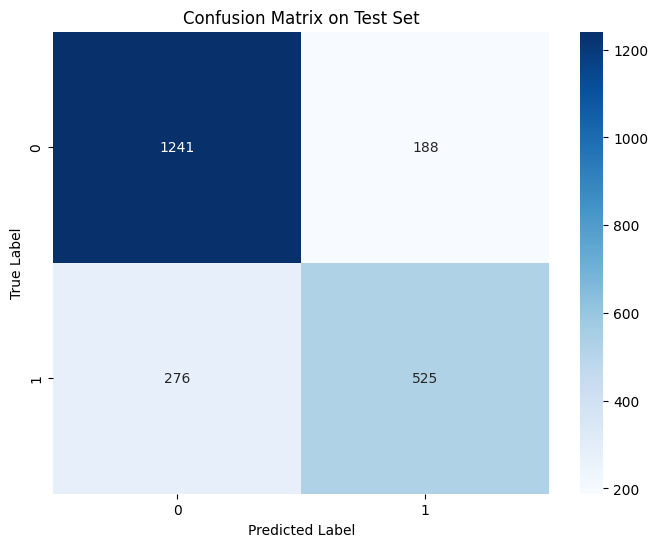

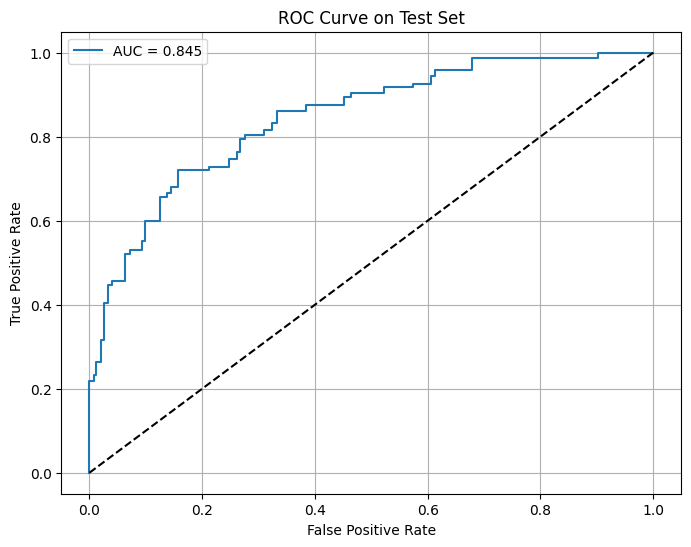


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.82      0.87      0.84      1429
    Positive       0.74      0.66      0.69       801

    accuracy                           0.79      2230
   macro avg       0.78      0.76      0.77      2230
weighted avg       0.79      0.79      0.79      2230



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle
from torch.optim.lr_scheduler import ReduceLROnPlateau


# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Edema'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Initialization (ResNet50 on Edema dataset) ---")

# Initialize ResNet50 model
model = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V2)
num_ftrs = model.fc.in_features
model.fc = nn.Sequential(
    nn.Dropout(p=0.6),
    nn.Linear(num_ftrs, 1)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()

optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.5)

scheduler = ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.1,
    patience=4,
    verbose=True
)


# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Store predictions and true labels for metrics
        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():

        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Training on Edema dataset with Regularization and Scheduler ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0

patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}


for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    # *** SCHEDULER STEP ***
    scheduler.step(val_auc)

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s | LR: {optimizer.param_groups[0]["lr"]}')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0 #
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Edema_resnet50_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True # Set flag to stop next iteration


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot_regularized.png')
plt.show()

## Storing Model History
history_filename = 'Edema_resnet50_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)




print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
try:
    model.load_state_dict(torch.load('best_Edema_resnet50_model.pth'))
except:
    model.load_state_dict(torch.load('best_Edema_resnet50_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix_regularized.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve_regularized.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


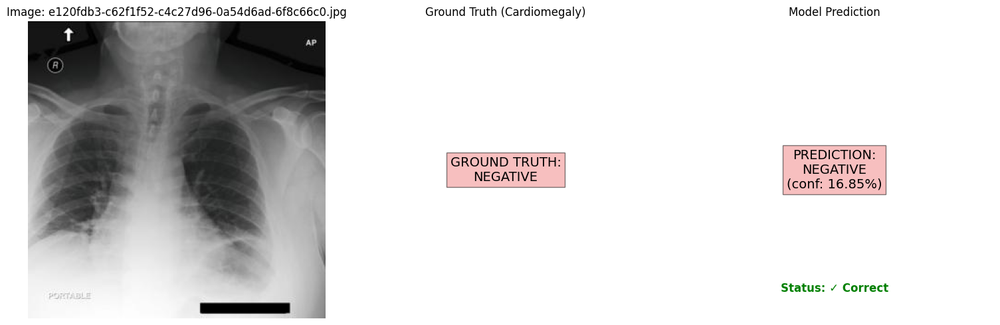


Image: e120fdb3-c62f1f52-c4c27d96-0a54d6ad-6f8c66c0.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1685)
Prediction Status: ✓ Correct
--------------------------------------------------


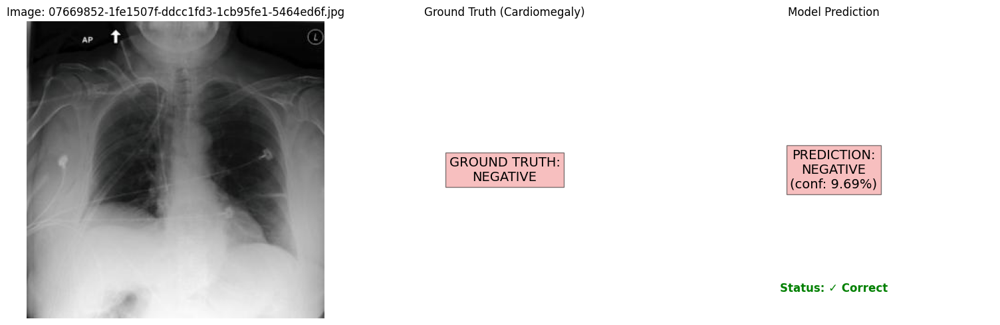


Image: 07669852-1fe1507f-ddcc1fd3-1cb95fe1-5464ed6f.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0969)
Prediction Status: ✓ Correct
--------------------------------------------------


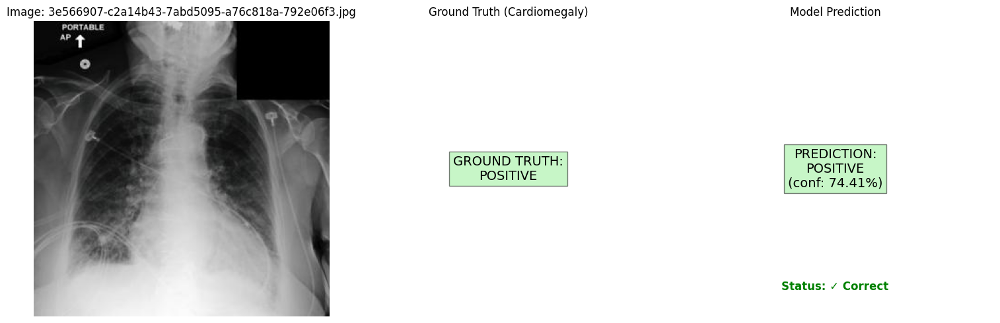


Image: 3e566907-c2a14b43-7abd5095-a76c818a-792e06f3.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7441)
Prediction Status: ✓ Correct
--------------------------------------------------


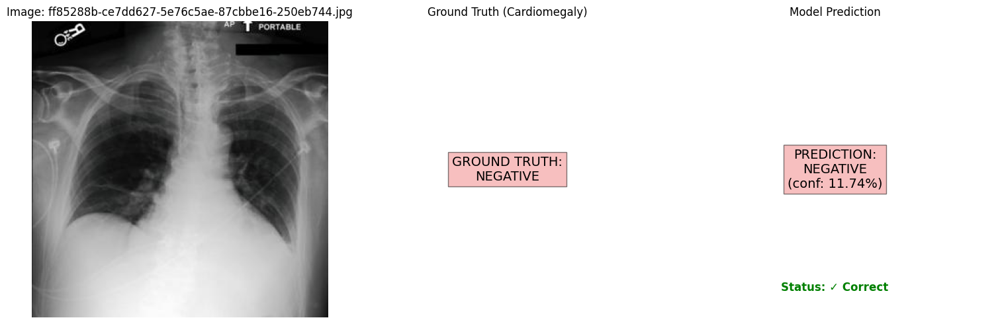


Image: ff85288b-ce7dd627-5e76c5ae-87cbbe16-250eb744.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1174)
Prediction Status: ✓ Correct
--------------------------------------------------


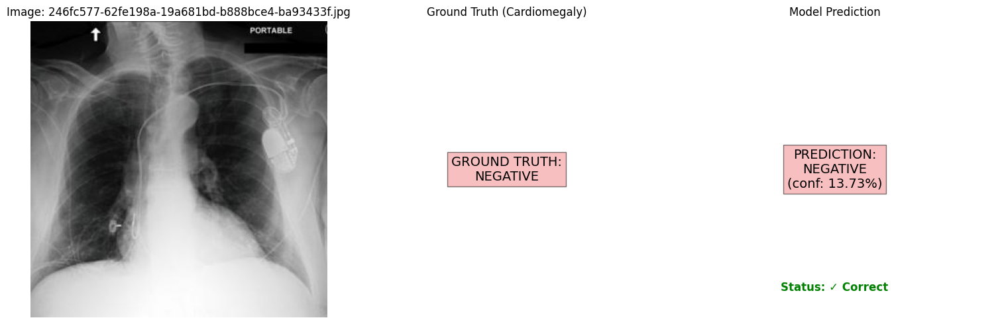


Image: 246fc577-62fe198a-19a681bd-b888bce4-ba93433f.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1373)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 5
Accuracy: 100.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Edema'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Edema_resnet50_model.pth'))
except:
    model.load_state_dict(torch.load('best_Edema_resnet50_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## VGG16 Edema


--- Starting VGG Model Initialization (VGG16 on Edema dataset) ---

--- Starting VGG16 Model Training on Edema dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 1/20 | Time: 126.16s
------------------------------------------------------------
Training:    Loss: 0.6454, Accuracy: 0.6282, F1: 0.6296, AUC-ROC: 0.6780
Validation: Loss: 0.6101, Accuracy: 0.6522, F1: 0.6699, AUC-ROC: 0.8317
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8317


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 2/20 | Time: 122.91s
------------------------------------------------------------
Training:    Loss: 0.5428, Accuracy: 0.7311, F1: 0.7326, AUC-ROC: 0.8020
Validation: Loss: 0.4407, Accuracy: 0.7903, F1: 0.7545, AUC-ROC: 0.8789
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8789


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 3/20 | Time: 122.57s
------------------------------------------------------------
Training:    Loss: 0.5111, Accuracy: 0.7506, F1: 0.7671, AUC-ROC: 0.8275
Validation: Loss: 0.4169, Accuracy: 0.8031, F1: 0.7220, AUC-ROC: 0.8836
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8836


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 4/20 | Time: 122.65s
------------------------------------------------------------
Training:    Loss: 0.4932, Accuracy: 0.7681, F1: 0.7725, AUC-ROC: 0.8403
Validation: Loss: 0.4045, Accuracy: 0.8261, F1: 0.7763, AUC-ROC: 0.8888
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8888


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 5/20 | Time: 122.34s
------------------------------------------------------------
Training:    Loss: 0.4868, Accuracy: 0.7754, F1: 0.7771, AUC-ROC: 0.8474
Validation: Loss: 0.4415, Accuracy: 0.8056, F1: 0.7697, AUC-ROC: 0.8814


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 6/20 | Time: 122.56s
------------------------------------------------------------
Training:    Loss: 0.4939, Accuracy: 0.7681, F1: 0.7700, AUC-ROC: 0.8426
Validation: Loss: 0.4161, Accuracy: 0.8159, F1: 0.7750, AUC-ROC: 0.8867


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 7/20 | Time: 122.17s
------------------------------------------------------------
Training:    Loss: 0.4913, Accuracy: 0.7641, F1: 0.7772, AUC-ROC: 0.8405
Validation: Loss: 0.3876, Accuracy: 0.8389, F1: 0.7893, AUC-ROC: 0.8991
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8991


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 8/20 | Time: 122.37s
------------------------------------------------------------
Training:    Loss: 0.4534, Accuracy: 0.7953, F1: 0.8013, AUC-ROC: 0.8661
Validation: Loss: 0.4200, Accuracy: 0.8133, F1: 0.7754, AUC-ROC: 0.8876


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 9/20 | Time: 122.08s
------------------------------------------------------------
Training:    Loss: 0.4641, Accuracy: 0.7796, F1: 0.7783, AUC-ROC: 0.8602
Validation: Loss: 0.4316, Accuracy: 0.8107, F1: 0.7758, AUC-ROC: 0.8859


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 10/20 | Time: 122.59s
------------------------------------------------------------
Training:    Loss: 0.4465, Accuracy: 0.7963, F1: 0.7975, AUC-ROC: 0.8735
Validation: Loss: 0.4468, Accuracy: 0.8031, F1: 0.7354, AUC-ROC: 0.8748


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 11/20 | Time: 121.62s
------------------------------------------------------------
Training:    Loss: 0.4342, Accuracy: 0.8017, F1: 0.8131, AUC-ROC: 0.8768
Validation: Loss: 0.4030, Accuracy: 0.8210, F1: 0.7799, AUC-ROC: 0.8933


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 12/20 | Time: 121.57s
------------------------------------------------------------
Training:    Loss: 0.4342, Accuracy: 0.8015, F1: 0.8054, AUC-ROC: 0.8809
Validation: Loss: 0.4131, Accuracy: 0.8210, F1: 0.7697, AUC-ROC: 0.8916

Early stopping triggered after epoch 12. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---


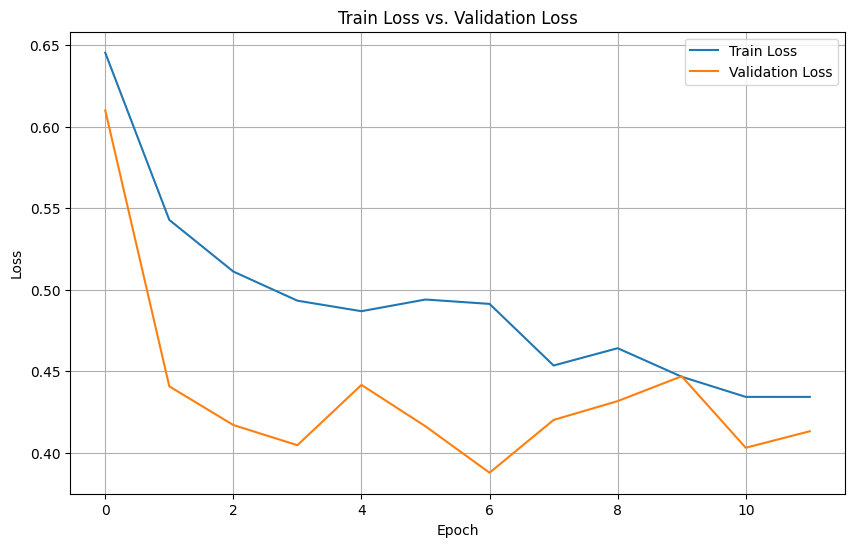


Model training history saved to Edema_vgg16_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/70 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.4130
Test Accuracy:   0.8439
Test F1 Score:   0.7731
Test AUC-ROC:    0.8826

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/70 [00:00<?, ?it/s]

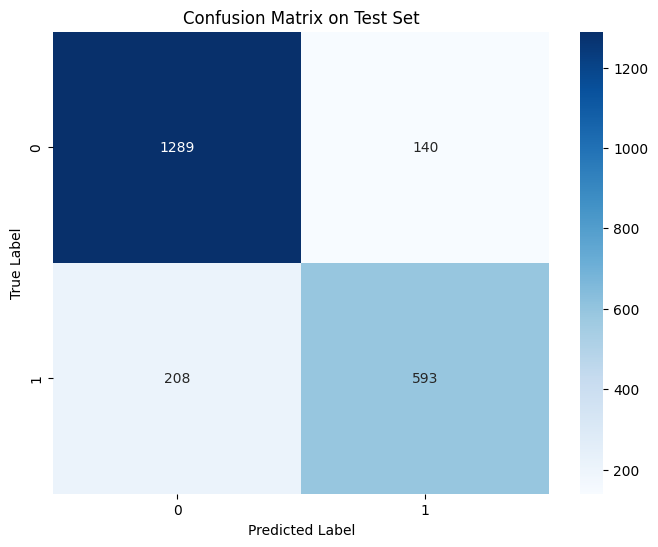

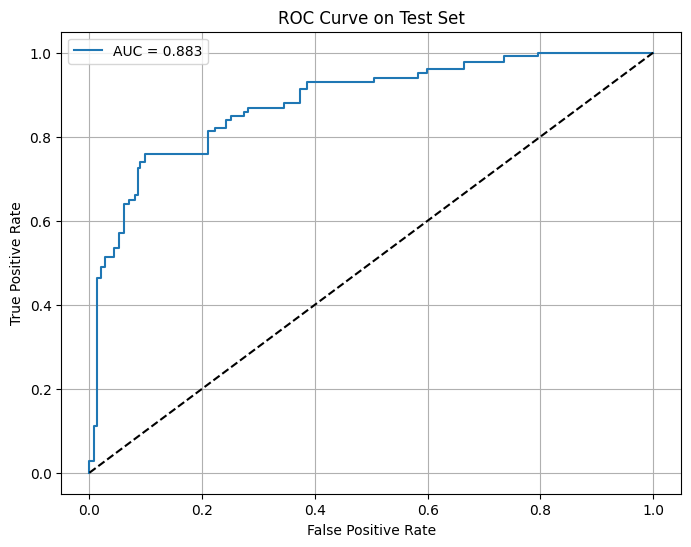


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.86      0.90      0.88      1429
    Positive       0.81      0.74      0.77       801

    accuracy                           0.84      2230
   macro avg       0.84      0.82      0.83      2230
weighted avg       0.84      0.84      0.84      2230



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle



# Initialize VGG16 model
def create_vgg16_model(num_classes=1, pretrained=True):
    model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1 if pretrained else None)

    model.classifier = nn.Sequential(
        nn.Linear(512 * 7 * 7, 4096),
        nn.ReLU(True),
        nn.Dropout(p=0.5),
        nn.Linear(4096, 1024),
        nn.ReLU(True),
        nn.Dropout(p=0.5),
        nn.Linear(1024, num_classes)
    )

    for m in model.classifier.modules():
        if isinstance(m, nn.Linear):
            nn.init.xavier_normal_(m.weight)
            nn.init.constant_(m.bias, 0)

    return model

vgg16_train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomRotation(15),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

vgg16_test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=vgg16_train_transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=vgg16_test_transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Edema'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)


print("\n--- Starting VGG Model Initialization (VGG16 on Edema dataset) ---")

# Initialize VGG16 model
model = create_vgg16_model(num_classes=1)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()

# Define optimizer
optimizer = torch.optim.AdamW(
    model.parameters(),
    lr=1e-4,
    weight_decay=0.01,
    amsgrad=True
)

# Learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True
)


# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Store predictions and true labels for metrics
        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting VGG16 Model Training on Edema dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # ADD SCHEDULER STEP
    scheduler.step(val_auc)

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        # UPDATED CHECKPOINT FILENAME
        torch.save(model.state_dict(), 'best_Edema_vgg16_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot.png')
plt.show()

## Storing Model History
# UPDATED HISTORY FILENAME
history_filename = 'Edema_vgg16_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset

test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=vgg16_test_transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
try:

    model.load_state_dict(torch.load('best_Edema_vgg16_model.pth'))
except:
    model.load_state_dict(torch.load('best_Edema_vgg16_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


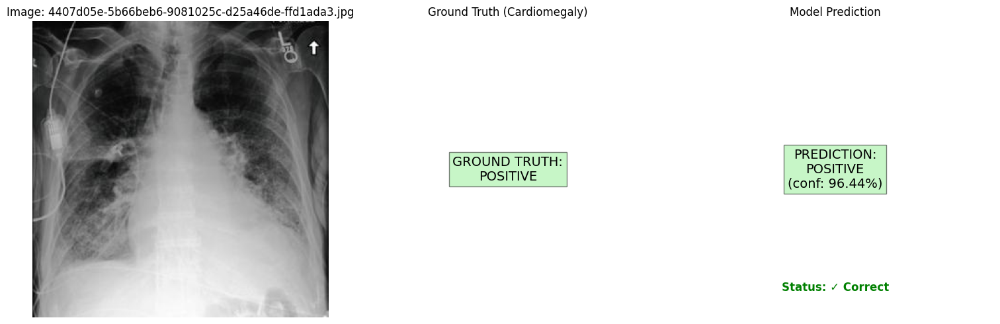


Image: 4407d05e-5b66beb6-9081025c-d25a46de-ffd1ada3.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9644)
Prediction Status: ✓ Correct
--------------------------------------------------


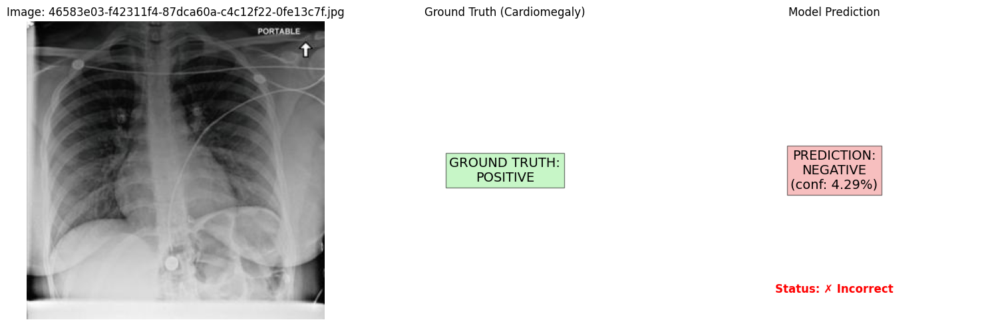


Image: 46583e03-f42311f4-87dca60a-c4c12f22-0fe13c7f.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.0429)
Prediction Status: ✗ Incorrect
--------------------------------------------------


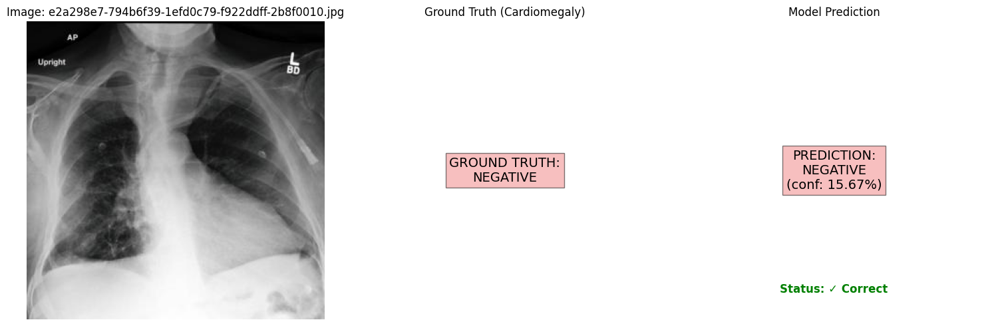


Image: e2a298e7-794b6f39-1efd0c79-f922ddff-2b8f0010.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1567)
Prediction Status: ✓ Correct
--------------------------------------------------


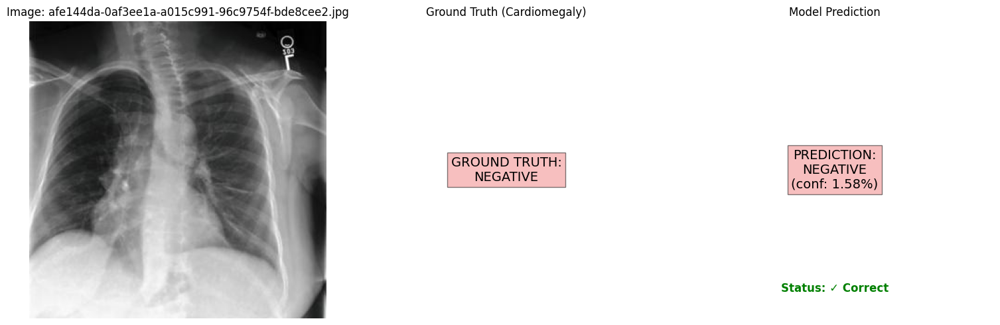


Image: afe144da-0af3ee1a-a015c991-96c9754f-bde8cee2.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0158)
Prediction Status: ✓ Correct
--------------------------------------------------


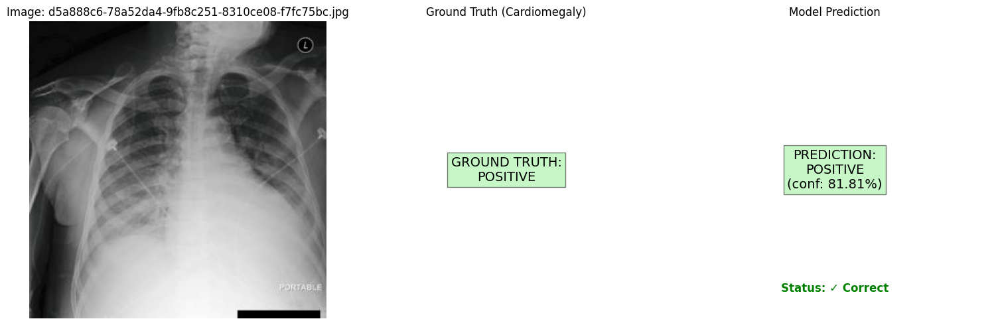


Image: d5a888c6-78a52da4-9fb8c251-8310ce08-f7fc75bc.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8181)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Edema'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Edema_vgg16_model.pth'))
except:
    model.load_state_dict(torch.load('best_Edema_vgg16_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## DenseNet121 - Edema


--- Starting DenseNet121 Model Initialization for Edema Classification ---


Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 158MB/s] 


--- Starting DenseNet121 Model Training on Edema dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 1/20 | Time: 93.77s
------------------------------------------------------------
Training:   Loss: 0.5375, Accuracy: 0.7494, F1: 0.7530, AUC-ROC: 0.8204
Validation: Loss: 2.6616, Accuracy: 0.6240, F1: 0.0134, AUC-ROC: 0.4849
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.4849


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 2/20 | Time: 89.00s
------------------------------------------------------------
Training:   Loss: 0.4733, Accuracy: 0.7836, F1: 0.7827, AUC-ROC: 0.8567
Validation: Loss: 0.6566, Accuracy: 0.6650, F1: 0.2682, AUC-ROC: 0.7857
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7857


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 3/20 | Time: 87.42s
------------------------------------------------------------
Training:   Loss: 0.4788, Accuracy: 0.7748, F1: 0.7759, AUC-ROC: 0.8515
Validation: Loss: 0.4559, Accuracy: 0.7852, F1: 0.7219, AUC-ROC: 0.8604
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8604


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 4/20 | Time: 87.90s
------------------------------------------------------------
Training:   Loss: 0.4589, Accuracy: 0.7820, F1: 0.7822, AUC-ROC: 0.8652
Validation: Loss: 0.5254, Accuracy: 0.7468, F1: 0.7273, AUC-ROC: 0.8441


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 5/20 | Time: 88.24s
------------------------------------------------------------
Training:   Loss: 0.4385, Accuracy: 0.7983, F1: 0.8047, AUC-ROC: 0.8776
Validation: Loss: 0.5478, Accuracy: 0.7263, F1: 0.7100, AUC-ROC: 0.8547


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 6/20 | Time: 88.20s
------------------------------------------------------------
Training:   Loss: 0.4346, Accuracy: 0.8035, F1: 0.8092, AUC-ROC: 0.8800
Validation: Loss: 0.4521, Accuracy: 0.7647, F1: 0.7294, AUC-ROC: 0.8748
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8748


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 7/20 | Time: 88.58s
------------------------------------------------------------
Training:   Loss: 0.4011, Accuracy: 0.8227, F1: 0.8277, AUC-ROC: 0.8984
Validation: Loss: 0.9141, Accuracy: 0.6982, F1: 0.3723, AUC-ROC: 0.8553


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 8/20 | Time: 87.86s
------------------------------------------------------------
Training:   Loss: 0.3866, Accuracy: 0.8321, F1: 0.8361, AUC-ROC: 0.9064
Validation: Loss: 0.5490, Accuracy: 0.7647, F1: 0.6462, AUC-ROC: 0.8689


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 9/20 | Time: 87.57s
------------------------------------------------------------
Training:   Loss: 0.3823, Accuracy: 0.8291, F1: 0.8338, AUC-ROC: 0.9089
Validation: Loss: 0.4591, Accuracy: 0.7877, F1: 0.6820, AUC-ROC: 0.8839
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8839


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 10/20 | Time: 87.37s
------------------------------------------------------------
Training:   Loss: 0.3677, Accuracy: 0.8416, F1: 0.8441, AUC-ROC: 0.9161
Validation: Loss: 0.5188, Accuracy: 0.7673, F1: 0.6316, AUC-ROC: 0.8556


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 11/20 | Time: 87.73s
------------------------------------------------------------
Training:   Loss: 0.3465, Accuracy: 0.8480, F1: 0.8498, AUC-ROC: 0.9253
Validation: Loss: 0.4793, Accuracy: 0.7954, F1: 0.7315, AUC-ROC: 0.8623


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 12/20 | Time: 87.71s
------------------------------------------------------------
Training:   Loss: 0.3448, Accuracy: 0.8478, F1: 0.8555, AUC-ROC: 0.9243
Validation: Loss: 0.5326, Accuracy: 0.7417, F1: 0.7218, AUC-ROC: 0.8624


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 13/20 | Time: 87.40s
------------------------------------------------------------
Training:   Loss: 0.3189, Accuracy: 0.8627, F1: 0.8683, AUC-ROC: 0.9377
Validation: Loss: 0.5022, Accuracy: 0.7801, F1: 0.6993, AUC-ROC: 0.8603


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 14/20 | Time: 86.91s
------------------------------------------------------------
Training:   Loss: 0.3113, Accuracy: 0.8720, F1: 0.8738, AUC-ROC: 0.9403
Validation: Loss: 0.4905, Accuracy: 0.7877, F1: 0.7046, AUC-ROC: 0.8661

Early stopping triggered after epoch 14. Validation AUC-ROC did not improve for 5 epochs.


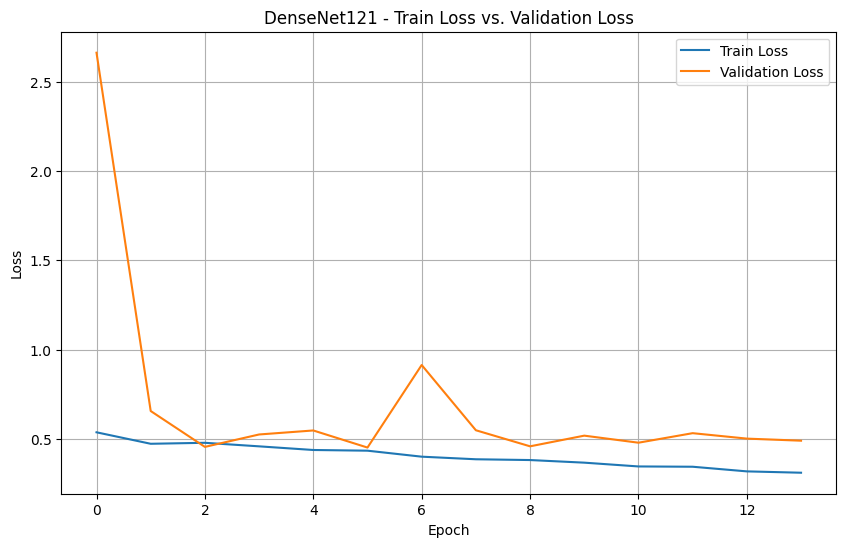


Model training history saved to Edema_densenet121_history.pkl

--- Starting DenseNet121 Evaluation on Test Dataset ---


Validation:   0%|          | 0/70 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.4838
Test Accuracy:   0.8157
Test F1 Score:   0.7198
Test AUC-ROC:    0.8579


Testing:   0%|          | 0/70 [00:00<?, ?it/s]

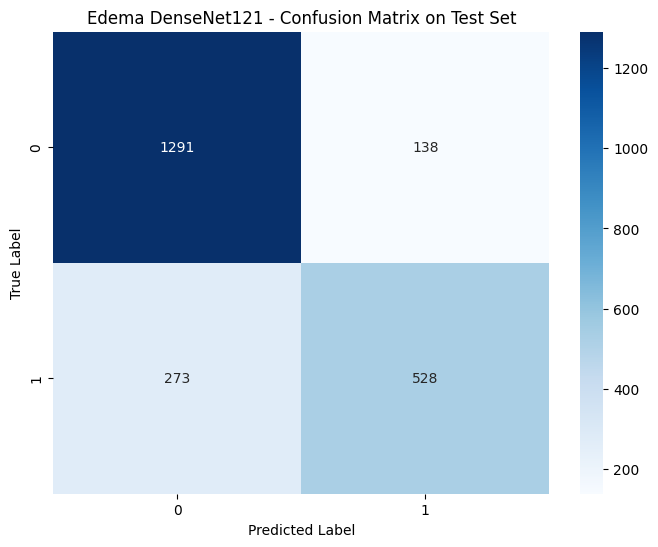

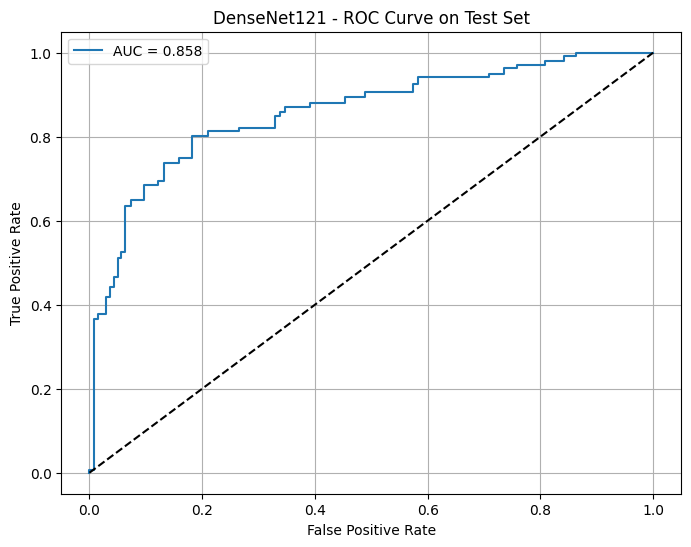


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.83      0.90      0.86      1429
    Positive       0.79      0.66      0.72       801

    accuracy                           0.82      2230
   macro avg       0.81      0.78      0.79      2230
weighted avg       0.81      0.82      0.81      2230



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle
from torch.optim.lr_scheduler import ReduceLROnPlateau


# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Edema'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
# Initialize DenseNet121 model
print("\n--- Starting DenseNet121 Model Initialization for Edema Classification ---")

model = models.densenet121(weights=models.DenseNet121_Weights.IMAGENET1K_V1)

# classifier for binary classification
num_ftrs = model.classifier.in_features
model.classifier = nn.Sequential(
    nn.BatchNorm1d(num_ftrs),
    nn.Dropout(0.4),
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.BatchNorm1d(512),
    nn.Dropout(0.4),
    nn.Linear(512, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# ----------------------------------------------------------------------
print("\n--- Starting DenseNet121 Model Training on Edema dataset ---")

num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:   Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Edema_densenet121_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# Plot Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('DenseNet121 - Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('Edeme_densenet121_train_val_loss_plot.png')
plt.show()

# Store Model History
history_filename = 'Edema_densenet121_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
# Evaluation on Test Dataset
print("\n--- Starting DenseNet121 Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)

# Load best model
model.load_state_dict(torch.load('best_Edema_densenet121_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# Calculate final metrics and generate plots
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Edema DenseNet121 - Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('Edema_densenet121_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('DenseNet121 - ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Edema_densenet121_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))




--- Randomly Predicting on 5 Test Images ---


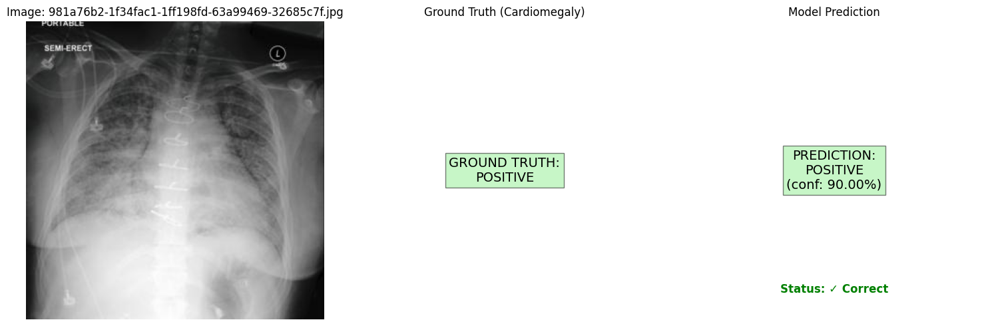


Image: 981a76b2-1f34fac1-1ff198fd-63a99469-32685c7f.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9000)
Prediction Status: ✓ Correct
--------------------------------------------------


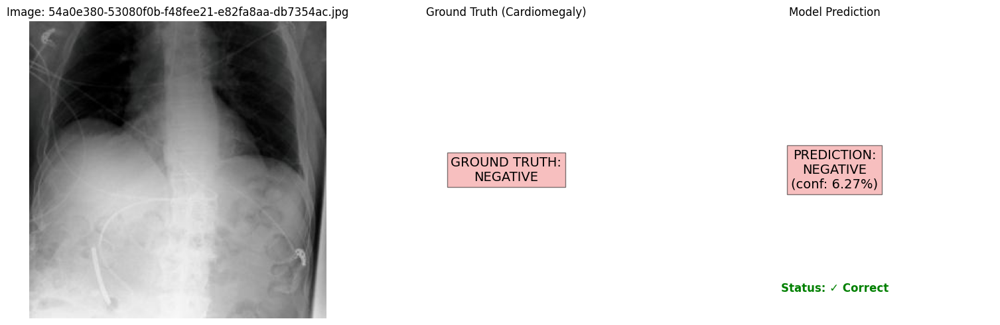


Image: 54a0e380-53080f0b-f48fee21-e82fa8aa-db7354ac.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0627)
Prediction Status: ✓ Correct
--------------------------------------------------


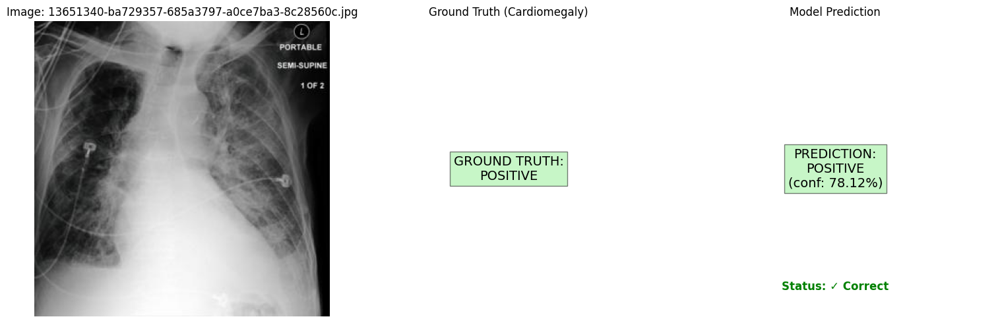


Image: 13651340-ba729357-685a3797-a0ce7ba3-8c28560c.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7812)
Prediction Status: ✓ Correct
--------------------------------------------------


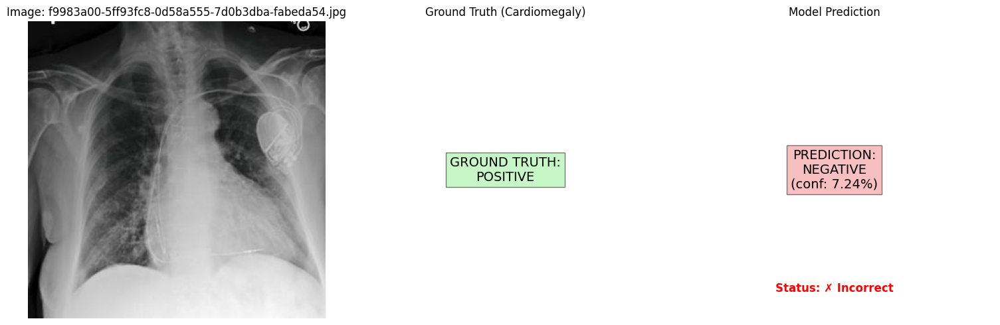


Image: f9983a00-5ff93fc8-0d58a555-7d0b3dba-fabeda54.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.0724)
Prediction Status: ✗ Incorrect
--------------------------------------------------


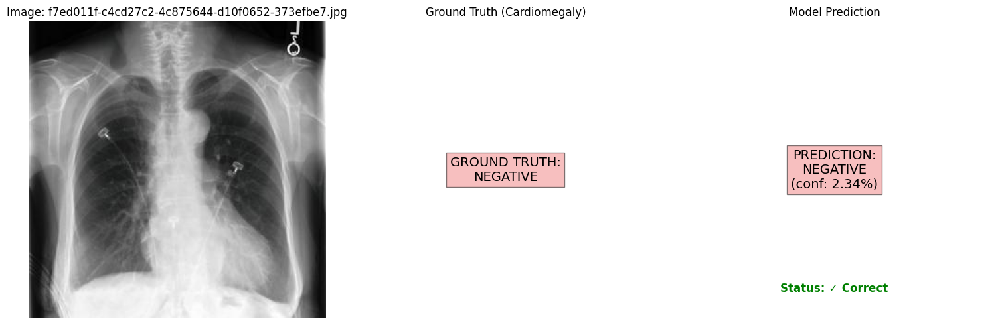


Image: f7ed011f-c4cd27c2-4c875644-d10f0652-373efbe7.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0234)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Edema'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Edema_densenet121_model.pth'))
except:
    model.load_state_dict(torch.load('best_Edema_densenet121_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## InceptionNet V3 - Edema


--- Starting InceptionV3 Model Initialization for Edema Classification ---
Model initialized on: cuda:0
Total parameters: 25,393,634
Trainable parameters: 25,393,634

--- Starting InceptionV3 Model Training on Edema dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 1/20 | Time: 117.28s
------------------------------------------------------------
Training:   Loss: 0.7149, Accuracy: 0.7566, F1: 0.7655, AUC-ROC: 0.8316
Validation: Loss: 0.4784, Accuracy: 0.7852, F1: 0.7255, AUC-ROC: 0.8491
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8491


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 2/20 | Time: 115.76s
------------------------------------------------------------
Training:   Loss: 0.6459, Accuracy: 0.7878, F1: 0.7894, AUC-ROC: 0.8656
Validation: Loss: 0.9409, Accuracy: 0.7110, F1: 0.4433, AUC-ROC: 0.8312


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 3/20 | Time: 116.66s
------------------------------------------------------------
Training:   Loss: 0.6162, Accuracy: 0.8023, F1: 0.8105, AUC-ROC: 0.8785
Validation: Loss: 0.6407, Accuracy: 0.6598, F1: 0.6780, AUC-ROC: 0.8381


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 4/20 | Time: 116.20s
------------------------------------------------------------
Training:   Loss: 0.5995, Accuracy: 0.8100, F1: 0.8180, AUC-ROC: 0.8846
Validation: Loss: 0.4870, Accuracy: 0.7826, F1: 0.6768, AUC-ROC: 0.8620
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8620


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 5/20 | Time: 116.44s
------------------------------------------------------------
Training:   Loss: 0.5736, Accuracy: 0.8188, F1: 0.8250, AUC-ROC: 0.8935
Validation: Loss: 0.6525, Accuracy: 0.7161, F1: 0.4689, AUC-ROC: 0.8506


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 6/20 | Time: 116.06s
------------------------------------------------------------
Training:   Loss: 0.5423, Accuracy: 0.8229, F1: 0.8293, AUC-ROC: 0.9046
Validation: Loss: 0.4891, Accuracy: 0.7980, F1: 0.7247, AUC-ROC: 0.8673
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8673


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 7/20 | Time: 116.01s
------------------------------------------------------------
Training:   Loss: 0.5075, Accuracy: 0.8444, F1: 0.8507, AUC-ROC: 0.9178
Validation: Loss: 0.9466, Accuracy: 0.5473, F1: 0.6210, AUC-ROC: 0.8417


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 8/20 | Time: 115.98s
------------------------------------------------------------
Training:   Loss: 0.4491, Accuracy: 0.8686, F1: 0.8734, AUC-ROC: 0.9364
Validation: Loss: 2.2717, Accuracy: 0.4859, F1: 0.5939, AUC-ROC: 0.8410


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 9/20 | Time: 115.76s
------------------------------------------------------------
Training:   Loss: 0.3970, Accuracy: 0.8869, F1: 0.8892, AUC-ROC: 0.9505
Validation: Loss: 2.3748, Accuracy: 0.4143, F1: 0.5638, AUC-ROC: 0.8226


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 10/20 | Time: 115.94s
------------------------------------------------------------
Training:   Loss: 0.3234, Accuracy: 0.9050, F1: 0.9063, AUC-ROC: 0.9672
Validation: Loss: 0.9172, Accuracy: 0.6752, F1: 0.6817, AUC-ROC: 0.8349


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 11/20 | Time: 115.86s
------------------------------------------------------------
Training:   Loss: 0.3347, Accuracy: 0.9050, F1: 0.9062, AUC-ROC: 0.9650
Validation: Loss: 0.6528, Accuracy: 0.7570, F1: 0.6332, AUC-ROC: 0.8176

Early stopping triggered after epoch 11. Validation AUC-ROC did not improve for 5 epochs.


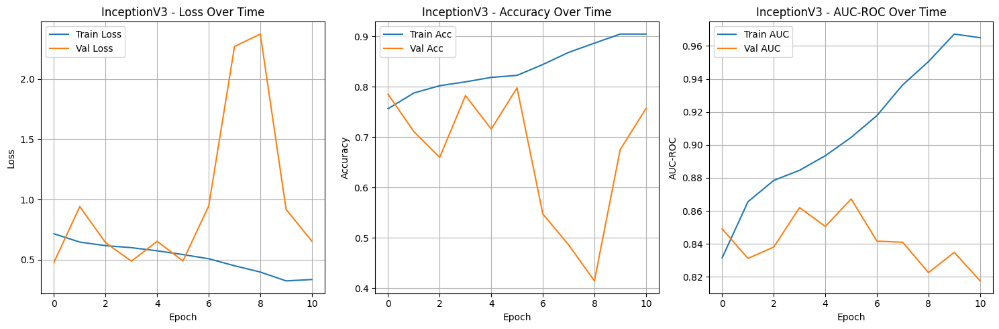


Model training history saved to Edema_inceptionv3_history.pkl

--- Starting InceptionV3 Evaluation on Test Dataset ---


Validation:   0%|          | 0/70 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.4475
Test Accuracy:   0.7964
Test F1 Score:   0.7021
Test AUC-ROC:    0.8687


Testing:   0%|          | 0/70 [00:00<?, ?it/s]

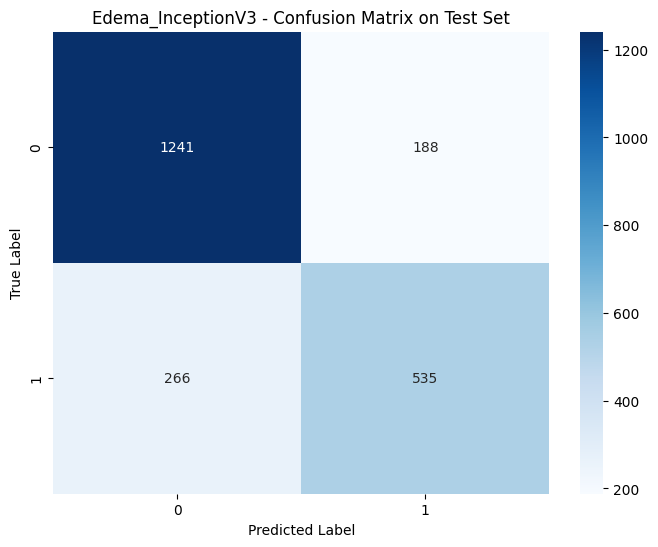

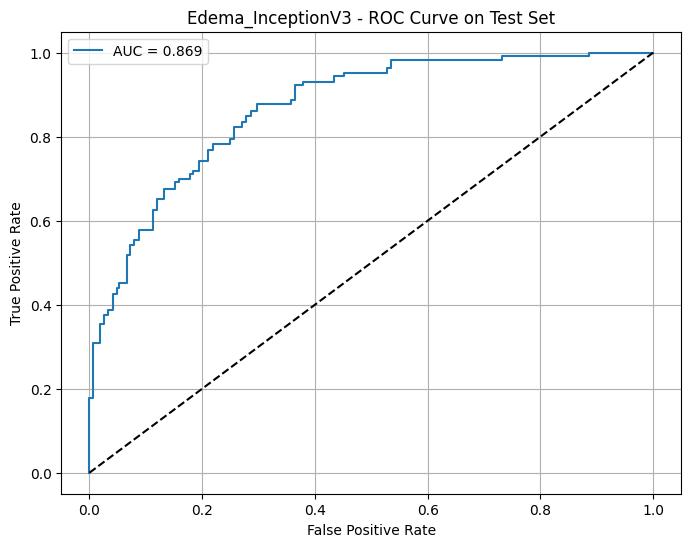


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.82      0.87      0.85      1429
    Positive       0.74      0.67      0.70       801

    accuracy                           0.80      2230
   macro avg       0.78      0.77      0.77      2230
weighted avg       0.79      0.80      0.79      2230



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle


transform = transforms.Compose([
    transforms.Resize((299, 299)),  # Inception V3  299x299 input
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Edema'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0,
    pin_memory=True
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0,
    pin_memory=True
)


print("\n--- Starting InceptionV3 Model Initialization for Edema Classification ---")

# Initialize InceptionV3
model = models.inception_v3(weights=models.Inception_V3_Weights.IMAGENET1K_V1)


num_ftrs = model.fc.in_features
model.fc = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.Dropout(0.4),
    nn.Linear(512, 1)
)

num_ftrs_aux = model.AuxLogits.fc.in_features
model.AuxLogits.fc = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(num_ftrs_aux, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

print(f"Model initialized on: {device}")
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()


        outputs, aux_outputs = model(inputs)

        # Calculate primary and auxiliary losses
        loss1 = criterion(outputs.squeeze(), labels)
        loss2 = criterion(aux_outputs.squeeze(), labels)
        loss = loss1 + 0.4 * loss2

        loss.backward()
        optimizer.step()

        running_loss += loss.item()


        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            if isinstance(outputs, tuple):
                outputs = outputs[0]
            loss = criterion(outputs.squeeze(), labels)
            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Training loop
print("\n--- Starting InceptionV3 Model Training on Edema dataset ---")

num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:   Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Edema_inceptionv3_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# Plot training history
plt.figure(figsize=(15, 5))

# Plot Loss
plt.subplot(1, 3, 1)
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Val Loss')
plt.title('InceptionV3 - Loss Over Time')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

# Plot Accuracy
plt.subplot(1, 3, 2)
plt.plot(history['train_acc'], label='Train Acc')
plt.plot(history['val_acc'], label='Val Acc')
plt.title('InceptionV3 - Accuracy Over Time')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)

# Plot AUC-ROC
plt.subplot(1, 3, 3)
plt.plot(history['train_auc'], label='Train AUC')
plt.plot(history['val_auc'], label='Val AUC')
plt.title('InceptionV3 - AUC-ROC Over Time')
plt.xlabel('Epoch')
plt.ylabel('AUC-ROC')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('Edema_inceptionv3_training_history.png')
plt.show()

# Save training history
history_filename = 'Edema_inceptionv3_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")
# ----------------------------------------------------------------------
# Evaluation on Test Dataset
print("\n--- Starting InceptionV3 Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0,
    pin_memory=True
)

# Load best model
model.load_state_dict(torch.load('best_Edema_inceptionv3_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# Calculate final metrics and generate plots
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        if isinstance(outputs, tuple):
            outputs = outputs[0]

        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Edema_InceptionV3 - Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('inceptionv3_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Edema_InceptionV3 - ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Edema_inceptionv3_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


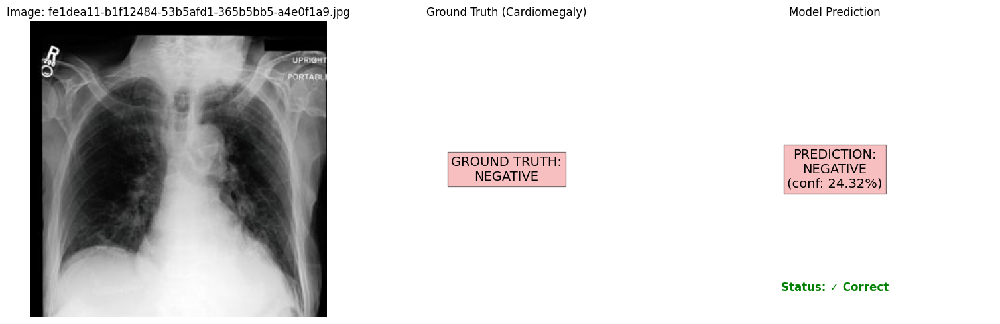


Image: fe1dea11-b1f12484-53b5afd1-365b5bb5-a4e0f1a9.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.2432)
Prediction Status: ✓ Correct
--------------------------------------------------


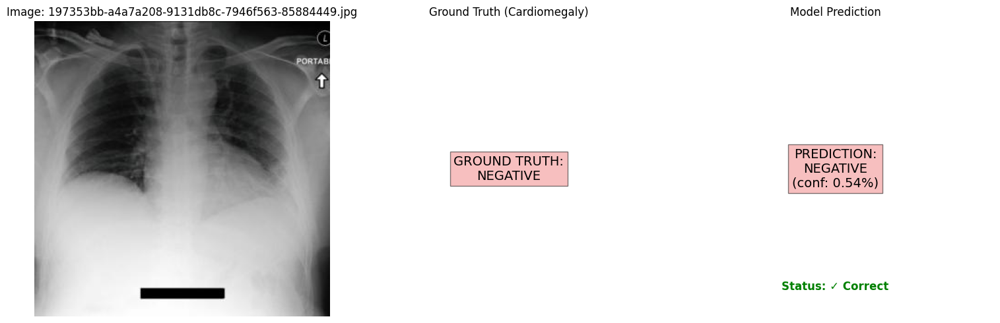


Image: 197353bb-a4a7a208-9131db8c-7946f563-85884449.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0054)
Prediction Status: ✓ Correct
--------------------------------------------------


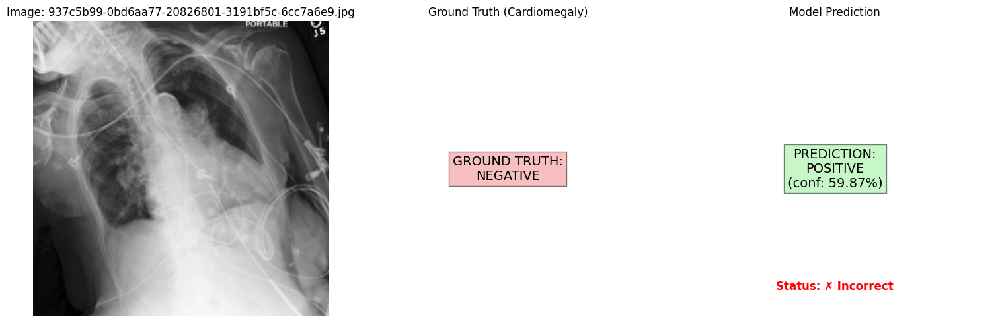


Image: 937c5b99-0bd6aa77-20826801-3191bf5c-6cc7a6e9.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.5987)
Prediction Status: ✗ Incorrect
--------------------------------------------------


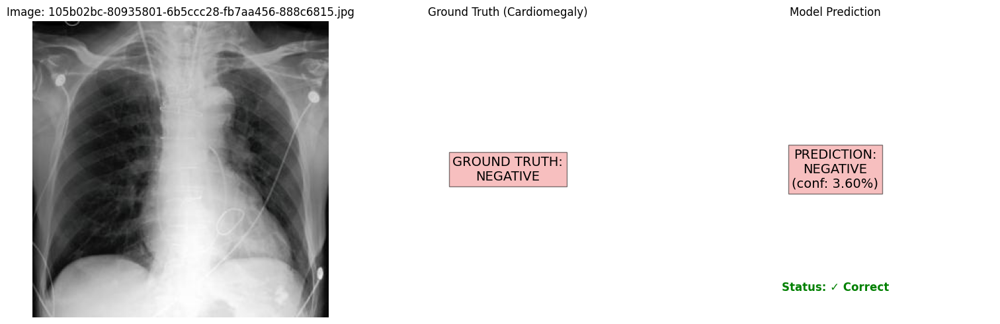


Image: 105b02bc-80935801-6b5ccc28-fb7aa456-888c6815.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0360)
Prediction Status: ✓ Correct
--------------------------------------------------


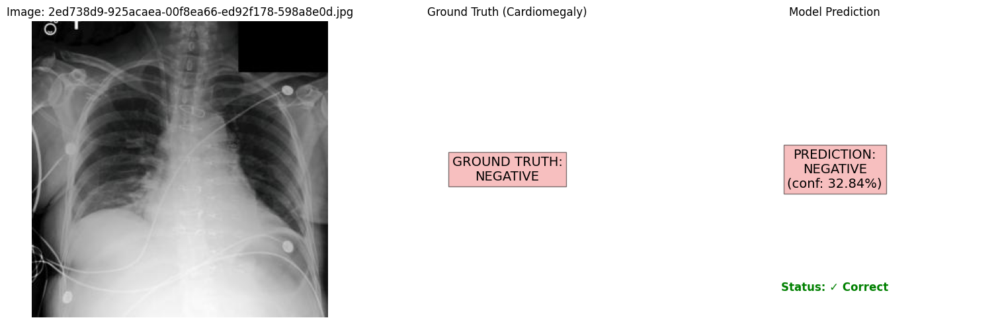


Image: 2ed738d9-925acaea-00f8ea66-ed92f178-598a8e0d.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.3284)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Edema'].values[0]

    # Move to device and make prediction
    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")


try:
    model.load_state_dict(torch.load('best_Edema_inceptionv3_model.pth'))
except:
    model.load_state_dict(torch.load('best_Edema_inceptionv3_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## MobileNet V3 - Edema


--- Starting MobileNetV3-Large Model Initialization (MobileNetV3 on Edema dataset) ---
Model initialized on: cuda:0
Total parameters: 4,858,417
Trainable parameters: 4,858,417

--- Starting MobileNetV3-Large Model Training on Edema dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 1/20 | Time: 66.05s
------------------------------------------------------------
Training:    Loss: 0.4608, Accuracy: 0.7897, F1: 0.7890, AUC-ROC: 0.8658
Validation: Loss: 0.6164, Accuracy: 0.7724, F1: 0.6877, AUC-ROC: 0.8554
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8554


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 2/20 | Time: 65.55s
------------------------------------------------------------
Training:    Loss: 0.3979, Accuracy: 0.8229, F1: 0.8249, AUC-ROC: 0.9001
Validation: Loss: 0.5202, Accuracy: 0.8056, F1: 0.7548, AUC-ROC: 0.8813
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8813


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 3/20 | Time: 67.77s
------------------------------------------------------------
Training:    Loss: 0.3474, Accuracy: 0.8589, F1: 0.8626, AUC-ROC: 0.9282
Validation: Loss: 0.5192, Accuracy: 0.8056, F1: 0.7654, AUC-ROC: 0.8704


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 4/20 | Time: 67.67s
------------------------------------------------------------
Training:    Loss: 0.3171, Accuracy: 0.8764, F1: 0.8773, AUC-ROC: 0.9397
Validation: Loss: 0.8629, Accuracy: 0.6419, F1: 0.6698, AUC-ROC: 0.8529


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 5/20 | Time: 66.15s
------------------------------------------------------------
Training:    Loss: 0.2501, Accuracy: 0.9046, F1: 0.9065, AUC-ROC: 0.9592
Validation: Loss: 0.5866, Accuracy: 0.7417, F1: 0.7292, AUC-ROC: 0.8565


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 6/20 | Time: 66.23s
------------------------------------------------------------
Training:    Loss: 0.2125, Accuracy: 0.9213, F1: 0.9201, AUC-ROC: 0.9712
Validation: Loss: 2.6992, Accuracy: 0.5115, F1: 0.6029, AUC-ROC: 0.8514


Training:   0%|          | 0/156 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]


Epoch 7/20 | Time: 65.61s
------------------------------------------------------------
Training:    Loss: 0.1666, Accuracy: 0.9390, F1: 0.9382, AUC-ROC: 0.9814
Validation: Loss: 0.7712, Accuracy: 0.7468, F1: 0.7009, AUC-ROC: 0.8532

Early stopping triggered after epoch 7. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---


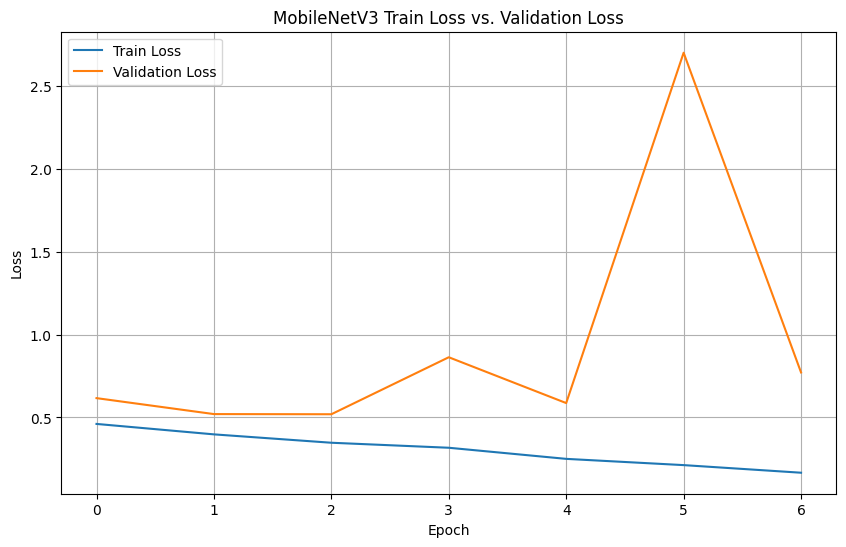


Model training history saved to Edema_mobilenetv3_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/70 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.5767
Test Accuracy:   0.8036
Test F1 Score:   0.7408
Test AUC-ROC:    0.8763

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/70 [00:00<?, ?it/s]

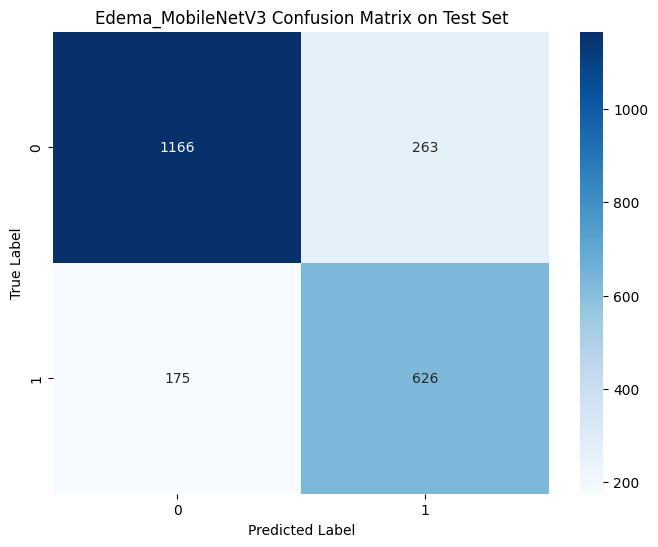

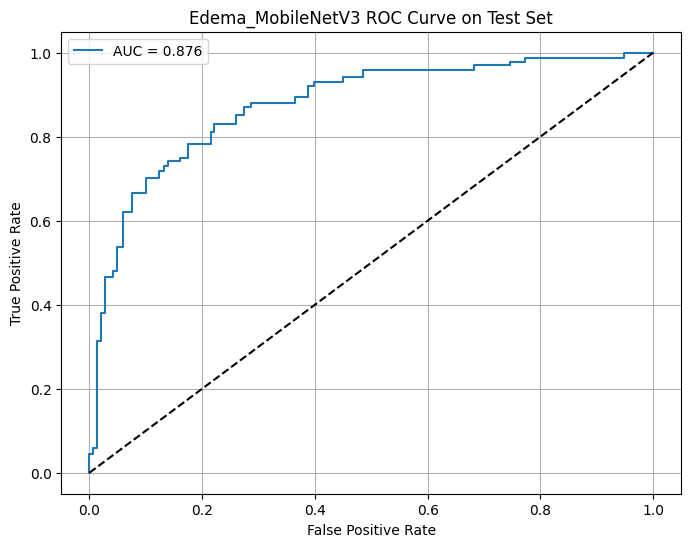


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.87      0.82      0.84      1429
    Positive       0.70      0.78      0.74       801

    accuracy                           0.80      2230
   macro avg       0.79      0.80      0.79      2230
weighted avg       0.81      0.80      0.81      2230



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Edema'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
# Initialize MobileNetV3-Large Model
print("\n--- Starting MobileNetV3-Large Model Initialization (MobileNetV3 on Edema dataset) ---")

model = models.mobilenet_v3_large(weights=models.MobileNet_V3_Large_Weights.IMAGENET1K_V1)

# Modify the classifier for binary classification
num_ftrs = model.classifier[-1].in_features
model.classifier[-1] = nn.Sequential(
    nn.Dropout(p=0.3),
    nn.Linear(num_ftrs, 512),
    nn.Hardswish(),
    nn.Dropout(p=0.3),
    nn.Linear(512, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

print(f"Model initialized on: {device}")
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# ----------------------------------------------------------------------
print("\n--- Starting MobileNetV3-Large Model Training on Edema dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
# Early Stopping variables
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Edema_mobilenetv3_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

# Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('MobileNetV3 Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('Edema_mobilenetv3_train_val_loss_plot.png')
plt.show()

# Storing Model History
history_filename = 'Edema_mobilenetv3_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")

# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset and loader
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# Load best model
model.load_state_dict(torch.load('best_Edema_mobilenetv3_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Edema_MobileNetV3 Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('mobilenetv3_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Edema_MobileNetV3 ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('Edema_mobilenetv3_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


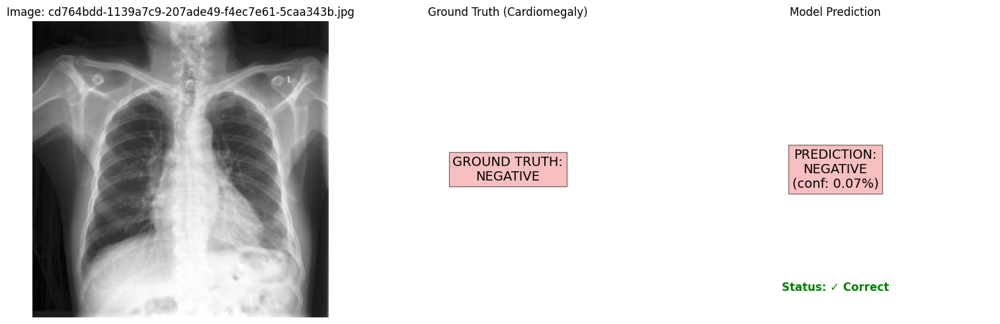


Image: cd764bdd-1139a7c9-207ade49-f4ec7e61-5caa343b.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0007)
Prediction Status: ✓ Correct
--------------------------------------------------


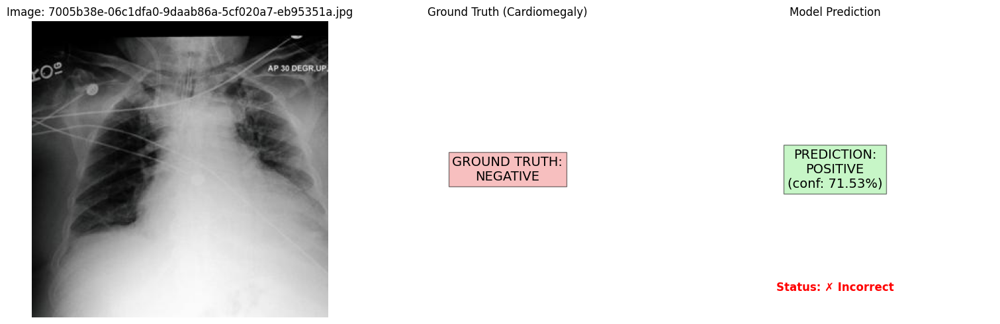


Image: 7005b38e-06c1dfa0-9daab86a-5cf020a7-eb95351a.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.7153)
Prediction Status: ✗ Incorrect
--------------------------------------------------


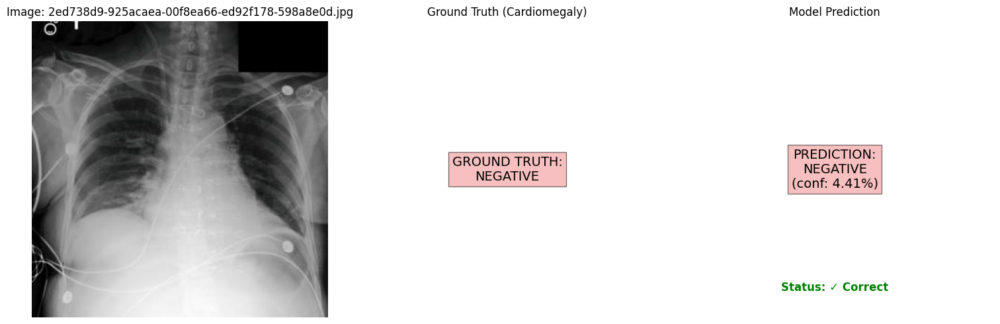


Image: 2ed738d9-925acaea-00f8ea66-ed92f178-598a8e0d.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0441)
Prediction Status: ✓ Correct
--------------------------------------------------


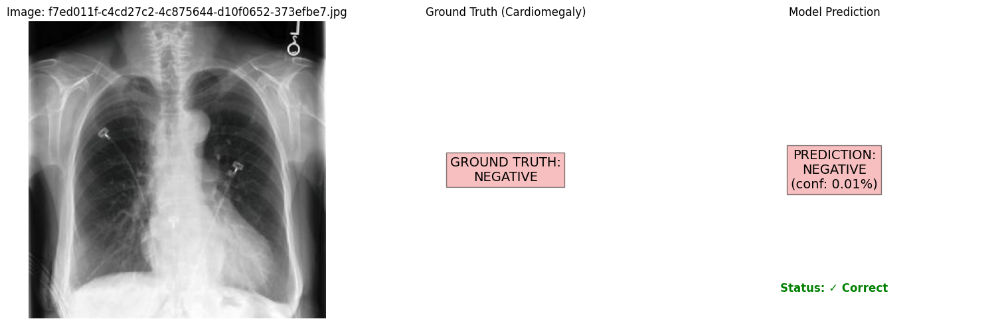


Image: f7ed011f-c4cd27c2-4c875644-d10f0652-373efbe7.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0001)
Prediction Status: ✓ Correct
--------------------------------------------------


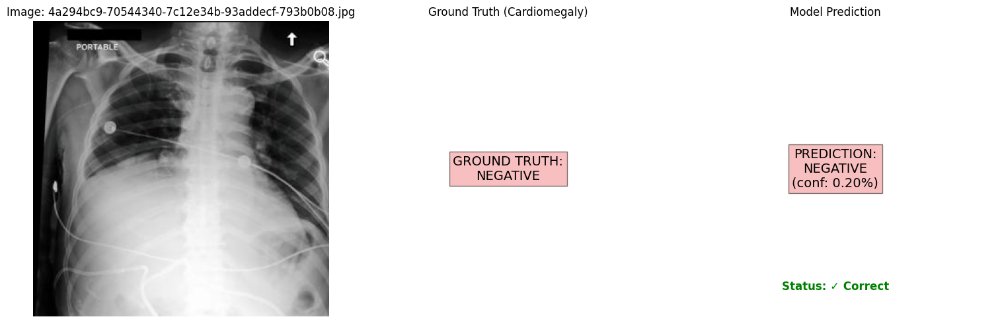


Image: 4a294bc9-70544340-7c12e34b-93addecf-793b0b08.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0020)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Edema'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---

try:
    model.load_state_dict(torch.load('best_Edema_mobilenetv3_model.pth'))
except:
    model.load_state_dict(torch.load('best_Edema_mobilenetv3_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

# Lung Opacity Models

STATISTICAL ANALYSIS FOR CLASS: LUNG OPACITY

--- TRAIN SET (Lung Opacity_train.csv) ---
Total entries (Row Count): 4,618

Condition label distribution (per column):
  • Lung Opacity   :
    - Positive (1) :   3,108 ( 67.3%)
    - Negative (0) :   1,510
    - Total Labeled:   4,618

--- VAL SET (Lung Opacity_val.csv) ---
Total entries (Row Count): 340

Condition label distribution (per column):
  • Lung Opacity   :
    - Positive (1) :     220 ( 64.7%)
    - Negative (0) :     120
    - Total Labeled:     340

--- TEST SET (Lung Opacity_test.csv) ---
Total entries (Row Count): 2,123

Condition label distribution (per column):
  • Lung Opacity   :
    - Positive (1) :   1,323 ( 62.3%)
    - Negative (0) :     800
    - Total Labeled:   2,123

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
PLOTTING TRAINING SET LABEL DISTRIBUTION FOR: LUNG OPACITY
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

Training Set total label counts: 
0.0    1510


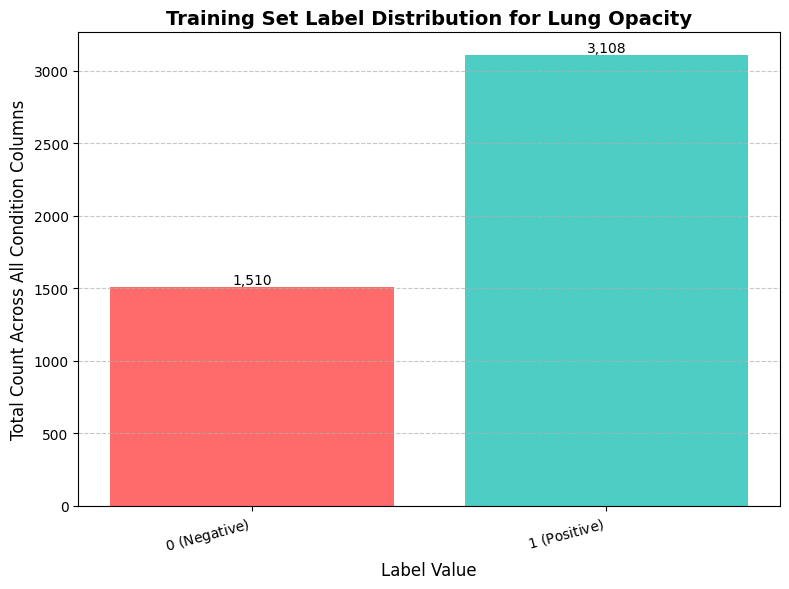

Plot saved as 'lung opacity_label_distribution.png'

--- Starting Data Load for Class: Lung Opacity ---
  Loaded train CSV: 4,618 entries. Verified images: 4,618.
  Loaded val CSV: 340 entries. Verified images: 340.
  Loaded test CSV: 2,123 entries. Verified images: 2,123.
Sucesfully Loaded Dataset


In [ ]:
target_class='Lung Opacity'
# 1. Analyze the CSVs and retrieve the training dataframe
train_df_result = analyze_class_csv_stats(class_name=target_class)
# 2. Plot the label distribution for the retrieved training dataframe
visualize_training_label_distribution(class_name=target_class, train_df=train_df_result)
loaded_data = load_dataset(class_name='Lung Opacity')

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
from torch.utils.data import DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score
from torchvision import transforms
from torch.utils.data import Dataset
import torch.nn.functional as F
from PIL import Image

# Custom Dataset class
class ChestXRayDataset(Dataset):
    def __init__(self, dataframe, image_paths, transform=None):
        self.dataframe = dataframe
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        # Get the label from the dataframe
        df_idx = self.dataframe.index[self.dataframe['cxr_path'].str.contains(os.path.basename(img_path))][0]
        label = torch.tensor(self.dataframe.iloc[df_idx]['Lung Opacity'], dtype=torch.float32)

        return image, label

# Data transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

print ("Lung Opacity CXR dataset loaded" )

Lung Opacity CXR dataset loaded


## ResNet 18- Lung Opacity


--- Starting ResNet Model Initialization (ResNet18 on Lung Opacity dataset) ---


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 174MB/s] 



--- Starting ResNet Model Training on Lung Opacity dataset ---


Epochs:   0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/15 | Time: 68.73s
------------------------------------------------------------
Training:    Loss: 0.5243, Accuracy: 0.7419, F1: 0.7414, AUC-ROC: 0.8214
Validation: Loss: 0.5495, Accuracy: 0.7588, F1: 0.8136, AUC-ROC: 0.7917
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7917


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/15 | Time: 55.82s
------------------------------------------------------------
Training:    Loss: 0.3247, Accuracy: 0.8707, F1: 0.8708, AUC-ROC: 0.9353
Validation: Loss: 0.6382, Accuracy: 0.7265, F1: 0.7715, AUC-ROC: 0.7898


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/15 | Time: 49.85s
------------------------------------------------------------
Training:    Loss: 0.1905, Accuracy: 0.9288, F1: 0.9297, AUC-ROC: 0.9773
Validation: Loss: 0.6558, Accuracy: 0.7618, F1: 0.8112, AUC-ROC: 0.8181
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8181


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/15 | Time: 44.36s
------------------------------------------------------------
Training:    Loss: 0.1320, Accuracy: 0.9528, F1: 0.9517, AUC-ROC: 0.9883
Validation: Loss: 1.0501, Accuracy: 0.6471, F1: 0.6610, AUC-ROC: 0.7938


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/15 | Time: 42.51s
------------------------------------------------------------
Training:    Loss: 0.0824, Accuracy: 0.9703, F1: 0.9707, AUC-ROC: 0.9957
Validation: Loss: 0.7774, Accuracy: 0.7529, F1: 0.8133, AUC-ROC: 0.7975


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/15 | Time: 42.97s
------------------------------------------------------------
Training:    Loss: 0.0562, Accuracy: 0.9809, F1: 0.9810, AUC-ROC: 0.9978
Validation: Loss: 0.8043, Accuracy: 0.7500, F1: 0.8115, AUC-ROC: 0.7955

Early stopping triggered after epoch 6. Validation AUC-ROC did not improve for 3 epochs.

--- Starting Plotting and History Storage ---

Model training history saved to Lung_Opacity_resnet18_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:        1.0199
Test Accuracy:    0.6392
Test F1 Score:    0.6977
Test AUC-ROC:     0.7116

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/67 [00:00<?, ?it/s]


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.52      0.59      0.55       800
    Positive       0.73      0.67      0.70      1323

    accuracy                           0.64      2123
   macro avg       0.62      0.63      0.63      2123
weighted avg       0.65      0.64      0.64      2123



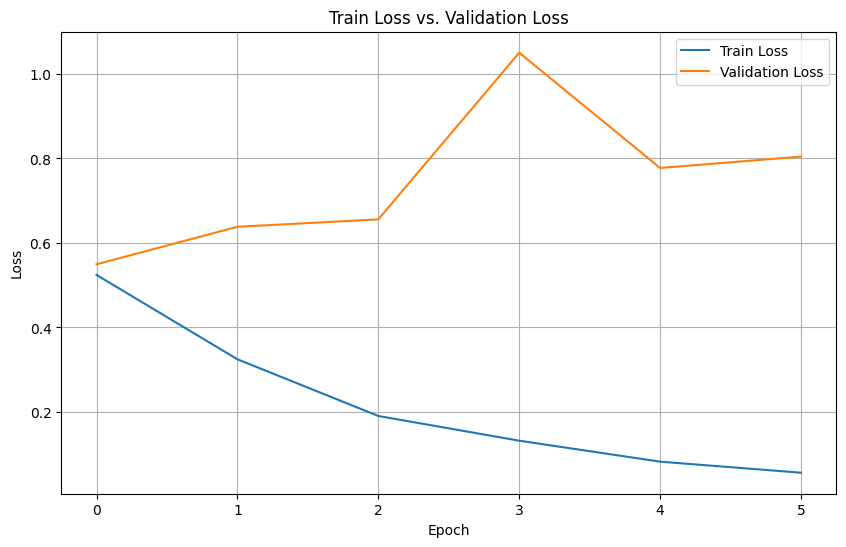

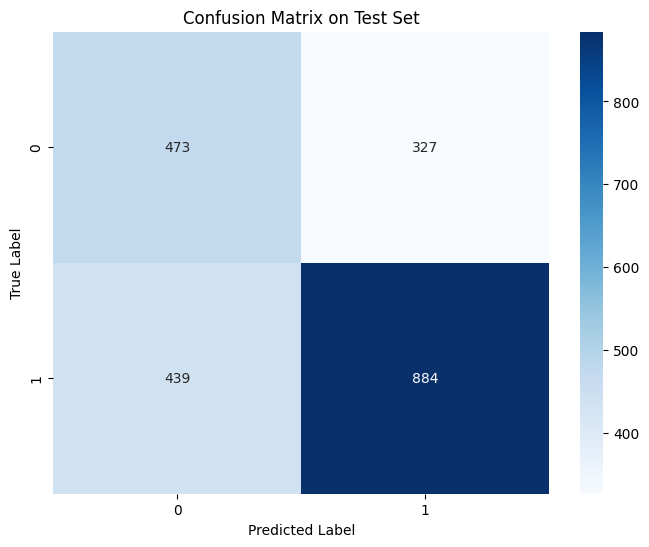

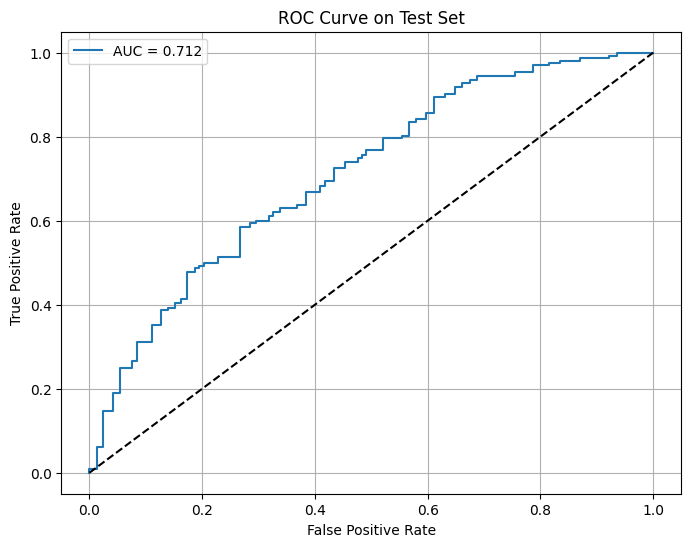

In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle


# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Lung Opacity'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Initialization (ResNet18 on Lung Opacity dataset) ---")

# Initialize ResNet18 model
model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
num_ftrs = model.fc.in_features


model.fc = nn.Sequential(
    nn.Dropout(0.5),
    nn.Linear(num_ftrs, 1)
)


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()


optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001, weight_decay=0.05)

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Store predictions and true labels for metrics
        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Training on Lung Opacity dataset ---")

# Training loop
num_epochs = 15
best_val_auc = 0.0
# Early Stopping variables
patience = 3
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}


for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s') # Print epoch time
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        # UPDATED CHECKPOINT FILENAME
        torch.save(model.state_dict(), 'best_Lung_Opacity_resnet18_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot.png')
plt.show()

## Storing Model History
# UPDATED HISTORY FILENAME
history_filename = 'Lung_Opacity_resnet18_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
try:

    model.load_state_dict(torch.load('best_Lung_Opacity_resnet18_model.pth'))
except:
    model.load_state_dict(torch.load('best_Lung_Opacity_resnet18_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:        {test_loss:.4f}")
print(f"Test Accuracy:    {test_acc:.4f}")
print(f"Test F1 Score:    {test_f1:.4f}")
print(f"Test AUC-ROC:     {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix.png')

plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve.png')
plt.show()
# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


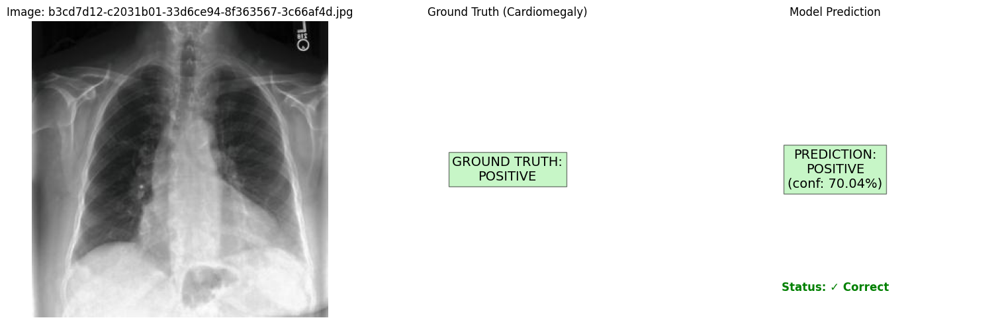


Image: b3cd7d12-c2031b01-33d6ce94-8f363567-3c66af4d.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7004)
Prediction Status: ✓ Correct
--------------------------------------------------


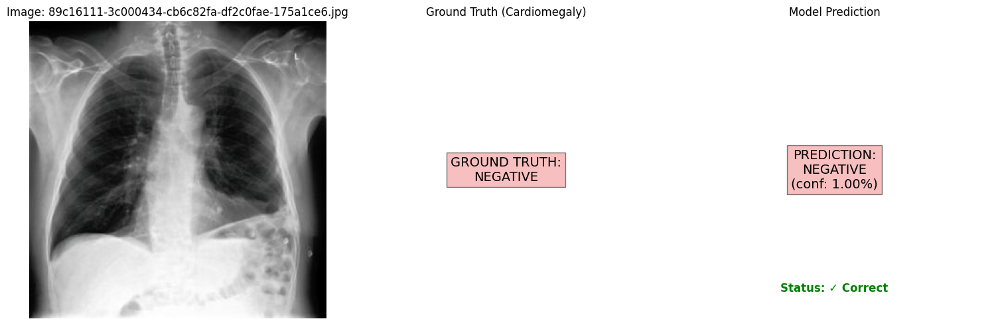


Image: 89c16111-3c000434-cb6c82fa-df2c0fae-175a1ce6.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0100)
Prediction Status: ✓ Correct
--------------------------------------------------


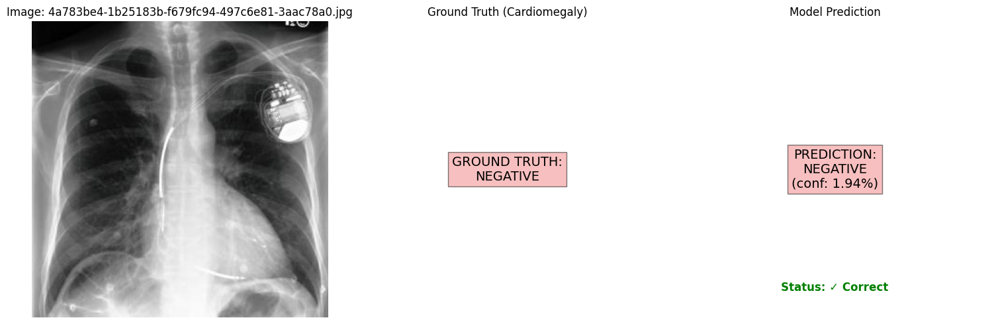


Image: 4a783be4-1b25183b-f679fc94-497c6e81-3aac78a0.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0194)
Prediction Status: ✓ Correct
--------------------------------------------------


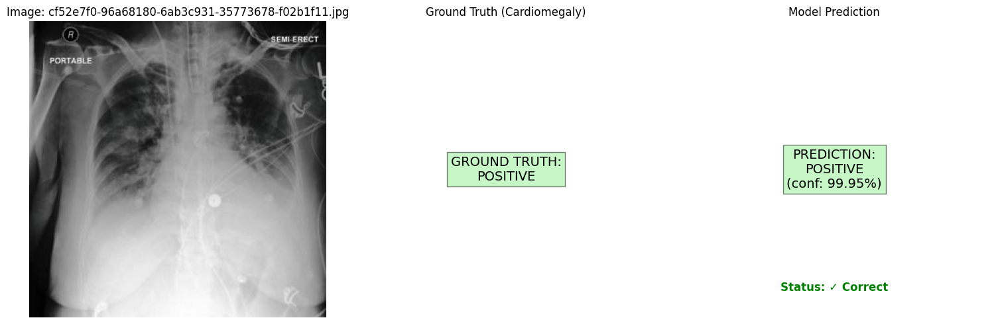


Image: cf52e7f0-96a68180-6ab3c931-35773678-f02b1f11.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9995)
Prediction Status: ✓ Correct
--------------------------------------------------


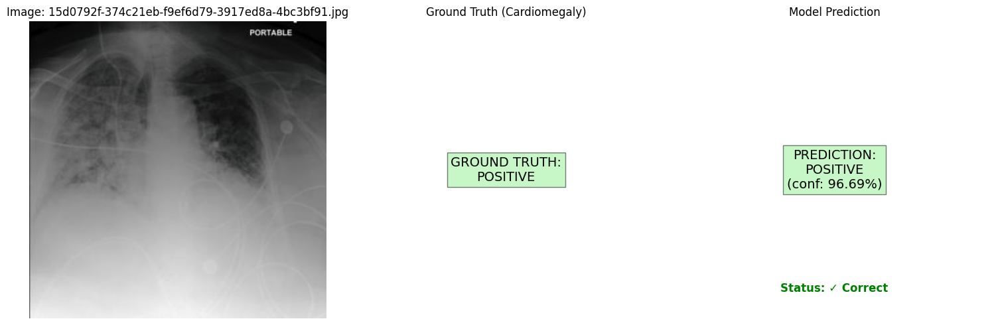


Image: 15d0792f-374c21eb-f9ef6d79-3917ed8a-4bc3bf91.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9669)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 5
Accuracy: 100.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Lung Opacity'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---

try:
    model.load_state_dict(torch.load('best_Lung_Opacity_resnet18_model.pth'))
except:
    model.load_state_dict(torch.load('best_Lung_Opacity_resnet18_model.pth'))
model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## ResNet 50- Lung Opacity


--- Starting ResNet Model Initialization (ResNet50 on Lung Opacity dataset) ---


Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 186MB/s] 



--- Starting ResNet Model Training on Lung Opacity dataset with Regularization and Scheduler ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/20 | Time: 84.75s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.5901, Accuracy: 0.7005, F1: 0.7047, AUC-ROC: 0.7618
Validation: Loss: 0.6190, Accuracy: 0.6441, F1: 0.6611, AUC-ROC: 0.7920
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7920


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/20 | Time: 76.92s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.5491, Accuracy: 0.7278, F1: 0.7242, AUC-ROC: 0.7957
Validation: Loss: 1.2354, Accuracy: 0.4618, F1: 0.3094, AUC-ROC: 0.7888


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/20 | Time: 74.18s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.5351, Accuracy: 0.7410, F1: 0.7385, AUC-ROC: 0.8109
Validation: Loss: 0.5096, Accuracy: 0.7588, F1: 0.8128, AUC-ROC: 0.8228
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8228


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/20 | Time: 73.23s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.5286, Accuracy: 0.7505, F1: 0.7520, AUC-ROC: 0.8160
Validation: Loss: 0.6047, Accuracy: 0.6912, F1: 0.7913, AUC-ROC: 0.7196


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/20 | Time: 72.89s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.5047, Accuracy: 0.7616, F1: 0.7588, AUC-ROC: 0.8336
Validation: Loss: 0.5160, Accuracy: 0.7382, F1: 0.8150, AUC-ROC: 0.7850


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/20 | Time: 73.24s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.4925, Accuracy: 0.7659, F1: 0.7669, AUC-ROC: 0.8426
Validation: Loss: 0.5221, Accuracy: 0.7500, F1: 0.8046, AUC-ROC: 0.7987

Early stopping triggered after epoch 6. Validation AUC-ROC did not improve for 3 epochs.

--- Starting Plotting and History Storage ---


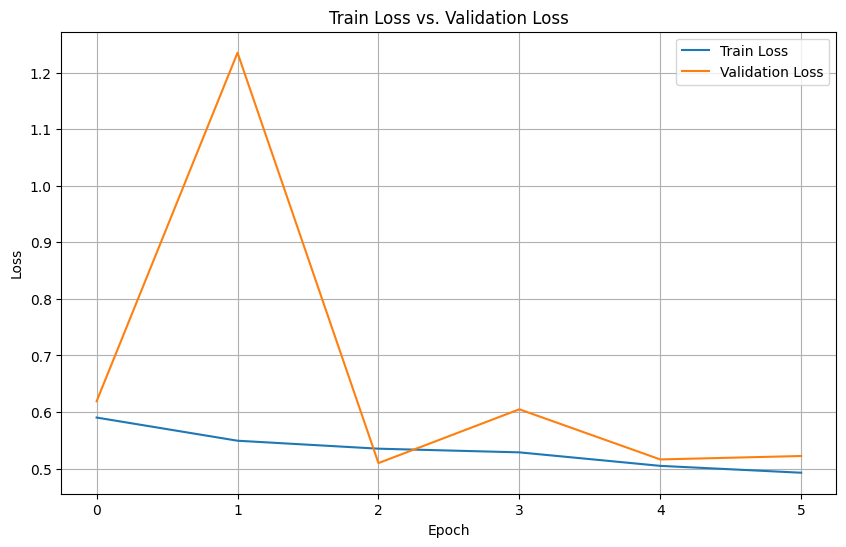


Model training history saved to Lung_Opacity_resnet50_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.6616
Test Accuracy:   0.6924
Test F1 Score:   0.7664
Test AUC-ROC:    0.7412

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

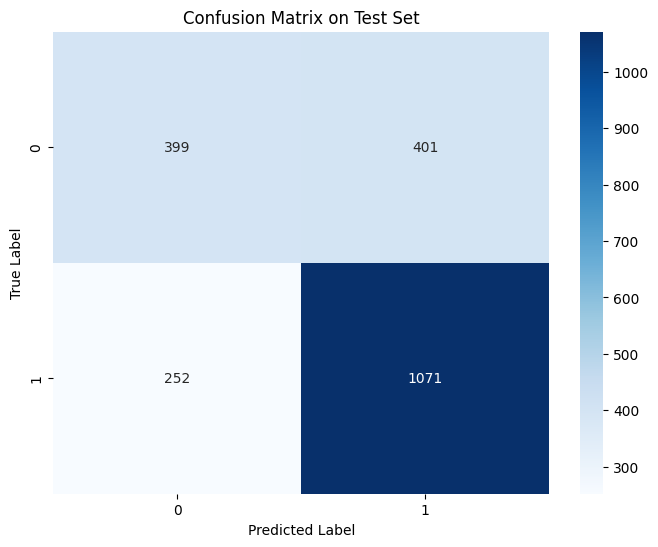

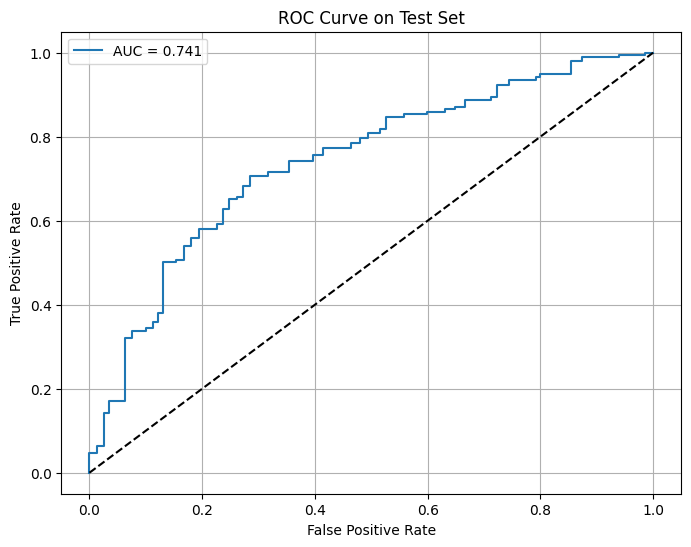


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.61      0.50      0.55       800
    Positive       0.73      0.81      0.77      1323

    accuracy                           0.69      2123
   macro avg       0.67      0.65      0.66      2123
weighted avg       0.68      0.69      0.68      2123



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle
from torch.optim.lr_scheduler import ReduceLROnPlateau

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Lung Opacity'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Initialization (ResNet50 on Lung Opacity dataset) ---")

# Initialize ResNet50 model
model = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V2)
num_ftrs = model.fc.in_features
model.fc = nn.Sequential(
    nn.Dropout(p=0.6),
    nn.Linear(num_ftrs, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()

optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.5)

scheduler = ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.1,
    patience=4,
)


def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Store predictions and true labels for metrics
        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Training on Lung Opacity dataset with Regularization and Scheduler ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
# Early Stopping variables
patience = 3
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()
    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    scheduler.step(val_auc)

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s | LR: {optimizer.param_groups[0]["lr"]}')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Lung_Opacity_resnet50_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))

epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot_regularized.png')
plt.show()

## Storing Model History
history_filename = 'Lung_Opacity_resnet50_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)




print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
model.load_state_dict(torch.load('best_Lung_Opacity_resnet50_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)
y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix_regularized.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve_regularized.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


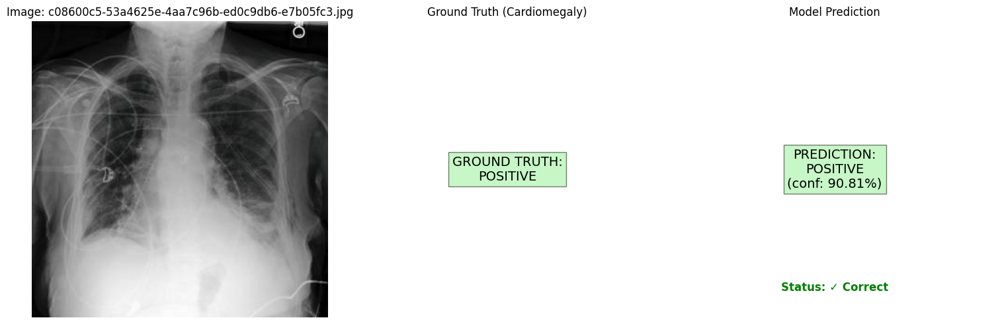


Image: c08600c5-53a4625e-4aa7c96b-ed0c9db6-e7b05fc3.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9081)
Prediction Status: ✓ Correct
--------------------------------------------------


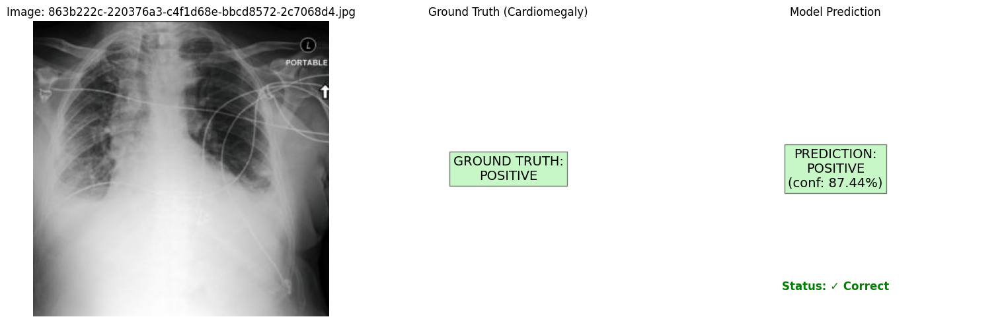


Image: 863b222c-220376a3-c4f1d68e-bbcd8572-2c7068d4.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8744)
Prediction Status: ✓ Correct
--------------------------------------------------


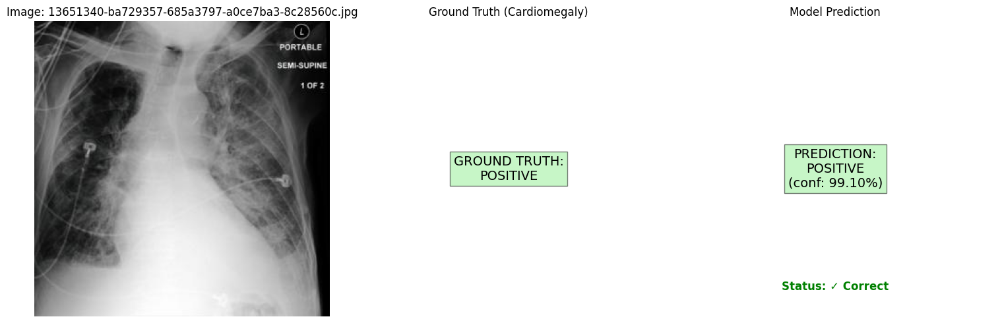


Image: 13651340-ba729357-685a3797-a0ce7ba3-8c28560c.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9910)
Prediction Status: ✓ Correct
--------------------------------------------------


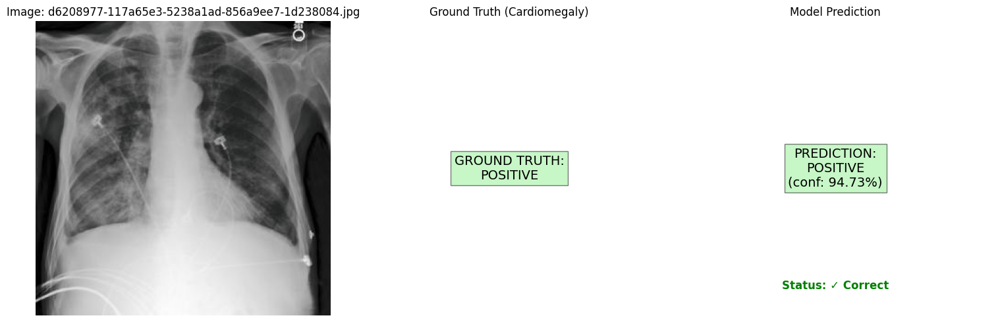


Image: d6208977-117a65e3-5238a1ad-856a9ee7-1d238084.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9473)
Prediction Status: ✓ Correct
--------------------------------------------------


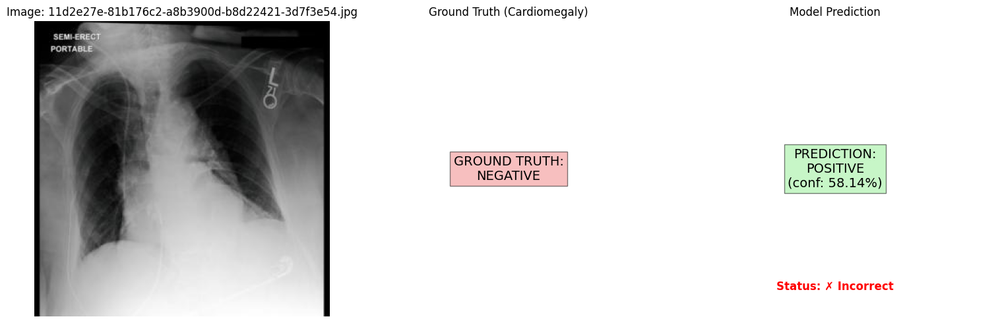


Image: 11d2e27e-81b176c2-a8b3900d-b8d22421-3d7f3e54.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.5814)
Prediction Status: ✗ Incorrect
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Lung Opacity'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---


model.load_state_dict(torch.load('best_Lung_Opacity_resnet50_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## VGG16 - Lung Opacity


--- Starting VGG Model Initialization (VGG16 on Lung Opacity dataset) ---


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 202MB/s] 



--- Starting VGG16 Model Training on Lung Opacity dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/20 | Time: 109.42s
------------------------------------------------------------
Training:    Loss: 0.6971, Accuracy: 0.5487, F1: 0.5479, AUC-ROC: 0.5640
Validation: Loss: 0.7773, Accuracy: 0.3647, F1: 0.0357, AUC-ROC: 0.6469
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.6469


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/20 | Time: 110.30s
------------------------------------------------------------
Training:    Loss: 0.6597, Accuracy: 0.6055, F1: 0.6056, AUC-ROC: 0.6484
Validation: Loss: 0.6110, Accuracy: 0.7000, F1: 0.7302, AUC-ROC: 0.8092
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8092


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/20 | Time: 110.82s
------------------------------------------------------------
Training:    Loss: 0.6281, Accuracy: 0.6537, F1: 0.6600, AUC-ROC: 0.7079
Validation: Loss: 0.5917, Accuracy: 0.7147, F1: 0.7544, AUC-ROC: 0.7957


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/20 | Time: 110.75s
------------------------------------------------------------
Training:    Loss: 0.6131, Accuracy: 0.6676, F1: 0.6783, AUC-ROC: 0.7290
Validation: Loss: 0.7217, Accuracy: 0.6265, F1: 0.6361, AUC-ROC: 0.8180
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8180


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/20 | Time: 111.09s
------------------------------------------------------------
Training:    Loss: 0.5856, Accuracy: 0.7010, F1: 0.7146, AUC-ROC: 0.7561
Validation: Loss: 0.5586, Accuracy: 0.7529, F1: 0.7879, AUC-ROC: 0.8441
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8441


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/20 | Time: 110.75s
------------------------------------------------------------
Training:    Loss: 0.5795, Accuracy: 0.7023, F1: 0.7210, AUC-ROC: 0.7637
Validation: Loss: 0.5062, Accuracy: 0.7824, F1: 0.8213, AUC-ROC: 0.8349


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 7/20 | Time: 110.44s
------------------------------------------------------------
Training:    Loss: 0.5872, Accuracy: 0.7061, F1: 0.7232, AUC-ROC: 0.7588
Validation: Loss: 0.6396, Accuracy: 0.6588, F1: 0.6628, AUC-ROC: 0.8410


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 8/20 | Time: 110.87s
------------------------------------------------------------
Training:    Loss: 0.5707, Accuracy: 0.7092, F1: 0.7233, AUC-ROC: 0.7760
Validation: Loss: 0.4990, Accuracy: 0.7735, F1: 0.8153, AUC-ROC: 0.8415


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 9/20 | Time: 110.26s
------------------------------------------------------------
Training:    Loss: 0.5497, Accuracy: 0.7200, F1: 0.7228, AUC-ROC: 0.7945
Validation: Loss: 0.8408, Accuracy: 0.5265, F1: 0.4429, AUC-ROC: 0.8139


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 10/20 | Time: 111.09s
------------------------------------------------------------
Training:    Loss: 0.5369, Accuracy: 0.7332, F1: 0.7514, AUC-ROC: 0.8028
Validation: Loss: 0.5044, Accuracy: 0.7794, F1: 0.8201, AUC-ROC: 0.8483
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8483


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 11/20 | Time: 111.39s
------------------------------------------------------------
Training:    Loss: 0.5440, Accuracy: 0.7267, F1: 0.7389, AUC-ROC: 0.7977
Validation: Loss: 0.4893, Accuracy: 0.7941, F1: 0.8387, AUC-ROC: 0.8460


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 12/20 | Time: 110.96s
------------------------------------------------------------
Training:    Loss: 0.5467, Accuracy: 0.7228, F1: 0.7306, AUC-ROC: 0.7965
Validation: Loss: 0.4969, Accuracy: 0.7853, F1: 0.8352, AUC-ROC: 0.8515
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8515


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 13/20 | Time: 111.38s
------------------------------------------------------------
Training:    Loss: 0.5276, Accuracy: 0.7410, F1: 0.7576, AUC-ROC: 0.8134
Validation: Loss: 0.4887, Accuracy: 0.7824, F1: 0.8213, AUC-ROC: 0.8533
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8533


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 14/20 | Time: 111.15s
------------------------------------------------------------
Training:    Loss: 0.5250, Accuracy: 0.7445, F1: 0.7572, AUC-ROC: 0.8171
Validation: Loss: 0.5830, Accuracy: 0.7294, F1: 0.7553, AUC-ROC: 0.8582
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8582


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 15/20 | Time: 110.44s
------------------------------------------------------------
Training:    Loss: 0.5292, Accuracy: 0.7391, F1: 0.7486, AUC-ROC: 0.8099
Validation: Loss: 0.4867, Accuracy: 0.8147, F1: 0.8578, AUC-ROC: 0.8575


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 16/20 | Time: 110.22s
------------------------------------------------------------
Training:    Loss: 0.5149, Accuracy: 0.7573, F1: 0.7630, AUC-ROC: 0.8240
Validation: Loss: 0.4628, Accuracy: 0.8000, F1: 0.8475, AUC-ROC: 0.8527


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 17/20 | Time: 110.71s
------------------------------------------------------------
Training:    Loss: 0.5051, Accuracy: 0.7568, F1: 0.7693, AUC-ROC: 0.8288
Validation: Loss: 0.4448, Accuracy: 0.8088, F1: 0.8565, AUC-ROC: 0.8588
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8588


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 18/20 | Time: 110.57s
------------------------------------------------------------
Training:    Loss: 0.5083, Accuracy: 0.7635, F1: 0.7712, AUC-ROC: 0.8301
Validation: Loss: 0.4643, Accuracy: 0.7912, F1: 0.8322, AUC-ROC: 0.8620
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8620


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 19/20 | Time: 111.02s
------------------------------------------------------------
Training:    Loss: 0.5153, Accuracy: 0.7531, F1: 0.7609, AUC-ROC: 0.8228
Validation: Loss: 0.5065, Accuracy: 0.7794, F1: 0.8148, AUC-ROC: 0.8624
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8624


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 20/20 | Time: 111.08s
------------------------------------------------------------
Training:    Loss: 0.4885, Accuracy: 0.7713, F1: 0.7749, AUC-ROC: 0.8451
Validation: Loss: 0.5286, Accuracy: 0.7706, F1: 0.8079, AUC-ROC: 0.8549

--- Starting Plotting and History Storage ---


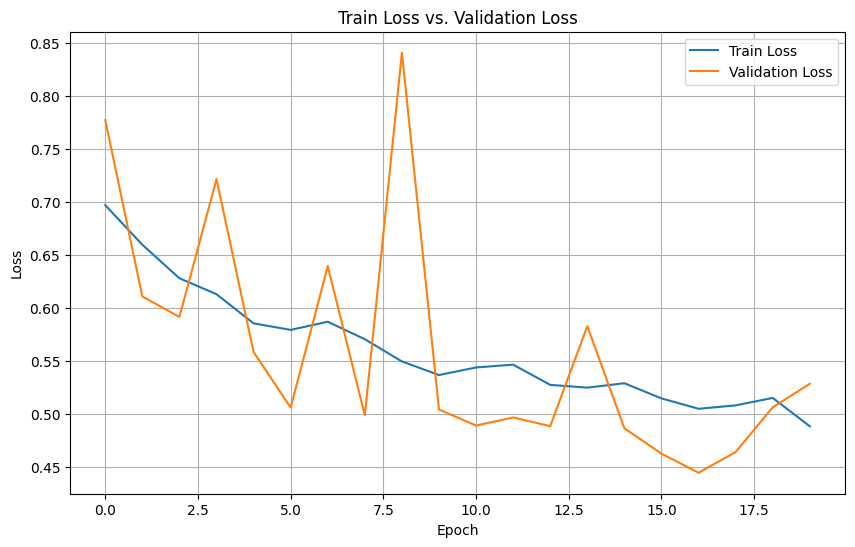


Model training history saved to Lung_Opacity_vgg16_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.6184
Test Accuracy:   0.7014
Test F1 Score:   0.7391
Test AUC-ROC:    0.7762

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

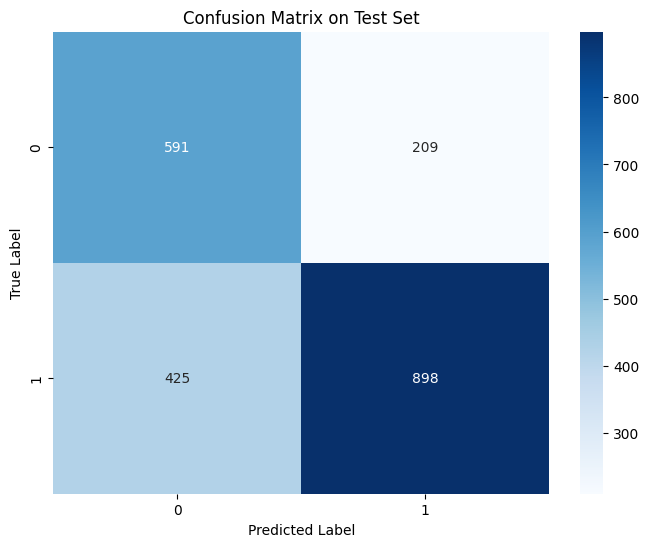

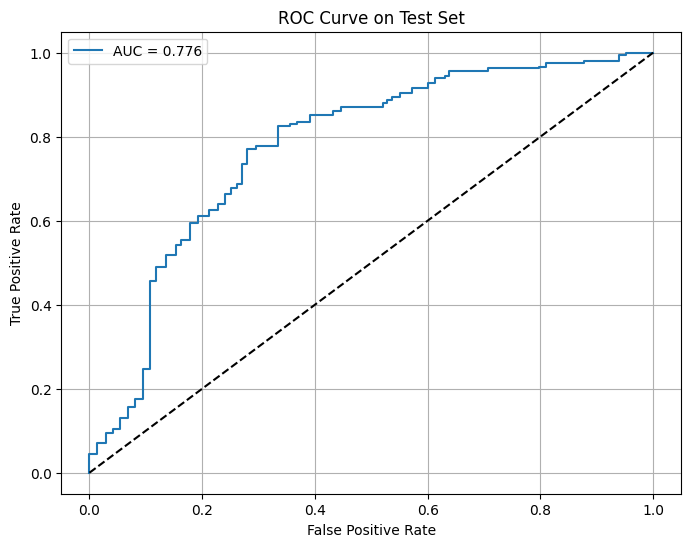


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.58      0.74      0.65       800
    Positive       0.81      0.68      0.74      1323

    accuracy                           0.70      2123
   macro avg       0.70      0.71      0.69      2123
weighted avg       0.72      0.70      0.71      2123



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle


# Initialize VGG16 model
def create_vgg16_model(num_classes=1, pretrained=True):
    model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1 if pretrained else None)

    #  classifier for binary classification
    model.classifier = nn.Sequential(
        nn.Linear(512 * 7 * 7, 4096),
        nn.ReLU(True),
        nn.Dropout(p=0.5),
        nn.Linear(4096, 1024),
        nn.ReLU(True),
        nn.Dropout(p=0.5),
        nn.Linear(1024, num_classes)
    )

    for m in model.classifier.modules():
        if isinstance(m, nn.Linear):
            nn.init.xavier_normal_(m.weight)
            nn.init.constant_(m.bias, 0)

    return model

vgg16_train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomRotation(15),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

vgg16_test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=vgg16_train_transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=vgg16_test_transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Lung Opacity'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)


print("\n--- Starting VGG Model Initialization (VGG16 on Lung Opacity dataset) ---")

# Initialize VGG16 model
model = create_vgg16_model(num_classes=1)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()

# Define optimizer
optimizer = torch.optim.AdamW(
    model.parameters(),
    lr=1e-4,
    weight_decay=0.01,
    amsgrad=True
)

# Learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True
)


# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Store predictions and true labels for metrics
        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting VGG16 Model Training on Lung Opacity dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # ADD SCHEDULER STEP
    scheduler.step(val_auc)

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s') # Print epoch time
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        # UPDATED CHECKPOINT FILENAME
        torch.save(model.state_dict(), 'best_Lung_Opacity_vgg16_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True # Set flag to stop next iteration


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot.png')
plt.show()

## Storing Model History
# UPDATED HISTORY FILENAME
history_filename = 'Lung_Opacity_vgg16_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=vgg16_test_transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model

model.load_state_dict(torch.load('best_Lung_Opacity_vgg16_model.pth'))

model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)
y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


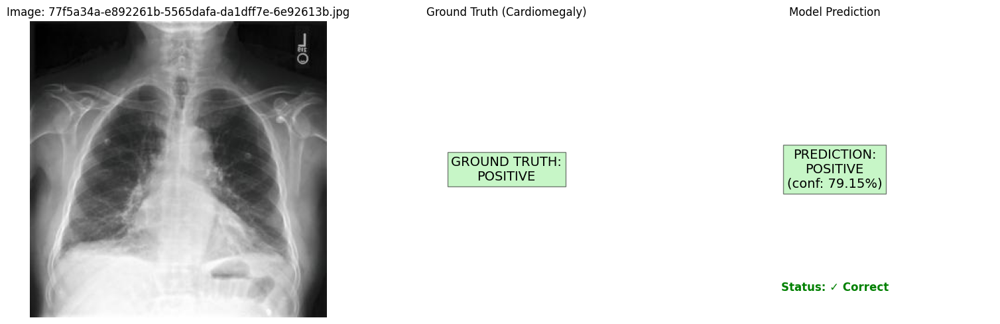


Image: 77f5a34a-e892261b-5565dafa-da1dff7e-6e92613b.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7915)
Prediction Status: ✓ Correct
--------------------------------------------------


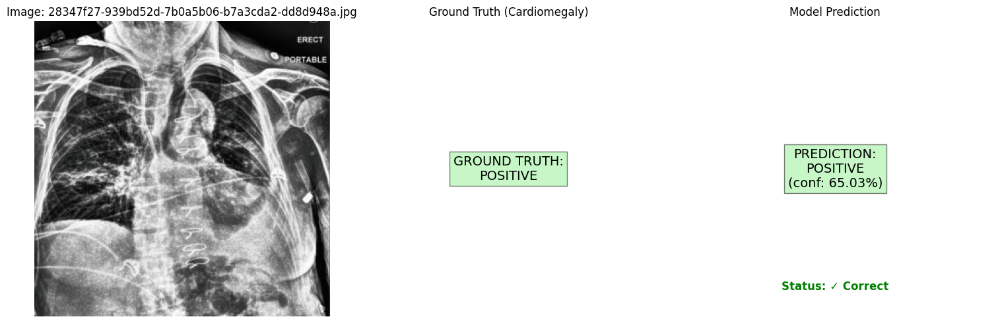


Image: 28347f27-939bd52d-7b0a5b06-b7a3cda2-dd8d948a.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.6503)
Prediction Status: ✓ Correct
--------------------------------------------------


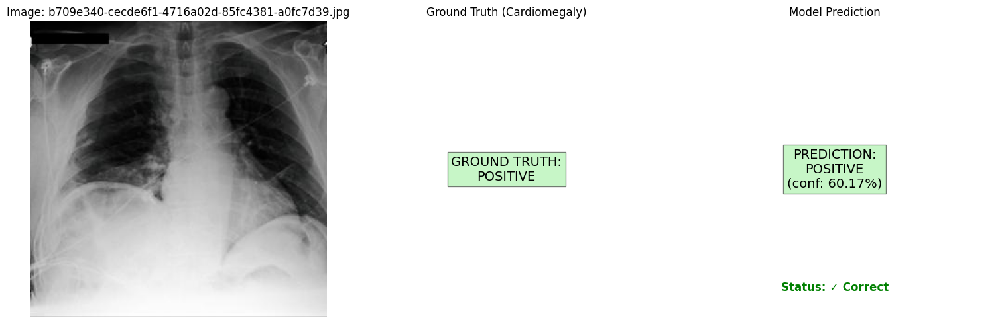


Image: b709e340-cecde6f1-4716a02d-85fc4381-a0fc7d39.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.6017)
Prediction Status: ✓ Correct
--------------------------------------------------


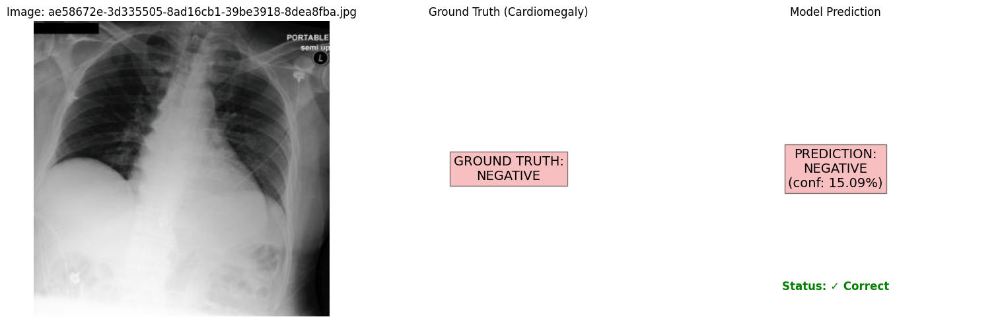


Image: ae58672e-3d335505-8ad16cb1-39be3918-8dea8fba.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1509)
Prediction Status: ✓ Correct
--------------------------------------------------


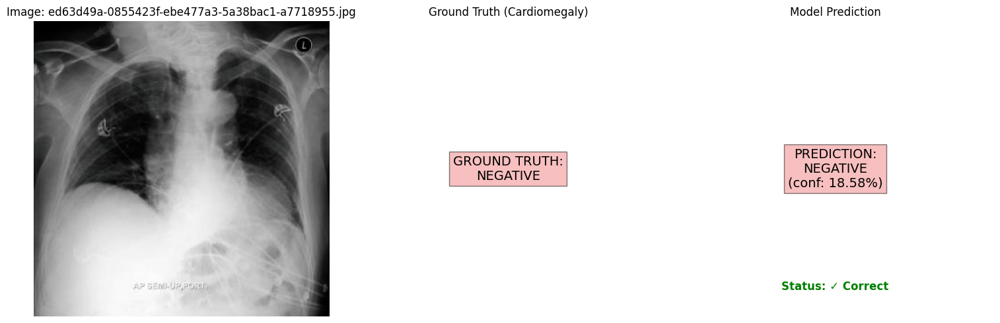


Image: ed63d49a-0855423f-ebe477a3-5a38bac1-a7718955.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1858)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 5
Accuracy: 100.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Lung Opacity'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---

model.load_state_dict(torch.load('best_Lung_Opacity_vgg16_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## DenseNet 121 - Lung Opacity


--- Starting DenseNet121 Model Initialization for Lung Opacity Classification ---

--- Starting DenseNet121 Model Training on Lung Opacity dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/20 | Time: 73.77s
------------------------------------------------------------
Training:   Loss: 0.6548, Accuracy: 0.6622, F1: 0.6629, AUC-ROC: 0.7084
Validation: Loss: 0.5498, Accuracy: 0.7382, F1: 0.8195, AUC-ROC: 0.7630
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7630


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/20 | Time: 73.70s
------------------------------------------------------------
Training:   Loss: 0.5683, Accuracy: 0.7096, F1: 0.7188, AUC-ROC: 0.7768
Validation: Loss: 0.6501, Accuracy: 0.6588, F1: 0.6742, AUC-ROC: 0.8284
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8284


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/20 | Time: 74.55s
------------------------------------------------------------
Training:   Loss: 0.5502, Accuracy: 0.7352, F1: 0.7443, AUC-ROC: 0.7970
Validation: Loss: 0.5771, Accuracy: 0.7529, F1: 0.7910, AUC-ROC: 0.8269


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/20 | Time: 74.46s
------------------------------------------------------------
Training:   Loss: 0.5587, Accuracy: 0.7230, F1: 0.7275, AUC-ROC: 0.7884
Validation: Loss: 0.7064, Accuracy: 0.6529, F1: 0.6740, AUC-ROC: 0.8016


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/20 | Time: 74.92s
------------------------------------------------------------
Training:   Loss: 0.5178, Accuracy: 0.7501, F1: 0.7582, AUC-ROC: 0.8229
Validation: Loss: 0.5546, Accuracy: 0.7441, F1: 0.8096, AUC-ROC: 0.7721


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/20 | Time: 74.74s
------------------------------------------------------------
Training:   Loss: 0.5297, Accuracy: 0.7373, F1: 0.7452, AUC-ROC: 0.8117
Validation: Loss: 0.5314, Accuracy: 0.7235, F1: 0.8157, AUC-ROC: 0.7928


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 7/20 | Time: 74.49s
------------------------------------------------------------
Training:   Loss: 0.5118, Accuracy: 0.7588, F1: 0.7709, AUC-ROC: 0.8271
Validation: Loss: 0.5370, Accuracy: 0.7559, F1: 0.8376, AUC-ROC: 0.7753

Early stopping triggered after epoch 7. Validation AUC-ROC did not improve for 5 epochs.


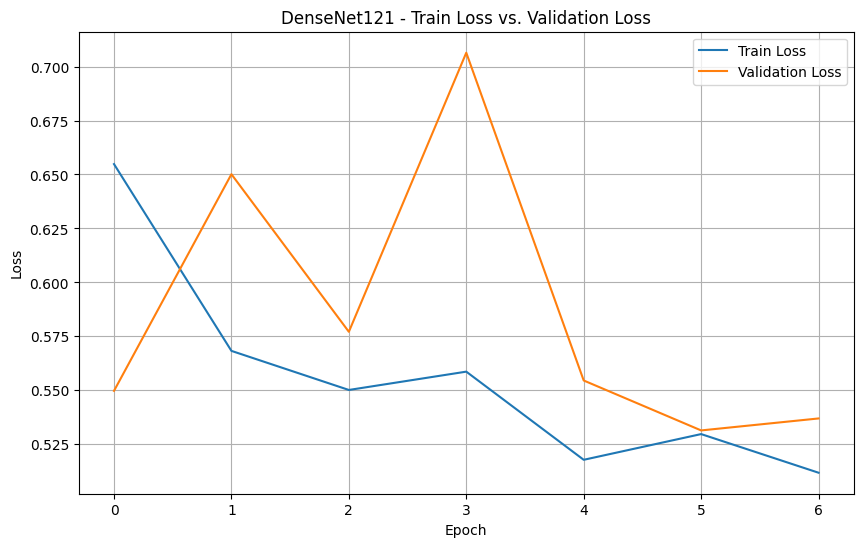


Model training history saved to Lung_Opacity_densenet121_history.pkl

--- Starting DenseNet121 Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.6955
Test Accuracy:   0.6481
Test F1 Score:   0.6537
Test AUC-ROC:    0.7706


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

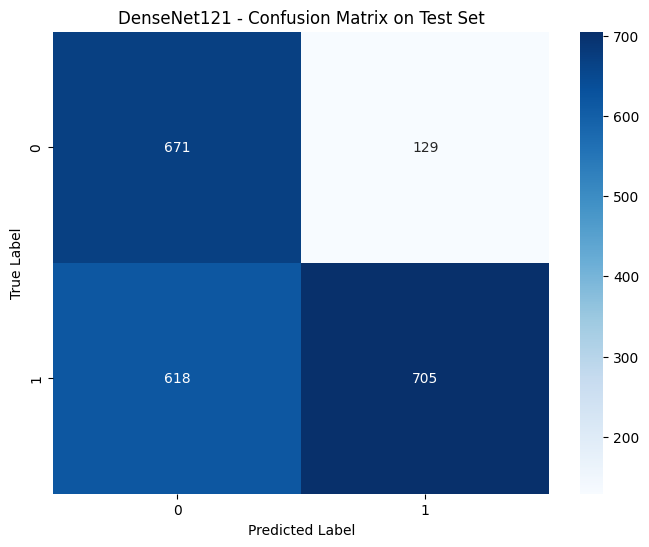

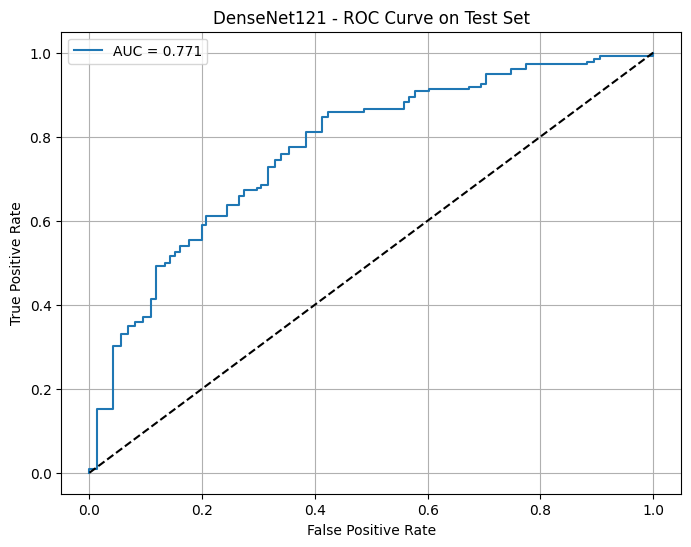


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.52      0.84      0.64       800
    Positive       0.85      0.53      0.65      1323

    accuracy                           0.65      2123
   macro avg       0.68      0.69      0.65      2123
weighted avg       0.72      0.65      0.65      2123



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle
from torch.optim.lr_scheduler import ReduceLROnPlateau



# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Lung Opacity'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
# Initialize DenseNet121 model
print("\n--- Starting DenseNet121 Model Initialization for Lung Opacity Classification ---")

model = models.densenet121(weights=models.DenseNet121_Weights.IMAGENET1K_V1)

#  classifier for binary classification
num_ftrs = model.classifier.in_features
model.classifier = nn.Sequential(
    nn.BatchNorm1d(num_ftrs),
    nn.Dropout(0.4),
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.BatchNorm1d(512),
    nn.Dropout(0.4),
    nn.Linear(512, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# ----------------------------------------------------------------------
print("\n--- Starting DenseNet121 Model Training on Lung Opacity dataset ---")

num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:   Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Lung_Opacity_densenet121_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# Plot Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('DenseNet121 - Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('densenet121_train_val_loss_plot.png')
plt.show()

# Store Model History
history_filename = 'Lung_Opacity_densenet121_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
# Evaluation on Test Dataset
print("\n--- Starting DenseNet121 Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)

# Load best model
model.load_state_dict(torch.load('best_Lung_Opacity_densenet121_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# Calculate final metrics and generate plots
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('DenseNet121 - Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('densenet121_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('DenseNet121 - ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('densenet121_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))




--- Randomly Predicting on 5 Test Images ---


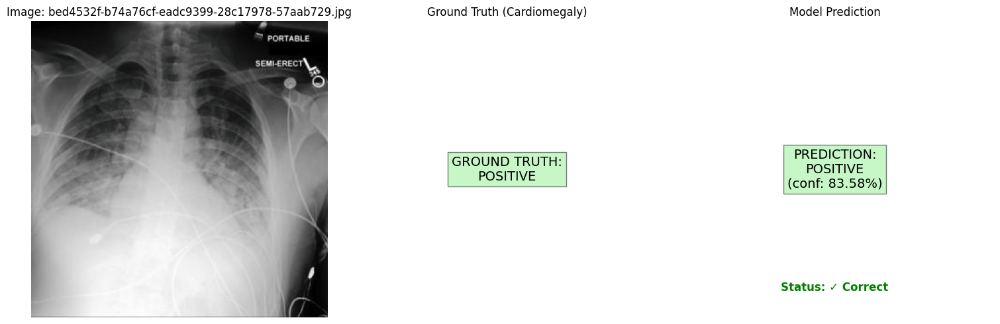


Image: bed4532f-b74a76cf-eadc9399-28c17978-57aab729.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8358)
Prediction Status: ✓ Correct
--------------------------------------------------


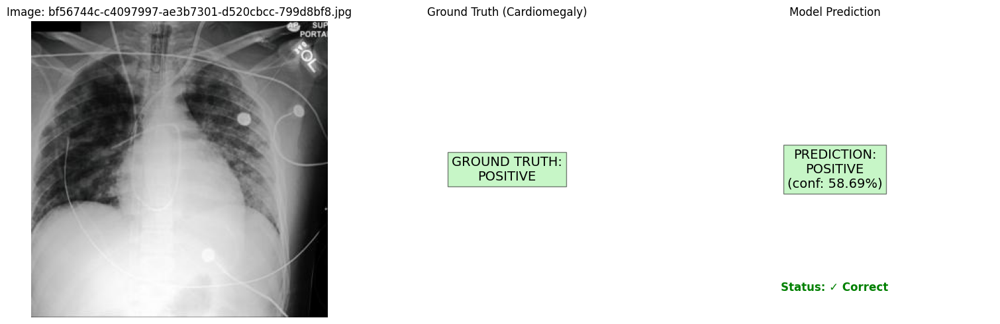


Image: bf56744c-c4097997-ae3b7301-d520cbcc-799d8bf8.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.5869)
Prediction Status: ✓ Correct
--------------------------------------------------


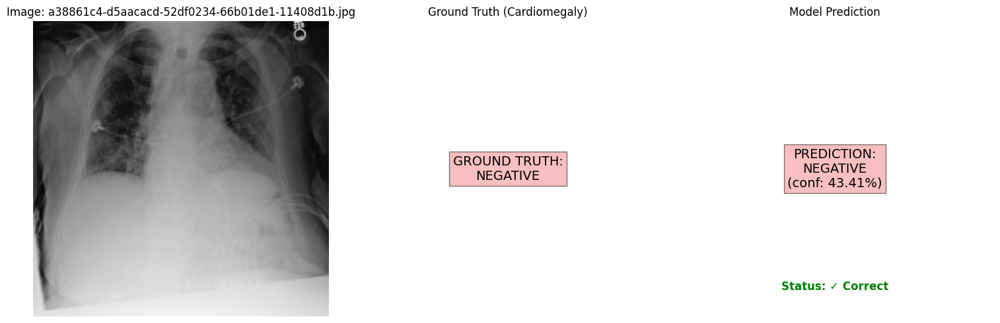


Image: a38861c4-d5aacacd-52df0234-66b01de1-11408d1b.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.4341)
Prediction Status: ✓ Correct
--------------------------------------------------


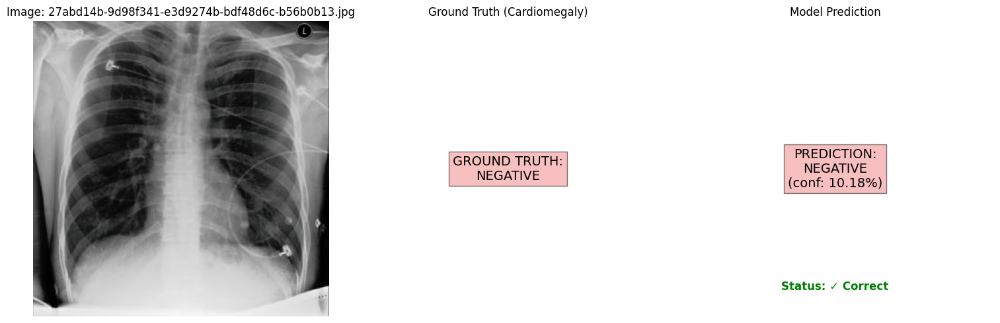


Image: 27abd14b-9d98f341-e3d9274b-bdf48d6c-b56b0b13.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.1018)
Prediction Status: ✓ Correct
--------------------------------------------------


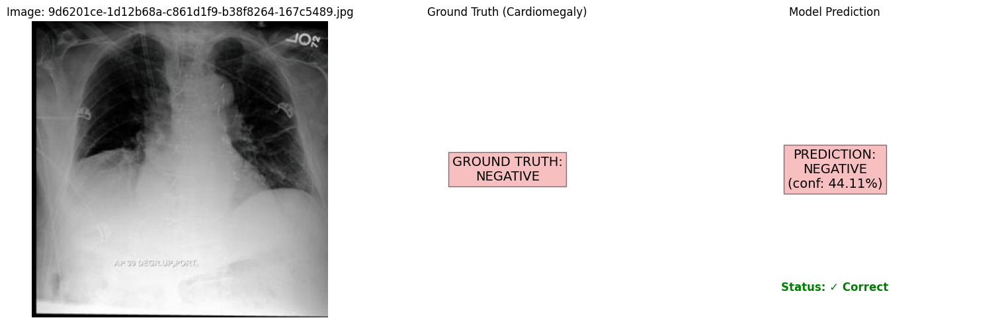


Image: 9d6201ce-1d12b68a-c861d1f9-b38f8264-167c5489.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.4411)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 5
Accuracy: 100.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Lung Opacity'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)

        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0

        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---
model.load_state_dict(torch.load('best_Lung_Opacity_densenet121_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## InceptionNet V3 - Lung Opacity


--- Starting InceptionV3 Model Initialization for Lung Opacity Classification ---
Model initialized on: cuda:0
Total parameters: 25,393,634
Trainable parameters: 25,393,634

--- Starting InceptionV3 Model Training on Lung Opacity dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/20 | Time: 93.73s
------------------------------------------------------------
Training:   Loss: 0.8486, Accuracy: 0.6968, F1: 0.7100, AUC-ROC: 0.7514
Validation: Loss: 0.7542, Accuracy: 0.6147, F1: 0.6158, AUC-ROC: 0.7546
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7546


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/20 | Time: 94.97s
------------------------------------------------------------
Training:   Loss: 0.7824, Accuracy: 0.7274, F1: 0.7314, AUC-ROC: 0.7924
Validation: Loss: 1.9016, Accuracy: 0.3853, F1: 0.1606, AUC-ROC: 0.3666


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/20 | Time: 95.29s
------------------------------------------------------------
Training:   Loss: 0.7866, Accuracy: 0.7200, F1: 0.7297, AUC-ROC: 0.7846
Validation: Loss: 0.6799, Accuracy: 0.6471, F1: 0.6648, AUC-ROC: 0.8003
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8003


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/20 | Time: 94.98s
------------------------------------------------------------
Training:   Loss: 0.7668, Accuracy: 0.7395, F1: 0.7479, AUC-ROC: 0.7958
Validation: Loss: 0.4832, Accuracy: 0.7882, F1: 0.8386, AUC-ROC: 0.8330
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8330


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/20 | Time: 94.69s
------------------------------------------------------------
Training:   Loss: 0.7233, Accuracy: 0.7551, F1: 0.7705, AUC-ROC: 0.8239
Validation: Loss: 0.6459, Accuracy: 0.7206, F1: 0.8170, AUC-ROC: 0.7972


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/20 | Time: 94.15s
------------------------------------------------------------
Training:   Loss: 0.7112, Accuracy: 0.7685, F1: 0.7808, AUC-ROC: 0.8324
Validation: Loss: 0.9210, Accuracy: 0.6824, F1: 0.8000, AUC-ROC: 0.7934


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 7/20 | Time: 94.55s
------------------------------------------------------------
Training:   Loss: 0.6660, Accuracy: 0.7867, F1: 0.7867, AUC-ROC: 0.8545
Validation: Loss: 0.7293, Accuracy: 0.6824, F1: 0.7081, AUC-ROC: 0.8093


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 8/20 | Time: 95.15s
------------------------------------------------------------
Training:   Loss: 0.6213, Accuracy: 0.8014, F1: 0.8043, AUC-ROC: 0.8769
Validation: Loss: 1.1049, Accuracy: 0.6147, F1: 0.6113, AUC-ROC: 0.8104


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 9/20 | Time: 94.47s
------------------------------------------------------------
Training:   Loss: 0.5772, Accuracy: 0.8255, F1: 0.8213, AUC-ROC: 0.8942
Validation: Loss: 1.2684, Accuracy: 0.4912, F1: 0.3709, AUC-ROC: 0.8025

Early stopping triggered after epoch 9. Validation AUC-ROC did not improve for 5 epochs.


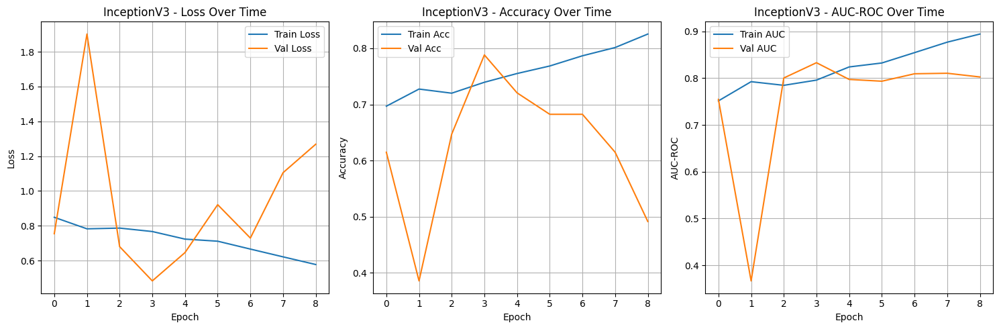


Model training history saved to Lung_Opacity_inceptionv3_history.pkl

--- Starting InceptionV3 Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.5885
Test Accuracy:   0.7202
Test F1 Score:   0.7846
Test AUC-ROC:    0.7434


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

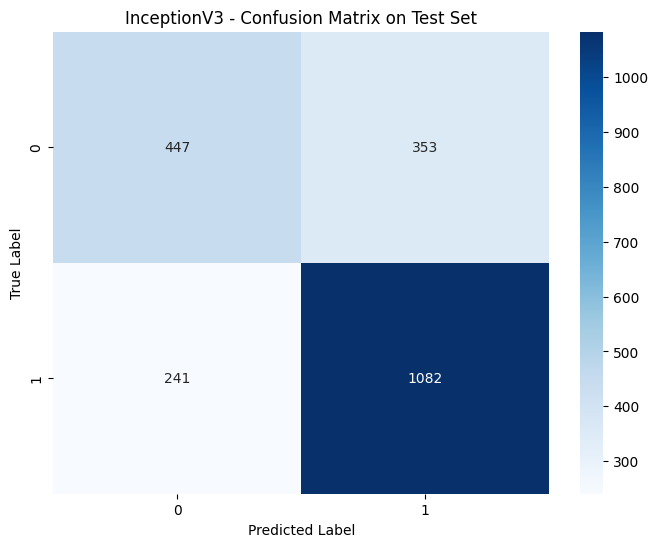

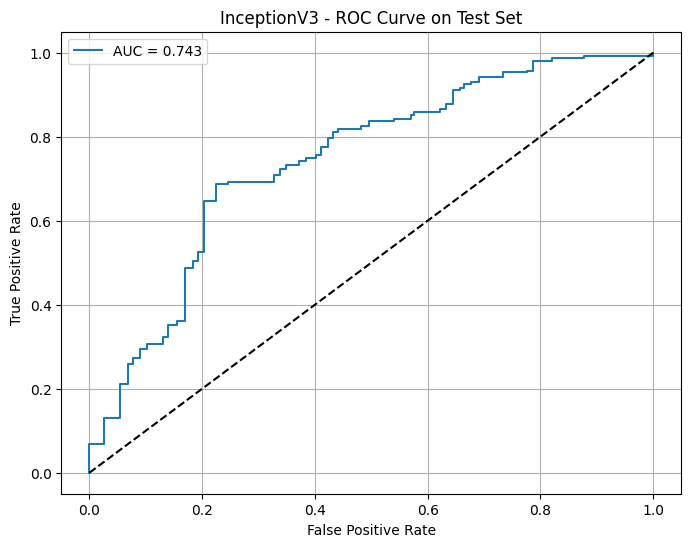


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.65      0.56      0.60       800
    Positive       0.75      0.82      0.78      1323

    accuracy                           0.72      2123
   macro avg       0.70      0.69      0.69      2123
weighted avg       0.71      0.72      0.72      2123



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle


transform = transforms.Compose([
    transforms.Resize((299, 299)),  # Inception V3  299x299 input
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Lung Opacity'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0,
    pin_memory=True
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0,
    pin_memory=True
)


print("\n--- Starting InceptionV3 Model Initialization for Lung Opacity Classification ---")

# Initialize InceptionV3 with pretrained weights
model = models.inception_v3(weights=models.Inception_V3_Weights.IMAGENET1K_V1)


num_ftrs = model.fc.in_features
model.fc = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.Dropout(0.4),
    nn.Linear(512, 1)
)

# Modify auxiliary classifier
num_ftrs_aux = model.AuxLogits.fc.in_features
model.AuxLogits.fc = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(num_ftrs_aux, 1)
)

# Move model to GPU if available
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

print(f"Model initialized on: {device}")
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

# Training function
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs, aux_outputs = model(inputs)

        # Calculate primary and auxiliary losses
        loss1 = criterion(outputs.squeeze(), labels)
        loss2 = criterion(aux_outputs.squeeze(), labels)
        loss = loss1 + 0.4 * loss2

        loss.backward()
        optimizer.step()

        running_loss += loss.item()


        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)


            outputs = model(inputs)
            if isinstance(outputs, tuple):
                outputs = outputs[0]

            loss = criterion(outputs.squeeze(), labels)
            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Training loop
print("\n--- Starting InceptionV3 Model Training on Lung Opacity dataset ---")

num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:   Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Lung_Opacity_inceptionv3_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# Plot training history
plt.figure(figsize=(15, 5))

# Plot Loss
plt.subplot(1, 3, 1)
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Val Loss')
plt.title('InceptionV3 - Loss Over Time')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

# Plot Accuracy
plt.subplot(1, 3, 2)
plt.plot(history['train_acc'], label='Train Acc')
plt.plot(history['val_acc'], label='Val Acc')
plt.title('InceptionV3 - Accuracy Over Time')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)

# Plot AUC-ROC
plt.subplot(1, 3, 3)
plt.plot(history['train_auc'], label='Train AUC')
plt.plot(history['val_auc'], label='Val AUC')
plt.title('InceptionV3 - AUC-ROC Over Time')
plt.xlabel('Epoch')
plt.ylabel('AUC-ROC')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('inceptionv3_training_history.png')
plt.show()

# Save training history
history_filename = 'Lung_Opacity_inceptionv3_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")
# ----------------------------------------------------------------------
# Evaluation on Test Dataset
print("\n--- Starting InceptionV3 Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0,
    pin_memory=True
)

# Load best model
model.load_state_dict(torch.load('best_Lung_Opacity_inceptionv3_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# Calculate final metrics and generate plots
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        if isinstance(outputs, tuple):
            outputs = outputs[0]

        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('InceptionV3 - Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('inceptionv3_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('InceptionV3 - ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('inceptionv3_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


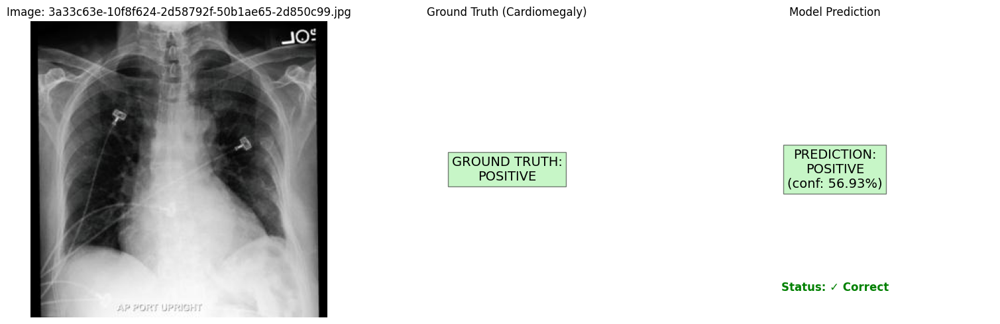


Image: 3a33c63e-10f8f624-2d58792f-50b1ae65-2d850c99.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.5693)
Prediction Status: ✓ Correct
--------------------------------------------------


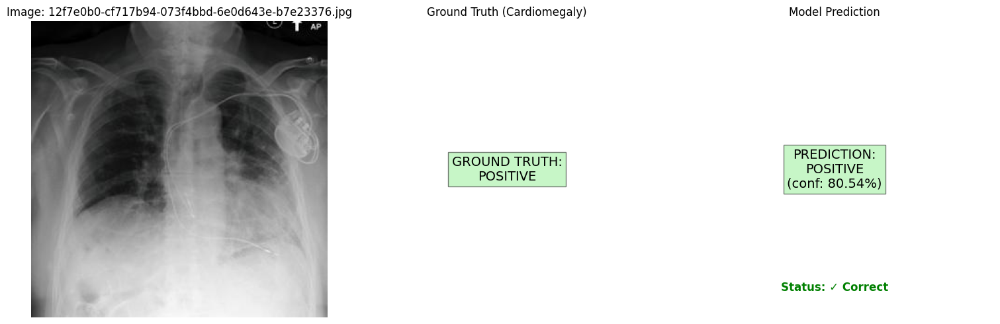


Image: 12f7e0b0-cf717b94-073f4bbd-6e0d643e-b7e23376.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8054)
Prediction Status: ✓ Correct
--------------------------------------------------


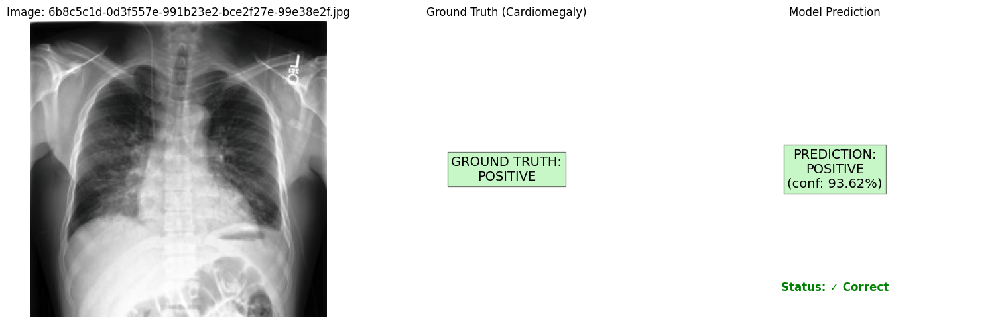


Image: 6b8c5c1d-0d3f557e-991b23e2-bce2f27e-99e38e2f.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9362)
Prediction Status: ✓ Correct
--------------------------------------------------


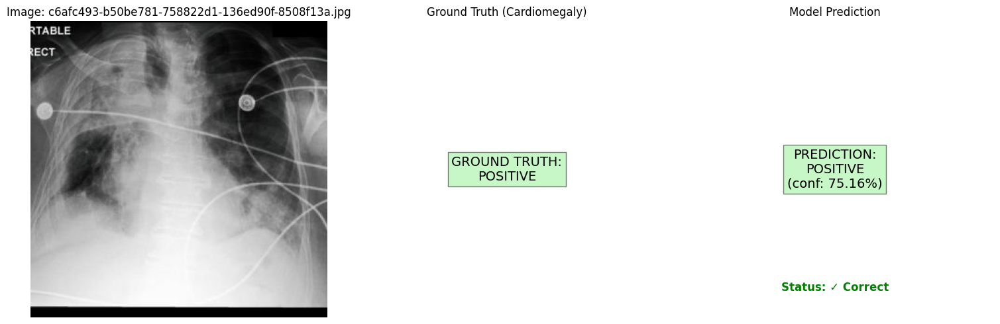


Image: c6afc493-b50be781-758822d1-136ed90f-8508f13a.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7516)
Prediction Status: ✓ Correct
--------------------------------------------------


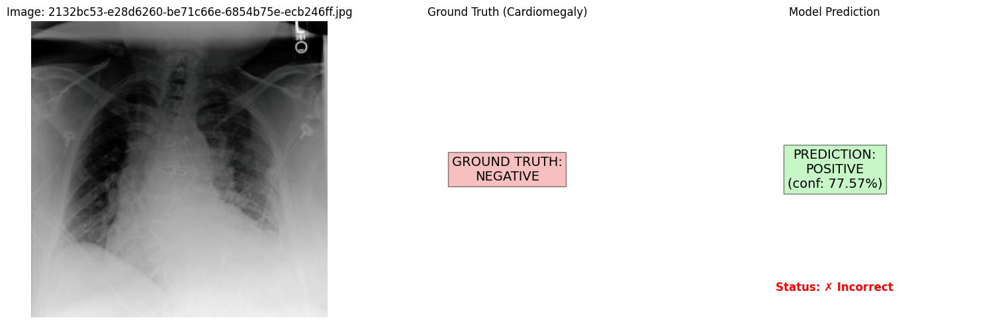


Image: 2132bc53-e28d6260-be71c66e-6854b75e-ecb246ff.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.7757)
Prediction Status: ✗ Incorrect
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Lung Opacity'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

model.load_state_dict(torch.load('best_Lung_Opacity_inceptionv3_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## MobileNet V3 Large - Lung Opacity

Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-8738ca79.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_large-8738ca79.pth



--- Starting MobileNetV3-Large Model Initialization (MobileNetV3 on Lung Opacity dataset) ---


100%|██████████| 21.1M/21.1M [00:00<00:00, 131MB/s] 


Model initialized on: cuda:0
Total parameters: 4,858,417
Trainable parameters: 4,858,417

--- Starting MobileNetV3-Large Model Training on Lung Opacity dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 1/20 | Time: 58.01s
------------------------------------------------------------
Training:    Loss: 0.5794, Accuracy: 0.7105, F1: 0.7183, AUC-ROC: 0.7709
Validation: Loss: 0.6185, Accuracy: 0.6882, F1: 0.8037, AUC-ROC: 0.7413
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7413


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 2/20 | Time: 55.78s
------------------------------------------------------------
Training:    Loss: 0.5074, Accuracy: 0.7633, F1: 0.7773, AUC-ROC: 0.8277
Validation: Loss: 0.7765, Accuracy: 0.6882, F1: 0.8015, AUC-ROC: 0.7642
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.7642


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 3/20 | Time: 55.75s
------------------------------------------------------------
Training:    Loss: 0.4615, Accuracy: 0.7977, F1: 0.8011, AUC-ROC: 0.8660
Validation: Loss: 0.9766, Accuracy: 0.5912, F1: 0.5697, AUC-ROC: 0.8029
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8029


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 4/20 | Time: 56.00s
------------------------------------------------------------
Training:    Loss: 0.3631, Accuracy: 0.8512, F1: 0.8544, AUC-ROC: 0.9181
Validation: Loss: 1.5053, Accuracy: 0.5853, F1: 0.5913, AUC-ROC: 0.6758


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 5/20 | Time: 55.84s
------------------------------------------------------------
Training:    Loss: 0.3054, Accuracy: 0.8809, F1: 0.8806, AUC-ROC: 0.9420
Validation: Loss: 2.4071, Accuracy: 0.4941, F1: 0.3813, AUC-ROC: 0.7398


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 6/20 | Time: 56.32s
------------------------------------------------------------
Training:    Loss: 0.2418, Accuracy: 0.9080, F1: 0.9091, AUC-ROC: 0.9636
Validation: Loss: 0.9923, Accuracy: 0.7176, F1: 0.8025, AUC-ROC: 0.7763


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 7/20 | Time: 55.75s
------------------------------------------------------------
Training:    Loss: 0.1919, Accuracy: 0.9268, F1: 0.9274, AUC-ROC: 0.9772
Validation: Loss: 1.1117, Accuracy: 0.6794, F1: 0.7562, AUC-ROC: 0.7184


Training:   0%|          | 0/145 [00:00<?, ?it/s]

Validation:   0%|          | 0/11 [00:00<?, ?it/s]


Epoch 8/20 | Time: 55.48s
------------------------------------------------------------
Training:    Loss: 0.1597, Accuracy: 0.9411, F1: 0.9409, AUC-ROC: 0.9846
Validation: Loss: 0.7883, Accuracy: 0.7088, F1: 0.7805, AUC-ROC: 0.7396

Early stopping triggered after epoch 8. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---


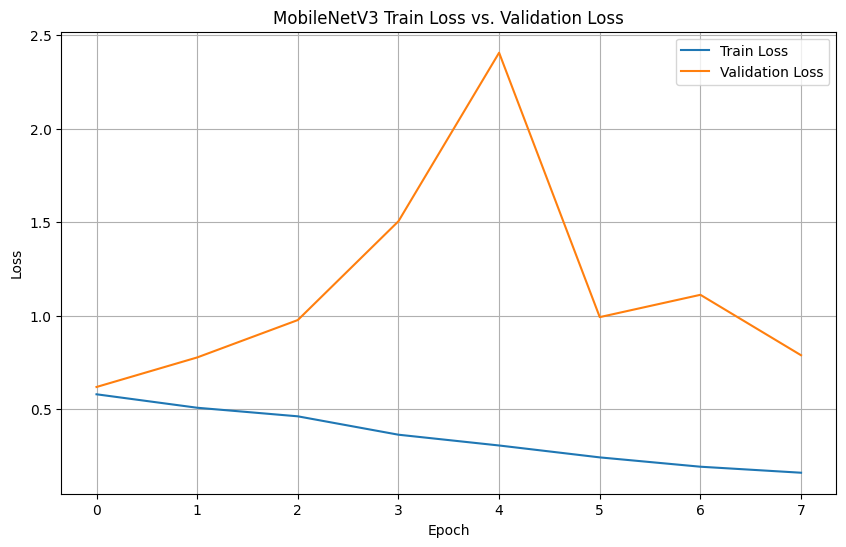


Model training history saved to Lung_Opacity_mobilenetv3_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/67 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       1.0256
Test Accuracy:   0.5737
Test F1 Score:   0.5418
Test AUC-ROC:    0.7438

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/67 [00:00<?, ?it/s]

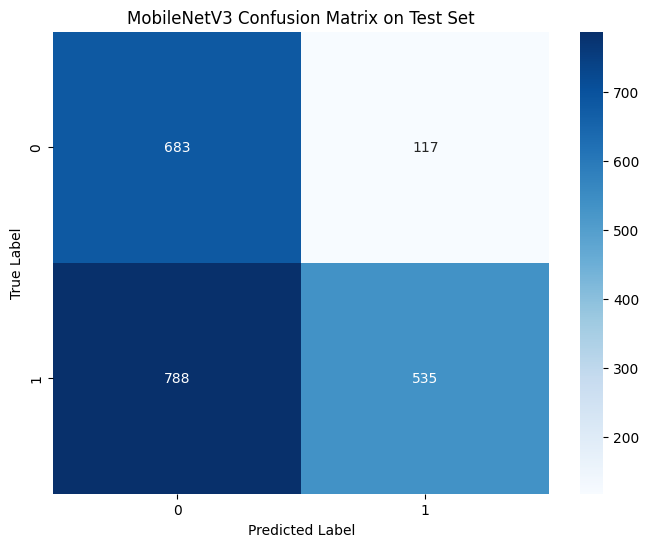

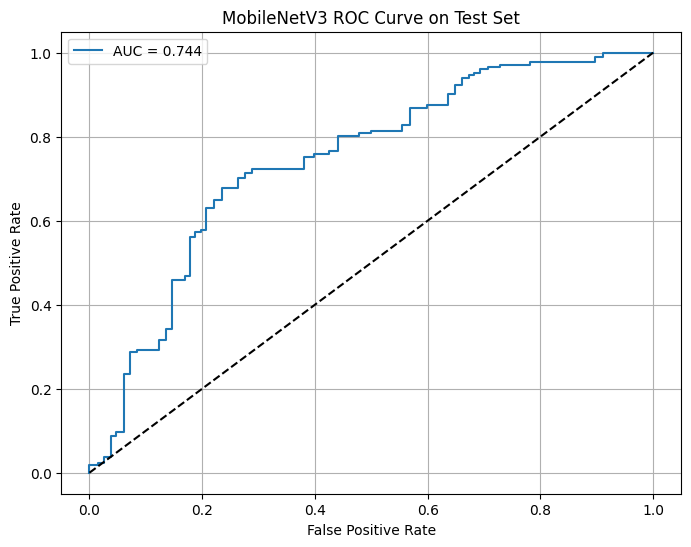


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.46      0.85      0.60       800
    Positive       0.82      0.40      0.54      1323

    accuracy                           0.57      2123
   macro avg       0.64      0.63      0.57      2123
weighted avg       0.69      0.57      0.56      2123



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Lung Opacity'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
# Initialize MobileNetV3-Large Model
print("\n--- Starting MobileNetV3-Large Model Initialization (MobileNetV3 on Lung Opacity dataset) ---")

model = models.mobilenet_v3_large(weights=models.MobileNet_V3_Large_Weights.IMAGENET1K_V1)

#  classifier for binary classification
num_ftrs = model.classifier[-1].in_features
model.classifier[-1] = nn.Sequential(
    nn.Dropout(p=0.3),
    nn.Linear(num_ftrs, 512),
    nn.Hardswish(),
    nn.Dropout(p=0.3),
    nn.Linear(512, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

print(f"Model initialized on: {device}")
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# ----------------------------------------------------------------------
print("\n--- Starting MobileNetV3-Large Model Training on Lung Opacity dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Lung_Opacity_mobilenetv3_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

# Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('MobileNetV3 Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('mobilenetv3_train_val_loss_plot.png')
plt.show()

# Storing Model History
history_filename = 'Lung_Opacity_mobilenetv3_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")

# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset and loader
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# Load best model
model.load_state_dict(torch.load('best_Lung_Opacity_mobilenetv3_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('MobileNetV3 Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('mobilenetv3_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('MobileNetV3 ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('mobilenetv3_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


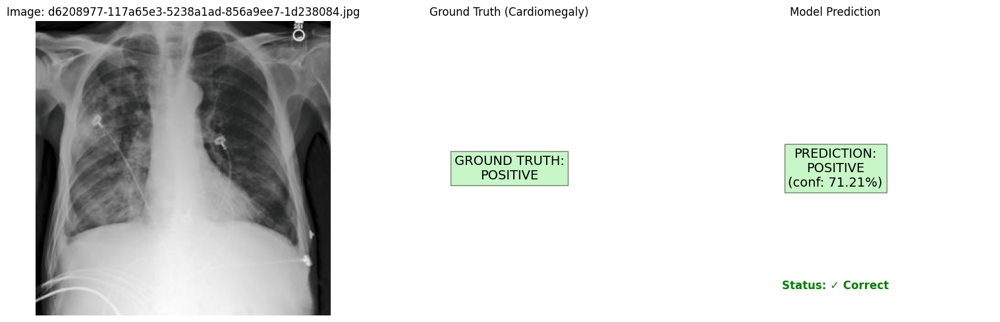


Image: d6208977-117a65e3-5238a1ad-856a9ee7-1d238084.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7121)
Prediction Status: ✓ Correct
--------------------------------------------------


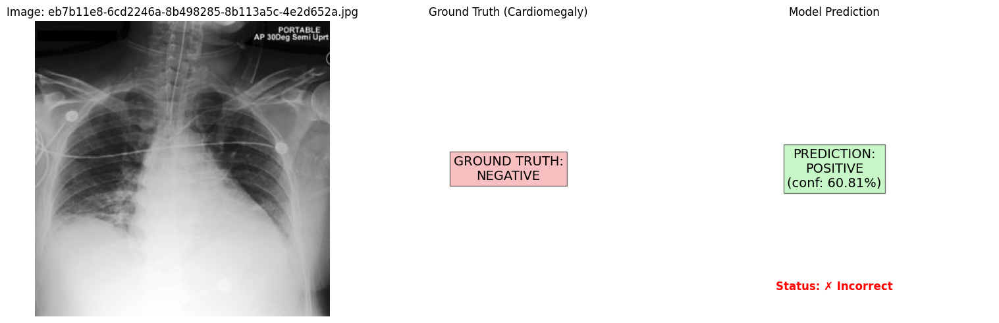


Image: eb7b11e8-6cd2246a-8b498285-8b113a5c-4e2d652a.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.6081)
Prediction Status: ✗ Incorrect
--------------------------------------------------


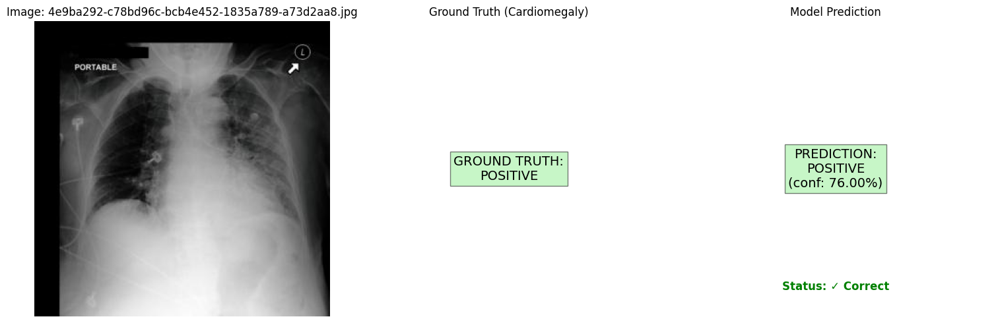


Image: 4e9ba292-c78bd96c-bcb4e452-1835a789-a73d2aa8.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7600)
Prediction Status: ✓ Correct
--------------------------------------------------


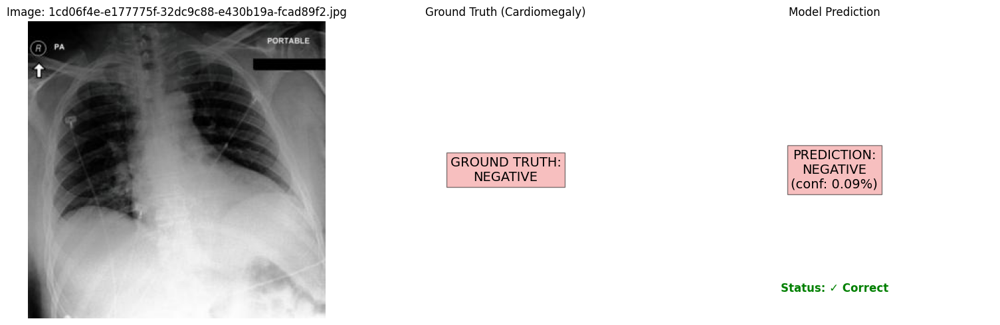


Image: 1cd06f4e-e177775f-32dc9c88-e430b19a-fcad89f2.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0009)
Prediction Status: ✓ Correct
--------------------------------------------------


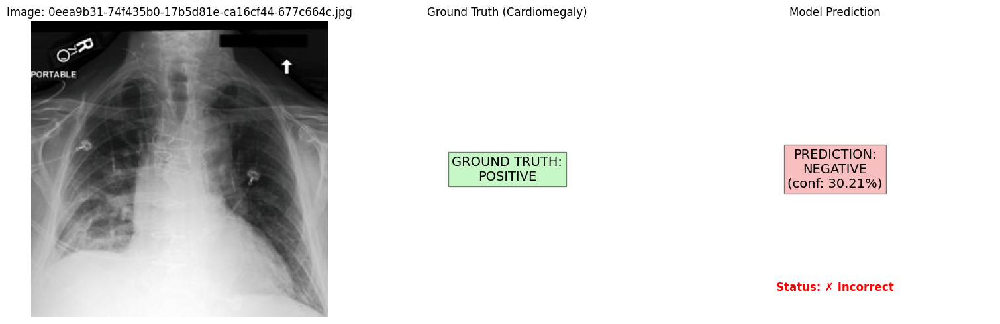


Image: 0eea9b31-74f435b0-17b5d81e-ca16cf44-677c664c.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.3021)
Prediction Status: ✗ Incorrect
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 3
Accuracy: 60.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Lung Opacity'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        # Fix: Ensure comparison is between 0/1 integers
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

model.load_state_dict(torch.load('best_Lung_Opacity_mobilenetv3_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

# Pleural Effusion Models

STATISTICAL ANALYSIS FOR CLASS: PLEURAL EFFUSION

--- TRAIN SET (Pleural Effusion_train.csv) ---
Total entries (Row Count): 6,441

Condition label distribution (per column):
  • Pleural Effusion:
    - Positive (1) :   3,618 ( 56.2%)
    - Negative (0) :   2,823
    - Total Labeled:   6,441

--- VAL SET (Pleural Effusion_val.csv) ---
Total entries (Row Count): 490

Condition label distribution (per column):
  • Pleural Effusion:
    - Positive (1) :     253 ( 51.6%)
    - Negative (0) :     237
    - Total Labeled:     490

--- TEST SET (Pleural Effusion_test.csv) ---
Total entries (Row Count): 3,148

Condition label distribution (per column):
  • Pleural Effusion:
    - Positive (1) :   1,681 ( 53.4%)
    - Negative (0) :   1,467
    - Total Labeled:   3,148

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
PLOTTING TRAINING SET LABEL DISTRIBUTION FOR: PLEURAL EFFUSION
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

Training Set total labe

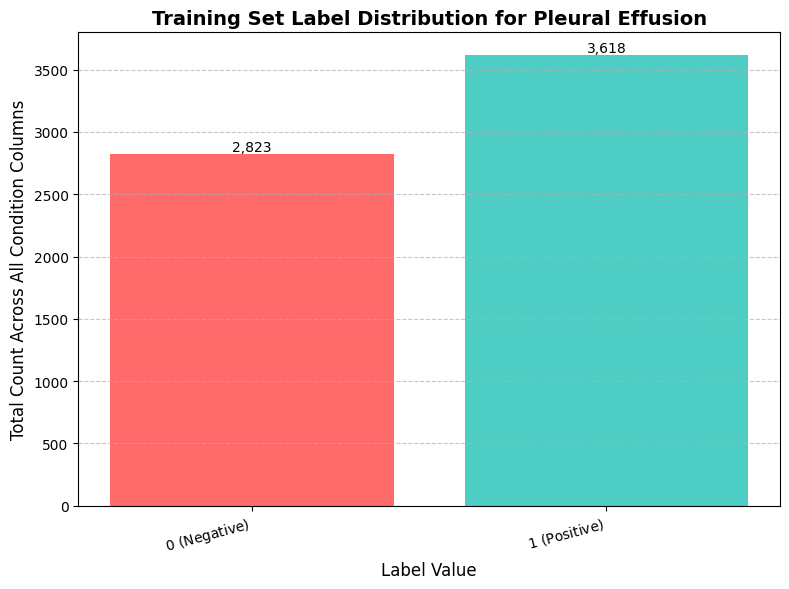

Plot saved as 'pleural effusion_label_distribution.png'

--- Starting Data Load for Class: Pleural Effusion ---
  Loaded train CSV: 6,441 entries. Verified images: 6,441.
  Loaded val CSV: 490 entries. Verified images: 490.
  Loaded test CSV: 3,148 entries. Verified images: 3,148.
Sucesfully Loaded Dataset


In [ ]:
target_class='Pleural Effusion'
train_df_result = analyze_class_csv_stats(class_name=target_class)
visualize_training_label_distribution(class_name=target_class, train_df=train_df_result)
loaded_data = load_dataset(class_name='Pleural Effusion')

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
from torch.utils.data import DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score
from torchvision import transforms
from torch.utils.data import Dataset
import torch.nn.functional as F
from PIL import Image

# Custom Dataset class
class ChestXRayDataset(Dataset):
    def __init__(self, dataframe, image_paths, transform=None):
        self.dataframe = dataframe
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        # Get the label from the dataframe
        df_idx = self.dataframe.index[self.dataframe['cxr_path'].str.contains(os.path.basename(img_path))][0]
        label = torch.tensor(self.dataframe.iloc[df_idx]['Pleural Effusion'], dtype=torch.float32)

        return image, label

# Data transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

print ("Pleural Effusion CXR dataset loaded" )

Pleural Effusion CXR dataset loaded


## ResNet 18 - Pleural Effusion


--- Starting ResNet Model Initialization (ResNet18 on Pleural Effusion dataset) ---


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 159MB/s]



--- Starting ResNet Model Training on Pleural Effusion dataset ---


Epochs:   0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 1/15 | Time: 69.90s
------------------------------------------------------------
Training:    Loss: 0.4600, Accuracy: 0.7820, F1: 0.7845, AUC-ROC: 0.8646
Validation: Loss: 0.4529, Accuracy: 0.7918, F1: 0.7984, AUC-ROC: 0.8796
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8796


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 2/15 | Time: 61.37s
------------------------------------------------------------
Training:    Loss: 0.3014, Accuracy: 0.8828, F1: 0.8814, AUC-ROC: 0.9445
Validation: Loss: 0.6177, Accuracy: 0.7388, F1: 0.7785, AUC-ROC: 0.8572


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 3/15 | Time: 59.43s
------------------------------------------------------------
Training:    Loss: 0.1875, Accuracy: 0.9309, F1: 0.9304, AUC-ROC: 0.9783
Validation: Loss: 0.6420, Accuracy: 0.7612, F1: 0.7899, AUC-ROC: 0.8498


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 4/15 | Time: 59.61s
------------------------------------------------------------
Training:    Loss: 0.1372, Accuracy: 0.9506, F1: 0.9510, AUC-ROC: 0.9884
Validation: Loss: 0.7296, Accuracy: 0.7776, F1: 0.7696, AUC-ROC: 0.8596

Early stopping triggered after epoch 4. Validation AUC-ROC did not improve for 3 epochs.

--- Starting Plotting and History Storage ---


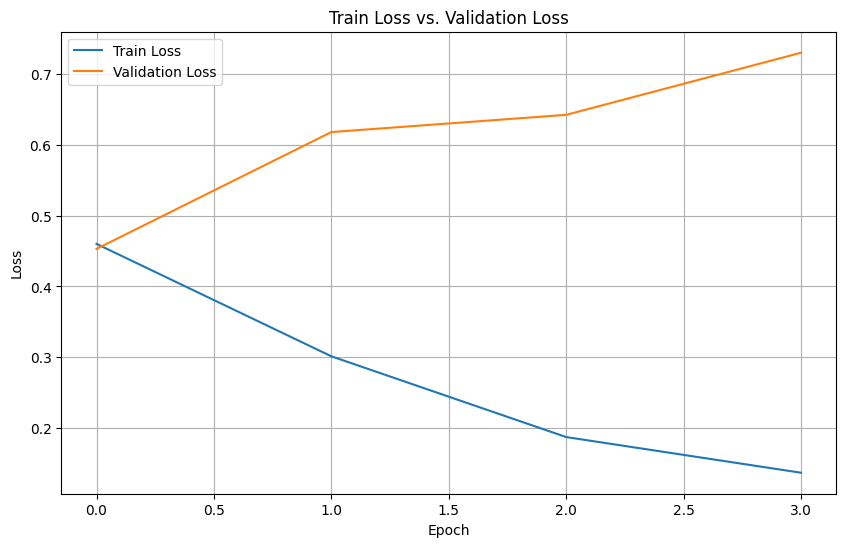


Model training history saved to Pleural_Effusion_resnet18_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/99 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:        0.5536
Test Accuracy:    0.7490
Test F1 Score:    0.7591
Test AUC-ROC:     0.8426

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/99 [00:00<?, ?it/s]

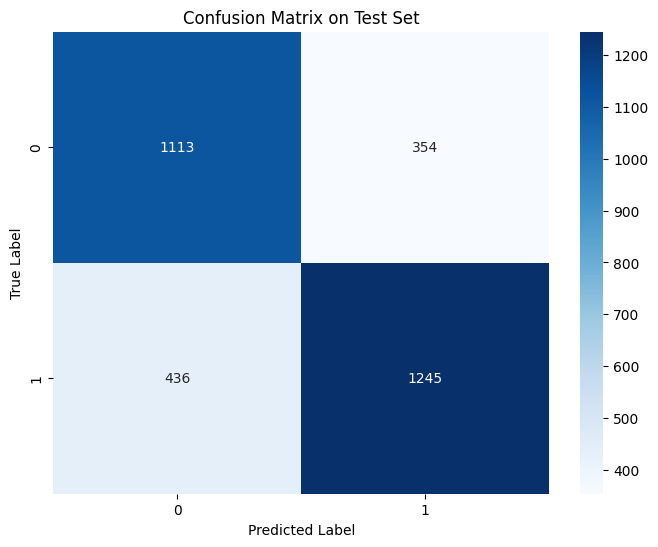

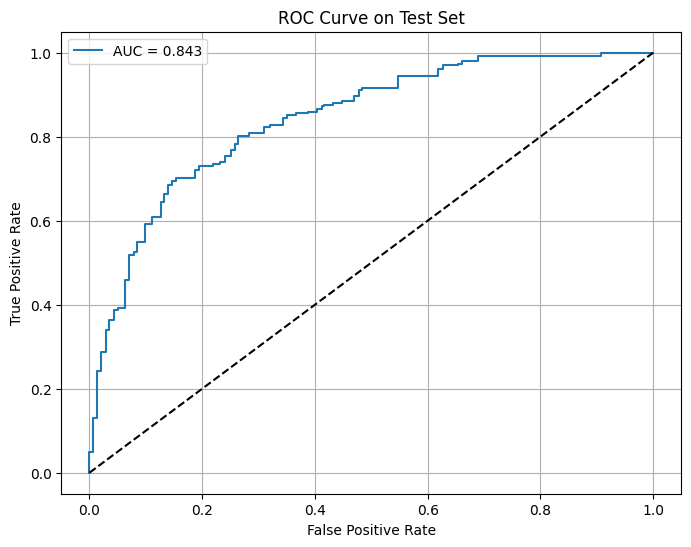


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.72      0.76      0.74      1467
    Positive       0.78      0.74      0.76      1681

    accuracy                           0.75      3148
   macro avg       0.75      0.75      0.75      3148
weighted avg       0.75      0.75      0.75      3148



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle


# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Pleural Effusion'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)


print("\n--- Starting ResNet Model Initialization (ResNet18 on Pleural Effusion dataset) ---")

# Initialize ResNet18 model
model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
num_ftrs = model.fc.in_features

model.fc = nn.Sequential(
    nn.Dropout(0.5),
    nn.Linear(num_ftrs, 1)
)



device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()


optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001, weight_decay=0.05)


# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Training on Pleural Effusion dataset ---")

# Training loop
num_epochs = 15
best_val_auc = 0.0
# Early Stopping variables
patience = 3
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}


for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time() #

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        # UPDATED CHECKPOINT FILENAME
        torch.save(model.state_dict(), 'best_Pleural_Effusion_resnet18_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))

epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot.png')
plt.show()

## Storing Model History
# UPDATED HISTORY FILENAME
history_filename = 'Pleural_Effusion_resnet18_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
model.load_state_dict(torch.load('best_Pleural_Effusion_resnet18_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:        {test_loss:.4f}")
print(f"Test Accuracy:    {test_acc:.4f}")
print(f"Test F1 Score:    {test_f1:.4f}")
print(f"Test AUC-ROC:     {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))




--- Randomly Predicting on 5 Test Images ---


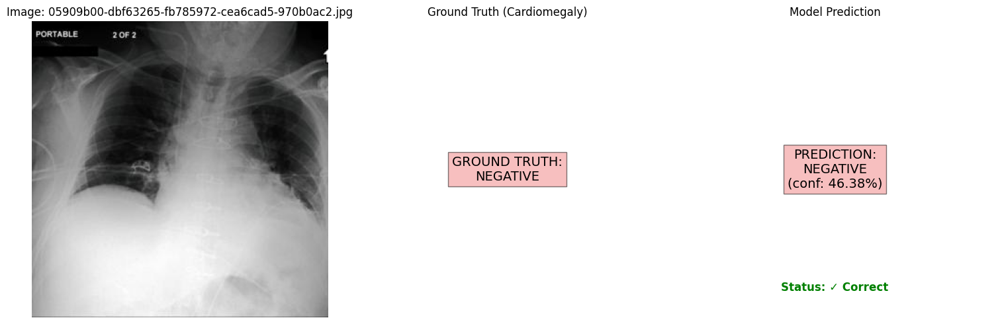


Image: 05909b00-dbf63265-fb785972-cea6cad5-970b0ac2.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.4638)
Prediction Status: ✓ Correct
--------------------------------------------------


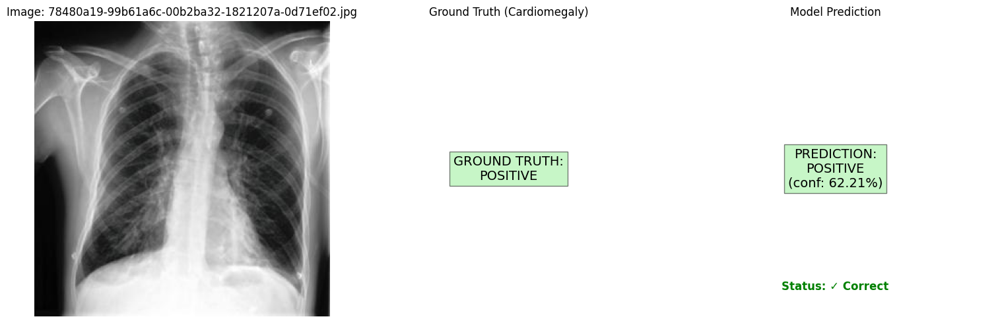


Image: 78480a19-99b61a6c-00b2ba32-1821207a-0d71ef02.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.6221)
Prediction Status: ✓ Correct
--------------------------------------------------


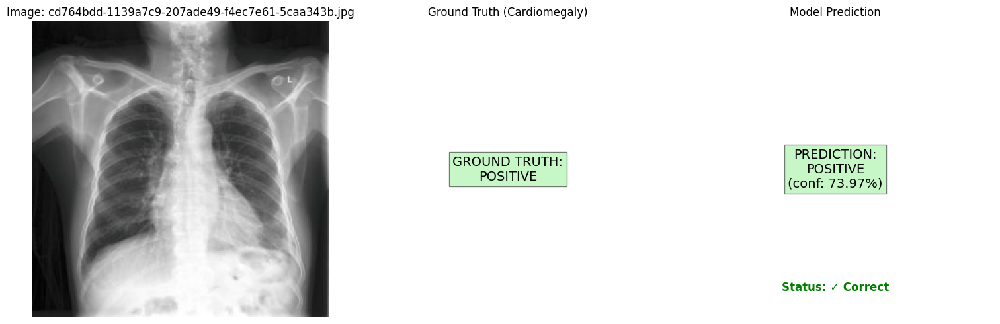


Image: cd764bdd-1139a7c9-207ade49-f4ec7e61-5caa343b.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7397)
Prediction Status: ✓ Correct
--------------------------------------------------


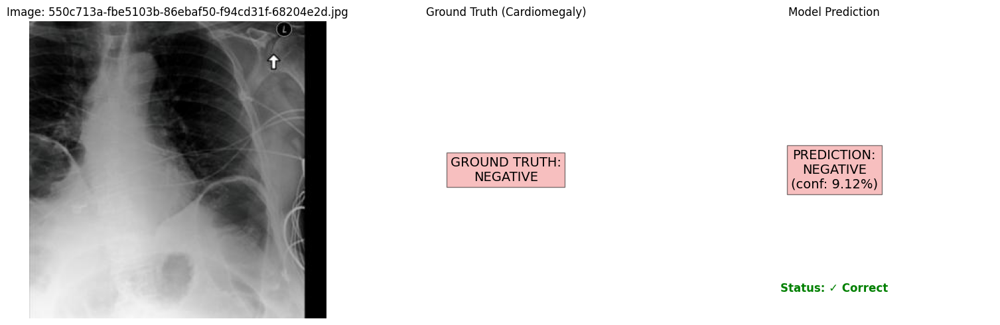


Image: 550c713a-fbe5103b-86ebaf50-f94cd31f-68204e2d.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0912)
Prediction Status: ✓ Correct
--------------------------------------------------


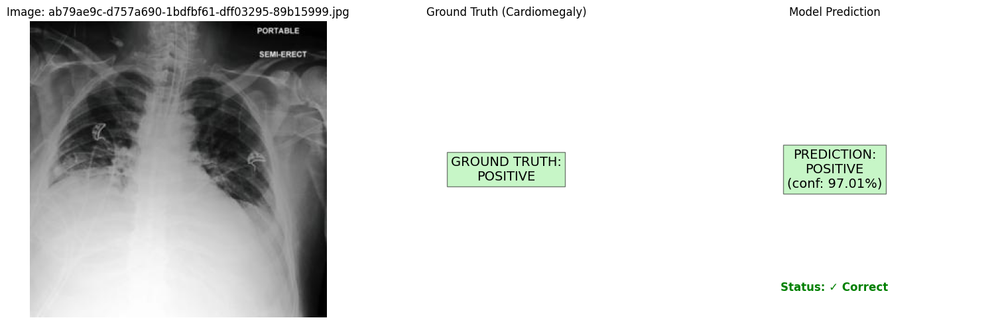


Image: ab79ae9c-d757a690-1bdfbf61-dff03295-89b15999.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9701)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 5
Accuracy: 100.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Pleural Effusion'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---

model.load_state_dict(torch.load('best_Pleural_Effusion_resnet18_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## ResNet 50 - Pleural Effusion


--- Starting ResNet Model Initialization (ResNet50 on Pleural Effusion dataset) ---

--- Starting ResNet Model Training on Pleural Effusion dataset with Regularization and Scheduler ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 1/20 | Time: 104.55s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.5098, Accuracy: 0.7556, F1: 0.7549, AUC-ROC: 0.8314
Validation: Loss: 0.5276, Accuracy: 0.7796, F1: 0.7985, AUC-ROC: 0.8558
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8558


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 2/20 | Time: 106.50s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.4845, Accuracy: 0.7792, F1: 0.7773, AUC-ROC: 0.8493
Validation: Loss: 0.6749, Accuracy: 0.7224, F1: 0.7799, AUC-ROC: 0.8462


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 3/20 | Time: 106.00s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.4555, Accuracy: 0.7938, F1: 0.7901, AUC-ROC: 0.8704
Validation: Loss: 0.4865, Accuracy: 0.7571, F1: 0.7566, AUC-ROC: 0.8463


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 4/20 | Time: 105.58s | LR: 0.001
------------------------------------------------------------
Training:    Loss: 0.4437, Accuracy: 0.8033, F1: 0.8037, AUC-ROC: 0.8761
Validation: Loss: 0.5236, Accuracy: 0.7408, F1: 0.7822, AUC-ROC: 0.8504

Early stopping triggered after epoch 4. Validation AUC-ROC did not improve for 3 epochs.

--- Starting Plotting and History Storage ---


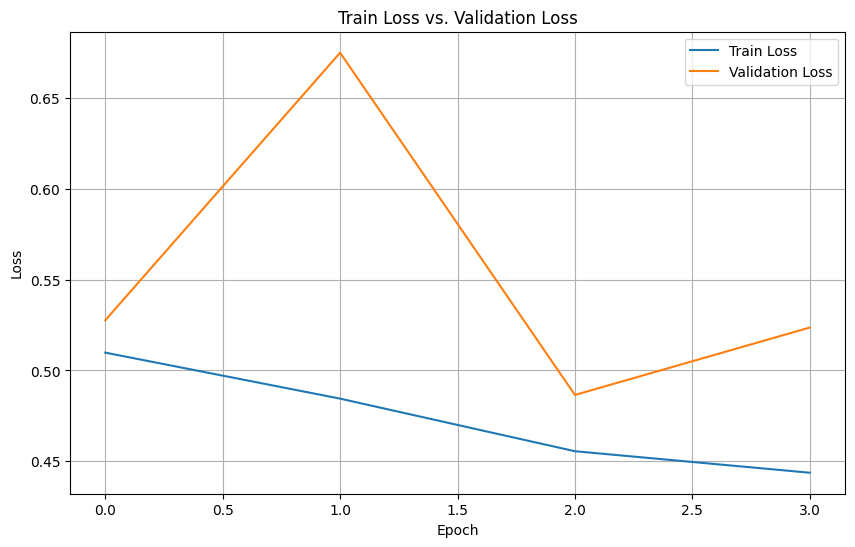


Model training history saved to Pleural_Effusion_resnet50_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/99 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.5284
Test Accuracy:   0.7672
Test F1 Score:   0.7829
Test AUC-ROC:    0.8443

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/99 [00:00<?, ?it/s]

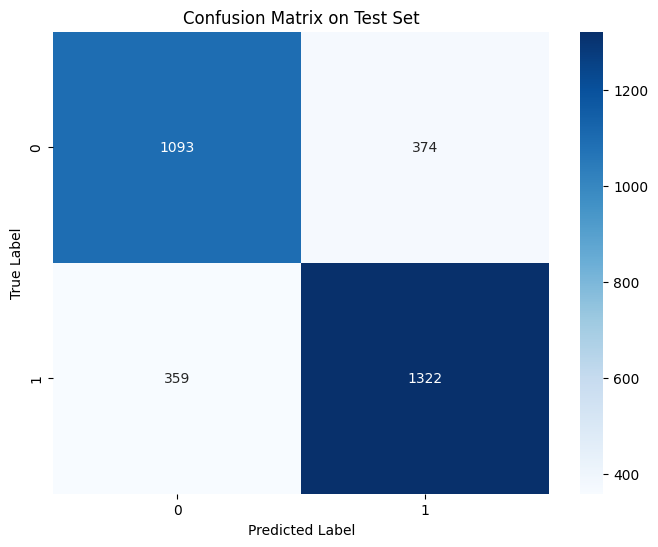

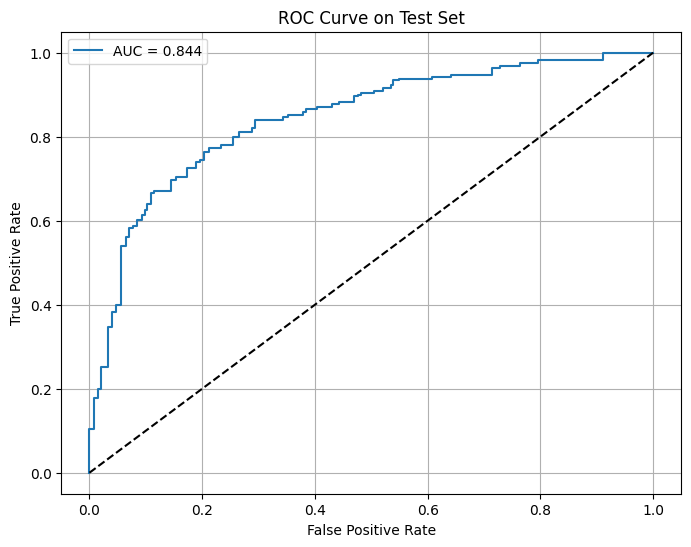


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.75      0.75      0.75      1467
    Positive       0.78      0.79      0.78      1681

    accuracy                           0.77      3148
   macro avg       0.77      0.77      0.77      3148
weighted avg       0.77      0.77      0.77      3148



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle
from torch.optim.lr_scheduler import ReduceLROnPlateau

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Pleural Effusion'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Initialization (ResNet50 on Pleural Effusion dataset) ---")

# Initialize ResNet50 model
model = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V2)
num_ftrs = model.fc.in_features

model.fc = nn.Sequential(
    nn.Dropout(p=0.6),
    nn.Linear(num_ftrs, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()

optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.5)

# *** MODIFICATION 3: INITIALIZE LEARNING RATE SCHEDULER ***
scheduler = ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.1,
    patience=4,
    verbose=True
)


# Training function
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Store predictions and true labels for metrics
        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting ResNet Model Training on Pleural Effusion dataset with Regularization and Scheduler ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
# Early Stopping variables
patience = 3
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )


    scheduler.step(val_auc)
    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics# Print epoch time and current LR
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Pleural_Effusion_resnet50_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot_regularized.png')
plt.show()

## Storing Model History
history_filename = 'Pleural_Effusion_resnet50_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)




print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
model.load_state_dict(torch.load('best_Pleural_Effusion_resnet50_model.pth'))

model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)
y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix_regularized.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve_regularized.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


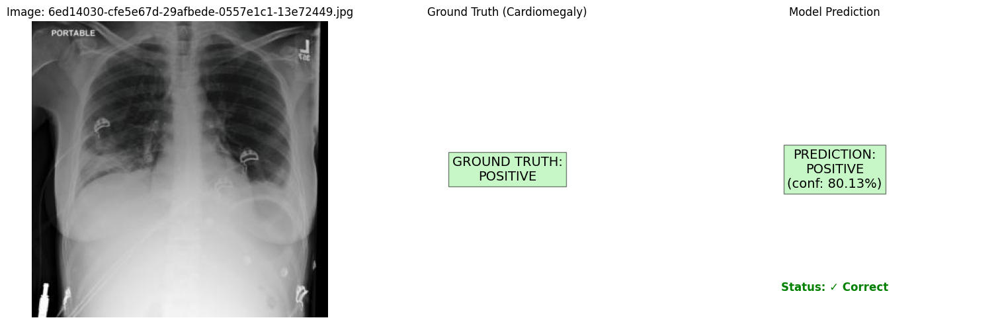


Image: 6ed14030-cfe5e67d-29afbede-0557e1c1-13e72449.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8013)
Prediction Status: ✓ Correct
--------------------------------------------------


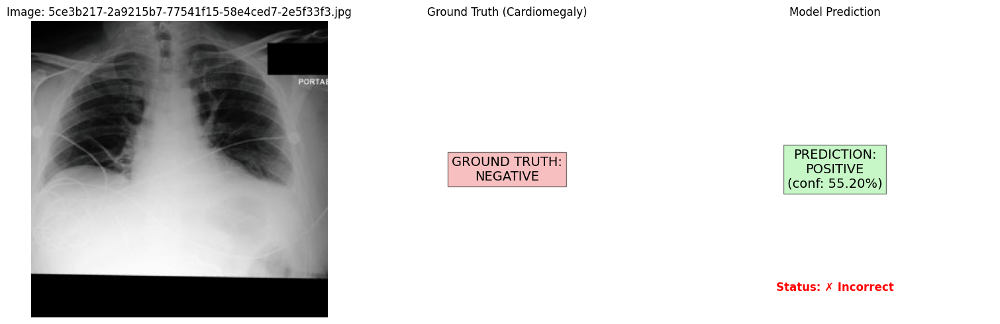


Image: 5ce3b217-2a9215b7-77541f15-58e4ced7-2e5f33f3.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.5520)
Prediction Status: ✗ Incorrect
--------------------------------------------------


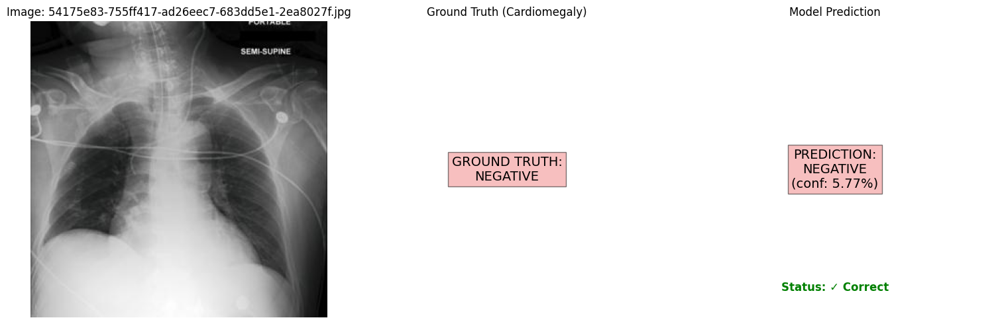


Image: 54175e83-755ff417-ad26eec7-683dd5e1-2ea8027f.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0577)
Prediction Status: ✓ Correct
--------------------------------------------------


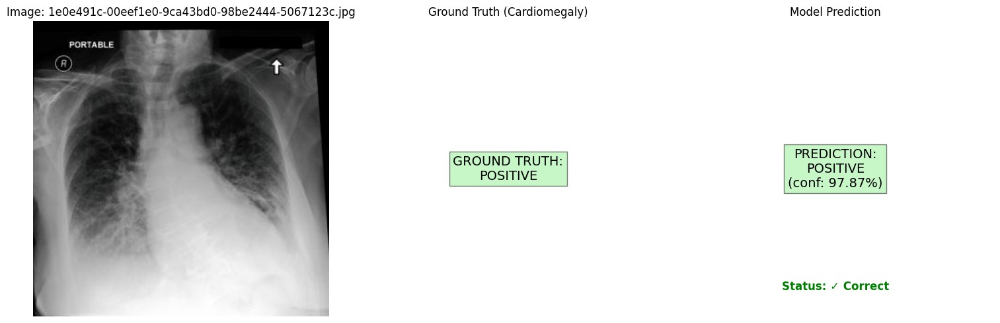


Image: 1e0e491c-00eef1e0-9ca43bd0-98be2444-5067123c.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9787)
Prediction Status: ✓ Correct
--------------------------------------------------


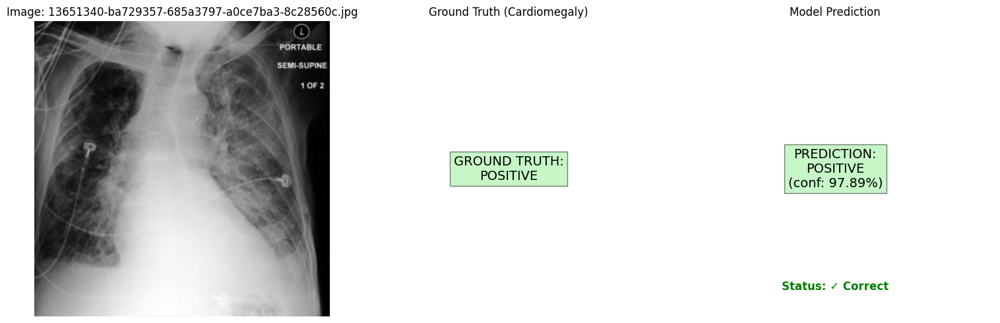


Image: 13651340-ba729357-685a3797-a0ce7ba3-8c28560c.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9789)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Pleural Effusion'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")
model.load_state_dict(torch.load('best_Pleural_Effusion_resnet50_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## VGG16 -Pleural Effusion


--- Starting VGG Model Initialization (VGG16 on Pleural Effusion dataset) ---

--- Starting VGG16 Model Training on Pleural Effusion dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 1/20 | Time: 157.42s
------------------------------------------------------------
Training:    Loss: 0.6679, Accuracy: 0.6109, F1: 0.6079, AUC-ROC: 0.6533
Validation: Loss: 0.5149, Accuracy: 0.7429, F1: 0.7308, AUC-ROC: 0.8350
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8350


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 2/20 | Time: 159.32s
------------------------------------------------------------
Training:    Loss: 0.5657, Accuracy: 0.7137, F1: 0.7204, AUC-ROC: 0.7815
Validation: Loss: 0.4619, Accuracy: 0.7939, F1: 0.8076, AUC-ROC: 0.8681
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8681


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 3/20 | Time: 159.99s
------------------------------------------------------------
Training:    Loss: 0.5201, Accuracy: 0.7508, F1: 0.7616, AUC-ROC: 0.8220
Validation: Loss: 0.5258, Accuracy: 0.7878, F1: 0.7895, AUC-ROC: 0.8660


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 4/20 | Time: 159.18s
------------------------------------------------------------
Training:    Loss: 0.5123, Accuracy: 0.7581, F1: 0.7619, AUC-ROC: 0.8299
Validation: Loss: 0.4668, Accuracy: 0.7531, F1: 0.7317, AUC-ROC: 0.8734
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8734


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 5/20 | Time: 159.20s
------------------------------------------------------------
Training:    Loss: 0.4873, Accuracy: 0.7828, F1: 0.7877, AUC-ROC: 0.8478
Validation: Loss: 0.4747, Accuracy: 0.7837, F1: 0.8107, AUC-ROC: 0.8579


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 6/20 | Time: 159.31s
------------------------------------------------------------
Training:    Loss: 0.4822, Accuracy: 0.7797, F1: 0.7852, AUC-ROC: 0.8502
Validation: Loss: 0.4585, Accuracy: 0.7837, F1: 0.7696, AUC-ROC: 0.8830
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8830


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 7/20 | Time: 159.78s
------------------------------------------------------------
Training:    Loss: 0.4786, Accuracy: 0.7847, F1: 0.7874, AUC-ROC: 0.8530
Validation: Loss: 0.4318, Accuracy: 0.8224, F1: 0.8404, AUC-ROC: 0.8865
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8865


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 8/20 | Time: 159.43s
------------------------------------------------------------
Training:    Loss: 0.4744, Accuracy: 0.7812, F1: 0.7835, AUC-ROC: 0.8560
Validation: Loss: 0.4419, Accuracy: 0.8041, F1: 0.8267, AUC-ROC: 0.8876
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8876


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 9/20 | Time: 159.96s
------------------------------------------------------------
Training:    Loss: 0.4696, Accuracy: 0.7842, F1: 0.7902, AUC-ROC: 0.8592
Validation: Loss: 0.4312, Accuracy: 0.8061, F1: 0.8049, AUC-ROC: 0.8869


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 10/20 | Time: 160.36s
------------------------------------------------------------
Training:    Loss: 0.4412, Accuracy: 0.8070, F1: 0.8084, AUC-ROC: 0.8774
Validation: Loss: 0.4244, Accuracy: 0.8061, F1: 0.8000, AUC-ROC: 0.8930
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8930


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 11/20 | Time: 158.45s
------------------------------------------------------------
Training:    Loss: 0.4545, Accuracy: 0.7965, F1: 0.7955, AUC-ROC: 0.8694
Validation: Loss: 0.4235, Accuracy: 0.8082, F1: 0.8033, AUC-ROC: 0.8918


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 12/20 | Time: 158.25s
------------------------------------------------------------
Training:    Loss: 0.4524, Accuracy: 0.7994, F1: 0.8036, AUC-ROC: 0.8699
Validation: Loss: 0.4080, Accuracy: 0.8306, F1: 0.8395, AUC-ROC: 0.8970
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8970


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 13/20 | Time: 157.98s
------------------------------------------------------------
Training:    Loss: 0.4461, Accuracy: 0.7980, F1: 0.8019, AUC-ROC: 0.8727
Validation: Loss: 0.4698, Accuracy: 0.7939, F1: 0.7689, AUC-ROC: 0.8978
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8978


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 14/20 | Time: 157.83s
------------------------------------------------------------
Training:    Loss: 0.4376, Accuracy: 0.8075, F1: 0.8085, AUC-ROC: 0.8805
Validation: Loss: 0.5212, Accuracy: 0.7469, F1: 0.7005, AUC-ROC: 0.8923


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 15/20 | Time: 158.84s
------------------------------------------------------------
Training:    Loss: 0.4515, Accuracy: 0.8008, F1: 0.8045, AUC-ROC: 0.8707
Validation: Loss: 0.4113, Accuracy: 0.8245, F1: 0.8333, AUC-ROC: 0.8932


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 16/20 | Time: 158.55s
------------------------------------------------------------
Training:    Loss: 0.4343, Accuracy: 0.8086, F1: 0.8126, AUC-ROC: 0.8814
Validation: Loss: 0.4349, Accuracy: 0.7939, F1: 0.8126, AUC-ROC: 0.8805


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 17/20 | Time: 160.02s
------------------------------------------------------------
Training:    Loss: 0.4046, Accuracy: 0.8196, F1: 0.8170, AUC-ROC: 0.8974
Validation: Loss: 0.4649, Accuracy: 0.8102, F1: 0.8009, AUC-ROC: 0.8998
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8998


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 18/20 | Time: 163.34s
------------------------------------------------------------
Training:    Loss: 0.4063, Accuracy: 0.8197, F1: 0.8228, AUC-ROC: 0.8976
Validation: Loss: 0.4139, Accuracy: 0.8306, F1: 0.8350, AUC-ROC: 0.8978


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 19/20 | Time: 163.09s
------------------------------------------------------------
Training:    Loss: 0.3906, Accuracy: 0.8319, F1: 0.8352, AUC-ROC: 0.9054
Validation: Loss: 0.3773, Accuracy: 0.8347, F1: 0.8457, AUC-ROC: 0.9099
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.9099


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 20/20 | Time: 163.81s
------------------------------------------------------------
Training:    Loss: 0.3967, Accuracy: 0.8249, F1: 0.8279, AUC-ROC: 0.9016
Validation: Loss: 0.3903, Accuracy: 0.8408, F1: 0.8434, AUC-ROC: 0.9041

--- Starting Plotting and History Storage ---


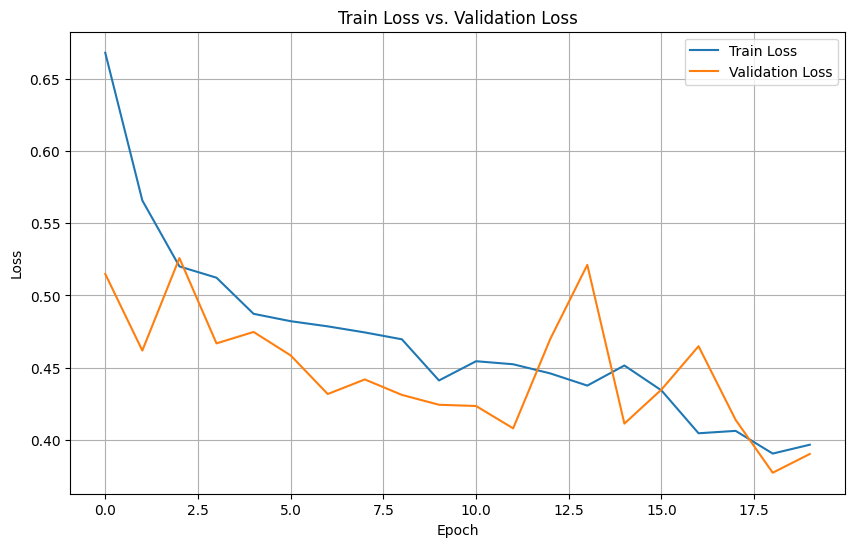


Model training history saved to Pleural_Effusion_vgg16_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/99 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.4778
Test Accuracy:   0.7605
Test F1 Score:   0.7741
Test AUC-ROC:    0.8629

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/99 [00:00<?, ?it/s]

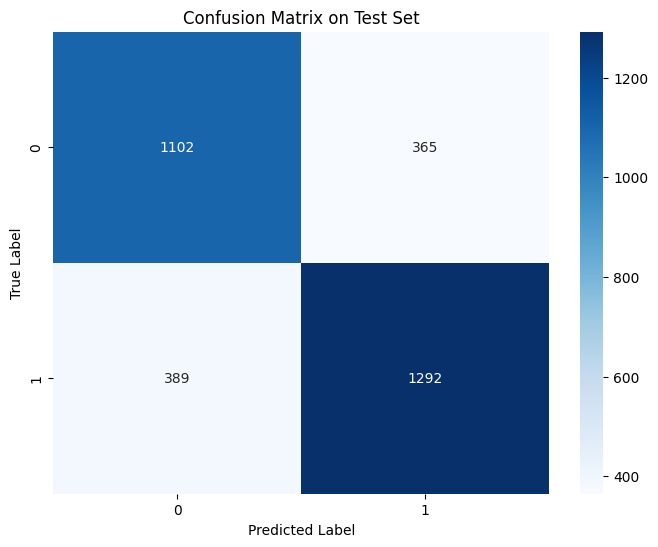

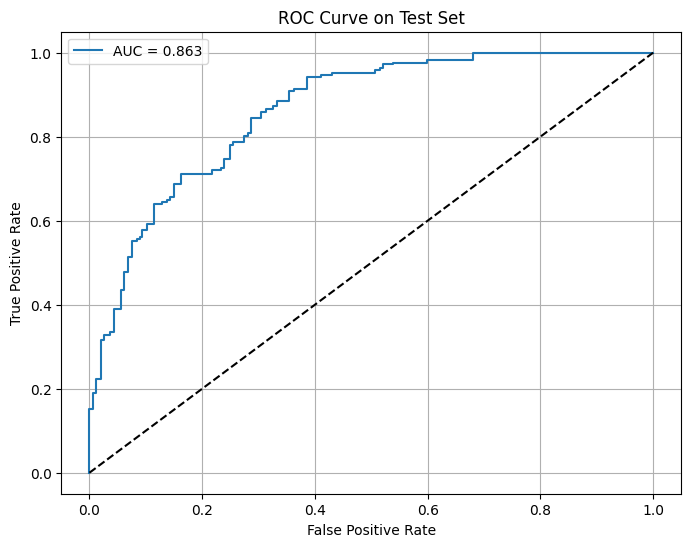


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.74      0.75      0.75      1467
    Positive       0.78      0.77      0.77      1681

    accuracy                           0.76      3148
   macro avg       0.76      0.76      0.76      3148
weighted avg       0.76      0.76      0.76      3148



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle



# Initialize VGG16 model
def create_vgg16_model(num_classes=1, pretrained=True):
    model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1 if pretrained else None)

    #  classifier for binary classification
    model.classifier = nn.Sequential(
        nn.Linear(512 * 7 * 7, 4096),
        nn.ReLU(True),
        nn.Dropout(p=0.5),
        nn.Linear(4096, 1024),
        nn.ReLU(True),
        nn.Dropout(p=0.5),
        nn.Linear(1024, num_classes)
    )

    for m in model.classifier.modules():
        if isinstance(m, nn.Linear):
            nn.init.xavier_normal_(m.weight)
            nn.init.constant_(m.bias, 0)

    return model

# Data transforms
vgg16_train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomRotation(15),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

vgg16_test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=vgg16_train_transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=vgg16_test_transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Pleural Effusion'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)


print("\n--- Starting VGG Model Initialization (VGG16 on Pleural Effusion dataset) ---")

# Initialize VGG16 model
model = create_vgg16_model(num_classes=1)


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()


optimizer = torch.optim.AdamW(
    model.parameters(),
    lr=1e-4,
    weight_decay=0.01,
    amsgrad=True
)

# Learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True
)


# Training function
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Store predictions and true labels for metrics
        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc


# ----------------------------------------------------------------------
print("\n--- Starting VGG16 Model Training on Pleural Effusion dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
# Early Stopping variables
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # ADD SCHEDULER STEP
    scheduler.step(val_auc)

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        # UPDATED CHECKPOINT FILENAME
        torch.save(model.state_dict(), 'best_Pleural_Effusion_vgg16_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True


# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

## Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))

epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('train_val_loss_plot.png')
plt.show()

## Storing Model History
# UPDATED HISTORY FILENAME
history_filename = 'Pleural_Effusion_vgg16_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")


test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=vgg16_test_transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4
)

# Load best model
model.load_state_dict(torch.load('best_Pleural_Effusion_vgg16_model.pth'))

model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")


# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('confusion_matrix.png')
plt.show()

# Plot ROC curve (use y_prob directly for binary classification)
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


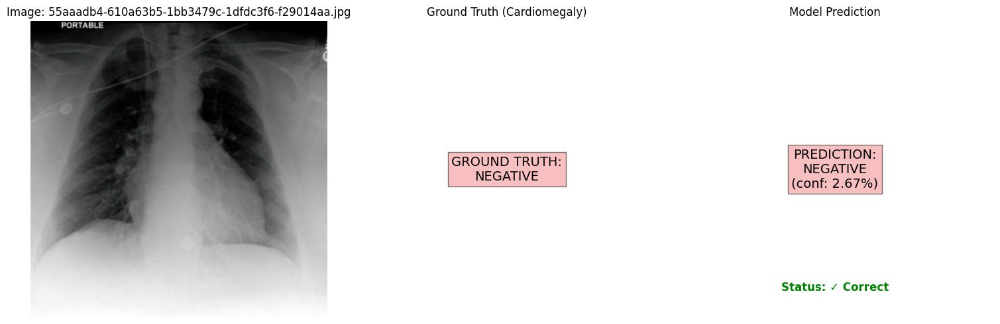


Image: 55aaadb4-610a63b5-1bb3479c-1dfdc3f6-f29014aa.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0267)
Prediction Status: ✓ Correct
--------------------------------------------------


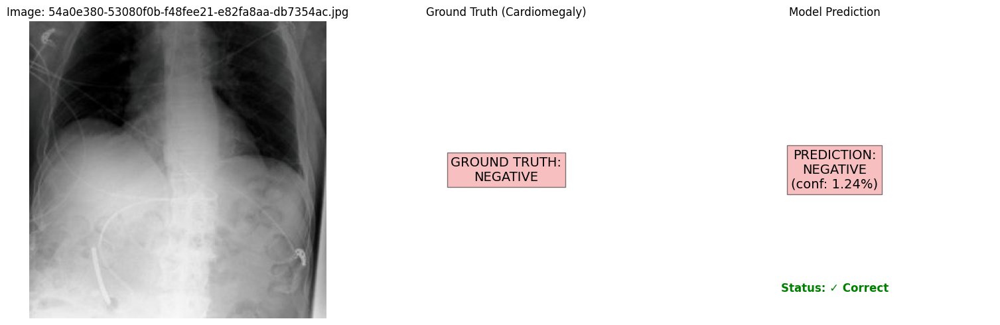


Image: 54a0e380-53080f0b-f48fee21-e82fa8aa-db7354ac.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0124)
Prediction Status: ✓ Correct
--------------------------------------------------


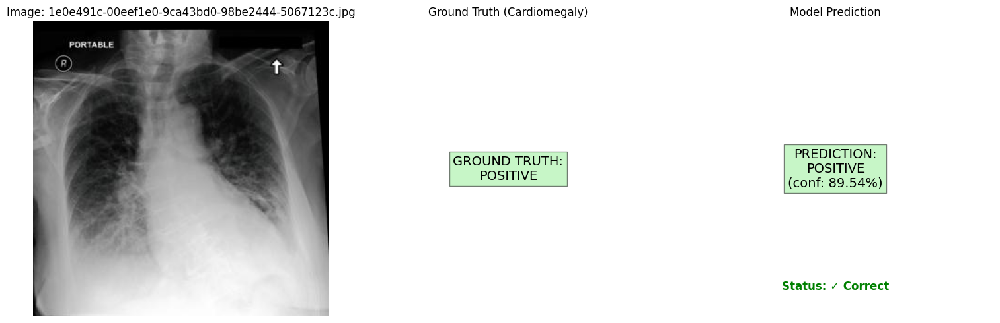


Image: 1e0e491c-00eef1e0-9ca43bd0-98be2444-5067123c.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8954)
Prediction Status: ✓ Correct
--------------------------------------------------


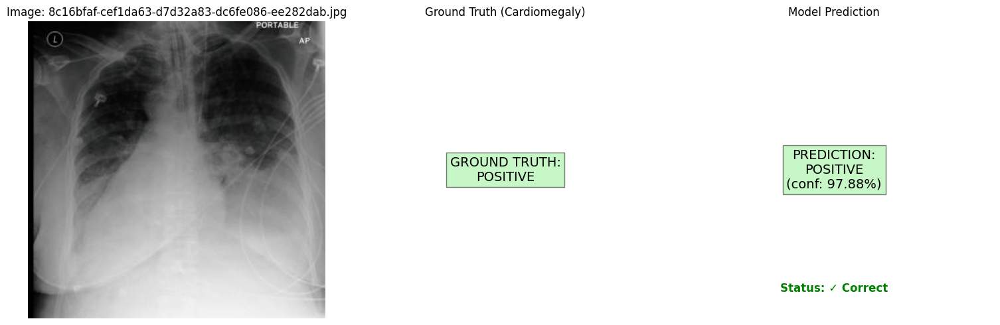


Image: 8c16bfaf-cef1da63-d7d32a83-dc6fe086-ee282dab.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9788)
Prediction Status: ✓ Correct
--------------------------------------------------


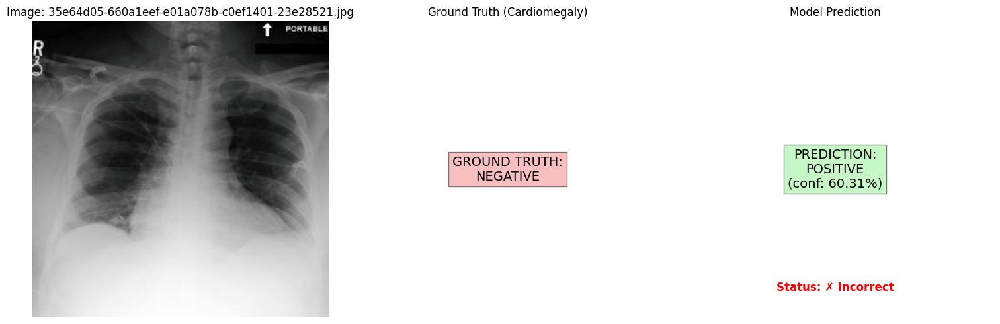


Image: 35e64d05-660a1eef-e01a078b-c0ef1401-23e28521.jpg
Ground Truth: Negative
Prediction: Positive (Probability: 0.6031)
Prediction Status: ✗ Incorrect
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Pleural Effusion'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---

model.load_state_dict(torch.load('best_Pleural_Effusion_vgg16_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## DenseNet 121 - Pleural Effusion


--- Starting DenseNet121 Model Initialization for Pleural Effusion Classification ---


Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 169MB/s]



--- Starting DenseNet121 Model Training on Pleural Effusion dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 1/20 | Time: 129.33s
------------------------------------------------------------
Training:   Loss: 0.5464, Accuracy: 0.7392, F1: 0.7468, AUC-ROC: 0.8109
Validation: Loss: 0.5474, Accuracy: 0.7306, F1: 0.6972, AUC-ROC: 0.8374
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8374


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 2/20 | Time: 116.08s
------------------------------------------------------------
Training:   Loss: 0.4635, Accuracy: 0.7887, F1: 0.7919, AUC-ROC: 0.8648
Validation: Loss: 0.4958, Accuracy: 0.7694, F1: 0.7570, AUC-ROC: 0.8530
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8530


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 3/20 | Time: 112.09s
------------------------------------------------------------
Training:   Loss: 0.4400, Accuracy: 0.8034, F1: 0.8073, AUC-ROC: 0.8776
Validation: Loss: 0.5292, Accuracy: 0.7735, F1: 0.8014, AUC-ROC: 0.8504


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 4/20 | Time: 110.50s
------------------------------------------------------------
Training:   Loss: 0.4558, Accuracy: 0.7920, F1: 0.7969, AUC-ROC: 0.8678
Validation: Loss: 0.6030, Accuracy: 0.7020, F1: 0.7704, AUC-ROC: 0.8460


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 5/20 | Time: 110.65s
------------------------------------------------------------
Training:   Loss: 0.4324, Accuracy: 0.8095, F1: 0.8120, AUC-ROC: 0.8817
Validation: Loss: 0.4846, Accuracy: 0.7959, F1: 0.7899, AUC-ROC: 0.8836
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8836


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 6/20 | Time: 110.27s
------------------------------------------------------------
Training:   Loss: 0.4284, Accuracy: 0.8084, F1: 0.8113, AUC-ROC: 0.8846
Validation: Loss: 0.5442, Accuracy: 0.7469, F1: 0.7961, AUC-ROC: 0.8595


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 7/20 | Time: 109.21s
------------------------------------------------------------
Training:   Loss: 0.4161, Accuracy: 0.8205, F1: 0.8225, AUC-ROC: 0.8911
Validation: Loss: 0.4839, Accuracy: 0.7735, F1: 0.8056, AUC-ROC: 0.8575


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 8/20 | Time: 110.48s
------------------------------------------------------------
Training:   Loss: 0.3749, Accuracy: 0.8376, F1: 0.8422, AUC-ROC: 0.9129
Validation: Loss: 0.4775, Accuracy: 0.8143, F1: 0.8273, AUC-ROC: 0.8707

Early stopping triggered after epoch 8. Validation AUC-ROC did not improve for 3 epochs.


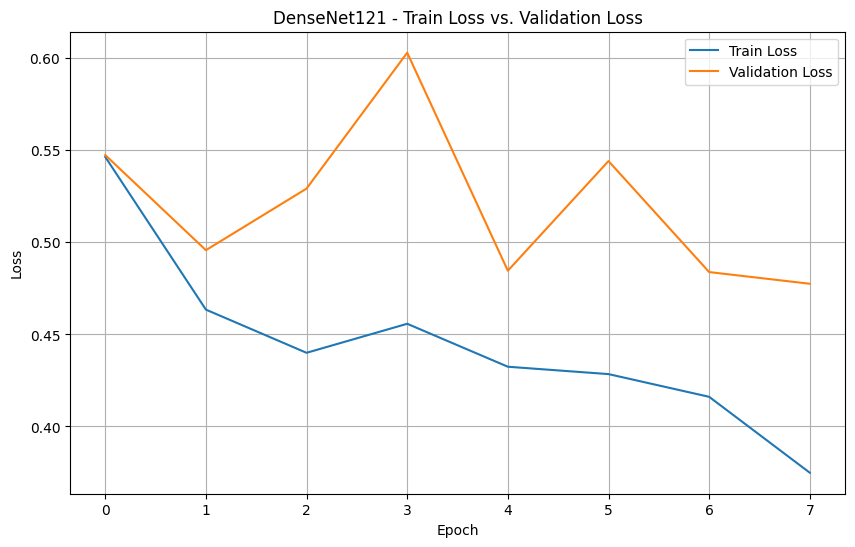


Model training history saved to Pleural_Effusion_densenet121_history.pkl

--- Starting DenseNet121 Evaluation on Test Dataset ---


Validation:   0%|          | 0/99 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.5818
Test Accuracy:   0.7627
Test F1 Score:   0.7577
Test AUC-ROC:    0.8526


Testing:   0%|          | 0/99 [00:00<?, ?it/s]

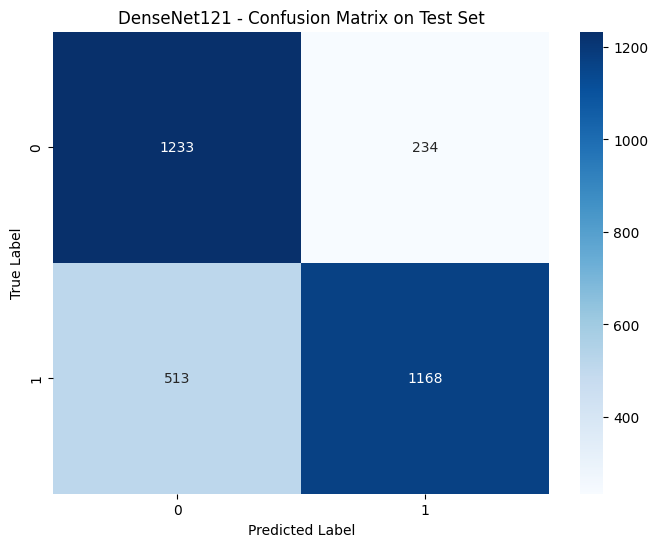

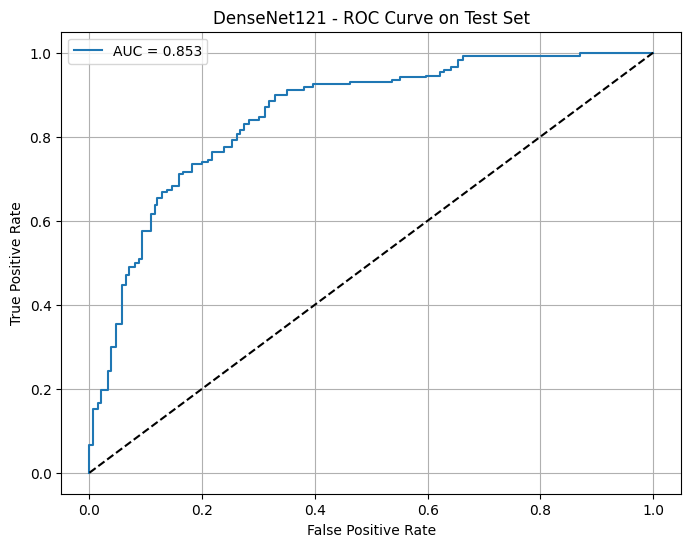


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.71      0.84      0.77      1467
    Positive       0.83      0.69      0.76      1681

    accuracy                           0.76      3148
   macro avg       0.77      0.77      0.76      3148
weighted avg       0.77      0.76      0.76      3148



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle
from torch.optim.lr_scheduler import ReduceLROnPlateau


# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Pleural Effusion'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
# Initialize DenseNet121 model
print("\n--- Starting DenseNet121 Model Initialization for Pleural Effusion Classification ---")

model = models.densenet121(weights=models.DenseNet121_Weights.IMAGENET1K_V1)

#  classifier for binary classification
num_ftrs = model.classifier.in_features
model.classifier = nn.Sequential(
    nn.BatchNorm1d(num_ftrs),
    nn.Dropout(0.4),
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.BatchNorm1d(512),
    nn.Dropout(0.4),
    nn.Linear(512, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

# Training function
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# ----------------------------------------------------------------------
print("\n--- Starting DenseNet121 Model Training on Pleural Effusion dataset ---")

num_epochs = 20
best_val_auc = 0.0
patience = 3
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:   Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Pleural_Effusion_densenet121_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# Plot Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('DenseNet121 - Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('densenet121_train_val_loss_plot.png')
plt.show()

# Store Model History
history_filename = 'Pleural_Effusion_densenet121_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")


# ----------------------------------------------------------------------
# Evaluation on Test Dataset
print("\n--- Starting DenseNet121 Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)

# Load best model
model.load_state_dict(torch.load('best_Pleural_Effusion_densenet121_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# Calculate final metrics and generate plots
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('DenseNet121 - Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('densenet121_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('DenseNet121 - ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('densenet121_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))




--- Randomly Predicting on 5 Test Images ---


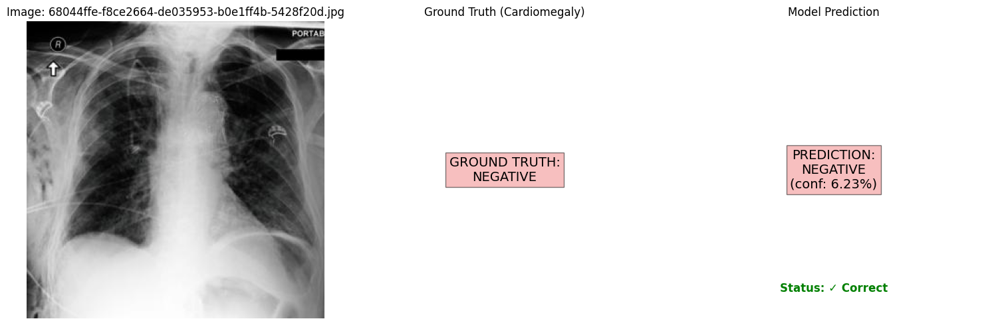


Image: 68044ffe-f8ce2664-de035953-b0e1ff4b-5428f20d.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0623)
Prediction Status: ✓ Correct
--------------------------------------------------


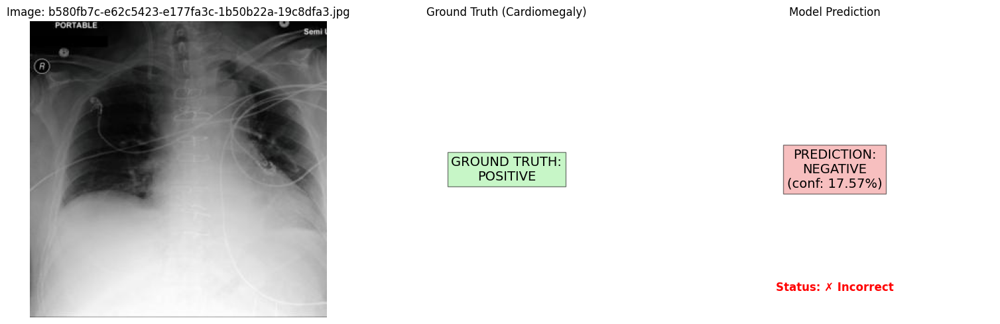


Image: b580fb7c-e62c5423-e177fa3c-1b50b22a-19c8dfa3.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.1757)
Prediction Status: ✗ Incorrect
--------------------------------------------------


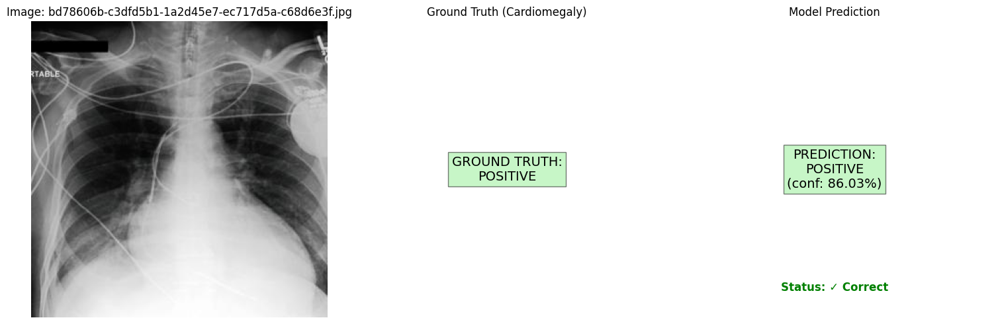


Image: bd78606b-c3dfd5b1-1a2d45e7-ec717d5a-c68d6e3f.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.8603)
Prediction Status: ✓ Correct
--------------------------------------------------


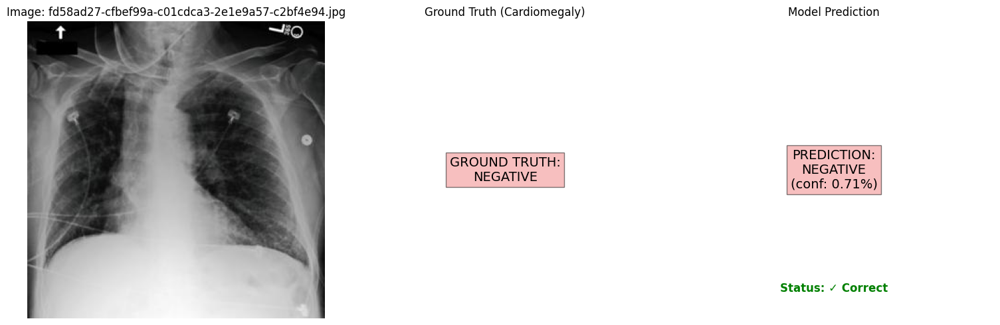


Image: fd58ad27-cfbef99a-c01cdca3-2e1e9a57-c2bf4e94.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0071)
Prediction Status: ✓ Correct
--------------------------------------------------


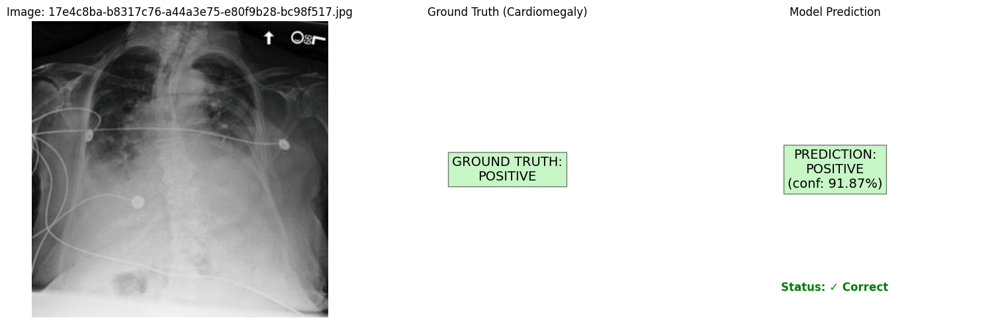


Image: 17e4c8ba-b8317c76-a44a3e75-e80f9b28-bc98f517.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9187)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Pleural Effusion'].values[0]

    # Move to device and make prediction
    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---

model.load_state_dict(torch.load('best_Pleural_Effusion_densenet121_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## InceptionNet V3 - Pleural Effusion


--- Starting InceptionV3 Model Initialization for Pleural Effusion Classification ---
Model initialized on: cuda:0
Total parameters: 25,393,634
Trainable parameters: 25,393,634

--- Starting InceptionV3 Model Training on Pleural Effusion dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 1/20 | Time: 153.20s
------------------------------------------------------------
Training:   Loss: 0.7608, Accuracy: 0.7330, F1: 0.7342, AUC-ROC: 0.8038
Validation: Loss: 0.4886, Accuracy: 0.7551, F1: 0.7656, AUC-ROC: 0.8397
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8397


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 2/20 | Time: 151.75s
------------------------------------------------------------
Training:   Loss: 0.6910, Accuracy: 0.7733, F1: 0.7778, AUC-ROC: 0.8457
Validation: Loss: 0.7341, Accuracy: 0.6592, F1: 0.5322, AUC-ROC: 0.8740
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8740


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 3/20 | Time: 151.23s
------------------------------------------------------------
Training:   Loss: 0.6565, Accuracy: 0.7915, F1: 0.7927, AUC-ROC: 0.8636
Validation: Loss: 0.4569, Accuracy: 0.7796, F1: 0.7931, AUC-ROC: 0.8684


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 4/20 | Time: 151.70s
------------------------------------------------------------
Training:   Loss: 0.6372, Accuracy: 0.7999, F1: 0.8056, AUC-ROC: 0.8711
Validation: Loss: 0.5099, Accuracy: 0.7633, F1: 0.8067, AUC-ROC: 0.8610


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 5/20 | Time: 151.77s
------------------------------------------------------------
Training:   Loss: 0.5893, Accuracy: 0.8156, F1: 0.8182, AUC-ROC: 0.8898
Validation: Loss: 0.4699, Accuracy: 0.8000, F1: 0.7967, AUC-ROC: 0.8736


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 6/20 | Time: 150.97s
------------------------------------------------------------
Training:   Loss: 0.5402, Accuracy: 0.8396, F1: 0.8430, AUC-ROC: 0.9093
Validation: Loss: 0.4422, Accuracy: 0.7837, F1: 0.7880, AUC-ROC: 0.8770
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8770


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 7/20 | Time: 152.22s
------------------------------------------------------------
Training:   Loss: 0.5381, Accuracy: 0.8351, F1: 0.8373, AUC-ROC: 0.9094
Validation: Loss: 0.4940, Accuracy: 0.8000, F1: 0.7841, AUC-ROC: 0.8855
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8855


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 8/20 | Time: 150.46s
------------------------------------------------------------
Training:   Loss: 0.5001, Accuracy: 0.8528, F1: 0.8568, AUC-ROC: 0.9219
Validation: Loss: 0.4579, Accuracy: 0.7918, F1: 0.7992, AUC-ROC: 0.8681


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 9/20 | Time: 150.09s
------------------------------------------------------------
Training:   Loss: 0.4792, Accuracy: 0.8573, F1: 0.8546, AUC-ROC: 0.9288
Validation: Loss: 0.5015, Accuracy: 0.7612, F1: 0.7655, AUC-ROC: 0.8557


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 10/20 | Time: 150.63s
------------------------------------------------------------
Training:   Loss: 0.4606, Accuracy: 0.8665, F1: 0.8660, AUC-ROC: 0.9339
Validation: Loss: 0.5008, Accuracy: 0.7857, F1: 0.8000, AUC-ROC: 0.8689


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 11/20 | Time: 150.83s
------------------------------------------------------------
Training:   Loss: 0.4040, Accuracy: 0.8836, F1: 0.8853, AUC-ROC: 0.9485
Validation: Loss: 0.5487, Accuracy: 0.7939, F1: 0.8119, AUC-ROC: 0.8701

Early stopping triggered after epoch 11. Validation AUC-ROC did not improve for 4 epochs.


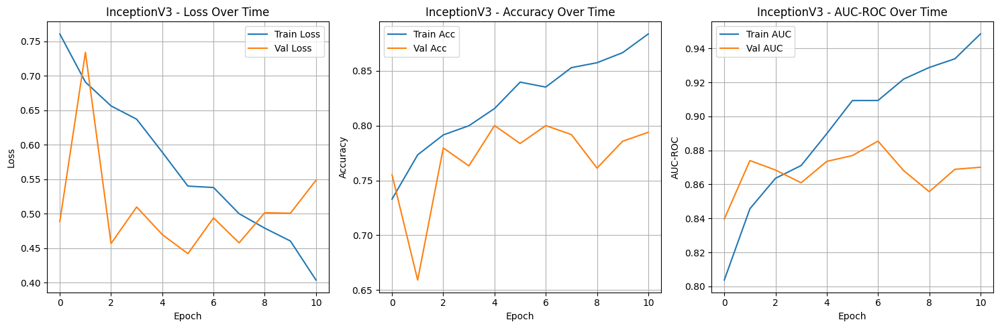


Model training history saved to Pleural_Effusion_inceptionv3_history.pkl

--- Starting InceptionV3 Evaluation on Test Dataset ---


Validation:   0%|          | 0/99 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.6037
Test Accuracy:   0.7468
Test F1 Score:   0.7226
Test AUC-ROC:    0.8542


Testing:   0%|          | 0/99 [00:00<?, ?it/s]

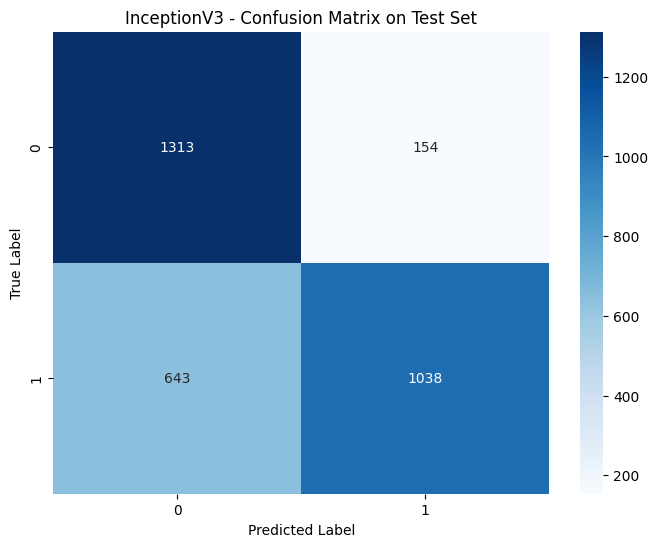

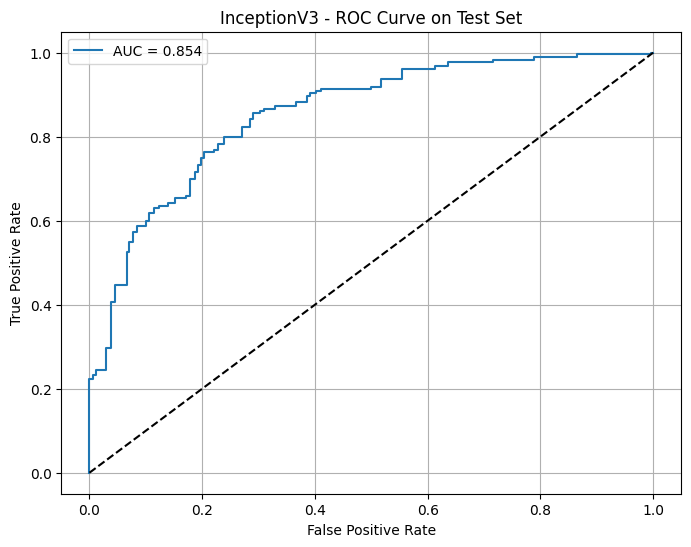


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.67      0.90      0.77      1467
    Positive       0.87      0.62      0.72      1681

    accuracy                           0.75      3148
   macro avg       0.77      0.76      0.74      3148
weighted avg       0.78      0.75      0.74      3148



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle

transform = transforms.Compose([
    transforms.Resize((299, 299)),  # Inception V3  299x299 input
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Pleural Effusion'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0,
    pin_memory=True
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0,
    pin_memory=True
)

print("\n--- Starting InceptionV3 Model Initialization for Pleural Effusion Classification ---")

# Initialize InceptionV3
model = models.inception_v3(weights=models.Inception_V3_Weights.IMAGENET1K_V1)

#  classifier for binary classification

num_ftrs = model.fc.in_features
model.fc = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.Dropout(0.4),
    nn.Linear(512, 1)
)

num_ftrs_aux = model.AuxLogits.fc.in_features
model.AuxLogits.fc = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(num_ftrs_aux, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

print(f"Model initialized on: {device}")
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

# Training function
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs, aux_outputs = model(inputs)

        # Calculate primary and auxiliary losses
        loss1 = criterion(outputs.squeeze(), labels)
        loss2 = criterion(aux_outputs.squeeze(), labels)
        loss = loss1 + 0.4 * loss2

        loss.backward()
        optimizer.step()

        running_loss += loss.item()


        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function (modified for Inception V3)
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)


            outputs = model(inputs)
            if isinstance(outputs, tuple):
                outputs = outputs[0]

            loss = criterion(outputs.squeeze(), labels)
            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Training loop
print("\n--- Starting InceptionV3 Model Training on Pleural Effusion dataset ---")

num_epochs = 20
best_val_auc = 0.0
patience = 4
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}

for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:   Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Pleural_Effusion_inceptionv3_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# Plot training history
plt.figure(figsize=(15, 5))

# Plot Loss
plt.subplot(1, 3, 1)
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Val Loss')
plt.title('InceptionV3 - Loss Over Time')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

# Plot Accuracy
plt.subplot(1, 3, 2)
plt.plot(history['train_acc'], label='Train Acc')
plt.plot(history['val_acc'], label='Val Acc')
plt.title('InceptionV3 - Accuracy Over Time')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)

# Plot AUC-ROC
plt.subplot(1, 3, 3)
plt.plot(history['train_auc'], label='Train AUC')
plt.plot(history['val_auc'], label='Val AUC')
plt.title('InceptionV3 - AUC-ROC Over Time')
plt.xlabel('Epoch')
plt.ylabel('AUC-ROC')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('inceptionv3_training_history.png')
plt.show()

# Save training history
history_filename = 'Pleural_Effusion_inceptionv3_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")
# ----------------------------------------------------------------------
# Evaluation on Test Dataset
print("\n--- Starting InceptionV3 Evaluation on Test Dataset ---")

# Create test dataset
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

# Create test dataloader
test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0,
    pin_memory=True
)

# Load best model
model.load_state_dict(torch.load('best_Pleural_Effusion_inceptionv3_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# Calculate final metrics and generate plots
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        if isinstance(outputs, tuple):
            outputs = outputs[0]

        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('InceptionV3 - Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('inceptionv3_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('InceptionV3 - ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('inceptionv3_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


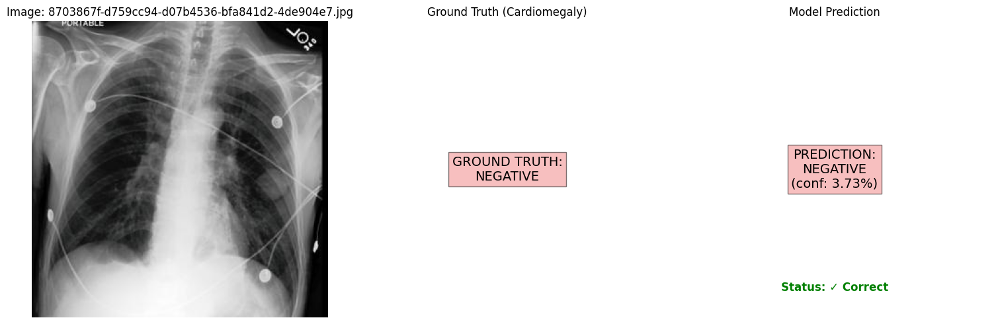


Image: 8703867f-d759cc94-d07b4536-bfa841d2-4de904e7.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0373)
Prediction Status: ✓ Correct
--------------------------------------------------


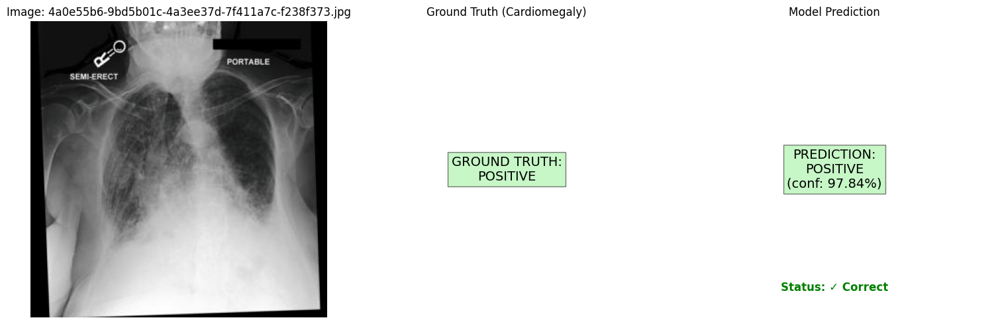


Image: 4a0e55b6-9bd5b01c-4a3ee37d-7f411a7c-f238f373.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9784)
Prediction Status: ✓ Correct
--------------------------------------------------


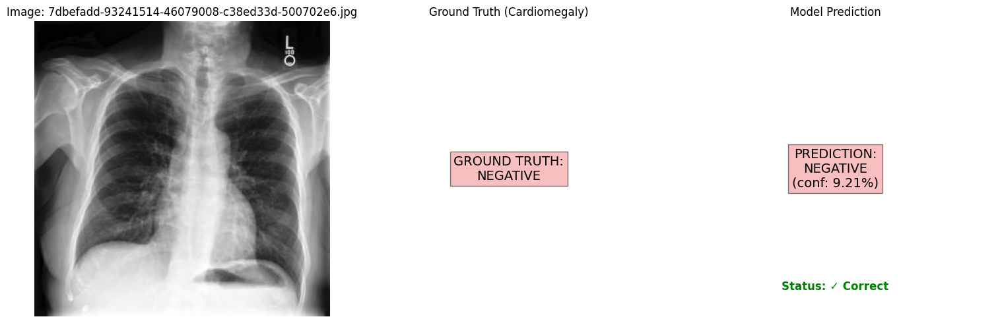


Image: 7dbefadd-93241514-46079008-c38ed33d-500702e6.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0921)
Prediction Status: ✓ Correct
--------------------------------------------------


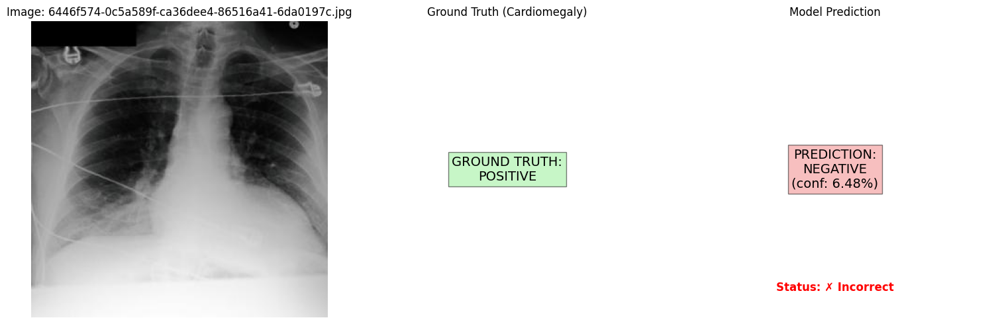


Image: 6446f574-0c5a589f-ca36dee4-86516a41-6da0197c.jpg
Ground Truth: Positive
Prediction: Negative (Probability: 0.0648)
Prediction Status: ✗ Incorrect
--------------------------------------------------


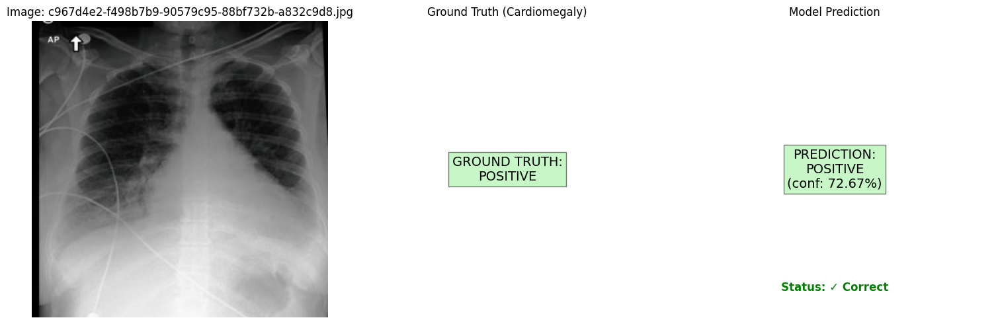


Image: c967d4e2-f498b7b9-90579c95-88bf732b-a832c9d8.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.7267)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 4
Accuracy: 80.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)
    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Pleural Effusion'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---

model.load_state_dict(torch.load('best_Pleural_Effusion_inceptionv3_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)

## MobileNet V3 - Pleural Effusion

Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-8738ca79.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_large-8738ca79.pth



--- Starting MobileNetV3-Large Model Initialization (MobileNetV3 on Pleural Effusion dataset) ---


100%|██████████| 21.1M/21.1M [00:00<00:00, 80.6MB/s]


Model initialized on: cuda:0
Total parameters: 4,858,417
Trainable parameters: 4,858,417

--- Starting MobileNetV3-Large Model Training on Pleural Effusion dataset ---


Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 1/20 | Time: 84.98s
------------------------------------------------------------
Training:    Loss: 0.4902, Accuracy: 0.7769, F1: 0.7808, AUC-ROC: 0.8500
Validation: Loss: 0.7875, Accuracy: 0.7959, F1: 0.7872, AUC-ROC: 0.8662
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8662


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 2/20 | Time: 85.68s
------------------------------------------------------------
Training:    Loss: 0.3950, Accuracy: 0.8339, F1: 0.8375, AUC-ROC: 0.9040
Validation: Loss: 0.4498, Accuracy: 0.7878, F1: 0.8129, AUC-ROC: 0.8839
Saving new best model checkpoint...
Saved new best model with validation AUC-ROC: 0.8839


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 3/20 | Time: 86.22s
------------------------------------------------------------
Training:    Loss: 0.3558, Accuracy: 0.8565, F1: 0.8575, AUC-ROC: 0.9202
Validation: Loss: 0.6861, Accuracy: 0.7490, F1: 0.7078, AUC-ROC: 0.8834


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 4/20 | Time: 86.90s
------------------------------------------------------------
Training:    Loss: 0.2939, Accuracy: 0.8913, F1: 0.8932, AUC-ROC: 0.9462
Validation: Loss: 0.5679, Accuracy: 0.7918, F1: 0.8068, AUC-ROC: 0.8699


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 5/20 | Time: 85.68s
------------------------------------------------------------
Training:    Loss: 0.2397, Accuracy: 0.9078, F1: 0.9067, AUC-ROC: 0.9643
Validation: Loss: 0.9541, Accuracy: 0.7653, F1: 0.8041, AUC-ROC: 0.8629


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 6/20 | Time: 86.12s
------------------------------------------------------------
Training:    Loss: 0.2032, Accuracy: 0.9263, F1: 0.9262, AUC-ROC: 0.9737
Validation: Loss: 0.7043, Accuracy: 0.7918, F1: 0.7960, AUC-ROC: 0.8807


Training:   0%|          | 0/202 [00:00<?, ?it/s]

Validation:   0%|          | 0/16 [00:00<?, ?it/s]


Epoch 7/20 | Time: 85.54s
------------------------------------------------------------
Training:    Loss: 0.1550, Accuracy: 0.9413, F1: 0.9415, AUC-ROC: 0.9846
Validation: Loss: 0.6290, Accuracy: 0.7612, F1: 0.7665, AUC-ROC: 0.8325

Early stopping triggered after epoch 7. Validation AUC-ROC did not improve for 5 epochs.

--- Starting Plotting and History Storage ---


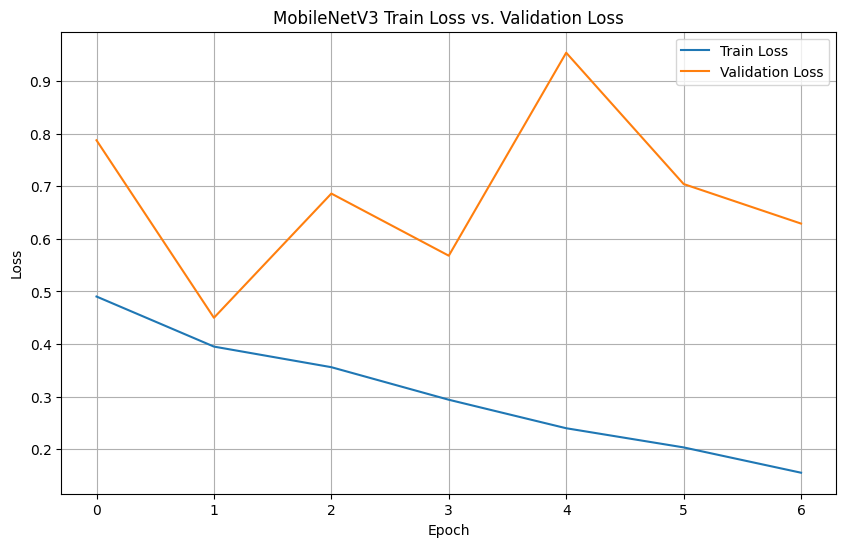


Model training history saved to Pleural_Effusion_mobilenetv3_history.pkl

--- Starting Evaluation on Test Dataset ---


Validation:   0%|          | 0/99 [00:00<?, ?it/s]

Final Test Set Metrics:
Test Loss:       0.5249
Test Accuracy:   0.7462
Test F1 Score:   0.7790
Test AUC-ROC:    0.8379

--- Calculating Final Metrics and Generating Plots ---


Testing:   0%|          | 0/99 [00:00<?, ?it/s]

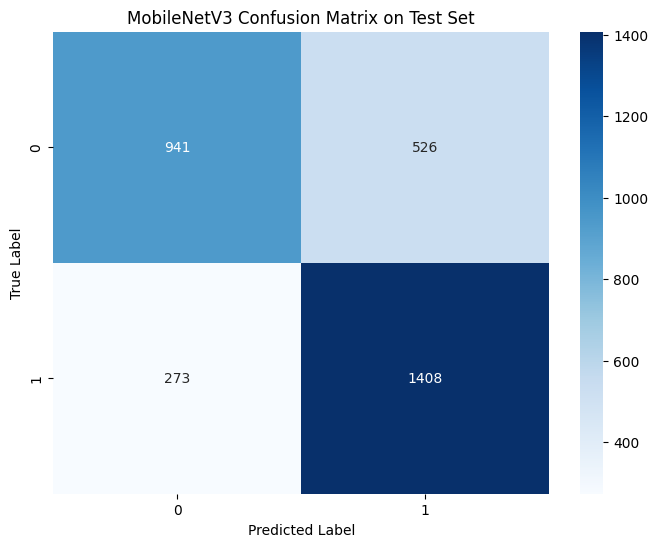

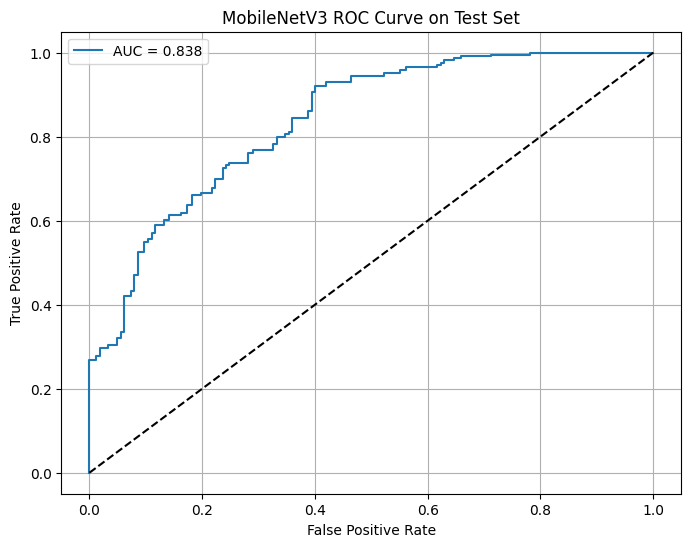


Classification Report:
--------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.78      0.64      0.70      1467
    Positive       0.73      0.84      0.78      1681

    accuracy                           0.75      3148
   macro avg       0.75      0.74      0.74      3148
weighted avg       0.75      0.75      0.74      3148



In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import torch.nn.functional as F
from torchvision import models, transforms
from tqdm.auto import tqdm
import time
import pickle

# Create datasets
train_dataset = ChestXRayDataset(
    loaded_data['train']['df'],
    loaded_data['train']['image_paths'],
    transform=transform
)

val_dataset = ChestXRayDataset(
    loaded_data['val']['df'],
    loaded_data['val']['image_paths'],
    transform=transform
)

# Calculate weights for weighted sampling
labels = loaded_data['train']['df']['Pleural Effusion'].values
unique_labels = np.unique(labels)
class_sample_count = np.array([len(np.where(labels == t)[0]) for t in unique_labels])
weight = 1. / class_sample_count

# Create a mapping from label to weight
label_to_weight = dict(zip(unique_labels, weight))
samples_weight = np.array([label_to_weight[label] for label in labels])
samples_weight = torch.from_numpy(samples_weight)
sampler = WeightedRandomSampler(samples_weight.type('torch.DoubleTensor'), len(samples_weight))

# Create data loaders
train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    sampler=sampler,
    num_workers=0
)

val_loader = DataLoader(
    val_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# ----------------------------------------------------------------------
# Initialize MobileNetV3-Large Model
print("\n--- Starting MobileNetV3-Large Model Initialization (MobileNetV3 on Pleural Effusion dataset) ---")

model = models.mobilenet_v3_large(weights=models.MobileNet_V3_Large_Weights.IMAGENET1K_V1)

#  classifier for binary classification
num_ftrs = model.classifier[-1].in_features
model.classifier[-1] = nn.Sequential(
    nn.Dropout(p=0.3),
    nn.Linear(num_ftrs, 512),
    nn.Hardswish(),
    nn.Dropout(p=0.3),
    nn.Linear(512, 1)
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.05)

print(f"Model initialized on: {device}")
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

# Training function with metrics
def train_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    predictions = []
    true_labels = []

    for inputs, labels in tqdm(loader, desc="Training", leave=False):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        predictions.extend(torch.sigmoid(outputs).cpu().detach().numpy())
        true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    predictions = []
    true_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Validation", leave=False):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)

            running_loss += loss.item()

            predictions.extend(torch.sigmoid(outputs).cpu().numpy())
            true_labels.extend(labels.cpu().numpy())

    predictions = np.array(predictions).squeeze()
    true_labels = np.array(true_labels)

    pred_labels = (predictions > 0.5).astype(int)
    accuracy = accuracy_score(true_labels, pred_labels)
    f1 = f1_score(true_labels, pred_labels)
    auc_roc = roc_auc_score(true_labels, predictions)

    return running_loss / len(loader), accuracy, f1, auc_roc

# ----------------------------------------------------------------------
print("\n--- Starting MobileNetV3-Large Model Training on Pleural Effusion dataset ---")

# Training loop
num_epochs = 20
best_val_auc = 0.0
# Early Stopping variables
patience = 5
epochs_no_improve = 0
early_stop = False

# Initialize history dictionary
history = {
    'train_loss': [],
    'train_acc': [],
    'train_f1': [],
    'train_auc': [],
    'val_loss': [],
    'val_acc': [],
    'val_f1': [],
    'val_auc': [],
    'epoch_time': []
}


for epoch in tqdm(range(num_epochs), desc="Epochs"):
    if early_stop:
        print(f"\nEarly stopping triggered after epoch {epoch}. Validation AUC-ROC did not improve for {patience} epochs.")
        break

    start_time = time.time()

    # Train
    train_loss, train_acc, train_f1, train_auc = train_epoch(
        model, train_loader, criterion, optimizer, device
    )

    # Validate
    val_loss, val_acc, val_f1, val_auc = validate(
        model, val_loader, criterion, device
    )

    end_time = time.time()
    epoch_duration = end_time - start_time

    # Store metrics in history
    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['train_f1'].append(train_f1)
    history['train_auc'].append(train_auc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)
    history['val_f1'].append(val_f1)
    history['val_auc'].append(val_auc)
    history['epoch_time'].append(epoch_duration)

    # Print metrics
    print(f'\nEpoch {epoch+1}/{num_epochs} | Time: {epoch_duration:.2f}s')
    print('-' * 60)
    print(f'Training:    Loss: {train_loss:.4f}, Accuracy: {train_acc:.4f}, F1: {train_f1:.4f}, AUC-ROC: {train_auc:.4f}')
    print(f'Validation: Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1: {val_f1:.4f}, AUC-ROC: {val_auc:.4f}')

    # Save best model and check early stopping condition
    if val_auc > best_val_auc:
        best_val_auc = val_auc
        epochs_no_improve = 0
        print("Saving new best model checkpoint...")
        torch.save(model.state_dict(), 'best_Pleural_Effusion_mobilenetv3_model.pth')
        print(f'Saved new best model with validation AUC-ROC: {val_auc:.4f}')
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            early_stop = True

# ----------------------------------------------------------------------
print("\n--- Starting Plotting and History Storage ---")

# Plotting Training and Validation Loss
plt.figure(figsize=(10, 6))
epochs_completed = len(history['train_loss'])
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('MobileNetV3 Train Loss vs. Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('mobilenetv3_train_val_loss_plot.png')
plt.show()

# Storing Model History
history_filename = 'Pleural_Effusion_mobilenetv3_history.pkl'
with open(history_filename, 'wb') as f:
    pickle.dump(history, f)

print(f"\nModel training history saved to {history_filename}")

# ----------------------------------------------------------------------
print("\n--- Starting Evaluation on Test Dataset ---")

# Create test dataset and loader
test_dataset = ChestXRayDataset(
    loaded_data['test']['df'],
    loaded_data['test']['image_paths'],
    transform=transform
)

test_loader = DataLoader(
    test_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=0
)

# Load best model
model.load_state_dict(torch.load('best_Pleural_Effusion_mobilenetv3_model.pth'))
model.eval()

# Evaluate on test set
test_loss, test_acc, test_f1, test_auc = validate(model, test_loader, criterion, device)

print("=" * 50)
print("Final Test Set Metrics:")
print("=" * 50)
print(f"Test Loss:       {test_loss:.4f}")
print(f"Test Accuracy:   {test_acc:.4f}")
print(f"Test F1 Score:   {test_f1:.4f}")
print(f"Test AUC-ROC:    {test_auc:.4f}")

# ----------------------------------------------------------------------
print("\n--- Calculating Final Metrics and Generating Plots ---")

# Calculate confusion matrix and additional metrics
y_true = []
y_pred = []
y_prob = []

with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing", leave=False):
        inputs = inputs.to(device)
        outputs = model(inputs)
        probs = torch.sigmoid(outputs).cpu().numpy()
        preds = (probs > 0.5).astype(int)

        y_true.extend(labels.numpy())
        y_pred.extend(preds)
        y_prob.extend(probs)

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_prob = np.array(y_prob)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('MobileNetV3 Confusion Matrix on Test Set')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.savefig('mobilenetv3_confusion_matrix.png')
plt.show()

# Plot ROC curve
plt.figure(figsize=(8, 6))
fpr, tpr, _ = roc_curve(y_true, y_prob)
plt.plot(fpr, tpr, label=f'AUC = {test_auc:.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('MobileNetV3 ROC Curve on Test Set')
plt.legend()
plt.grid(True)
plt.savefig('mobilenetv3_roc_curve.png')
plt.show()

# Print classification report
print("\nClassification Report:")
print("-" * 50)
print(classification_report(y_true, y_pred, target_names=['Negative', 'Positive']))


--- Randomly Predicting on 5 Test Images ---


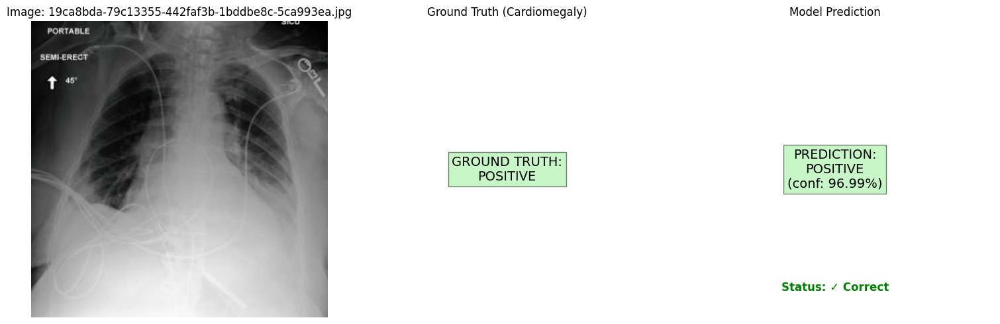


Image: 19ca8bda-79c13355-442faf3b-1bddbe8c-5ca993ea.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9699)
Prediction Status: ✓ Correct
--------------------------------------------------


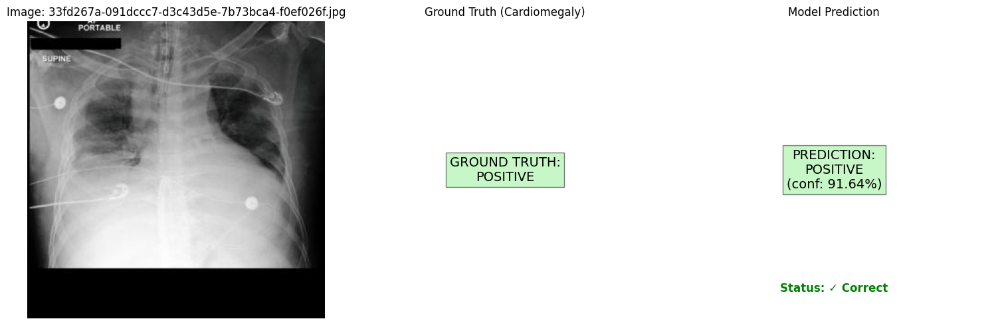


Image: 33fd267a-091dccc7-d3c43d5e-7b73bca4-f0ef026f.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9164)
Prediction Status: ✓ Correct
--------------------------------------------------


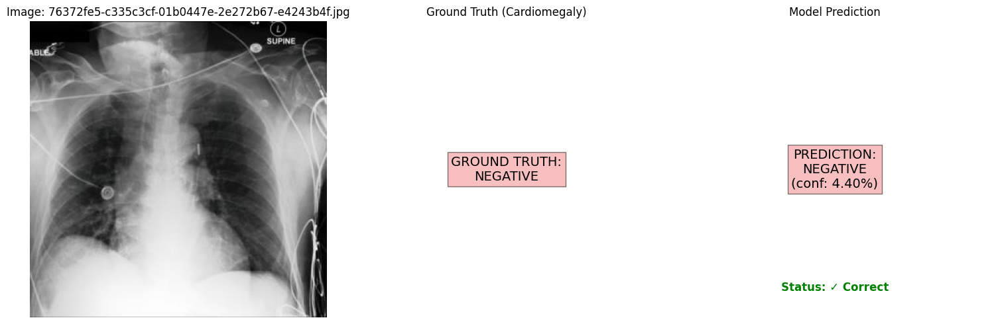


Image: 76372fe5-c335c3cf-01b0447e-2e272b67-e4243b4f.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.0440)
Prediction Status: ✓ Correct
--------------------------------------------------


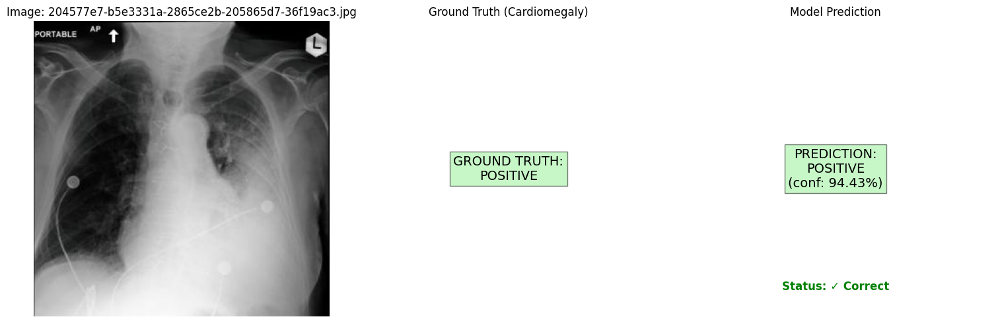


Image: 204577e7-b5e3331a-2865ce2b-205865d7-36f19ac3.jpg
Ground Truth: Positive
Prediction: Positive (Probability: 0.9443)
Prediction Status: ✓ Correct
--------------------------------------------------


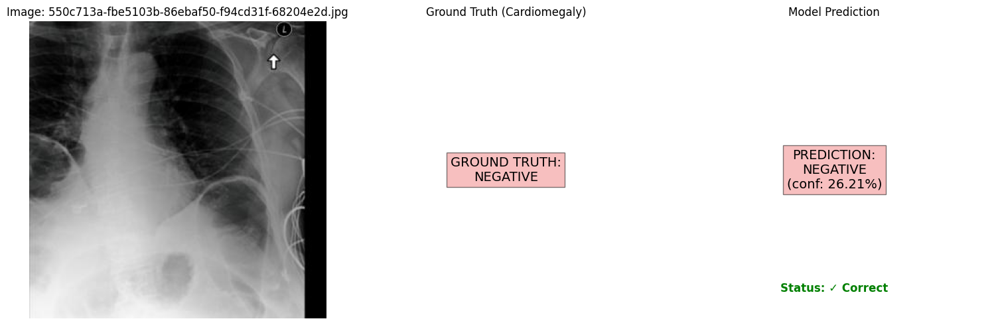


Image: 550c713a-fbe5103b-86ebaf50-f94cd31f-68204e2d.jpg
Ground Truth: Negative
Prediction: Negative (Probability: 0.2621)
Prediction Status: ✓ Correct
--------------------------------------------------

Summary of Random Predictions:
Total Images: 5
Correct Predictions: 5
Accuracy: 100.00%


In [ ]:
import os
import random
from typing import List
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

def predict_single_image(model, image_path: str, dataframe, transform, device):

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    if transform:
        image = transform(image)

    # Add batch dimension
    image = image.unsqueeze(0)

    # Get ground truth label
    filename = os.path.basename(image_path)

    true_label = dataframe[dataframe['cxr_path'].str.contains(filename)]['Pleural Effusion'].values[0]

    model.eval()
    with torch.no_grad():
        image = image.to(device)
        output = model(image)
        probability = torch.sigmoid(output).cpu().numpy().squeeze().item()

    return probability, true_label

def visualize_prediction_with_truth(image_path: str, probability: float, true_label: float, threshold: float = 0.5):

    # Load and display the image
    image = Image.open(image_path).convert('RGB')
    plt.figure(figsize=(15, 5))

    # Determine prediction details
    predicted_class = 'POSITIVE' if probability >= threshold else 'NEGATIVE'
    true_class = 'POSITIVE' if true_label >= 0.5 else 'NEGATIVE'
    is_correct = (predicted_class == 'POSITIVE') == (true_label >= 0.5)

    # Original image
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Image: {os.path.basename(image_path)}') # Added filename to title
    plt.axis('off')

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.text(0.5, 0.5, f'GROUND TRUTH:\n{true_class}', # Use true_class variable
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if true_label >= 0.5 else 'lightcoral', alpha=0.5))
    plt.axis('off')
    plt.title('Ground Truth (Cardiomegaly)')

    # Model Prediction
    plt.subplot(1, 3, 3)
    plt.text(0.5, 0.5, f'PREDICTION:\n{predicted_class}\n(conf: {probability:.2%})',
             ha='center', va='center', fontsize=14,
             bbox=dict(facecolor='lightgreen' if probability >= threshold else 'lightcoral', alpha=0.5))

    status_color = 'green' if is_correct else 'red'
    plt.text(0.5, 0.1, f'Status: {"✓ Correct" if is_correct else "✗ Incorrect"}', # Added status
             ha='center', va='center', fontsize=12, color=status_color, fontweight='bold')

    plt.axis('off')
    plt.title('Model Prediction')

    plt.tight_layout()
    plt.show()

# Function to make predictions on multiple images
def predict_multiple_images(model, image_paths: List[str], dataframe, transform, device, num_images: int = 5):
    print(f"\n--- Randomly Predicting on {num_images} Test Images ---")

    # Randomly select images
    selected_paths = random.sample(image_paths, min(num_images, len(image_paths)))

    # Track metrics
    correct_predictions = 0
    total_predictions = len(selected_paths)

    for img_path in selected_paths:
        probability, true_label = predict_single_image(model, img_path, dataframe, transform, device)
        visualize_prediction_with_truth(img_path, probability, true_label)

        # Calculate prediction
        predicted_label = 1 if probability >= 0.5 else 0
        is_correct = predicted_label == int(true_label >= 0.5)
        correct_predictions += int(is_correct)

        print(f"\nImage: {os.path.basename(img_path)}")
        print(f"Ground Truth: {'Positive' if true_label >= 0.5 else 'Negative'}")
        print(f"Prediction: {'Positive' if probability >= 0.5 else 'Negative'} (Probability: {probability:.4f})")
        print(f"Prediction Status: {'✓ Correct' if is_correct else '✗ Incorrect'}")
        print("-" * 50)

    # Print summary
    accuracy = correct_predictions / total_predictions
    print(f"\nSummary of Random Predictions:")
    print(f"Total Images: {total_predictions}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Accuracy: {accuracy:.2%}")

# --- EXECUTE RANDOM PREDICTIONS ---
model.load_state_dict(torch.load('best_Pleural_Effusion_mobilenetv3_model.pth'))

model.eval()

predict_multiple_images(
    model=model,
    image_paths=loaded_data['test']['image_paths'],
    dataframe=loaded_data['test']['df'],
    transform=transform,
    device=device,
    num_images=5
)